In [1]:
import os
import sys
import pickle
import numpy as np
import matplotlib.pyplot as plt

from tqdm import tqdm
from scipy.linalg import block_diag

module_path = os.path.abspath(os.path.join('../../src'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = os.path.abspath(os.path.join('../../data'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
from dynamics import Dynamics
from utils import get_form_initial_conditions
from gauss_newton import GaussNewton

In [2]:
# Position estimation error
def position_estimation_error(X_est, X_true):
    return np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).flatten(), np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).flatten(), np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).flatten(), np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).flatten()

In [3]:
# Simulation parameters
dt = 60.0  # Time step [s]
K = 395  # Duration [min]
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6 
n_p = 3  
n = N * n_x
o = 3 + 3 + 2 + 1 
H = 50 # Window size [min]
invalid_rmse = 1e20 # [m]
grad_norm_order_mag = True
grad_norm_tol = 1e-6
max_iterations = 20
dyn = Dynamics()

In [4]:
# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P_0 = np.diag(np.concatenate([p_pos_initial * np.ones(3), p_vel_initial * np.ones(3)])) ** 2
P_0 = block_diag(P_0, P_0, P_0, P_0)

In [5]:
def plots(k, algorithm_class):
    iterations = np.arange(0, algorithm_class.iterations + 1)

    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    # Plot 1
    axs[0].semilogy(iterations, 1 / H * np.array(algorithm_class.cost_values), '.-')
    axs[0].set_xlabel(r'$n$')
    axs[0].set_ylabel(r'$\frac{1}{H}J(x_n)$')
    axs[0].set_title('Normalized Cost Function') 
    axs[0].grid()

    # Plot 2
    axs[1].semilogy(iterations, 1 / H * np.array(algorithm_class.gradient_norm_values), '.-')
    axs[1].set_xlabel(r'$n$')
    axs[1].set_ylabel(r'$\frac{1}{H}||\nabla J(x_n)||_2$')
    axs[1].set_title('Normalized Gradient Norm')
    axs[1].grid()
    
    fig.suptitle(f'Solving MHE problem J(k) with k = {k}', fontsize=14)

    plt.tight_layout()
    plt.show()

In [6]:
# Seed for reproducibility
np.random.seed(42)

# Initial conditions for the state vector and true state vectors
X_initial = get_form_initial_conditions(formation)
with open(f"../../data/tudatpy_form{formation}.pkl", "rb") as file:
    X_true = pickle.load(file)[:, :, :K]

# Initial position estimation error
X_est = np.zeros_like(X_true)
X_est[:, :, 0] = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))
for k in range(K - 1):
    X_est[:, :, k + 1] = dyn.f(dt, X_est[:, :, k])
position_estimation_error_1_initial, position_estimation_error_2_initial, position_estimation_error_3_initial, position_estimation_error_4_initial = position_estimation_error(X_est, X_true)

# Algorithm class to use
centralized_newton = GaussNewton(H, K, o, R, grad_norm_order_mag, grad_norm_tol, max_iterations)

# Observations
Y = np.zeros((o, 1, K))
for k in range(K):
    Y[:, :, k] = centralized_newton.h(X_true[:, :, k]) + np.random.multivariate_normal(np.zeros(o), R).reshape((o, 1))

Windows:   0%|          | 0/346 [00:00<?, ?it/s]

[Gauss-Newton] Before applying the algorithm
Cost function: 2822004289.4063253
Gradient norm: 24597705336.60953
Global estimation error: 429.50490519551005
Initial conditions estimation errors: 272.4697073631671 m, 173.20827048054102 m, 227.7797328342984 m, 168.37460816595575 m
Position estimation errors: 2165.153517148831 m, 2840.620813024134 m, 890.8408423418667 m, 596.8916279793366 m

[Gauss-Newton] Iteration 1
Cost function: 1419635.9774949194 (-99.95%)
Gradient norm: 9405282.013491895 (-99.96%)
Global estimation error: 145.4358414807371 (-66.14%)
Initial conditions estimation errors: 57.310091301540844 m, 103.67633758668009 m, 74.37712665672314 m, 39.8279097846055 m
Position estimation errors: 37.45795134401118 m, 41.382856058710814 m, 91.78586416805585 m, 77.21468570035178 m

[Gauss-Newton] Iteration 2
Cost function: 1385700.396458396 (-2.39%)
Gradient norm: 51191.0439248752 (-99.46%)
Global estimation error: 112.82085789590104 (-22.43%)
Initial conditions estimation errors: 57.2

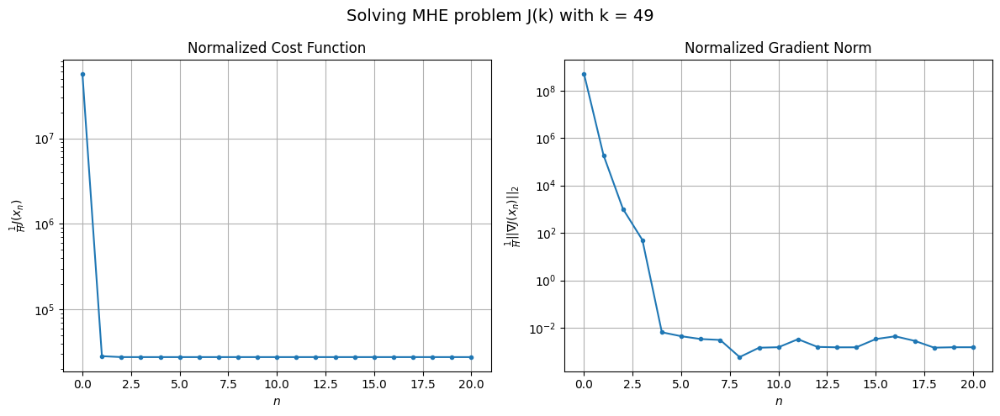

Windows:   0%|          | 1/346 [00:25<2:27:06, 25.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1303768.1117373095
Gradient norm: 18150077.6170525
Global estimation error: 101.05676190041692
Initial conditions estimation errors: 51.22866099406009 m, 50.345253104449405 m, 50.53569765823813 m, 49.995078484488545 m
Position estimation errors: 40.28769204452375 m, 40.83968866131888 m, 41.33768799614796 m, 41.59378615020097 m

[Gauss-Newton] Iteration 1
Cost function: 1281073.1871356214 (-1.74%)
Gradient norm: 159.75232954966148 (-100.00%)
Global estimation error: 111.23801625405025 (10.07%)
Initial conditions estimation errors: 56.05850460397506 m, 55.38286415528767 m, 55.66665599933043 m, 55.3643594784694 m
Position estimation errors: 36.37841649795494 m, 36.68087612157623 m, 37.00396762980171 m, 36.976859845586134 m

[Gauss-Newton] Iteration 2
Cost function: 1281073.1871553964 (0.00%)
Gradient norm: 0.05950471215304899 (-99.96%)
Global estimation error: 111.23713066274746 (-0.00%)
Initial conditions estimation errors: 56.0

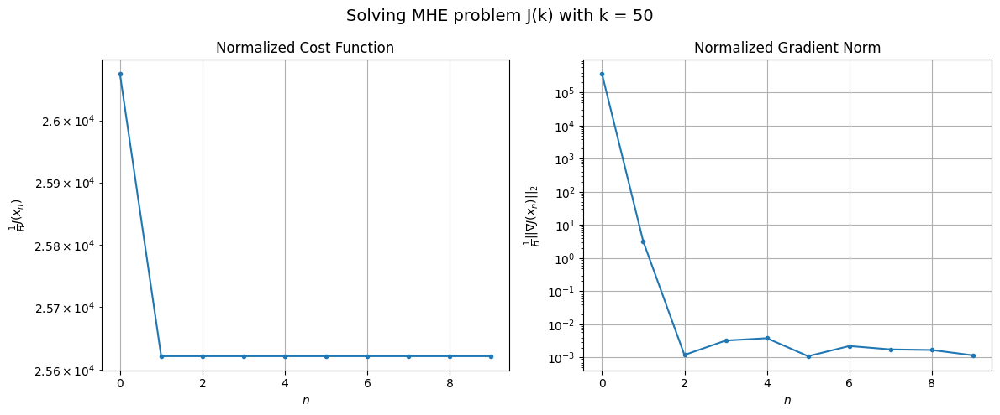

Windows:   1%|          | 2/346 [00:36<1:37:58, 17.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1200889.8918711946
Gradient norm: 17315258.523521226
Global estimation error: 99.28188981651459
Initial conditions estimation errors: 50.100099047051295 m, 49.58281291578829 m, 49.64298579579417 m, 49.23331055956964 m
Position estimation errors: 39.12370028329874 m, 39.25808970575162 m, 39.874237018424935 m, 39.81903342638299 m

[Gauss-Newton] Iteration 1
Cost function: 1179927.1493152902 (-1.75%)
Gradient norm: 145.43928393166783 (-100.00%)
Global estimation error: 109.15506699551557 (9.94%)
Initial conditions estimation errors: 54.60529866118151 m, 54.22746531503327 m, 54.8947368568133 m, 54.579873706068895 m
Position estimation errors: 35.28249954937508 m, 35.19454200984638 m, 35.040292518541776 m, 35.004843075236735 m

[Gauss-Newton] Iteration 2
Cost function: 1179927.1493274306 (0.00%)
Gradient norm: 0.21210675240813162 (-99.85%)
Global estimation error: 109.15415149506224 (-0.00%)
Initial conditions estimation errors: 54

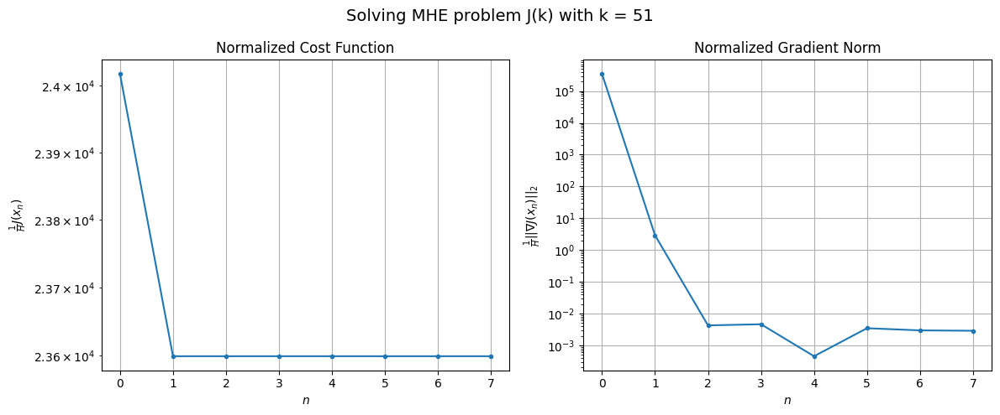

Windows:   1%|          | 3/346 [00:46<1:17:58, 13.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1102409.3990293331
Gradient norm: 16311219.796076674
Global estimation error: 97.58750897730062
Initial conditions estimation errors: 48.760215559661106 m, 48.53888323568771 m, 49.06489999591808 m, 48.808943650954895 m
Position estimation errors: 37.91612766865985 m, 37.6543033087315 m, 37.69075679149275 m, 37.587666451970726 m

[Gauss-Newton] Iteration 1
Cost function: 1083016.9109325423 (-1.76%)
Gradient norm: 167.44493253406338 (-100.00%)
Global estimation error: 103.68164906493766 (6.24%)
Initial conditions estimation errors: 52.98738609993424 m, 51.592587068122654 m, 52.40176020731301 m, 50.342986367903436 m
Position estimation errors: 34.15081333976834 m, 35.12616535126211 m, 35.33574121885041 m, 35.172028181143965 m

[Gauss-Newton] Iteration 2
Cost function: 1083016.9108186066 (-0.00%)
Gradient norm: 0.043344225332392745 (-99.97%)
Global estimation error: 103.67188723631436 (-0.01%)
Initial conditions estimation errors:

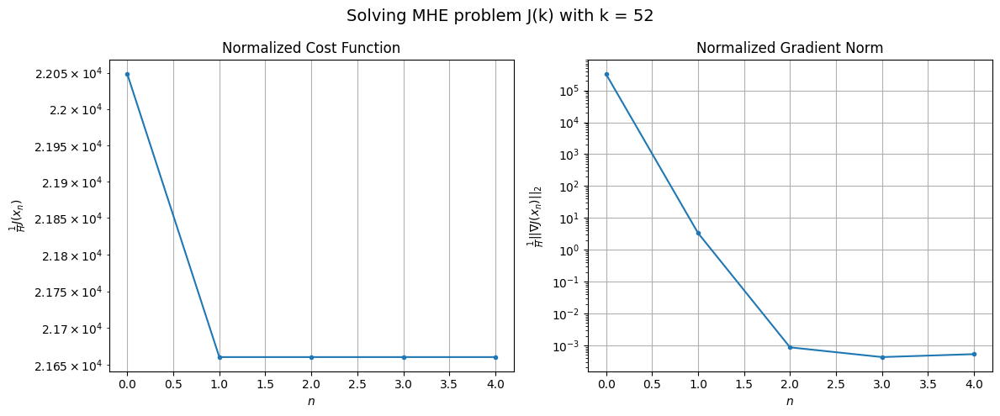

Windows:   1%|          | 4/346 [00:52<1:01:16, 10.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1009945.792712235
Gradient norm: 15148408.851784363
Global estimation error: 92.39988985043934
Initial conditions estimation errors: 47.26462141182133 m, 46.0247832257767 m, 46.54188990195819 m, 44.936771412398244 m
Position estimation errors: 36.691507407129016 m, 37.45961698576128 m, 37.885332643960965 m, 37.665644320747404 m

[Gauss-Newton] Iteration 1
Cost function: 992295.9339902828 (-1.75%)
Gradient norm: 119.21544377822352 (-100.00%)
Global estimation error: 99.60947649932555 (7.80%)
Initial conditions estimation errors: 51.222616484614754 m, 50.24832216900106 m, 49.64850371515596 m, 48.04547552691214 m
Position estimation errors: 33.05304907802946 m, 33.56993736510995 m, 34.65018090177994 m, 34.727352490050954 m

[Gauss-Newton] Iteration 2
Cost function: 992295.9339603845 (-0.00%)
Gradient norm: 0.1903179731156824 (-99.84%)
Global estimation error: 99.61558459967881 (0.01%)
Initial conditions estimation errors: 51.2226

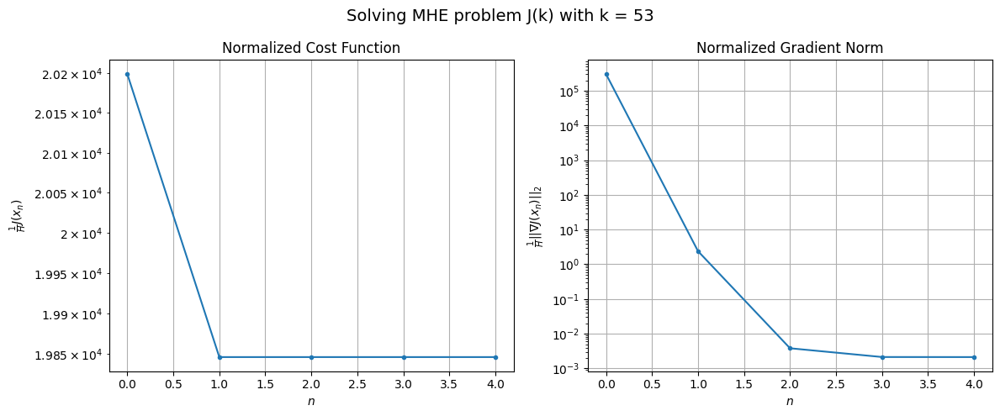

Windows:   1%|▏         | 5/346 [00:58<51:45,  9.11s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 924939.2102105406
Gradient norm: 14254274.312145187
Global estimation error: 88.61627120656995
Initial conditions estimation errors: 45.62238895179505 m, 44.84676861538633 m, 44.026506151858555 m, 42.68288216746382 m
Position estimation errors: 35.52664115062232 m, 35.80635368787564 m, 37.136470546985464 m, 37.214080692582776 m

[Gauss-Newton] Iteration 1
Cost function: 908763.5874424224 (-1.75%)
Gradient norm: 251.87287275760158 (-100.00%)
Global estimation error: 92.08914329723115 (3.92%)
Initial conditions estimation errors: 49.35487222779946 m, 47.055725518135034 m, 45.6660103392411 m, 41.771190302621335 m
Position estimation errors: 32.00677189860016 m, 33.81376791820937 m, 36.96894872436324 m, 36.58422215326453 m

[Gauss-Newton] Iteration 2
Cost function: 908763.5862375759 (-0.00%)
Gradient norm: 0.08613351753535456 (-99.97%)
Global estimation error: 92.07946055739808 (-0.01%)
Initial conditions estimation errors: 49.354

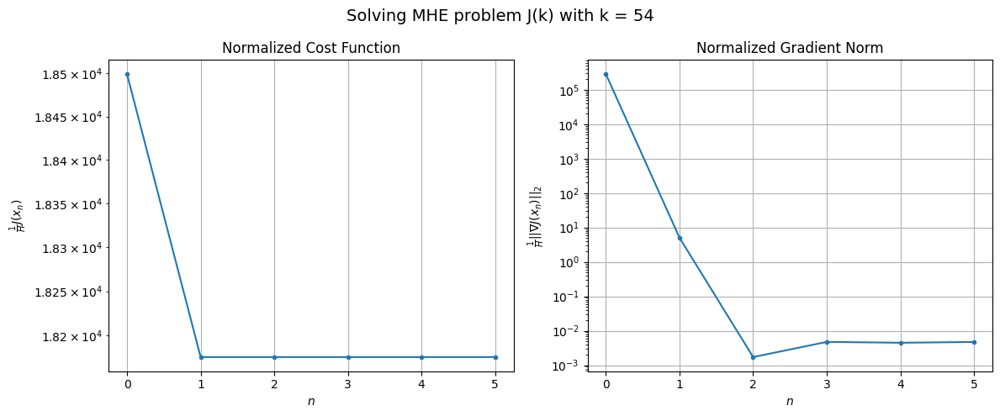

Windows:   2%|▏         | 6/346 [01:05<47:52,  8.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 847090.2473592015
Gradient norm: 13791359.827608118
Global estimation error: 81.32753795883683
Initial conditions estimation errors: 43.871903408052326 m, 41.80053971545391 m, 39.81068819009087 m, 36.84028444678769 m
Position estimation errors: 34.438286946573896 m, 35.91924791384447 m, 39.54961101824063 m, 39.19296160339305 m

[Gauss-Newton] Iteration 1
Cost function: 832159.4552026327 (-1.76%)
Gradient norm: 93.66070100099398 (-100.00%)
Global estimation error: 89.52482579385821 (10.08%)
Initial conditions estimation errors: 47.41159596297801 m, 45.94921175325977 m, 44.20816745217077 m, 41.24438358501403 m
Position estimation errors: 31.019983850783476 m, 32.03129518341555 m, 35.50743496724895 m, 35.185262880628116 m

[Gauss-Newton] Iteration 2
Cost function: 832159.4551716285 (-0.00%)
Gradient norm: 0.03159246204656612 (-99.97%)
Global estimation error: 89.53370881102882 (0.01%)
Initial conditions estimation errors: 47.4115

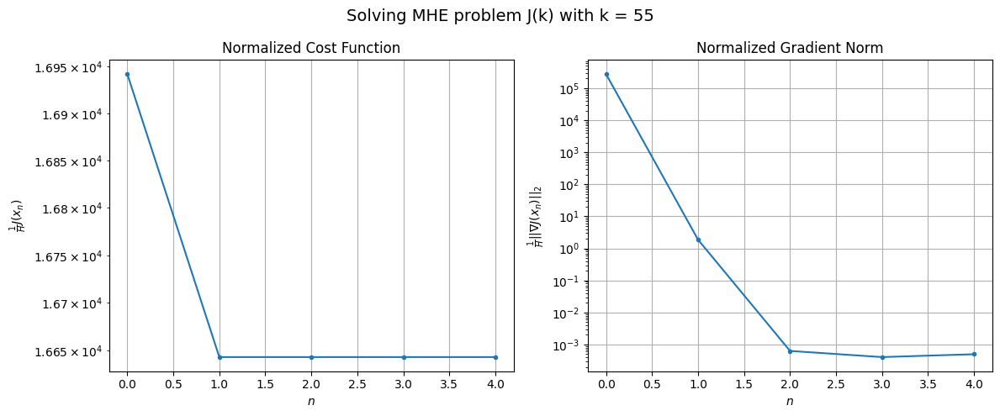

Windows:   2%|▏         | 7/346 [01:12<43:27,  7.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 775241.728737032
Gradient norm: 13181043.762535037
Global estimation error: 78.86333873037543
Initial conditions estimation errors: 42.037522456410244 m, 40.81540353307972 m, 38.503339870967714 m, 36.10858991224013 m
Position estimation errors: 33.41781822322814 m, 34.11812162494404 m, 38.017615040410504 m, 37.743900720864154 m

[Gauss-Newton] Iteration 1
Cost function: 761538.7112404619 (-1.77%)
Gradient norm: 73.06912079531848 (-100.00%)
Global estimation error: 85.17784371591634 (8.01%)
Initial conditions estimation errors: 45.39924885244222 m, 44.27181049404754 m, 41.341179587297184 m, 39.051856927548336 m
Position estimation errors: 30.12278613386392 m, 30.88589487668383 m, 34.88870235268734 m, 34.65617557670093 m

[Gauss-Newton] Iteration 2
Cost function: 761538.7112418402 (0.00%)
Gradient norm: 0.2588541450943883 (-99.65%)
Global estimation error: 85.18112014874423 (0.00%)
Initial conditions estimation errors: 45.399251

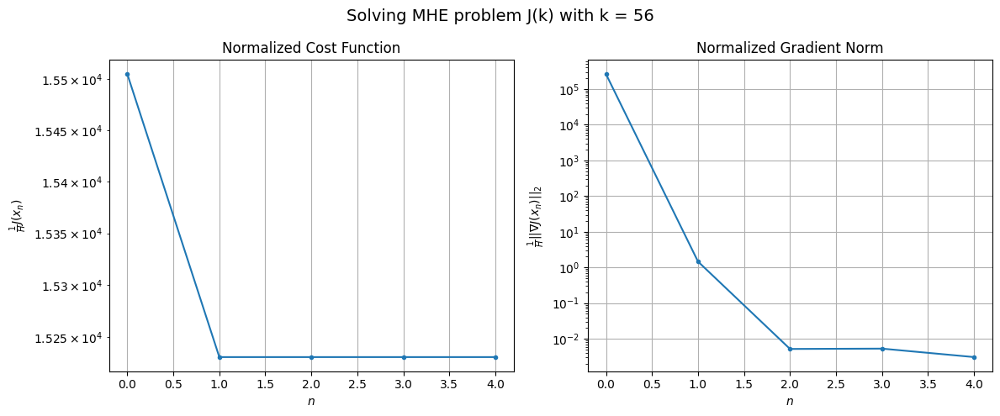

Windows:   2%|▏         | 8/346 [01:18<40:20,  7.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 711760.3653797589
Gradient norm: 12745959.221778583
Global estimation error: 74.7174049508703
Initial conditions estimation errors: 40.11176227186413 m, 39.24565222483626 m, 35.80585745646523 m, 33.93259199082363 m
Position estimation errors: 32.47954221967406 m, 32.941101278111475 m, 37.38252352084909 m, 37.24274152170387 m

[Gauss-Newton] Iteration 1
Cost function: 699142.7953588977 (-1.77%)
Gradient norm: 66.65538054796407 (-100.00%)
Global estimation error: 82.41494599841333 (10.30%)
Initial conditions estimation errors: 43.31252436099264 m, 42.77936156066329 m, 39.85478808045311 m, 38.70057530462286 m
Position estimation errors: 29.2916856259301 m, 29.462878981853784 m, 32.52375538389348 m, 32.508834638902144 m

[Gauss-Newton] Iteration 2
Cost function: 699142.7953324013 (-0.00%)
Gradient norm: 0.16474917565832103 (-99.75%)
Global estimation error: 82.42274975348987 (0.01%)
Initial conditions estimation errors: 43.3125270

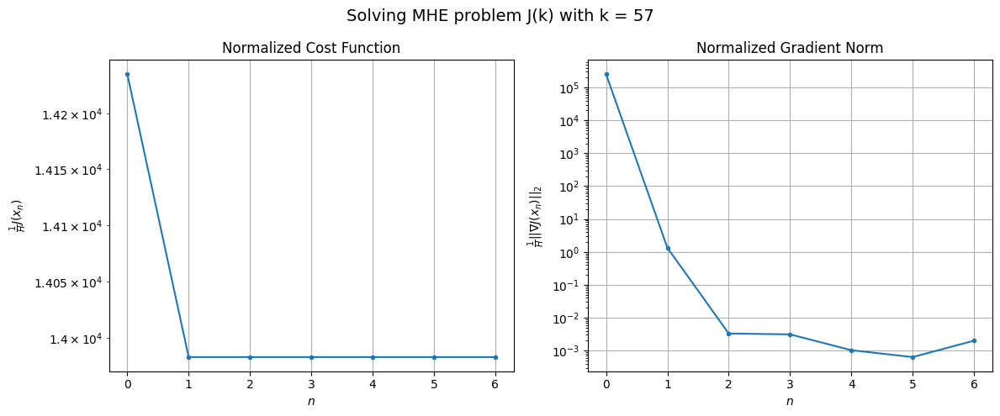

Windows:   3%|▎         | 9/346 [01:26<42:21,  7.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 654741.8056492357
Gradient norm: 12756695.670914259
Global estimation error: 72.12485753442273
Initial conditions estimation errors: 38.08053845997986 m, 37.80705563274888 m, 34.57010846486912 m, 33.57629856661555 m
Position estimation errors: 31.59910853493051 m, 31.493224028503697 m, 34.86365838780273 m, 34.96910186807111 m

[Gauss-Newton] Iteration 1
Cost function: 643158.9604791858 (-1.77%)
Gradient norm: 63.40355670902543 (-100.00%)
Global estimation error: 77.94526016032118 (8.07%)
Initial conditions estimation errors: 41.12275322361167 m, 40.56585401212716 m, 37.68435561646238 m, 36.31321030267959 m
Position estimation errors: 28.51954919992247 m, 28.68681028132819 m, 31.846201652827805 m, 31.770996037166054 m

[Gauss-Newton] Iteration 2
Cost function: 643158.9604780549 (-0.00%)
Gradient norm: 0.37273175687332266 (-99.41%)
Global estimation error: 77.93984900912815 (-0.01%)
Initial conditions estimation errors: 41.12275

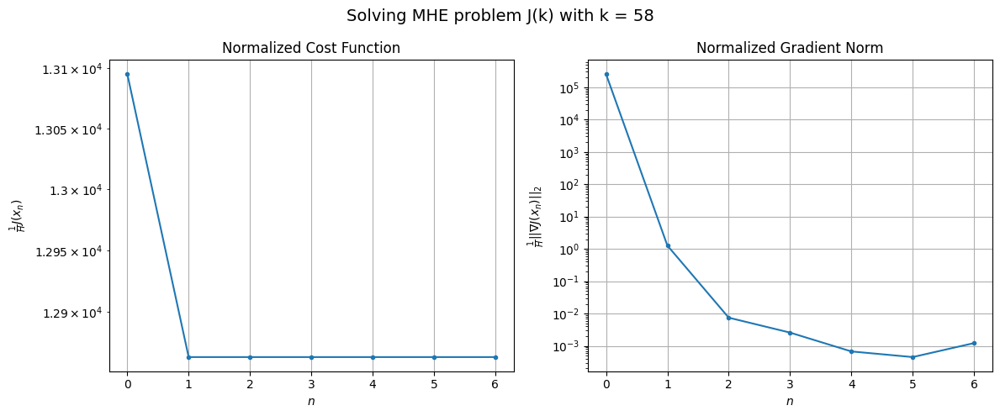

Windows:   3%|▎         | 10/346 [01:34<43:28,  7.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 605394.0086171089
Gradient norm: 12640543.625001423
Global estimation error: 67.80142010764031
Initial conditions estimation errors: 35.92881936226188 m, 35.63592378920466 m, 32.41926971131448 m, 31.38776118081961 m
Position estimation errors: 30.783338767507853 m, 30.675940635984354 m, 34.10069395454626 m, 34.10609152746131 m

[Gauss-Newton] Iteration 1
Cost function: 594774.441637584 (-1.75%)
Gradient norm: 80.82121652707184 (-100.00%)
Global estimation error: 74.83704133929064 (10.38%)
Initial conditions estimation errors: 38.81997144315281 m, 38.652980914909755 m, 36.41122075762904 m, 35.68935381705011 m
Position estimation errors: 27.81391887633652 m, 27.595822107496556 m, 29.781431475230388 m, 29.70319253681669 m

[Gauss-Newton] Iteration 2
Cost function: 594774.441613653 (-0.00%)
Gradient norm: 0.3385869041675782 (-99.58%)
Global estimation error: 74.84249317734158 (0.01%)
Initial conditions estimation errors: 38.819973

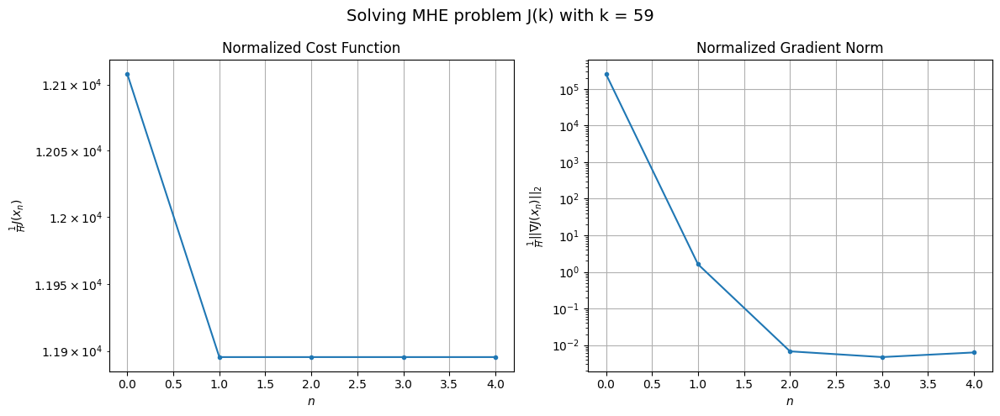

Windows:   3%|▎         | 11/346 [01:41<40:46,  7.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 563777.9204969523
Gradient norm: 12952165.292202575
Global estimation error: 64.93705221777803
Initial conditions estimation errors: 33.69186345309564 m, 33.76518162232909 m, 31.387266949344063 m, 30.925723755891795 m
Position estimation errors: 30.057991476821503 m, 29.601983207912678 m, 31.858620734245665 m, 31.81477523309879 m

[Gauss-Newton] Iteration 1
Cost function: 554036.3879256815 (-1.73%)
Gradient norm: 53.549310402014946 (-100.00%)
Global estimation error: 70.77178753668258 (8.99%)
Initial conditions estimation errors: 36.42659143600754 m, 37.0733490702697 m, 34.25230480158856 m, 33.67586519533332 m
Position estimation errors: 27.17479673102459 m, 26.086271999306867 m, 29.29066115294679 m, 29.40778746814771 m

[Gauss-Newton] Iteration 2
Cost function: 554036.3879219199 (-0.00%)
Gradient norm: 0.27980924227001214 (-99.48%)
Global estimation error: 70.77343077940178 (0.00%)
Initial conditions estimation errors: 36.426

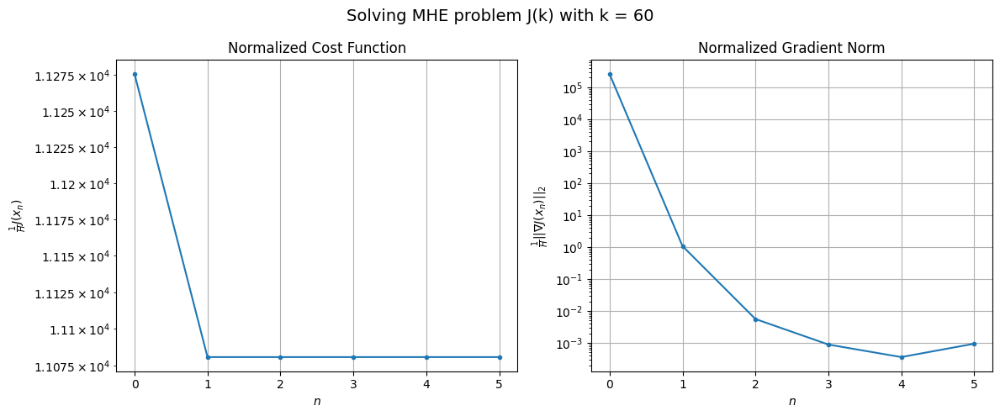

Windows:   3%|▎         | 12/346 [01:48<41:04,  7.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 530172.6802428644
Gradient norm: 12929034.640961792
Global estimation error: 60.96995152696548
Initial conditions estimation errors: 31.435806112402584 m, 32.30456765243422 m, 29.232130989052163 m, 28.826960243629074 m
Position estimation errors: 29.425862608789007 m, 28.120309275929923 m, 31.440558935453122 m, 31.668631551293597 m

[Gauss-Newton] Iteration 1
Cost function: 521270.1267878859 (-1.68%)
Gradient norm: 48.88513607082315 (-100.00%)
Global estimation error: 68.52912348887627 (12.40%)
Initial conditions estimation errors: 34.02041128634486 m, 34.96316201210866 m, 33.84852105693609 m, 34.21517142589792 m
Position estimation errors: 26.63688317860157 m, 25.445219865491257 m, 27.105897285860255 m, 27.202235387652618 m

[Gauss-Newton] Iteration 2
Cost function: 521270.12677810394 (-0.00%)
Gradient norm: 0.1277737312309557 (-99.74%)
Global estimation error: 68.52903491309904 (-0.00%)
Initial conditions estimation errors: 

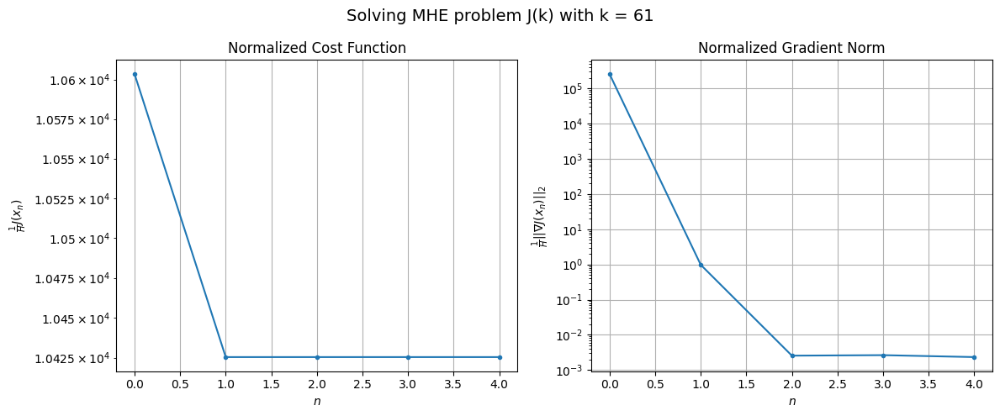

Windows:   4%|▍         | 13/346 [01:54<39:13,  7.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 504982.32890132343
Gradient norm: 13148893.257994916
Global estimation error: 59.076027198743105
Initial conditions estimation errors: 29.24710750069634 m, 30.344386294781547 m, 29.10220832570864 m, 29.44210717989362 m
Position estimation errors: 28.92391649004071 m, 27.54564591028626 m, 29.356963826831922 m, 29.538762853083988 m

[Gauss-Newton] Iteration 1
Cost function: 496843.66606968397 (-1.61%)
Gradient norm: 111.83980438174868 (-100.00%)
Global estimation error: 64.78416620156827 (9.66%)
Initial conditions estimation errors: 31.68716677985244 m, 32.624004613298105 m, 32.37962699861128 m, 32.86519504095203 m
Position estimation errors: 26.2229437151799 m, 25.276203004176363 m, 25.244181447032997 m, 24.96094912222249 m

[Gauss-Newton] Iteration 2
Cost function: 496843.66604060883 (-0.00%)
Gradient norm: 0.10333410546938943 (-99.91%)
Global estimation error: 64.78721993889405 (0.00%)
Initial conditions estimation errors: 31

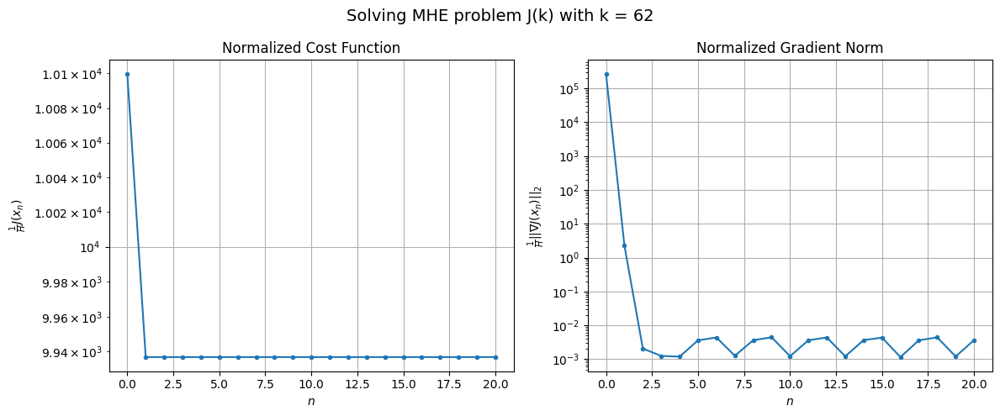

Windows:   4%|▍         | 14/346 [02:17<1:05:44, 11.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 487825.8524190906
Gradient norm: 13664551.164469585
Global estimation error: 56.21365996298905
Initial conditions estimation errors: 27.19923284406983 m, 28.219475868639012 m, 28.23507534939051 m, 28.750616908134152 m
Position estimation errors: 28.578576112114835 m, 27.496307653787564 m, 27.358662753873126 m, 27.019959644746642 m

[Gauss-Newton] Iteration 1
Cost function: 480371.32051605417 (-1.53%)
Gradient norm: 28.469581036110398 (-100.00%)
Global estimation error: 61.386873895332116 (9.20%)
Initial conditions estimation errors: 29.498905685442953 m, 29.937457522133233 m, 31.09123971872551 m, 32.17492040757711 m
Position estimation errors: 25.954740890137465 m, 25.39635180382923 m, 23.799760422957576 m, 23.392834664718364 m

[Gauss-Newton] Iteration 2
Cost function: 480371.3205071317 (-0.00%)
Gradient norm: 0.21735617965894288 (-99.24%)
Global estimation error: 61.38700401073437 (0.00%)
Initial conditions estimation errors

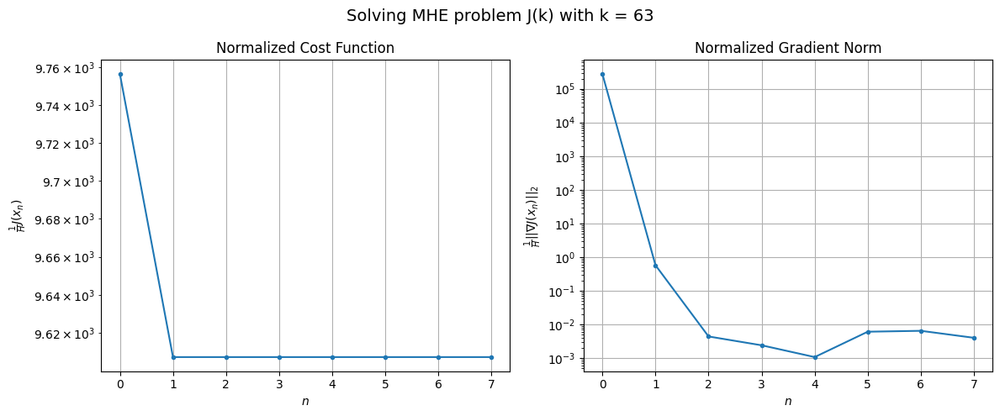

Windows:   4%|▍         | 15/346 [02:27<1:01:23, 11.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 477851.23001643136
Gradient norm: 14091013.988946775
Global estimation error: 53.6072281530645
Initial conditions estimation errors: 25.355595167084036 m, 25.924286834457217 m, 27.415329143977438 m, 28.41025458466863 m
Position estimation errors: 28.4188390709264 m, 27.70775762905168 m, 25.96786567030924 m, 25.516493717684323 m

[Gauss-Newton] Iteration 1
Cost function: 470942.5439196086 (-1.45%)
Gradient norm: 49.87008928760099 (-100.00%)
Global estimation error: 57.34283490299882 (6.97%)
Initial conditions estimation errors: 27.536794374734015 m, 28.30529246216621 m, 28.939096235494528 m, 29.853777206350244 m
Position estimation errors: 25.856260293941187 m, 25.01820385108802 m, 23.420413106508864 m, 22.456215344433897 m

[Gauss-Newton] Iteration 2
Cost function: 470942.5439262072 (0.00%)
Gradient norm: 0.04376189475839426 (-99.91%)
Global estimation error: 57.34640335321318 (0.01%)
Initial conditions estimation errors: 27.5

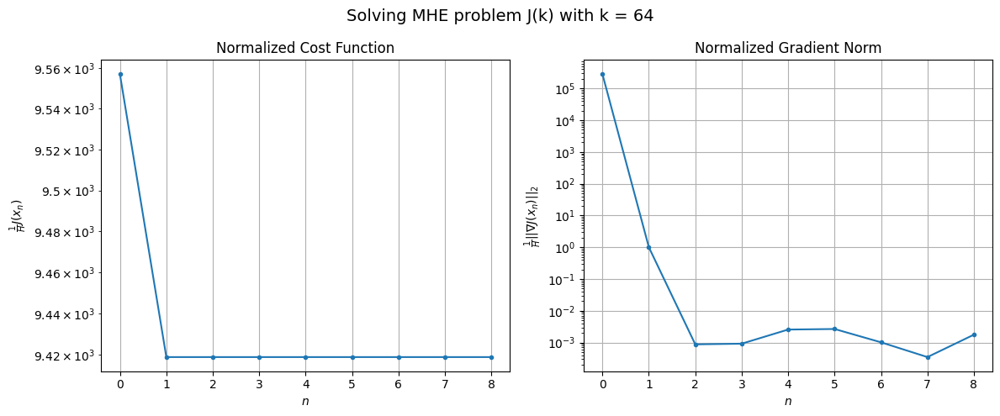

Windows:   5%|▍         | 16/346 [02:38<1:00:31, 11.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 473772.8591152149
Gradient norm: 14819503.717507657
Global estimation error: 50.4708388211074
Initial conditions estimation errors: 23.78090403148965 m, 24.65554374014193 m, 25.753400431429952 m, 26.65759133478699 m
Position estimation errors: 28.489121028123073 m, 27.52092271020018 m, 25.590442567875613 m, 24.44025340676007 m

[Gauss-Newton] Iteration 1
Cost function: 467289.450938337 (-1.37%)
Gradient norm: 18.959262085891087 (-100.00%)
Global estimation error: 53.59540954933779 (6.19%)
Initial conditions estimation errors: 25.86587181352235 m, 26.017534704898708 m, 27.22855448375935 m, 28.019724196383574 m
Position estimation errors: 25.971817376143477 m, 25.39195550996295 m, 22.970631874370767 m, 22.075392993396264 m

[Gauss-Newton] Iteration 2
Cost function: 467289.45094295853 (0.00%)
Gradient norm: 0.22159149602180123 (-98.83%)
Global estimation error: 53.593754106986665 (-0.00%)
Initial conditions estimation errors: 25.

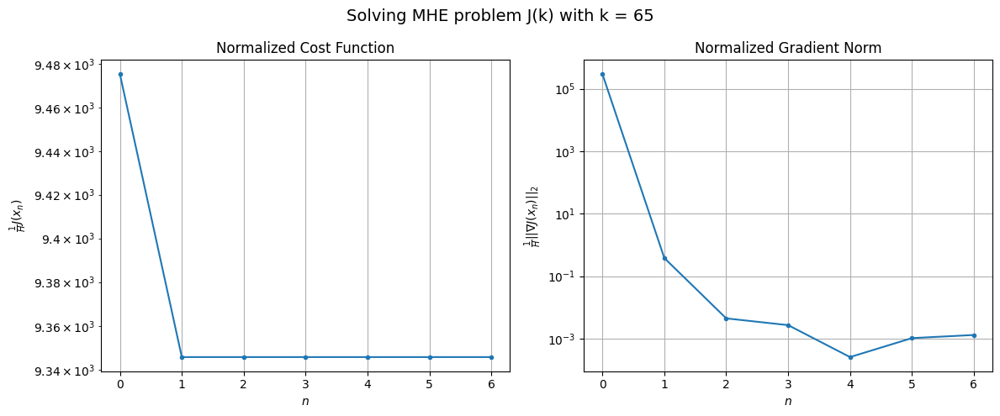

Windows:   5%|▍         | 17/346 [02:46<55:49, 10.18s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 475590.64085160184
Gradient norm: 15758003.760593511
Global estimation error: 47.534943359482554
Initial conditions estimation errors: 22.49328018249329 m, 22.80277465131931 m, 24.440031660108495 m, 25.225598289298862 m
Position estimation errors: 28.85986495833098 m, 28.083116663656703 m, 25.254465972218007 m, 24.135412728138053 m

[Gauss-Newton] Iteration 1
Cost function: 469338.12647690036 (-1.31%)
Gradient norm: 63.29857546793411 (-100.00%)
Global estimation error: 50.582664661904325 (6.41%)
Initial conditions estimation errors: 24.50159323791889 m, 25.16252734945178 m, 25.456180655431602 m, 26.0210980134622 m
Position estimation errors: 26.33659228199831 m, 25.300772125400478 m, 24.055006425417385 m, 22.420047589014494 m

[Gauss-Newton] Iteration 2
Cost function: 469338.1264397841 (-0.00%)
Gradient norm: 0.07690728031794343 (-99.88%)
Global estimation error: 50.58734737190941 (0.01%)
Initial conditions estimation errors: 

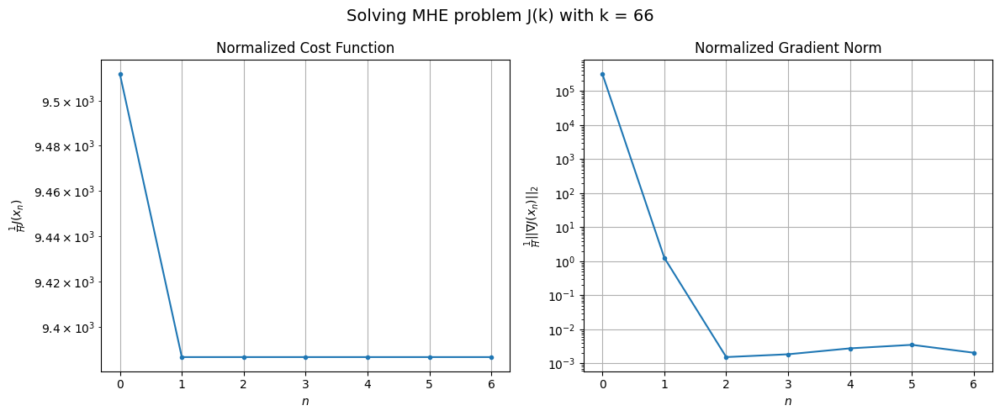

Windows:   5%|▌         | 18/346 [02:54<52:47,  9.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 483336.19433772477
Gradient norm: 17337533.388036486
Global estimation error: 45.25170043183665
Initial conditions estimation errors: 21.46756041890545 m, 22.24648382738279 m, 23.065333989751213 m, 23.662969832746974 m
Position estimation errors: 29.57431568706732 m, 28.38709019289295 m, 26.705701351164187 m, 24.55814036185227 m

[Gauss-Newton] Iteration 1
Cost function: 477036.2085477003 (-1.30%)
Gradient norm: 33.01772128844926 (-100.00%)
Global estimation error: 47.121597743487975 (4.13%)
Initial conditions estimation errors: 23.433139044266124 m, 23.318268979718397 m, 23.619355549884535 m, 23.868576294389953 m
Position estimation errors: 26.976549242951517 m, 26.55539883150521 m, 25.533032024610883 m, 23.701911522824272 m

[Gauss-Newton] Iteration 2
Cost function: 477036.20852845383 (-0.00%)
Gradient norm: 0.11708926207783746 (-99.65%)
Global estimation error: 47.117689038108274 (-0.01%)
Initial conditions estimation error

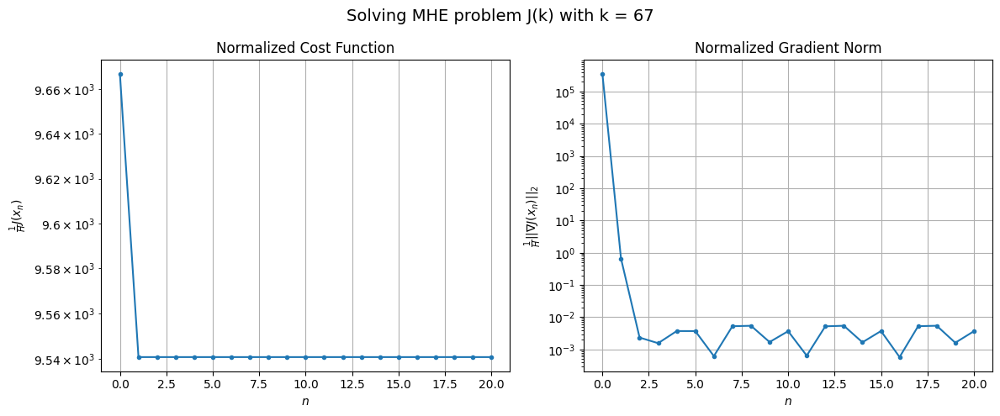

Windows:   5%|▌         | 19/346 [03:18<1:14:58, 13.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 496622.4240139727
Gradient norm: 18745877.228196822
Global estimation error: 42.33856950620596
Initial conditions estimation errors: 20.696028241027463 m, 20.777225849806005 m, 21.464024429835774 m, 21.72152308407623 m
Position estimation errors: 30.629925110864622 m, 29.978506358777693 m, 28.636674817726472 m, 26.224947595055248 m

[Gauss-Newton] Iteration 1
Cost function: 490154.3833733423 (-1.30%)
Gradient norm: 17.984974068199815 (-100.00%)
Global estimation error: 45.409822289602324 (7.25%)
Initial conditions estimation errors: 22.64528991530743 m, 23.04165869160581 m, 22.70244779555793 m, 22.425800433178285 m
Position estimation errors: 27.93383006428952 m, 26.940872712377246 m, 27.012034703574308 m, 25.14607703486067 m

[Gauss-Newton] Iteration 2
Cost function: 490154.38338137267 (0.00%)
Gradient norm: 0.1381843393182016 (-99.23%)
Global estimation error: 45.41085507722487 (0.00%)
Initial conditions estimation errors: 2

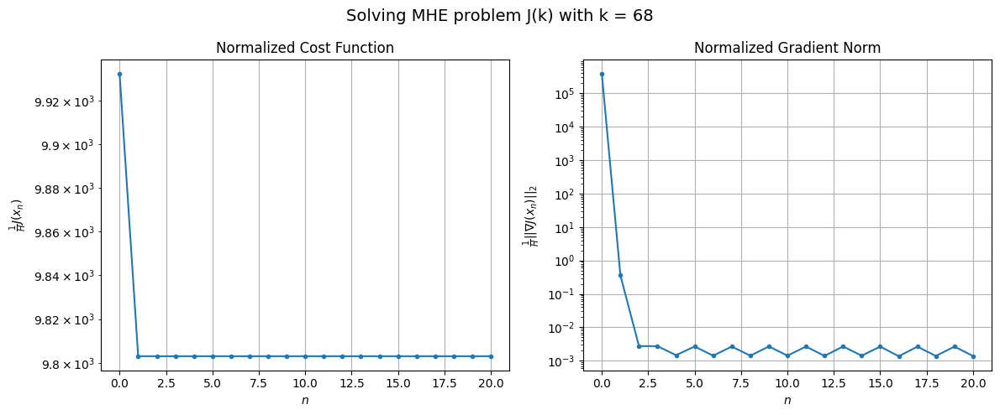

Windows:   6%|▌         | 20/346 [03:41<1:31:13, 16.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 515894.58849900414
Gradient norm: 20153830.144673552
Global estimation error: 41.060816507697524
Initial conditions estimation errors: 20.190951493204704 m, 20.76673571001486 m, 20.719365721202028 m, 20.439198266446468 m
Position estimation errors: 32.02009669681733 m, 30.80438500139403 m, 30.659002870432296 m, 28.243347546715516 m

[Gauss-Newton] Iteration 1
Cost function: 509176.2265160521 (-1.30%)
Gradient norm: 20.30347239490974 (-100.00%)
Global estimation error: 44.37888537567211 (8.08%)
Initial conditions estimation errors: 22.137383343583043 m, 22.652237758679895 m, 22.245211344011835 m, 21.712724798121045 m
Position estimation errors: 29.20632846186215 m, 28.156155055223934 m, 27.66320481155771 m, 26.04802851148773 m

[Gauss-Newton] Iteration 2
Cost function: 509176.2265115244 (-0.00%)
Gradient norm: 0.010431537505359453 (-99.95%)
Global estimation error: 44.37890133170872 (0.00%)
Initial conditions estimation errors:

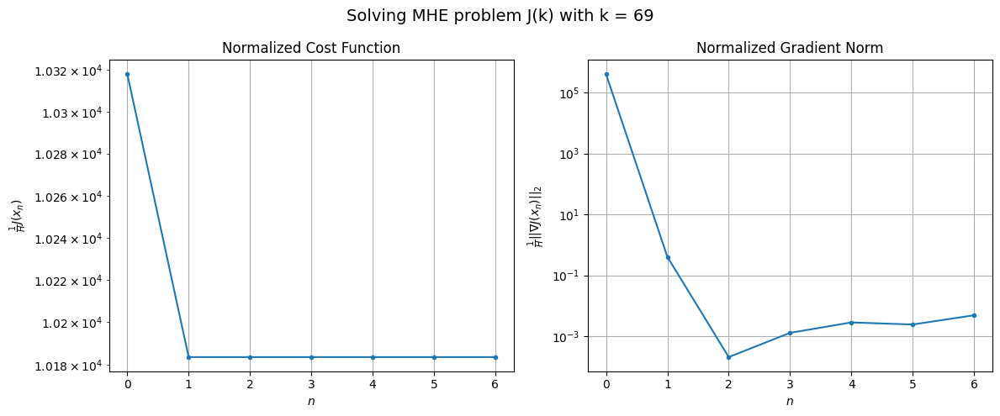

Windows:   6%|▌         | 21/346 [03:51<1:19:38, 14.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 541898.9758789574
Gradient norm: 21764664.00808777
Global estimation error: 40.47509095024542
Initial conditions estimation errors: 19.949445836066438 m, 20.680725496277592 m, 20.42059466953106 m, 19.88854587534882 m
Position estimation errors: 33.699793798750946 m, 32.42004905158122 m, 31.697130101380427 m, 29.570874084551505 m

[Gauss-Newton] Iteration 1
Cost function: 534643.5971018359 (-1.34%)
Gradient norm: 71.59214694018223 (-100.00%)
Global estimation error: 45.187707006007045 (11.64%)
Initial conditions estimation errors: 21.94956500533885 m, 22.883755285052114 m, 22.73587227502409 m, 22.793718773209555 m
Position estimation errors: 30.718915690577983 m, 28.71509199763071 m, 28.331097022866633 m, 26.64043172296954 m

[Gauss-Newton] Iteration 2
Cost function: 534643.5971053245 (0.00%)
Gradient norm: 0.2291566218208652 (-99.68%)
Global estimation error: 45.19121000688229 (0.01%)
Initial conditions estimation errors: 21.9

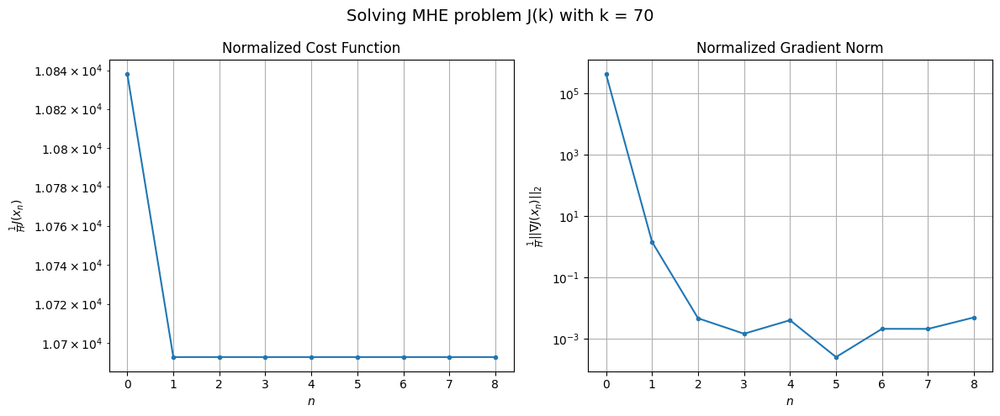

Windows:   6%|▋         | 22/346 [04:02<1:13:13, 13.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 574185.6387495351
Gradient norm: 23008309.59453605
Global estimation error: 41.484155257145915
Initial conditions estimation errors: 19.982033649019563 m, 21.084561972176825 m, 20.922215365747174 m, 20.960678028240807 m
Position estimation errors: 35.582984417465596 m, 33.333358824821346 m, 32.87698916152632 m, 30.895189765137307 m

[Gauss-Newton] Iteration 1
Cost function: 566335.7597797165 (-1.37%)
Gradient norm: 32.48024932241787 (-100.00%)
Global estimation error: 45.57783861297248 (9.87%)
Initial conditions estimation errors: 22.058699323751394 m, 23.976994395155852 m, 22.779867886017716 m, 22.291896184291037 m
Position estimation errors: 32.43698592436819 m, 29.942908945425653 m, 31.88136026886454 m, 30.172188138013095 m

[Gauss-Newton] Iteration 2
Cost function: 566335.7597717597 (-0.00%)
Gradient norm: 0.1918157244977475 (-99.41%)
Global estimation error: 45.577383693277795 (-0.00%)
Initial conditions estimation errors

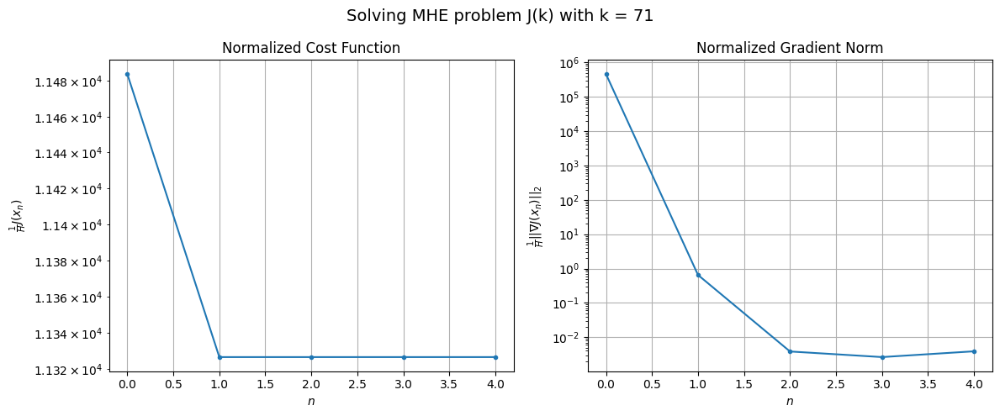

Windows:   7%|▋         | 23/346 [04:09<1:01:36, 11.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 612321.2285239823
Gradient norm: 23890459.84423461
Global estimation error: 42.131189232555855
Initial conditions estimation errors: 20.26117305550603 m, 22.359743367754515 m, 21.068426798924463 m, 20.510453584012975 m
Position estimation errors: 37.629474503749776 m, 34.95579002717742 m, 37.013788341696696 m, 35.140531504887186 m

[Gauss-Newton] Iteration 1
Cost function: 603653.1845009286 (-1.42%)
Gradient norm: 34.97668582826918 (-100.00%)
Global estimation error: 46.74226152438402 (10.94%)
Initial conditions estimation errors: 22.518373922724617 m, 23.747022060908293 m, 23.30034787178244 m, 23.894094519004106 m
Position estimation errors: 34.32778282652988 m, 32.51660197321593 m, 33.32519551145385 m, 32.209640585682735 m

[Gauss-Newton] Iteration 2
Cost function: 603653.184505185 (0.00%)
Gradient norm: 0.011111954224566798 (-99.97%)
Global estimation error: 46.74377355953451 (0.00%)
Initial conditions estimation errors: 22

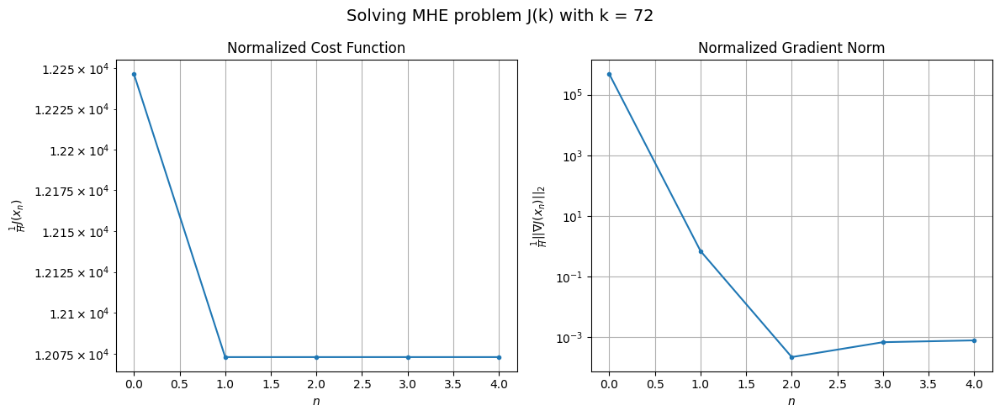

Windows:   7%|▋         | 24/346 [04:15<52:48,  9.84s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 657059.2650365678
Gradient norm: 24680569.847829066
Global estimation error: 43.50302078628782
Initial conditions estimation errors: 20.87141621725801 m, 22.2888733087482 m, 21.673096002718285 m, 22.14433899103878 m
Position estimation errors: 39.79143810599415 m, 37.794148864161556 m, 38.74968028024571 m, 37.71811148168036 m

[Gauss-Newton] Iteration 1
Cost function: 647371.2940520109 (-1.47%)
Gradient norm: 39.64230433530118 (-100.00%)
Global estimation error: 49.09043819745669 (12.84%)
Initial conditions estimation errors: 23.345141708489898 m, 24.302676399245524 m, 24.02795356351598 m, 26.398945584989228 m
Position estimation errors: 36.326007229991625 m, 35.06170142720565 m, 35.24298674588937 m, 34.393527182290946 m

[Gauss-Newton] Iteration 2
Cost function: 647371.294026242 (-0.00%)
Gradient norm: 0.06027588577327971 (-99.85%)
Global estimation error: 49.09211193671111 (0.00%)
Initial conditions estimation errors: 23.345

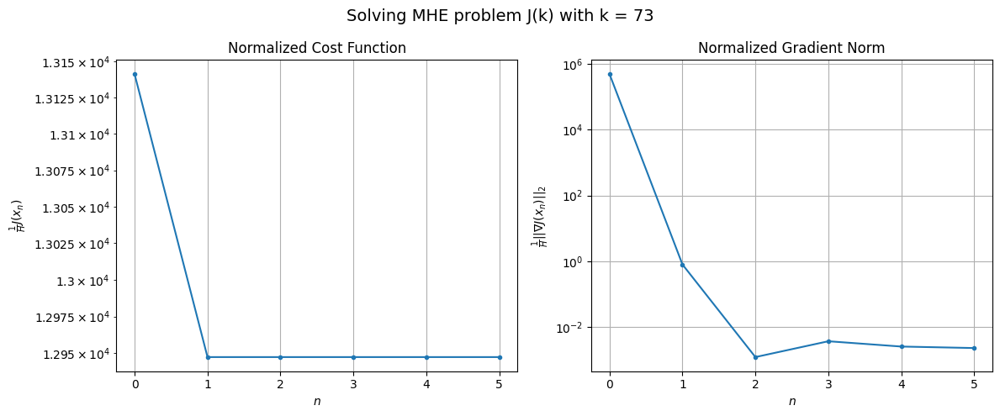

Windows:   7%|▋         | 25/346 [04:22<48:26,  9.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 708042.1013398931
Gradient norm: 24684184.663683057
Global estimation error: 46.03737377231793
Initial conditions estimation errors: 21.856169929809948 m, 22.98439568849451 m, 22.549679759930054 m, 24.59607377162133 m
Position estimation errors: 41.97026191534176 m, 40.53782771513278 m, 40.87782196977943 m, 40.34036999206543 m

[Gauss-Newton] Iteration 1
Cost function: 697314.3303822427 (-1.52%)
Gradient norm: 40.465048732222236 (-100.00%)
Global estimation error: 50.85088601820534 (10.46%)
Initial conditions estimation errors: 24.571888164585566 m, 25.758161119949175 m, 24.96950259320758 m, 26.364092565189974 m
Position estimation errors: 38.38761977707655 m, 37.170682487643724 m, 38.816379711559186 m, 37.795571659436625 m

[Gauss-Newton] Iteration 2
Cost function: 697314.3303653048 (-0.00%)
Gradient norm: 0.21732492361284464 (-99.46%)
Global estimation error: 50.85054897861248 (-0.00%)
Initial conditions estimation errors: 2

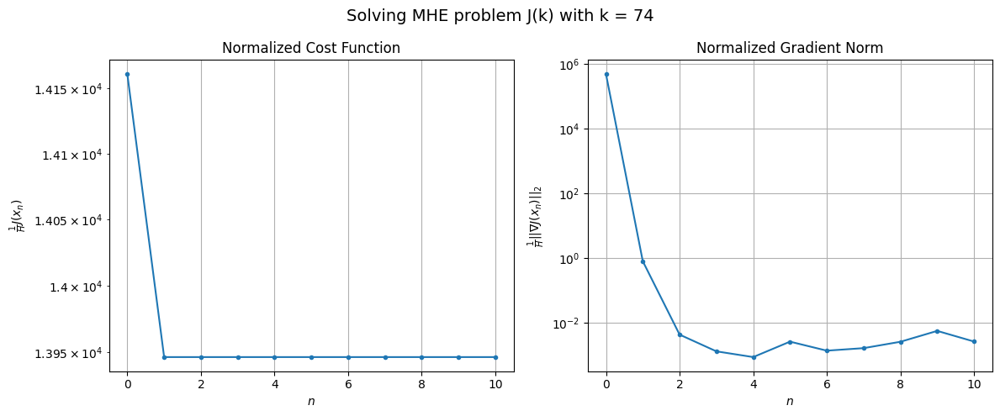

Windows:   8%|▊         | 26/346 [04:35<55:06, 10.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 764618.0405691233
Gradient norm: 24204688.675919376
Global estimation error: 48.09138264696985
Initial conditions estimation errors: 23.24065218915089 m, 24.53776208606564 m, 23.62307667359012 m, 24.748514811270436 m
Position estimation errors: 44.122946620727824 m, 42.77717610693401 m, 44.58236978271446 m, 43.77850752512208 m

[Gauss-Newton] Iteration 1
Cost function: 752909.284027136 (-1.53%)
Gradient norm: 194.55035917785108 (-100.00%)
Global estimation error: 55.29232454741219 (14.97%)
Initial conditions estimation errors: 26.165280664565557 m, 27.04976639922632 m, 26.608894181919545 m, 30.543120115670305 m
Position estimation errors: 40.46122277351392 m, 39.715326556297995 m, 40.3330125790881 m, 40.875090046794696 m

[Gauss-Newton] Iteration 2
Cost function: 752909.2839980851 (-0.00%)
Gradient norm: 0.06313133332876365 (-99.97%)
Global estimation error: 55.29325403902332 (0.00%)
Initial conditions estimation errors: 26.16

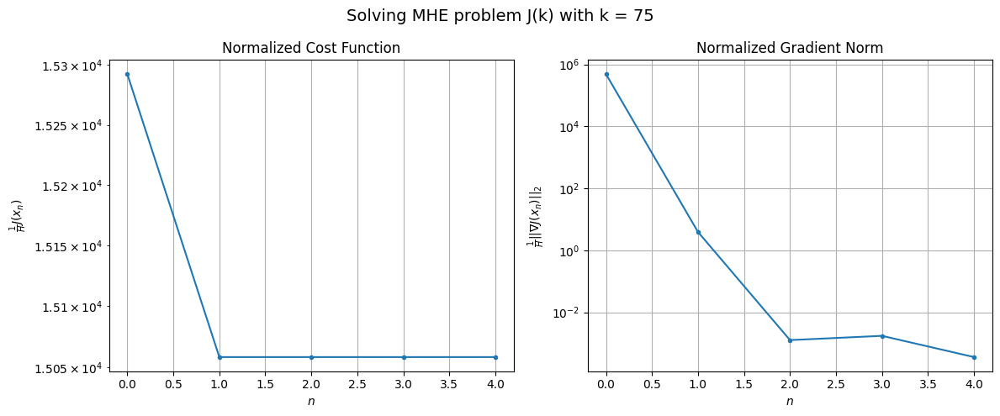

Windows:   8%|▊         | 27/346 [04:42<48:42,  9.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 824774.940902465
Gradient norm: 23493400.054743767
Global estimation error: 52.377876352386565
Initial conditions estimation errors: 24.960875938494162 m, 25.922982174399596 m, 25.360799826202285 m, 28.376218194664084 m
Position estimation errors: 46.23009677646485 m, 45.35390725545632 m, 46.2221810090084 m, 47.38785265142433 m

[Gauss-Newton] Iteration 1
Cost function: 811933.6273500592 (-1.56%)
Gradient norm: 92.34071399900488 (-100.00%)
Global estimation error: 57.33505285837274 (9.46%)
Initial conditions estimation errors: 28.098466601013108 m, 29.14404773831353 m, 27.849437320359936 m, 29.543211038880745 m
Position estimation errors: 42.504657278116184 m, 42.08345389706879 m, 44.56255245403366 m, 45.11740961914796 m

[Gauss-Newton] Iteration 2
Cost function: 811933.6273696339 (0.00%)
Gradient norm: 0.04654095178335925 (-99.95%)
Global estimation error: 57.33476966353755 (-0.00%)
Initial conditions estimation errors: 28.09

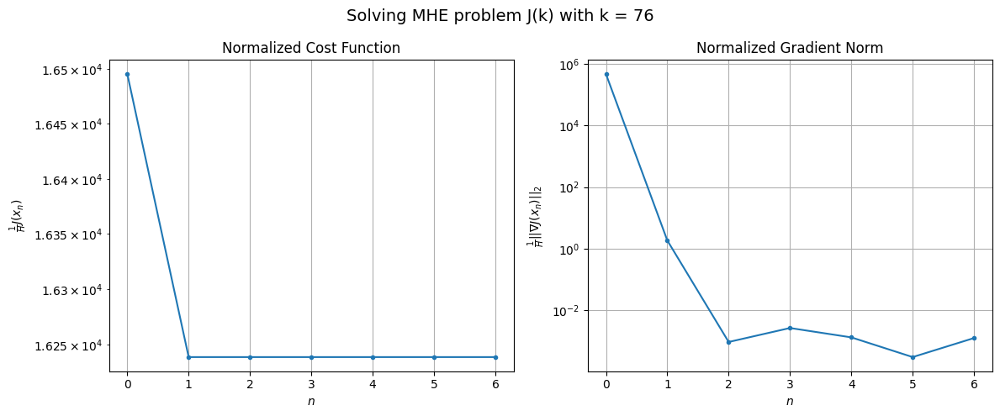

Windows:   8%|▊         | 28/346 [04:50<47:07,  8.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 888722.0390405512
Gradient norm: 22154937.539833948
Global estimation error: 54.52819290519628
Initial conditions estimation errors: 26.94591563255276 m, 27.96968339952657 m, 26.51338147541602 m, 27.603652768081474 m
Position estimation errors: 48.284218786296414 m, 47.76052914346465 m, 50.464282032090665 m, 51.40487899303496 m

[Gauss-Newton] Iteration 1
Cost function: 874829.2073268684 (-1.56%)
Gradient norm: 77.47893922708016 (-100.00%)
Global estimation error: 61.43574988570691 (12.67%)
Initial conditions estimation errors: 30.251817937543738 m, 31.0437363718131 m, 30.039321898500802 m, 31.513277012687503 m
Position estimation errors: 44.52375205023357 m, 43.82557126361193 m, 45.65092642021665 m, 46.99512004433405 m

[Gauss-Newton] Iteration 2
Cost function: 874829.2073630478 (0.00%)
Gradient norm: 0.10666667761025159 (-99.86%)
Global estimation error: 61.43593368064655 (0.00%)
Initial conditions estimation errors: 30.2518

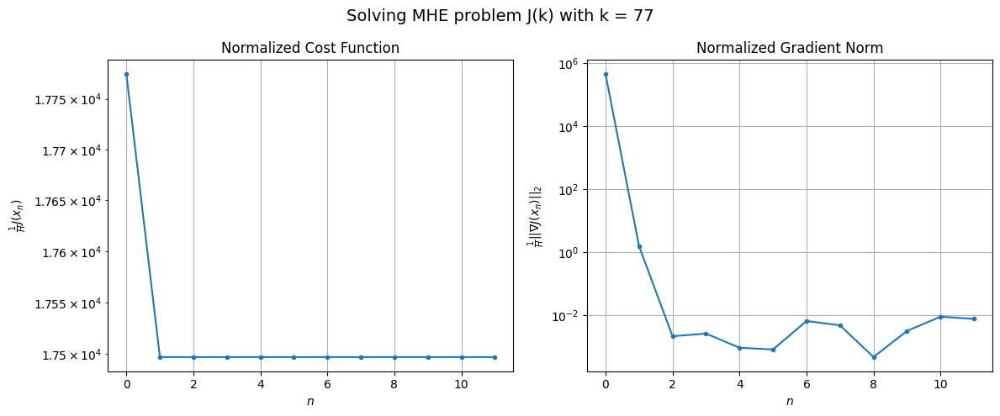

Windows:   8%|▊         | 29/346 [05:04<55:29, 10.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 956049.5047469407
Gradient norm: 20500484.391779687
Global estimation error: 58.65637389067074
Initial conditions estimation errors: 29.050105652767723 m, 29.91434016201908 m, 28.775127625080927 m, 29.559578932102802 m
Position estimation errors: 50.2950973992774 m, 49.45624755509424 m, 51.49989779645324 m, 53.232411592070356 m

[Gauss-Newton] Iteration 1
Cost function: 941158.2531492747 (-1.56%)
Gradient norm: 86.60992166762144 (-100.00%)
Global estimation error: 65.47502625214673 (11.62%)
Initial conditions estimation errors: 32.49250570331008 m, 33.25436360586179 m, 32.170015644739486 m, 33.02174285240982 m
Position estimation errors: 46.51840946595641 m, 45.743423305193346 m, 47.862399236917994 m, 49.15580140915372 m

[Gauss-Newton] Iteration 2
Cost function: 941158.2531189708 (-0.00%)
Gradient norm: 0.2778969067836628 (-99.68%)
Global estimation error: 65.47467017795479 (-0.00%)
Initial conditions estimation errors: 32.49

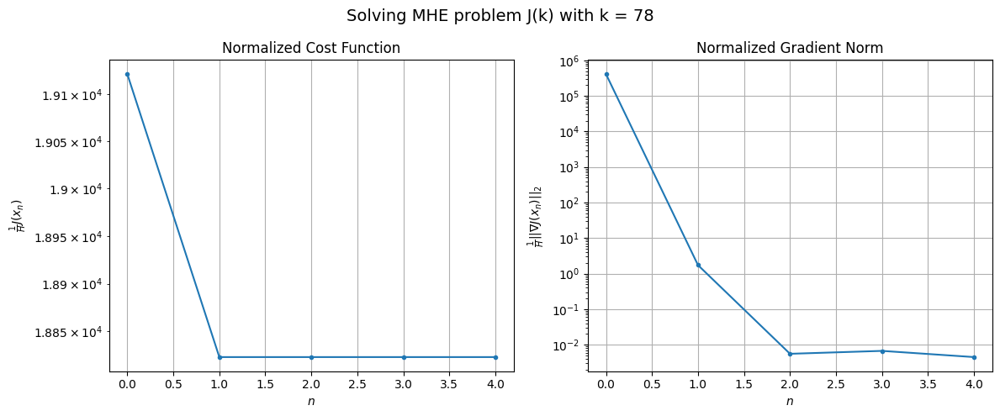

Windows:   9%|▊         | 30/346 [05:11<49:25,  9.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1025047.7512159264
Gradient norm: 18924341.06498264
Global estimation error: 62.39946182165412
Initial conditions estimation errors: 31.13074869471556 m, 31.965467617763107 m, 30.713162672179774 m, 30.97521184896428 m
Position estimation errors: 52.25108566108216 m, 51.349589822706065 m, 53.68521494820425 m, 55.33694795447958 m

[Gauss-Newton] Iteration 1
Cost function: 1009100.1067983926 (-1.56%)
Gradient norm: 83.85528332056721 (-100.00%)
Global estimation error: 69.40750761632856 (11.23%)
Initial conditions estimation errors: 34.69800850065476 m, 35.93740405616611 m, 34.12452571708933 m, 34.021368227388294 m
Position estimation errors: 48.45409974197204 m, 46.79965437469073 m, 50.153955087787075 m, 50.93295604602053 m

[Gauss-Newton] Iteration 2
Cost function: 1009100.1067890439 (-0.00%)
Gradient norm: 0.1350301135385379 (-99.84%)
Global estimation error: 69.40853169732883 (0.00%)
Initial conditions estimation errors: 34.69

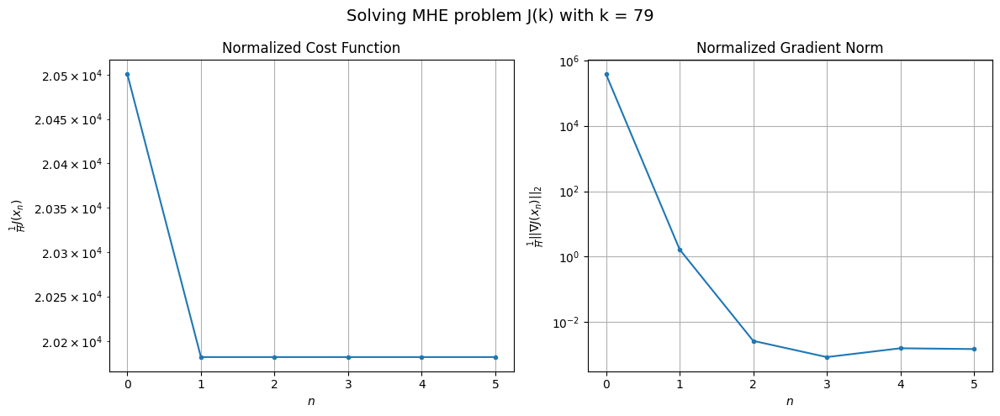

Windows:   9%|▉         | 31/346 [05:18<46:06,  8.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1096046.0892008739
Gradient norm: 16892119.381396454
Global estimation error: 66.11105140234595
Initial conditions estimation errors: 33.08935183218946 m, 34.5227602317281 m, 32.466482049082295 m, 32.09140754983851 m
Position estimation errors: 54.11772861032721 m, 52.27775048829251 m, 55.81604110954444 m, 56.79740730824452 m

[Gauss-Newton] Iteration 1
Cost function: 1079118.4527283828 (-1.54%)
Gradient norm: 96.8206504835759 (-100.00%)
Global estimation error: 74.26795481230522 (12.34%)
Initial conditions estimation errors: 36.76885505120072 m, 38.0780802994112 m, 36.765797836924264 m, 36.906659311614156 m
Position estimation errors: 50.31029109495566 m, 48.471012905022114 m, 50.929387178394386 m, 51.98579099803209 m

[Gauss-Newton] Iteration 2
Cost function: 1079118.4527245911 (-0.00%)
Gradient norm: 0.047940150450440894 (-99.95%)
Global estimation error: 74.26662378275158 (-0.00%)
Initial conditions estimation errors: 36.7

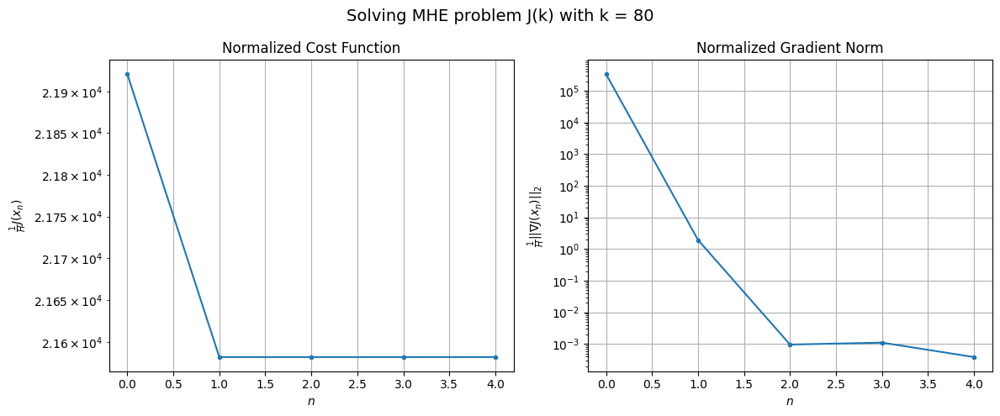

Windows:   9%|▉         | 32/346 [05:25<42:21,  8.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1168089.2364603889
Gradient norm: 14468109.278790101
Global estimation error: 70.380309095363
Initial conditions estimation errors: 34.87679105901585 m, 36.38593478661845 m, 34.86158440506216 m, 34.60806929009273 m
Position estimation errors: 55.90032841606076 m, 53.88758839875272 m, 56.556282284769985 m, 57.89420489095042 m

[Gauss-Newton] Iteration 1
Cost function: 1150370.5763071077 (-1.52%)
Gradient norm: 91.37090411886508 (-100.00%)
Global estimation error: 78.79007475958566 (11.95%)
Initial conditions estimation errors: 38.654176684540715 m, 40.86424212711682 m, 39.07881490807212 m, 38.94454481922584 m
Position estimation errors: 52.10303618380921 m, 49.06518893970654 m, 51.96246513855023 m, 52.844040664430345 m

[Gauss-Newton] Iteration 2
Cost function: 1150370.5763586606 (0.00%)
Gradient norm: 0.1460442055175366 (-99.84%)
Global estimation error: 78.79083236443405 (0.00%)
Initial conditions estimation errors: 38.654181

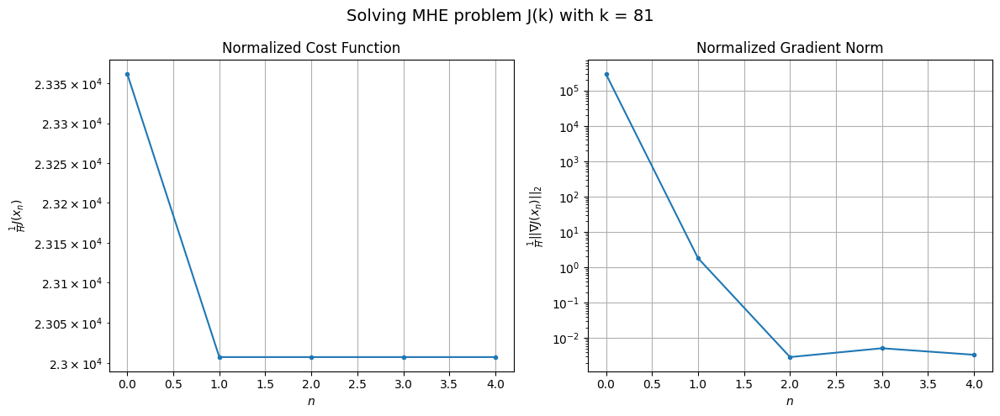

Windows:  10%|▉         | 33/346 [05:32<40:02,  7.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1240744.0645836412
Gradient norm: 12148019.244272856
Global estimation error: 74.50543722765363
Initial conditions estimation errors: 36.48176572728814 m, 38.973711510693384 m, 36.96582836140084 m, 36.533639588779714 m
Position estimation errors: 57.64870668372476 m, 54.38228143521653 m, 57.49943736387599 m, 58.595334751924135 m

[Gauss-Newton] Iteration 1
Cost function: 1222220.3930792955 (-1.49%)
Gradient norm: 100.41913400853092 (-100.00%)
Global estimation error: 83.49419184120497 (12.06%)
Initial conditions estimation errors: 40.36088345163544 m, 43.120196555102005 m, 41.64702151680572 m, 41.81437092326265 m
Position estimation errors: 53.853114363225686 m, 50.16636482324059 m, 52.49620274986944 m, 52.7045339169763 m

[Gauss-Newton] Iteration 2
Cost function: 1222220.393096399 (0.00%)
Gradient norm: 0.14986143353116907 (-99.85%)
Global estimation error: 83.49324784776508 (-0.00%)
Initial conditions estimation errors: 40.3

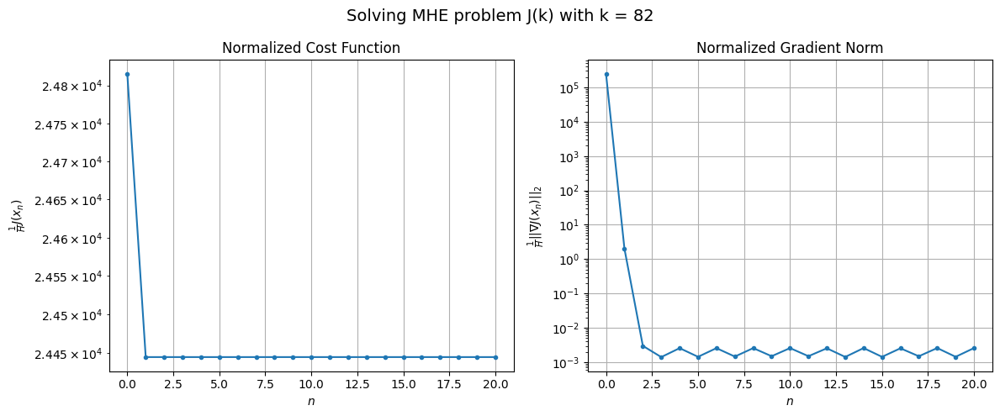

Windows:  10%|▉         | 34/346 [05:56<1:06:39, 12.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1317579.2185651453
Gradient norm: 9882463.43005101
Global estimation error: 78.71994315728264
Initial conditions estimation errors: 37.91084094843842 m, 40.931859792912164 m, 39.3034728901764 m, 39.23526394684507 m
Position estimation errors: 59.40552190193903 m, 55.52305427342176 m, 58.03123337800646 m, 58.405063081436936 m

[Gauss-Newton] Iteration 1
Cost function: 1298093.5191761246 (-1.48%)
Gradient norm: 111.82206795220196 (-100.00%)
Global estimation error: 85.18606124234618 (8.21%)
Initial conditions estimation errors: 41.90889390932832 m, 44.78419482758625 m, 42.388328205482956 m, 41.205618583153026 m
Position estimation errors: 55.58414289582311 m, 51.994245107404794 m, 55.592996128468 m, 56.71400594391755 m

[Gauss-Newton] Iteration 2
Cost function: 1298093.5191492885 (-0.00%)
Gradient norm: 0.07689018081297441 (-99.93%)
Global estimation error: 85.18521588592517 (-0.00%)
Initial conditions estimation errors: 41.9088

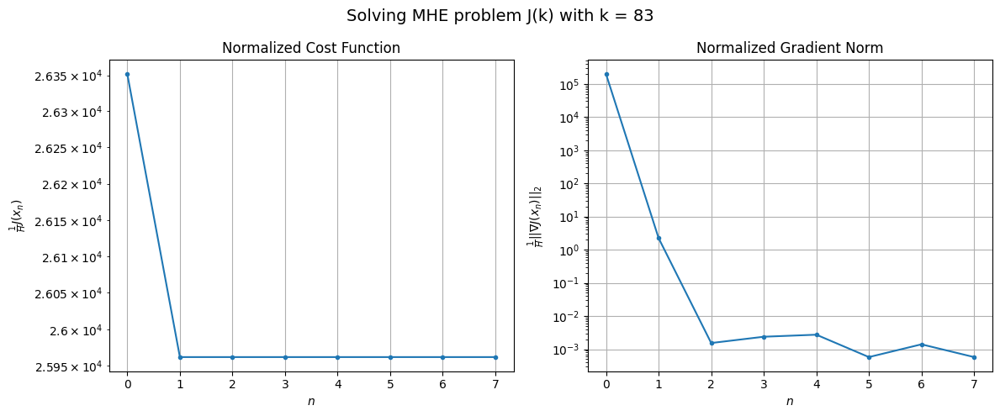

Windows:  10%|█         | 35/346 [06:06<1:01:52, 11.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1397124.830545779
Gradient norm: 7700807.290398496
Global estimation error: 79.72530685636681
Initial conditions estimation errors: 39.15856937544245 m, 42.2403973676493 m, 39.64070844408933 m, 38.30249381684493 m
Position estimation errors: 61.19678142770068 m, 57.43149061787037 m, 61.21922536794663 m, 62.499702298350364 m

[Gauss-Newton] Iteration 1
Cost function: 1376541.8177142204 (-1.47%)
Gradient norm: 111.68749700766668 (-100.00%)
Global estimation error: 88.63054010657726 (11.17%)
Initial conditions estimation errors: 43.28905349610195 m, 46.26453571352334 m, 44.32915249265008 m, 43.3120780546693 m
Position estimation errors: 57.32616150288864 m, 53.66177394086893 m, 56.74348339317353 m, 57.3474591887381 m

[Gauss-Newton] Iteration 2
Cost function: 1376541.8177166316 (0.00%)
Gradient norm: 0.10437159848504154 (-99.91%)
Global estimation error: 88.6323667658027 (0.00%)
Initial conditions estimation errors: 43.2890582337

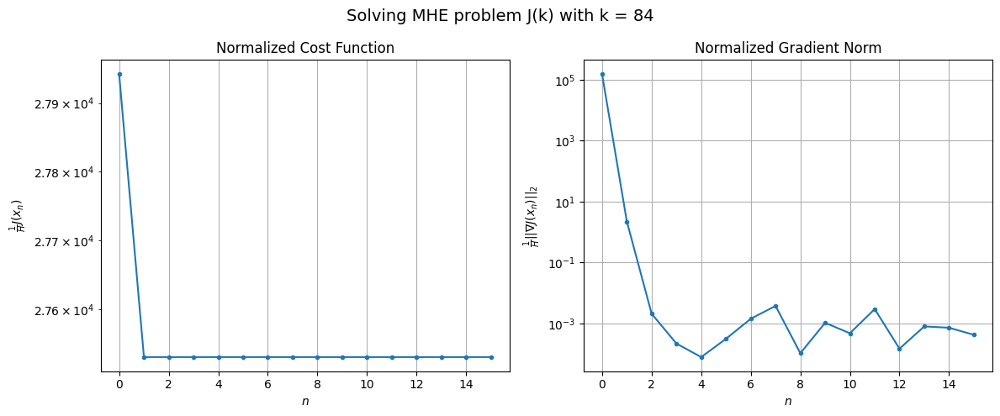

Windows:  10%|█         | 36/346 [06:25<1:11:34, 13.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1480701.5369644016
Gradient norm: 5647706.473177792
Global estimation error: 82.55820975349916
Initial conditions estimation errors: 40.201660090710824 m, 43.37779510227742 m, 41.271875234189395 m, 40.18293956517818 m
Position estimation errors: 63.040446815576196 m, 59.2081964571434 m, 62.43071890745244 m, 63.15197199005235 m

[Gauss-Newton] Iteration 1
Cost function: 1458941.1306505415 (-1.47%)
Gradient norm: 111.35742510560577 (-100.00%)
Global estimation error: 89.69548313124896 (8.65%)
Initial conditions estimation errors: 44.46109956920139 m, 46.79814080409848 m, 44.888252954222196 m, 43.16773406294445 m
Position estimation errors: 59.09405452291077 m, 56.22256480548623 m, 59.3647414346156 m, 60.646103268577384 m

[Gauss-Newton] Iteration 2
Cost function: 1458941.13066192 (0.00%)
Gradient norm: 0.14276858828921962 (-99.87%)
Global estimation error: 89.69185821630744 (-0.00%)
Initial conditions estimation errors: 44.46110

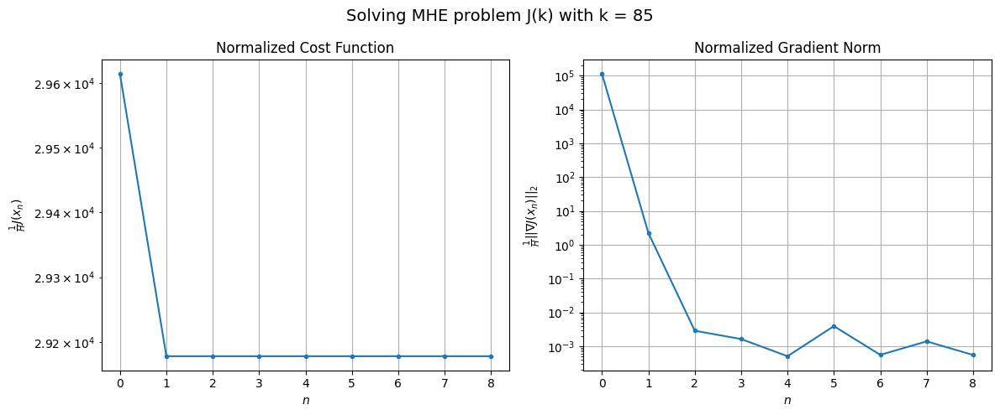

Windows:  11%|█         | 37/346 [06:36<1:07:04, 13.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1570672.1130611936
Gradient norm: 3892687.504570305
Global estimation error: 82.85246224338755
Initial conditions estimation errors: 41.0218841098655 m, 43.506777689252466 m, 41.42829748807466 m, 39.655693571048516 m
Position estimation errors: 64.92759901862293 m, 61.924738337427804 m, 65.18292417507264 m, 66.56433130256629 m

[Gauss-Newton] Iteration 1
Cost function: 1547733.993834226 (-1.46%)
Gradient norm: 121.10630179729725 (-100.00%)
Global estimation error: 91.74982606139457 (10.74%)
Initial conditions estimation errors: 45.40192759397343 m, 47.72986466135536 m, 45.914359626359754 m, 44.38928515241996 m
Position estimation errors: 60.89244367204784 m, 57.99310139241287 m, 60.97925698125075 m, 62.054663485661045 m

[Gauss-Newton] Iteration 2
Cost function: 1547733.9938656474 (0.00%)
Gradient norm: 0.3141652089551823 (-99.74%)
Global estimation error: 91.74937900228275 (-0.00%)
Initial conditions estimation errors: 45.401

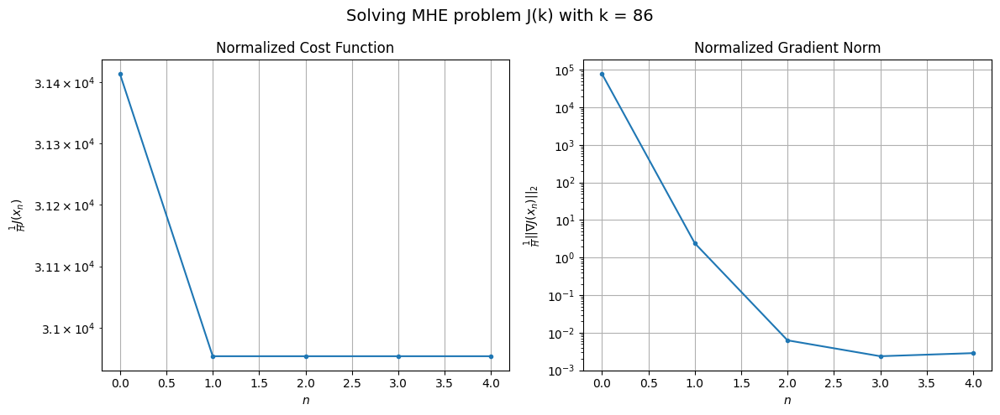

Windows:  11%|█         | 38/346 [06:42<57:18, 11.16s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 1667698.6171558604
Gradient norm: 2505601.668541769
Global estimation error: 84.28640196967305
Initial conditions estimation errors: 41.64012867752536 m, 44.123049271065966 m, 42.152108483367854 m, 40.57872759756539 m
Position estimation errors: 66.83212940048756 m, 63.82785899913067 m, 66.90491898180439 m, 68.07922010159062 m

[Gauss-Newton] Iteration 1
Cost function: 1643663.7011997632 (-1.44%)
Gradient norm: 117.66088878269115 (-100.00%)
Global estimation error: 93.5418310570433 (10.98%)
Initial conditions estimation errors: 46.12626942082146 m, 48.059393252649194 m, 46.732239133866045 m, 46.13906067460422 m
Position estimation errors: 62.70334147187799 m, 60.270950432697 m, 62.64011260767523 m, 62.795079345968176 m

[Gauss-Newton] Iteration 2
Cost function: 1643663.7012196132 (0.00%)
Gradient norm: 0.14965387736081825 (-99.87%)
Global estimation error: 93.53981509998522 (-0.00%)
Initial conditions estimation errors: 46.126

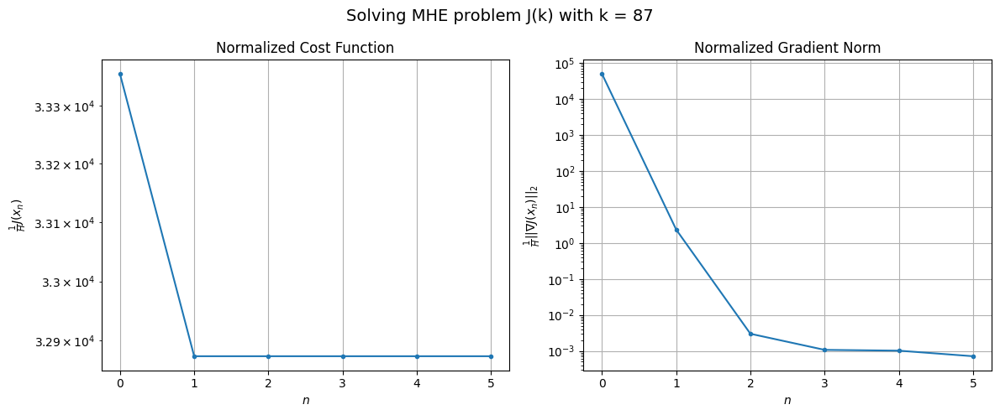

Windows:  11%|█▏        | 39/346 [06:50<52:09, 10.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1774476.0559984026
Gradient norm: 1220838.9280415976
Global estimation error: 85.6110175630558
Initial conditions estimation errors: 42.12688547744685 m, 44.19158915964024 m, 42.74545768560381 m, 42.12456747136138 m
Position estimation errors: 68.71427221510083 m, 66.22367620445262 m, 68.6253432501744 m, 68.85767547947277 m

[Gauss-Newton] Iteration 1
Cost function: 1749277.114074065 (-1.42%)
Gradient norm: 122.57748247972766 (-99.99%)
Global estimation error: 94.7531544944548 (10.68%)
Initial conditions estimation errors: 46.71291504458148 m, 48.5921061326284 m, 47.554394863983084 m, 46.620038325656914 m
Position estimation errors: 64.47102197678585 m, 62.16087468817874 m, 64.20423191869851 m, 64.59467939417058 m

[Gauss-Newton] Iteration 2
Cost function: 1749277.114088952 (0.00%)
Gradient norm: 0.5049654893742997 (-99.59%)
Global estimation error: 94.75398079876135 (0.00%)
Initial conditions estimation errors: 46.71291897780

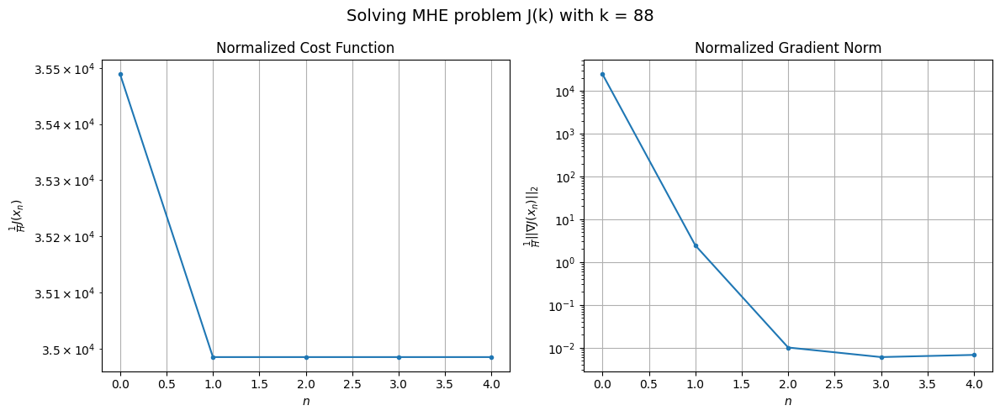

Windows:  12%|█▏        | 40/346 [06:57<46:05,  9.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1888609.9421431853
Gradient norm: 1119654.688776339
Global estimation error: 86.63837837318728
Initial conditions estimation errors: 42.606096638868536 m, 44.611554407921204 m, 43.45713742503855 m, 42.56986439577367 m
Position estimation errors: 70.51854471077765 m, 68.1583653250177 m, 70.18629032168647 m, 70.63026237029577 m

[Gauss-Newton] Iteration 1
Cost function: 1861974.5568709895 (-1.41%)
Gradient norm: 120.46710509405314 (-99.99%)
Global estimation error: 95.76934082378551 (10.54%)
Initial conditions estimation errors: 47.320118271922155 m, 48.95967032417822 m, 48.248709779627184 m, 46.98471006552362 m
Position estimation errors: 66.13942580505302 m, 64.11520883966942 m, 65.57464146667529 m, 66.46150872822305 m

[Gauss-Newton] Iteration 2
Cost function: 1861974.5569193847 (0.00%)
Gradient norm: 0.30695275310121795 (-99.75%)
Global estimation error: 95.76928892756823 (-0.00%)
Initial conditions estimation errors: 47.320

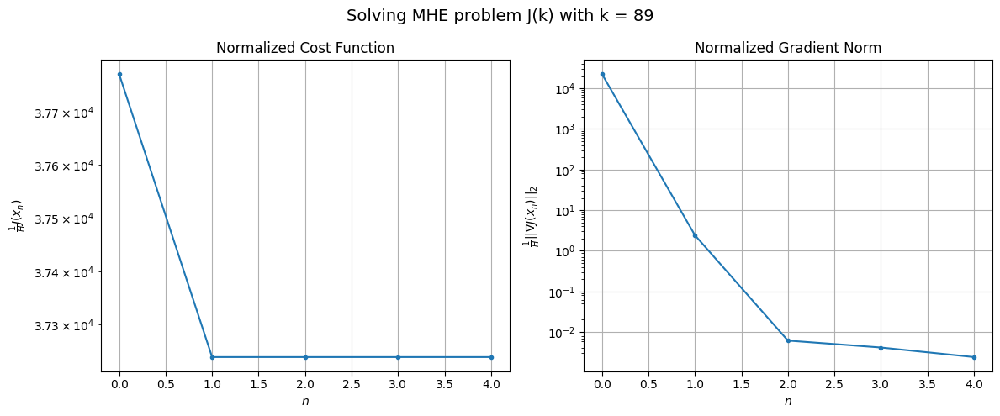

Windows:  12%|█▏        | 41/346 [07:04<43:17,  8.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2010231.3084515505
Gradient norm: 1571219.3422480116
Global estimation error: 87.79240536550563
Initial conditions estimation errors: 43.24311243068965 m, 45.018371948357334 m, 44.23921098441117 m, 43.05527728950501 m
Position estimation errors: 72.2106426770827 m, 70.15894995335346 m, 71.56465150649774 m, 72.42070465865632 m

[Gauss-Newton] Iteration 1
Cost function: 1982555.0371322082 (-1.38%)
Gradient norm: 121.94978630098173 (-99.99%)
Global estimation error: 97.79904362669829 (11.40%)
Initial conditions estimation errors: 48.048158543028876 m, 49.95090961357137 m, 48.98723430808817 m, 48.59179788772104 m
Position estimation errors: 67.7256431397685 m, 65.45409579022892 m, 67.06746639539543 m, 67.19761717979927 m

[Gauss-Newton] Iteration 2
Cost function: 1982555.0371204321 (-0.00%)
Gradient norm: 0.05659014686157057 (-99.95%)
Global estimation error: 97.79974624032272 (0.00%)
Initial conditions estimation errors: 48.04816

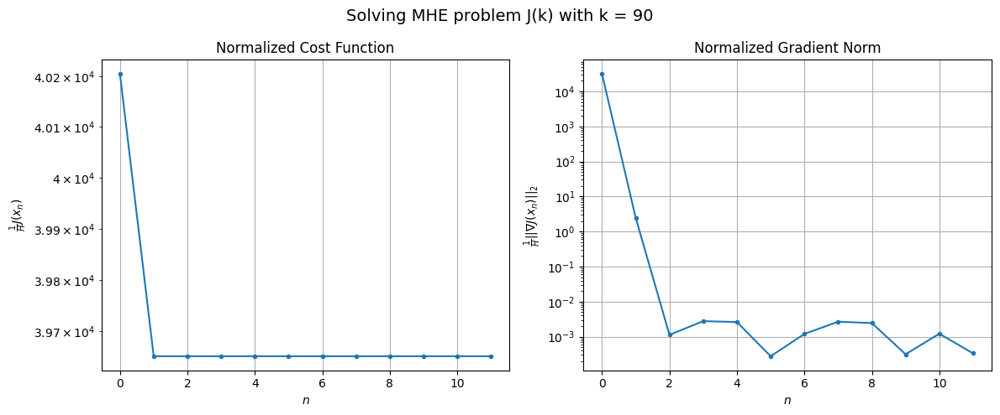

Windows:  12%|█▏        | 42/346 [07:20<55:04, 10.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2139550.079156457
Gradient norm: 2047351.5944909912
Global estimation error: 90.1201305578998
Initial conditions estimation errors: 44.11158414712349 m, 46.162090375617474 m, 45.14602952055892 m, 44.796023848576674 m
Position estimation errors: 73.83142869629737 m, 71.54635855010022 m, 73.11409467317677 m, 73.21811422134716 m

[Gauss-Newton] Iteration 1
Cost function: 2110507.878156637 (-1.36%)
Gradient norm: 114.82141211730462 (-99.99%)
Global estimation error: 100.96477335229453 (12.03%)
Initial conditions estimation errors: 49.02539138969532 m, 51.820356607706934 m, 50.16726743284743 m, 50.87505755536427 m
Position estimation errors: 69.20893298024286 m, 66.12633151252547 m, 68.37688181786058 m, 67.43573175984707 m

[Gauss-Newton] Iteration 2
Cost function: 2110507.8781586615 (0.00%)
Gradient norm: 0.263905372571448 (-99.77%)
Global estimation error: 100.96753395334437 (0.00%)
Initial conditions estimation errors: 49.025394

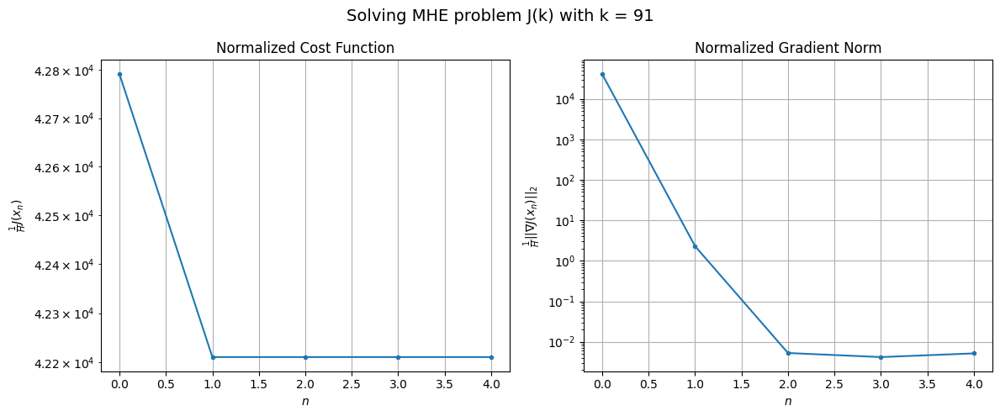

Windows:  12%|█▏        | 43/346 [07:27<48:26,  9.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2274333.4103037342
Gradient norm: 2309094.4490014073
Global estimation error: 93.68606457912797
Initial conditions estimation errors: 45.29309618564799 m, 48.21266885561777 m, 46.528410374102414 m, 47.28891583206574 m
Position estimation errors: 75.3705193243352 m, 72.26517198827756 m, 74.46144043698854 m, 73.4880814600166 m

[Gauss-Newton] Iteration 1
Cost function: 2244055.9507352924 (-1.33%)
Gradient norm: 121.83603583079831 (-99.99%)
Global estimation error: 103.37786973515573 (10.34%)
Initial conditions estimation errors: 50.30865667289428 m, 53.08607390621152 m, 51.582110199917835 m, 51.74126454192183 m
Position estimation errors: 70.63061809126069 m, 67.59503306373703 m, 69.62547479560615 m, 69.31818728798964 m

[Gauss-Newton] Iteration 2
Cost function: 2244055.950726664 (-0.00%)
Gradient norm: 0.038721789816477704 (-99.97%)
Global estimation error: 103.3783311719079 (0.00%)
Initial conditions estimation errors: 50.3086

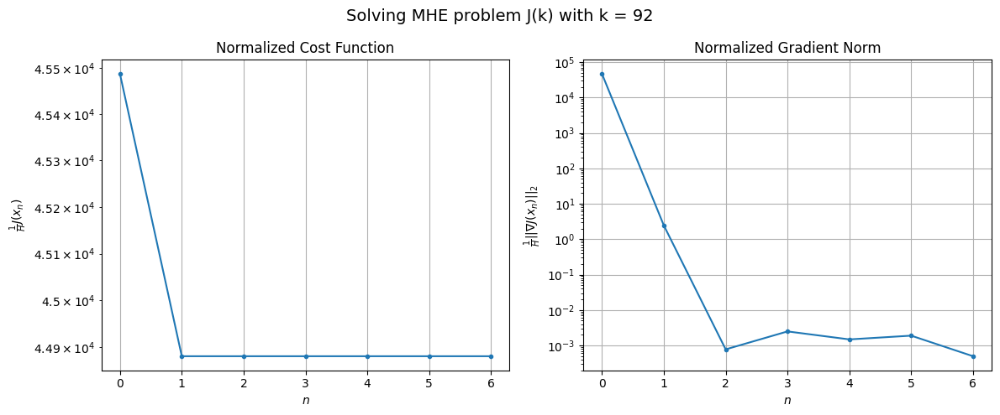

Windows:  13%|█▎        | 44/346 [07:36<47:58,  9.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2412711.97064243
Gradient norm: 2404110.1383055346
Global estimation error: 96.54302680242617
Initial conditions estimation errors: 46.79399605455226 m, 49.68415577786512 m, 48.17082464645139 m, 48.39336643570953 m
Position estimation errors: 76.8654244899693 m, 73.80547450976435 m, 75.79135790586452 m, 75.40104950620096 m

[Gauss-Newton] Iteration 1
Cost function: 2380957.522860269 (-1.32%)
Gradient norm: 153.76522813015288 (-99.99%)
Global estimation error: 104.3676166160355 (8.10%)
Initial conditions estimation errors: 51.93261842273718 m, 53.84816973854084 m, 52.95769629258277 m, 49.91434847137026 m
Position estimation errors: 71.99683215908577 m, 69.81016495902699 m, 71.26294577130427 m, 74.05791645769455 m

[Gauss-Newton] Iteration 2
Cost function: 2380957.5228491286 (-0.00%)
Gradient norm: 0.045652400437278494 (-99.97%)
Global estimation error: 104.36378050468468 (-0.00%)
Initial conditions estimation errors: 51.9326214

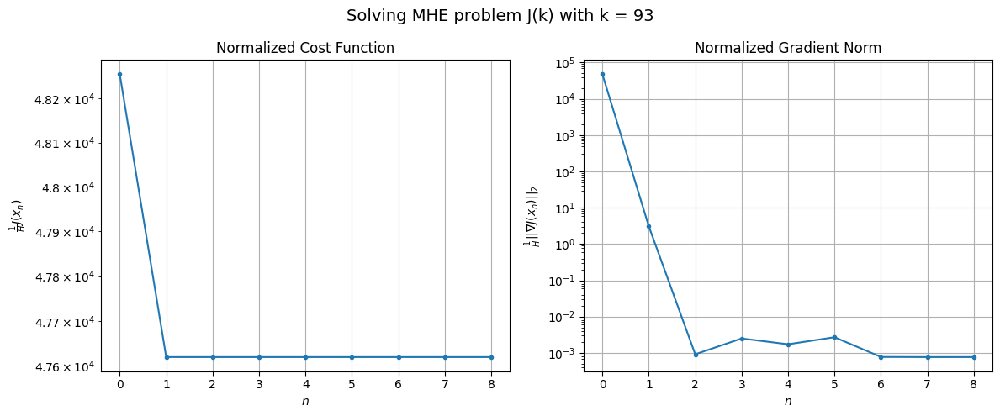

Windows:  13%|█▎        | 45/346 [07:48<50:41, 10.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2553032.0498206215
Gradient norm: 2389608.469937108
Global estimation error: 97.90959130226005
Initial conditions estimation errors: 48.60831902437081 m, 50.61940037407647 m, 49.70290861743697 m, 46.8060024101684 m
Position estimation errors: 78.30475941346093 m, 76.09139681717744 m, 77.50932335355722 m, 80.20444069041052 m

[Gauss-Newton] Iteration 1
Cost function: 2519540.2973697768 (-1.31%)
Gradient norm: 117.98203640440109 (-100.00%)
Global estimation error: 109.33935294020004 (11.67%)
Initial conditions estimation errors: 53.8909690911194 m, 56.84199915974995 m, 54.64894560449629 m, 53.22895271716997 m
Position estimation errors: 73.29646827787667 m, 70.15114181661332 m, 72.84066267976442 m, 74.0632803933307 m

[Gauss-Newton] Iteration 2
Cost function: 2519540.297374816 (0.00%)
Gradient norm: 0.15738464948644135 (-99.87%)
Global estimation error: 109.33976051310437 (0.00%)
Initial conditions estimation errors: 53.89097218

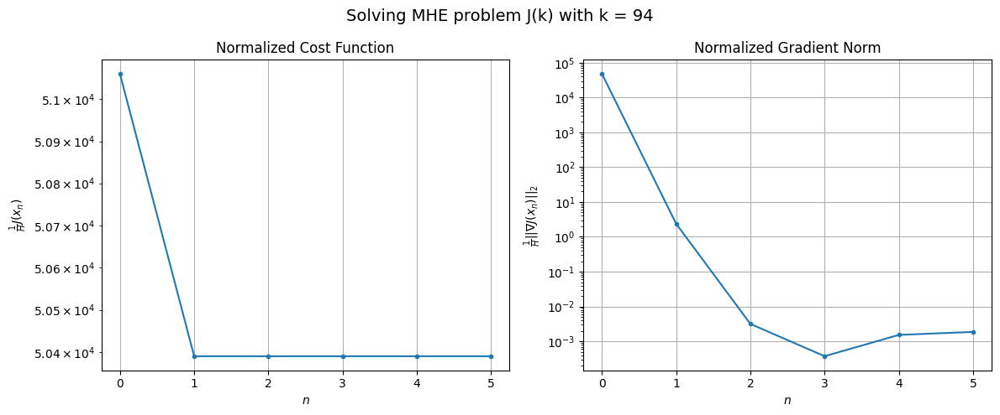

Windows:  13%|█▎        | 46/346 [07:56<47:12,  9.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2691407.068364815
Gradient norm: 2603977.1603045543
Global estimation error: 103.09535636086282
Initial conditions estimation errors: 50.69548070265317 m, 53.69865516568077 m, 51.549987915466545 m, 50.176289944631286 m
Position estimation errors: 79.64742384901184 m, 76.50394006139838 m, 79.1577100311276 m, 80.32832983143018 m

[Gauss-Newton] Iteration 1
Cost function: 2656193.1289811763 (-1.31%)
Gradient norm: 129.24504373737133 (-100.00%)
Global estimation error: 114.13638318207192 (10.71%)
Initial conditions estimation errors: 56.12459951412489 m, 58.804873473350426 m, 57.079502114551495 m, 56.22317731036865 m
Position estimation errors: 74.512817025346 m, 71.64066722430012 m, 73.84304557660427 m, 74.51526624070551 m

[Gauss-Newton] Iteration 2
Cost function: 2656193.1289645694 (-0.00%)
Gradient norm: 0.3107901006974845 (-99.76%)
Global estimation error: 114.1385231591806 (0.00%)
Initial conditions estimation errors: 56.124

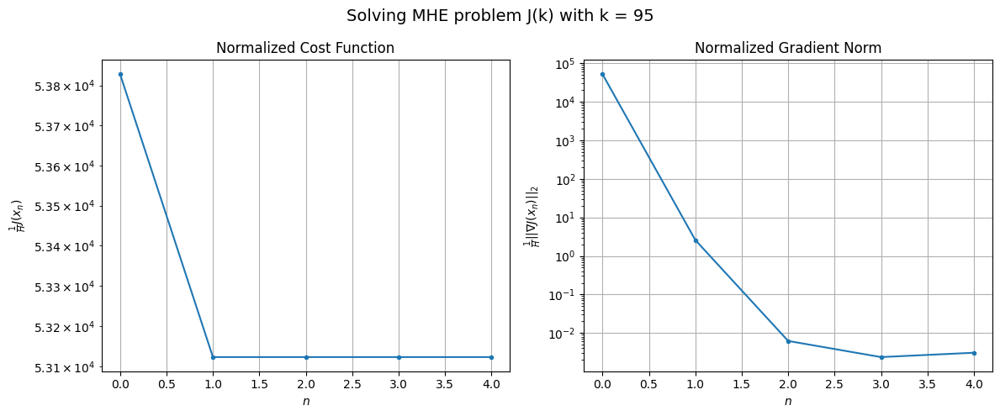

Windows:  14%|█▎        | 47/346 [08:03<43:03,  8.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2825197.5085041635
Gradient norm: 3102184.229759948
Global estimation error: 108.01130808785373
Initial conditions estimation errors: 52.9771435166253 m, 55.72848371566623 m, 54.031225584739325 m, 53.2429747921953 m
Position estimation errors: 80.86106918735794 m, 77.99064765420296 m, 80.15166052811756 m, 80.74851326597718 m

[Gauss-Newton] Iteration 1
Cost function: 2788035.7630793485 (-1.32%)
Gradient norm: 284.50606112454454 (-99.99%)
Global estimation error: 116.59715115879388 (7.95%)
Initial conditions estimation errors: 58.56231583402074 m, 60.11691413246748 m, 59.35444230845606 m, 55.03038688729518 m
Position estimation errors: 75.589405865364 m, 73.77737915802734 m, 74.9750588335898 m, 79.14314394883814 m

[Gauss-Newton] Iteration 2
Cost function: 2788035.7630576077 (-0.00%)
Gradient norm: 0.2549259634145596 (-99.91%)
Global estimation error: 116.59233084953757 (-0.00%)
Initial conditions estimation errors: 58.56231924

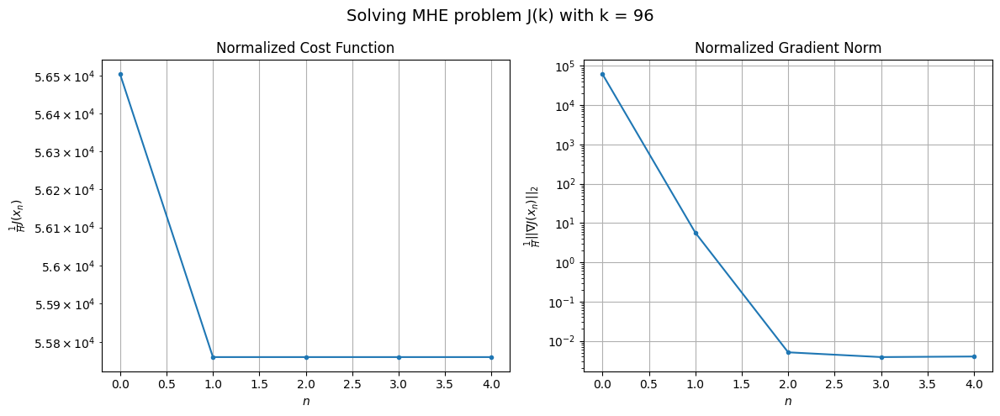

Windows:  14%|█▍        | 48/346 [08:09<39:53,  8.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2951335.1903942055
Gradient norm: 3730341.26812441
Global estimation error: 110.48255135360193
Initial conditions estimation errors: 55.37925829247554 m, 57.017215132937196 m, 56.26897424399056 m, 52.176225347255475 m
Position estimation errors: 81.91533752502546 m, 80.07436227326798 m, 81.25951234305597 m, 85.1828473642782 m

[Gauss-Newton] Iteration 1
Cost function: 2912169.1239827843 (-1.33%)
Gradient norm: 276.09457042199494 (-99.99%)
Global estimation error: 123.70151862754676 (11.96%)
Initial conditions estimation errors: 61.12261002158043 m, 63.0828410868586 m, 61.81158285009922 m, 61.367426946846535 m
Position estimation errors: 76.51157698654669 m, 74.30092589276131 m, 76.01076035735119 m, 76.37160676956735 m

[Gauss-Newton] Iteration 2
Cost function: 2912169.1239338783 (-0.00%)
Gradient norm: 0.13657994140748134 (-99.95%)
Global estimation error: 123.71436167318443 (0.01%)
Initial conditions estimation errors: 61.122

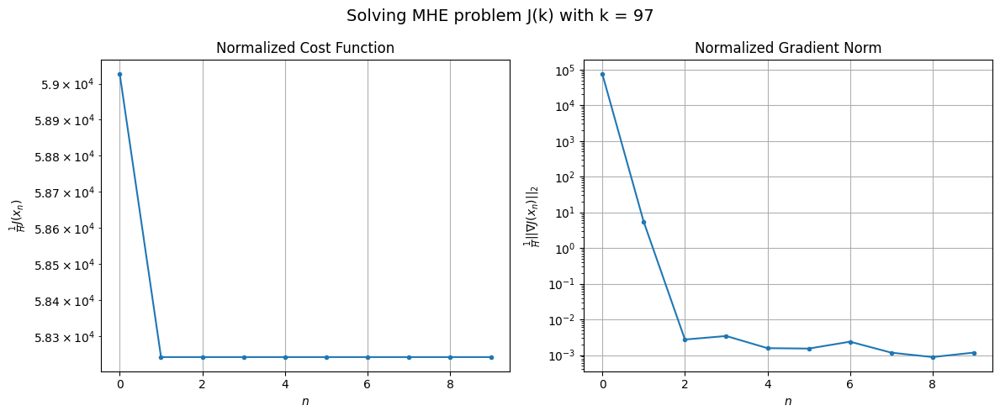

Windows:  14%|█▍        | 49/346 [08:22<47:26,  9.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3067379.519964118
Gradient norm: 4312303.379915636
Global estimation error: 117.33768605818864
Initial conditions estimation errors: 57.8281467473019 m, 59.85828422072763 m, 58.6391391213861 m, 58.33061807471491 m
Position estimation errors: 82.8531369470472 m, 80.63100582440897 m, 82.30073297643253 m, 82.45928810084148 m

[Gauss-Newton] Iteration 1
Cost function: 3026311.071372666 (-1.34%)
Gradient norm: 147.5325839788261 (-100.00%)
Global estimation error: 129.31097788896128 (10.20%)
Initial conditions estimation errors: 63.71748130841417 m, 65.43621741286624 m, 64.4110105855309 m, 65.04397866438055 m
Position estimation errors: 77.33058963936807 m, 75.33742276351057 m, 76.85225627344754 m, 76.10264260153275 m

[Gauss-Newton] Iteration 2
Cost function: 3026311.0714020366 (0.00%)
Gradient norm: 0.08637298634684688 (-99.94%)
Global estimation error: 129.31560790730873 (0.00%)
Initial conditions estimation errors: 63.7174852659

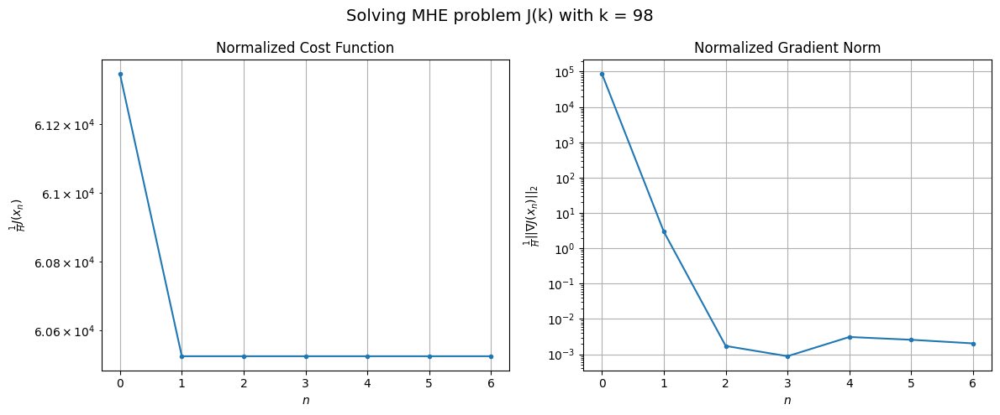

Windows:  14%|█▍        | 50/346 [08:32<46:55,  9.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3173347.0031702155
Gradient norm: 4639237.619129184
Global estimation error: 122.56168653986386
Initial conditions estimation errors: 60.24548128446269 m, 62.005073480107555 m, 61.047473783331135 m, 61.80946399558587 m
Position estimation errors: 83.76078340355575 m, 81.77582636685528 m, 83.22831220953346 m, 82.28468414035915 m

[Gauss-Newton] Iteration 1
Cost function: 3130077.494125075 (-1.36%)
Gradient norm: 156.1881539397554 (-100.00%)
Global estimation error: 135.17764432485137 (10.29%)
Initial conditions estimation errors: 66.29443206616276 m, 68.29772635003688 m, 66.95196136081302 m, 68.78140721055068 m
Position estimation errors: 78.10229789041182 m, 75.82869276478277 m, 77.61125680164622 m, 75.70175689754423 m

[Gauss-Newton] Iteration 2
Cost function: 3130077.4941244563 (-0.00%)
Gradient norm: 0.11779151044499304 (-99.92%)
Global estimation error: 135.18142796403382 (0.00%)
Initial conditions estimation errors: 66.29

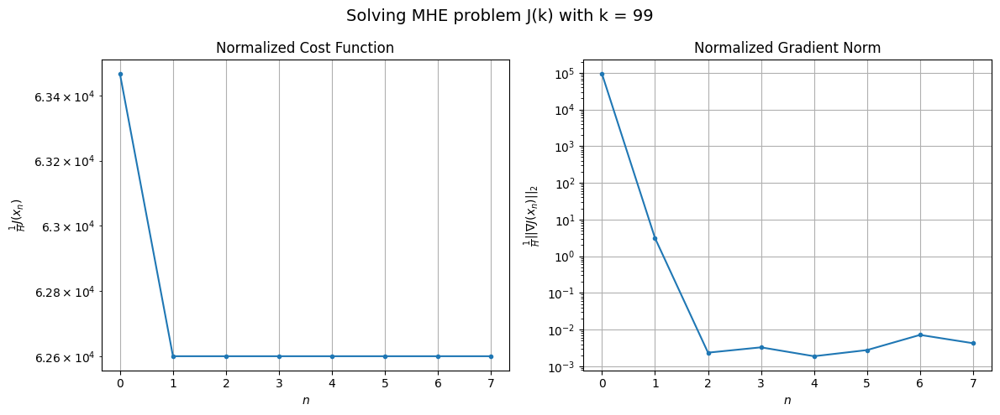

Windows:  15%|█▍        | 51/346 [08:42<47:34,  9.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3266779.981097188
Gradient norm: 5022342.3211370995
Global estimation error: 127.99514603251062
Initial conditions estimation errors: 62.59360921832401 m, 64.63325500464038 m, 63.38586981155832 m, 65.34181644417043 m
Position estimation errors: 84.67249458654472 m, 82.41265546946185 m, 84.11822378718561 m, 81.99701735997573 m

[Gauss-Newton] Iteration 1
Cost function: 3221571.7346246396 (-1.38%)
Gradient norm: 161.54286971865082 (-100.00%)
Global estimation error: 140.82326600843615 (10.02%)
Initial conditions estimation errors: 68.78005908605486 m, 71.05460591026664 m, 69.44871975928397 m, 72.30901752524295 m
Position estimation errors: 78.90218877115018 m, 76.3907237673983 m, 78.40938851207032 m, 75.41502477364499 m

[Gauss-Newton] Iteration 2
Cost function: 3221571.7345760176 (-0.00%)
Gradient norm: 0.10357316966054324 (-99.94%)
Global estimation error: 140.826810171131 (0.00%)
Initial conditions estimation errors: 68.78006

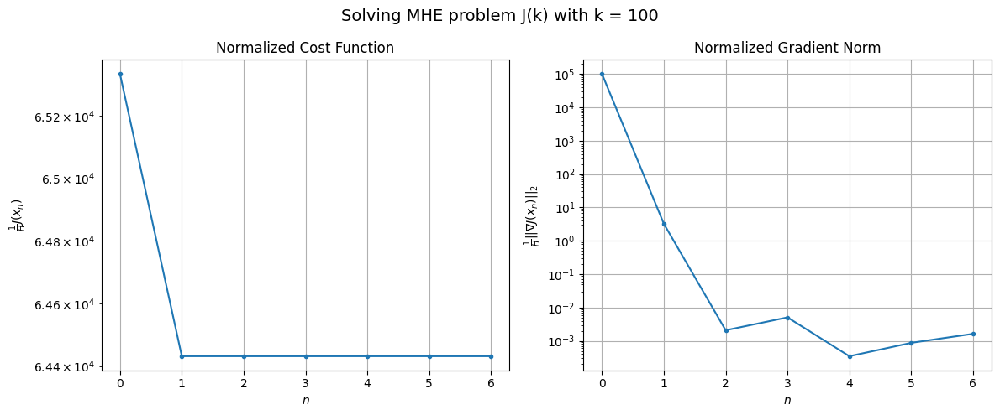

Windows:  15%|█▌        | 52/346 [08:51<46:16,  9.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3352746.104321452
Gradient norm: 5026935.282429651
Global estimation error: 133.0827151237183
Initial conditions estimation errors: 64.81663725569021 m, 67.10051959202708 m, 65.6229145744571 m, 68.56343280662627 m
Position estimation errors: 85.60658798811224 m, 83.13257726069374 m, 85.04477990800206 m, 81.91523383235568 m

[Gauss-Newton] Iteration 1
Cost function: 3305585.2349590687 (-1.41%)
Gradient norm: 169.3794239573002 (-100.00%)
Global estimation error: 146.57496198834767 (10.14%)
Initial conditions estimation errors: 71.125730305302 m, 73.85299372081975 m, 72.09652358059907 m, 75.9812687198414 m
Position estimation errors: 79.71935107885021 m, 76.75191004563395 m, 78.90992404826457 m, 74.93794233929924 m

[Gauss-Newton] Iteration 2
Cost function: 3305585.2349409824 (-0.00%)
Gradient norm: 0.0057091663672554395 (-100.00%)
Global estimation error: 146.57680311259966 (0.00%)
Initial conditions estimation errors: 71.125735

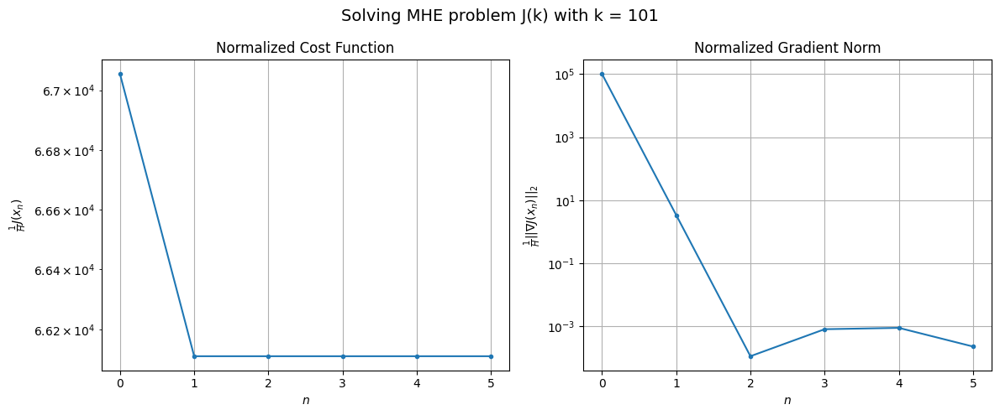

Windows:  15%|█▌        | 53/346 [08:58<42:27,  8.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3425872.6527385153
Gradient norm: 5298118.746379321
Global estimation error: 138.25969538448072
Initial conditions estimation errors: 66.88785794378752 m, 69.60585181077037 m, 67.9907775890455 m, 71.93060637854728 m
Position estimation errors: 86.51153235943089 m, 83.60863581491783 m, 85.6360808110387 m, 81.56263036034 m

[Gauss-Newton] Iteration 1
Cost function: 3376792.884673615 (-1.43%)
Gradient norm: 193.2465879219396 (-100.00%)
Global estimation error: 150.93073337441098 (9.16%)
Initial conditions estimation errors: 73.31099473271355 m, 76.27039337312652 m, 73.64663380383175 m, 78.51469746946792 m
Position estimation errors: 80.51565467506717 m, 77.36793161451992 m, 80.28462499785458 m, 75.39751313500558 m

[Gauss-Newton] Iteration 2
Cost function: 3376792.884697162 (0.00%)
Gradient norm: 0.16162003210647335 (-99.92%)
Global estimation error: 150.93126548943428 (0.00%)
Initial conditions estimation errors: 73.310999855824

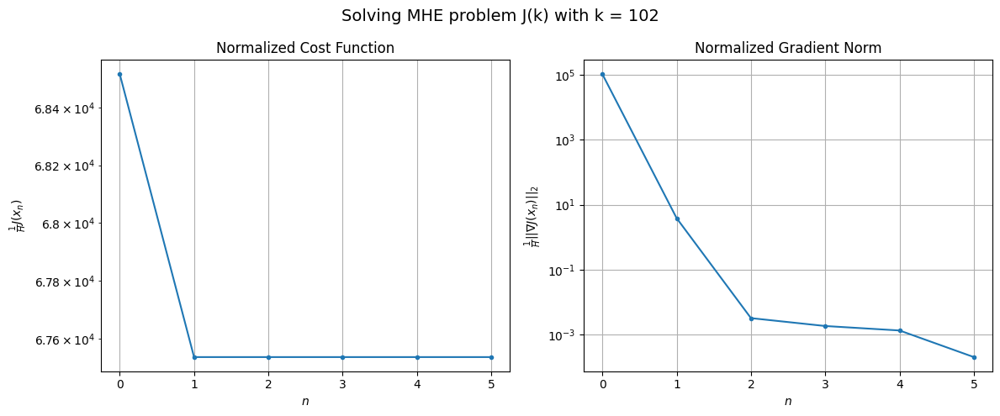

Windows:  16%|█▌        | 54/346 [09:05<40:13,  8.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3488781.61055781
Gradient norm: 5316575.611358767
Global estimation error: 142.03721091650542
Initial conditions estimation errors: 68.8007646176935 m, 71.71060292531254 m, 69.29339885829377 m, 74.14182018517559 m
Position estimation errors: 87.35745573733068 m, 84.31934533076061 m, 87.04126633418429 m, 82.1478171123014 m

[Gauss-Newton] Iteration 1
Cost function: 3438047.5207717605 (-1.45%)
Gradient norm: 201.6171450626589 (-100.00%)
Global estimation error: 153.81169154718665 (8.29%)
Initial conditions estimation errors: 75.31181759916271 m, 78.11239504263125 m, 75.48467046868795 m, 78.6552859485386 m
Position estimation errors: 81.26899389009476 m, 78.37237252370481 m, 81.26173633068527 m, 78.03763777522559 m

[Gauss-Newton] Iteration 2
Cost function: 3438047.5207137833 (-0.00%)
Gradient norm: 0.022077864751576626 (-99.99%)
Global estimation error: 153.80753509372184 (-0.00%)
Initial conditions estimation errors: 75.3118229

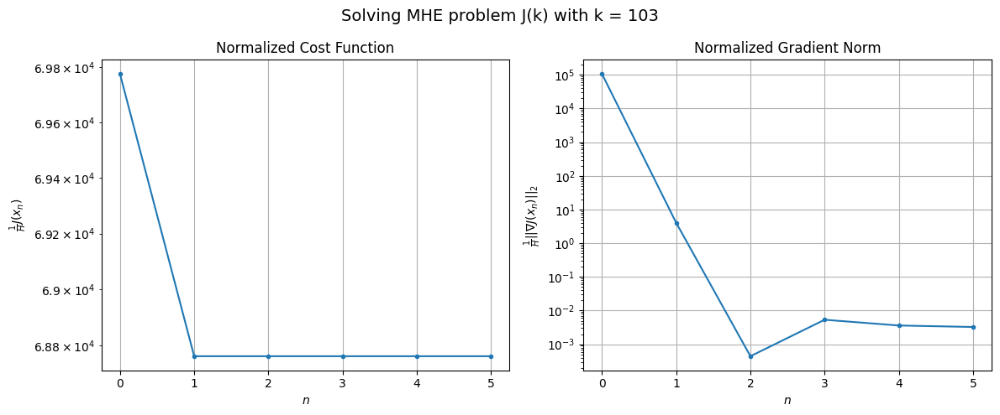

Windows:  16%|█▌        | 55/346 [09:13<39:21,  8.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3541074.793679259
Gradient norm: 5106326.011189761
Global estimation error: 144.33786765610643
Initial conditions estimation errors: 70.54182397210123 m, 73.25152786150419 m, 70.83116427541042 m, 73.98917865564023 m
Position estimation errors: 88.1758706699458 m, 85.42005599716987 m, 88.09323921941169 m, 84.87729306583417 m

[Gauss-Newton] Iteration 1
Cost function: 3488827.587295405 (-1.48%)
Gradient norm: 206.07932051722955 (-100.00%)
Global estimation error: 155.88297558409695 (8.00%)
Initial conditions estimation errors: 77.11946983517281 m, 79.343359912769 m, 76.65661283849681 m, 78.6158391582869 m
Position estimation errors: 81.99663461981831 m, 79.7009582612578 m, 82.63012659324573 m, 80.63250297559642 m

[Gauss-Newton] Iteration 2
Cost function: 3488827.587326503 (0.00%)
Gradient norm: 0.15006315994555794 (-99.93%)
Global estimation error: 155.8815743718094 (-0.00%)
Initial conditions estimation errors: 77.119475195836

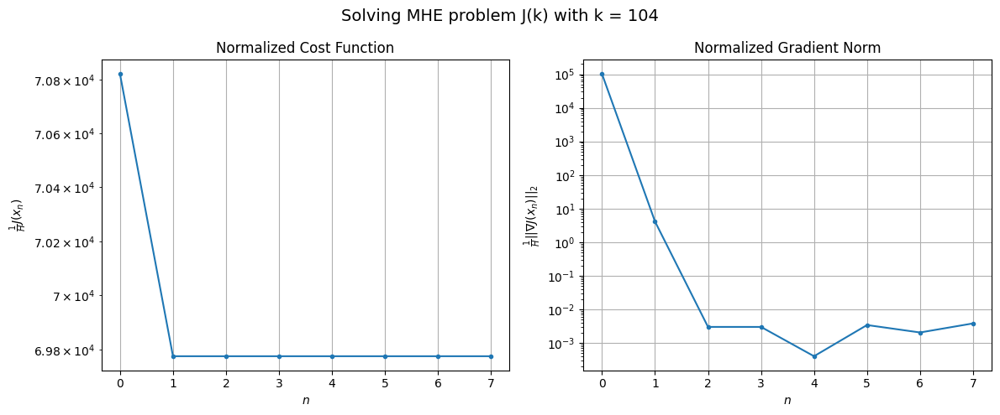

Windows:  16%|█▌        | 56/346 [09:23<42:26,  8.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3587490.7209797055
Gradient norm: 4869289.650306681
Global estimation error: 145.87509547864633
Initial conditions estimation errors: 72.1025298573286 m, 74.22350502437146 m, 71.74184254343795 m, 73.65264774464653 m
Position estimation errors: 89.05000801942057 m, 86.90136515444989 m, 89.60658356025795 m, 87.67223648068652 m

[Gauss-Newton] Iteration 1
Cost function: 3533520.706699994 (-1.50%)
Gradient norm: 214.74525495971847 (-100.00%)
Global estimation error: 159.9693289318197 (9.66%)
Initial conditions estimation errors: 78.75472343926356 m, 81.18699747523364 m, 78.89281630391044 m, 81.07056843988518 m
Position estimation errors: 82.76707502255945 m, 80.36589431803121 m, 82.885392446416 m, 80.71942539670326 m

[Gauss-Newton] Iteration 2
Cost function: 3533520.706693129 (-0.00%)
Gradient norm: 0.36477317487078453 (-99.83%)
Global estimation error: 159.97339045827232 (0.00%)
Initial conditions estimation errors: 78.754728738

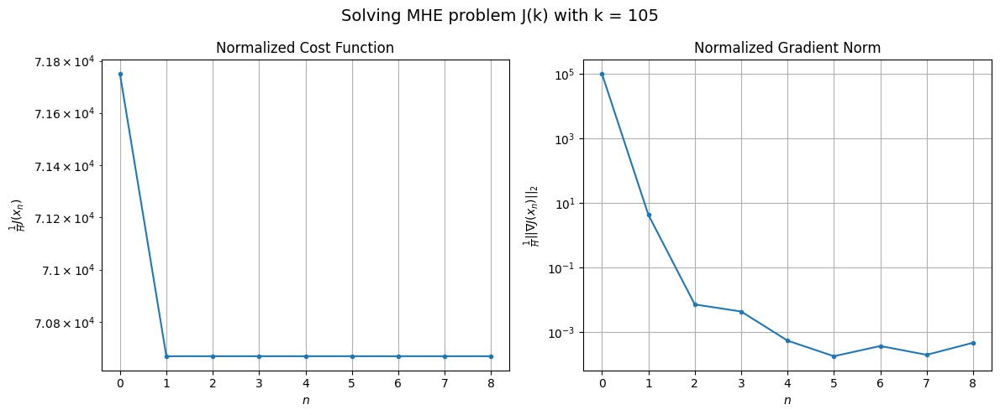

Windows:  16%|█▋        | 57/346 [09:34<46:06,  9.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3629604.0150405695
Gradient norm: 4479527.868495994
Global estimation error: 149.38732855028306
Initial conditions estimation errors: 73.49213920318779 m, 75.77417499009988 m, 73.69809035780695 m, 75.77800760074967 m
Position estimation errors: 90.0759484875679 m, 87.86523962207706 m, 90.12630982625319 m, 88.10480942852386 m

[Gauss-Newton] Iteration 1
Cost function: 3574290.70545646 (-1.52%)
Gradient norm: 231.8430302178001 (-99.99%)
Global estimation error: 161.93832898334563 (8.40%)
Initial conditions estimation errors: 80.19101417166617 m, 82.61584483267636 m, 80.27611170281531 m, 80.76973883531612 m
Position estimation errors: 83.70634337844155 m, 81.48308470532646 m, 83.98899450787872 m, 83.55199954514518 m

[Gauss-Newton] Iteration 2
Cost function: 3574290.7054549037 (-0.00%)
Gradient norm: 0.11435422738687394 (-99.95%)
Global estimation error: 161.93671374200892 (-0.00%)
Initial conditions estimation errors: 80.1910193

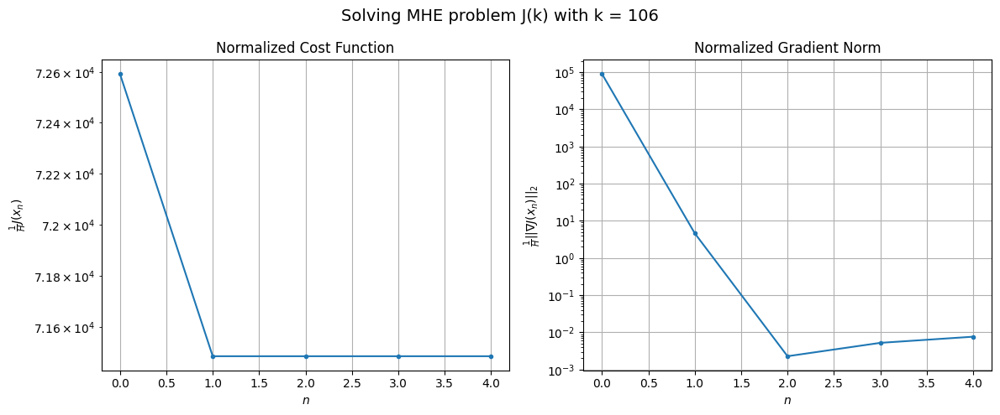

Windows:  17%|█▋        | 58/346 [09:41<41:23,  8.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3668852.651872699
Gradient norm: 4227741.593247257
Global estimation error: 150.73795884811042
Initial conditions estimation errors: 74.68139760436958 m, 76.87625279417753 m, 74.80272030259411 m, 75.09443077470333 m
Position estimation errors: 91.33685867852004 m, 89.3735616685567 m, 91.53958148772757 m, 91.38478143152521 m

[Gauss-Newton] Iteration 1
Cost function: 3611869.5696832687 (-1.55%)
Gradient norm: 253.01060435579043 (-99.99%)
Global estimation error: 164.87535642734548 (9.38%)
Initial conditions estimation errors: 81.4441669246923 m, 83.66360080047734 m, 81.14714186291545 m, 83.46394812947906 m
Position estimation errors: 84.85970735961618 m, 82.81587647520853 m, 85.35718743684076 m, 83.27034790654652 m

[Gauss-Newton] Iteration 2
Cost function: 3611869.569672479 (-0.00%)
Gradient norm: 0.12025623804422199 (-99.95%)
Global estimation error: 164.87862358112338 (0.00%)
Initial conditions estimation errors: 81.44417185

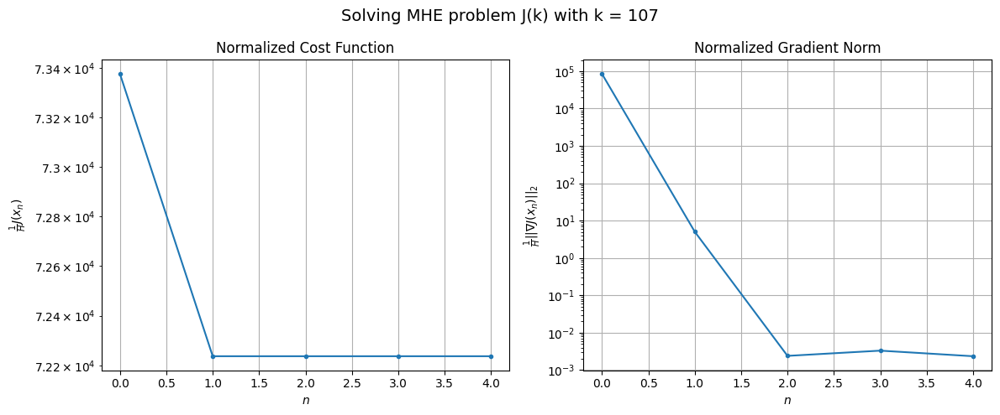

Windows:  17%|█▋        | 59/346 [09:48<38:32,  8.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3711567.3905808004
Gradient norm: 4063668.756432345
Global estimation error: 153.22675689002068
Initial conditions estimation errors: 75.69491987136371 m, 77.69691032122681 m, 75.47076164127219 m, 77.56305431457402 m
Position estimation errors: 92.79212412864767 m, 91.00001960905078 m, 93.19319729320164 m, 91.39732389548266 m

[Gauss-Newton] Iteration 1
Cost function: 3653270.3348700493 (-1.57%)
Gradient norm: 241.35553997718245 (-99.99%)
Global estimation error: 164.59604066369704 (7.42%)
Initial conditions estimation errors: 82.49973325074862 m, 83.41703367194442 m, 81.98231035042889 m, 81.27793902765518 m
Position estimation errors: 86.22651313592455 m, 85.51558994183695 m, 87.03160540304509 m, 87.95819192894965 m

[Gauss-Newton] Iteration 2
Cost function: 3653270.334834663 (-0.00%)
Gradient norm: 0.15074398753240348 (-99.94%)
Global estimation error: 164.59379576673058 (-0.00%)
Initial conditions estimation errors: 82.4997

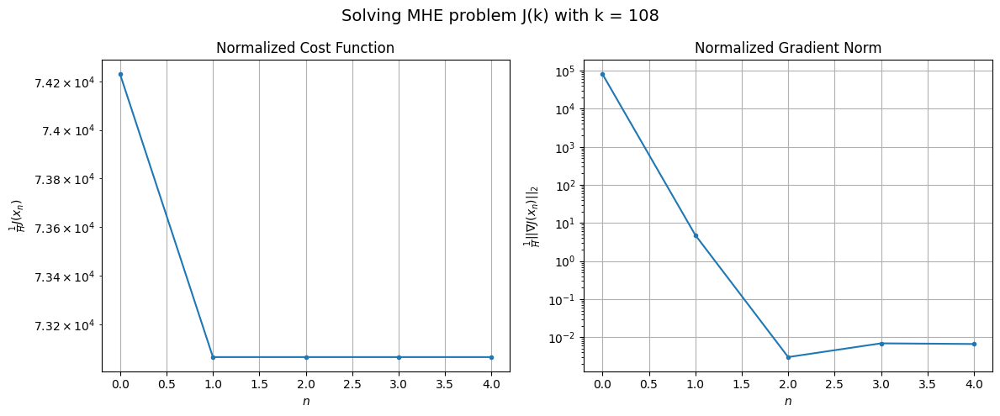

Windows:  17%|█▋        | 60/346 [09:54<36:03,  7.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3757149.074747108
Gradient norm: 3974847.8413185137
Global estimation error: 152.42912050121114
Initial conditions estimation errors: 76.53134737350607 m, 77.20886630817232 m, 76.06051636556218 m, 75.04085745806539 m
Position estimation errors: 94.37031764348252 m, 93.91662016622037 m, 95.069103598265 m, 96.40111778820324 m

[Gauss-Newton] Iteration 1
Cost function: 3697486.0110879634 (-1.59%)
Gradient norm: 265.7482999770435 (-99.99%)
Global estimation error: 164.46420960384157 (7.90%)
Initial conditions estimation errors: 83.38386761416992 m, 83.72131361163044 m, 82.1524566259542 m, 79.60698995091951 m
Position estimation errors: 87.7154746998348 m, 87.632356845922 m, 89.16468532465926 m, 92.11291188774982 m

[Gauss-Newton] Iteration 2
Cost function: 3697486.011063055 (-0.00%)
Gradient norm: 0.026518245784963555 (-99.99%)
Global estimation error: 164.46433691220682 (0.00%)
Initial conditions estimation errors: 83.38387192338

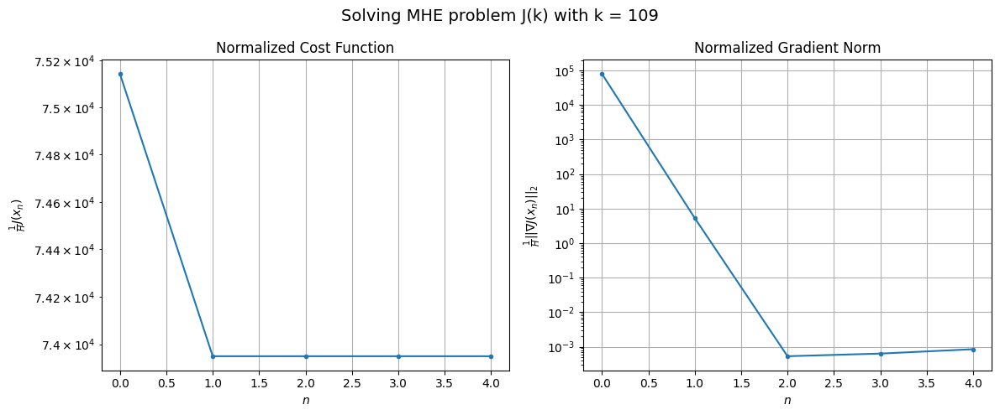

Windows:  18%|█▊        | 61/346 [10:01<34:39,  7.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3812255.3250598484
Gradient norm: 3675734.1059720633
Global estimation error: 151.841170350914
Initial conditions estimation errors: 77.21598730502166 m, 77.27509641685046 m, 76.05158258983181 m, 73.06228247463042 m
Position estimation errors: 95.96132071165887 m, 96.17581892803052 m, 97.2772359842553 m, 100.76800878819202 m

[Gauss-Newton] Iteration 1
Cost function: 3751010.351767994 (-1.61%)
Gradient norm: 279.81483495027845 (-99.99%)
Global estimation error: 165.77673303651005 (9.18%)
Initial conditions estimation errors: 84.12868850515545 m, 83.73455738941412 m, 82.97938055811093 m, 80.66711350103827 m
Position estimation errors: 89.20390072553933 m, 89.85206265836837 m, 90.52297589745812 m, 93.31509365966974 m

[Gauss-Newton] Iteration 2
Cost function: 3751010.3517462574 (-0.00%)
Gradient norm: 0.043006922292802896 (-99.98%)
Global estimation error: 165.77784231458446 (0.00%)
Initial conditions estimation errors: 84.12869

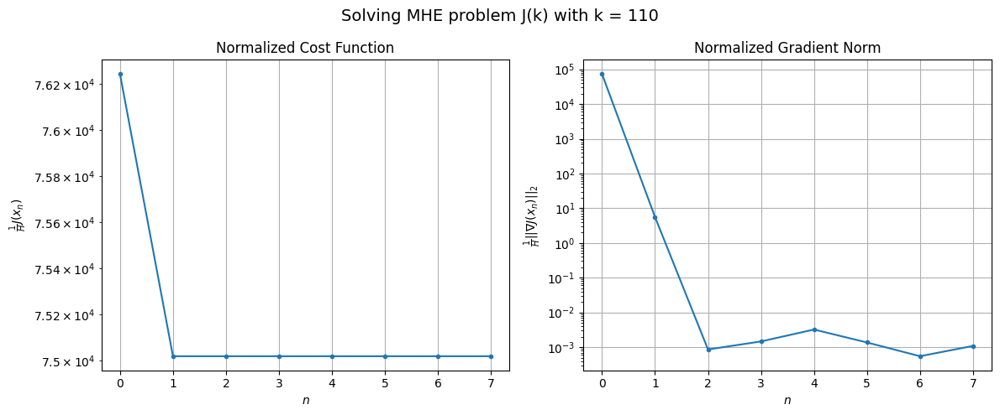

Windows:  18%|█▊        | 62/346 [10:10<38:09,  8.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3872710.5793887973
Gradient norm: 3095133.189195685
Global estimation error: 152.79793655440454
Initial conditions estimation errors: 77.7701523335915 m, 77.1048087874515 m, 76.71660142314427 m, 73.94842788095436 m
Position estimation errors: 97.46266514643828 m, 98.3913382711166 m, 98.6099503854014 m, 101.94194025928384 m

[Gauss-Newton] Iteration 1
Cost function: 3809984.809278737 (-1.62%)
Gradient norm: 268.9576517262422 (-99.99%)
Global estimation error: 167.48892552654584 (9.61%)
Initial conditions estimation errors: 84.74106009719345 m, 83.99164224622625 m, 83.94442553863645 m, 82.28108152449775 m
Position estimation errors: 90.61181773328475 m, 91.48588327287615 m, 91.49386051950894 m, 93.510639852327 m

[Gauss-Newton] Iteration 2
Cost function: 3809984.8092701184 (-0.00%)
Gradient norm: 0.30986995351032365 (-99.88%)
Global estimation error: 167.48851154634056 (-0.00%)
Initial conditions estimation errors: 84.7410634501

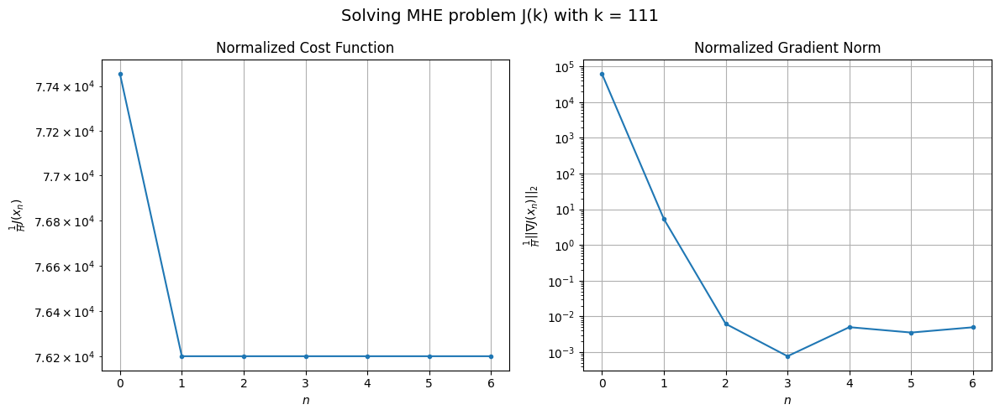

Windows:  18%|█▊        | 63/346 [10:20<39:34,  8.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3937444.904547423
Gradient norm: 2637610.7766005755
Global estimation error: 154.25959807589962
Initial conditions estimation errors: 78.18879332850979 m, 77.26334141416288 m, 77.49015093164468 m, 75.55218289266656 m
Position estimation errors: 98.83151234556645 m, 99.88766219694071 m, 99.55708899770754 m, 101.87744120584335 m

[Gauss-Newton] Iteration 1
Cost function: 3873521.852366905 (-1.62%)
Gradient norm: 318.99696314694086 (-99.99%)
Global estimation error: 171.1547170718201 (10.95%)
Initial conditions estimation errors: 85.202720917565 m, 85.30854443196468 m, 84.80219974460343 m, 86.9794057333134 m
Position estimation errors: 91.90086085791053 m, 91.82221214640896 m, 92.31912575573246 m, 90.31486007782155 m

[Gauss-Newton] Iteration 2
Cost function: 3873521.8523031664 (-0.00%)
Gradient norm: 0.23003102851346904 (-99.93%)
Global estimation error: 171.15548903077448 (0.00%)
Initial conditions estimation errors: 85.2027236

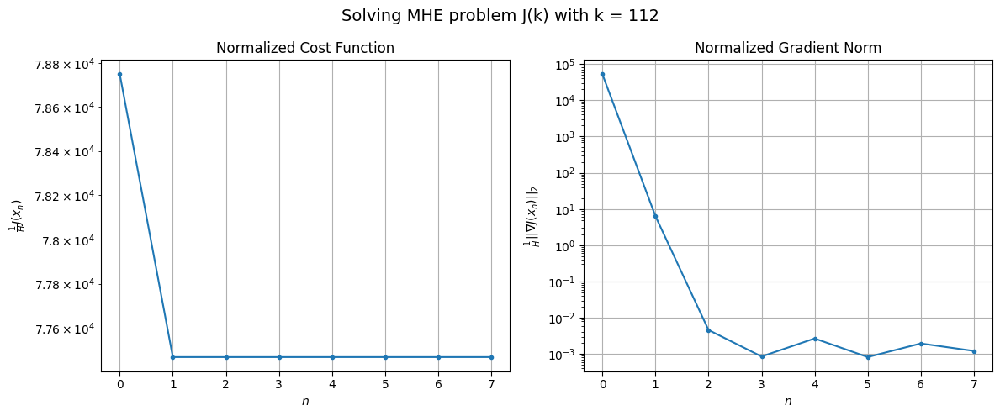

Windows:  18%|█▊        | 64/346 [10:30<41:44,  8.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4009353.279365203
Gradient norm: 1710589.0220759956
Global estimation error: 157.7107948644402
Initial conditions estimation errors: 78.45819876138606 m, 78.4899190935136 m, 78.13473400874493 m, 80.31963567812984 m
Position estimation errors: 100.07415124222958 m, 100.0681107697687 m, 100.38932223599767 m, 98.351949554491 m

[Gauss-Newton] Iteration 1
Cost function: 3944395.8348989733 (-1.62%)
Gradient norm: 297.57011173185845 (-99.98%)
Global estimation error: 171.2980017682097 (8.62%)
Initial conditions estimation errors: 85.51254316639707 m, 85.77356055722191 m, 85.150223600639 m, 86.15618401169571 m
Position estimation errors: 93.07639350658383 m, 92.85082533987378 m, 93.4558654454422 m, 92.53745707445452 m

[Gauss-Newton] Iteration 2
Cost function: 3944395.834895379 (-0.00%)
Gradient norm: 0.015406173778256867 (-99.99%)
Global estimation error: 171.2976177561801 (-0.00%)
Initial conditions estimation errors: 85.5125451394

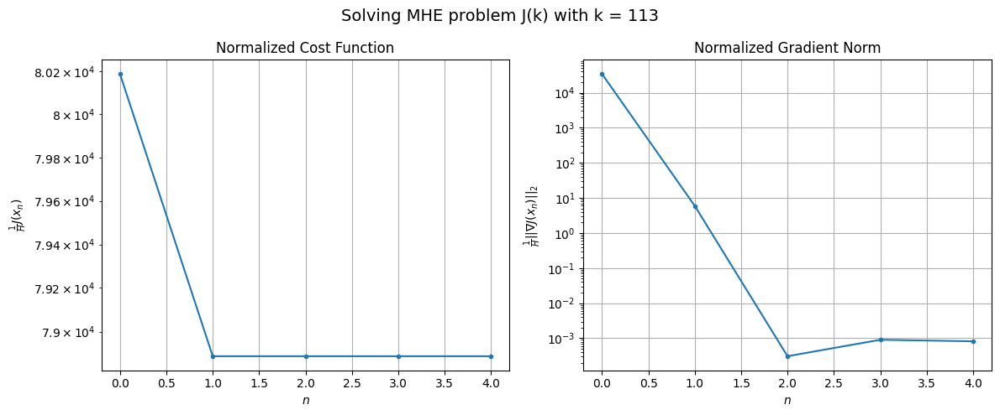

Windows:  19%|█▉        | 65/346 [10:37<38:47,  8.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4088700.993472569
Gradient norm: 1091065.5760096742
Global estimation error: 157.51927885206865
Initial conditions estimation errors: 78.5964552412612 m, 78.78964051809099 m, 78.29622827762874 m, 79.3520889076025 m
Position estimation errors: 101.23856218814521 m, 101.07566462039792 m, 101.53531741377675 m, 100.51510858762326 m

[Gauss-Newton] Iteration 1
Cost function: 4022637.1929728277 (-1.62%)
Gradient norm: 304.06331761726807 (-99.97%)
Global estimation error: 171.77191399944408 (9.05%)
Initial conditions estimation errors: 85.70044018170019 m, 86.20355121546426 m, 85.42472510728403 m, 86.21211690469104 m
Position estimation errors: 94.17310553285715 m, 93.7633905998843 m, 94.47165970796605 m, 93.76000514916666 m

[Gauss-Newton] Iteration 2
Cost function: 4022637.192963816 (-0.00%)
Gradient norm: 0.06463358105374162 (-99.98%)
Global estimation error: 171.77237947639443 (0.00%)
Initial conditions estimation errors: 85.7004

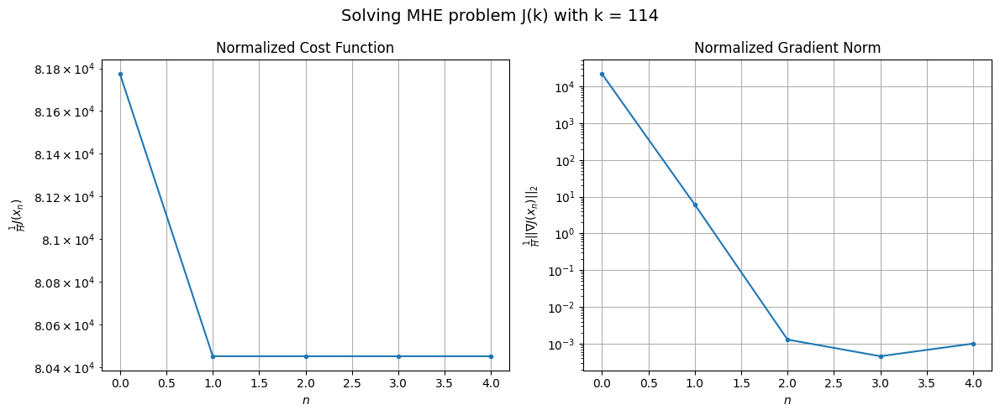

Windows:  19%|█▉        | 66/346 [10:43<36:00,  7.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4180866.5433300007
Gradient norm: 1133983.828997963
Global estimation error: 157.70343742745965
Initial conditions estimation errors: 78.66181057490127 m, 79.06763520589384 m, 78.43214585591778 m, 79.2422919359097 m
Position estimation errors: 102.37465289654943 m, 102.06169414215773 m, 102.61584267271832 m, 101.83579445803092 m

[Gauss-Newton] Iteration 1
Cost function: 4113821.477442188 (-1.60%)
Gradient norm: 300.8634389728125 (-99.97%)
Global estimation error: 173.28022279350935 (9.88%)
Initial conditions estimation errors: 85.81535064062842 m, 86.52449284052871 m, 85.72579016600376 m, 88.46639116430832 m
Position estimation errors: 95.25029763873825 m, 94.56116297830252 m, 95.40582566866628 m, 92.57307258634147 m

[Gauss-Newton] Iteration 2
Cost function: 4113821.4774356023 (-0.00%)
Gradient norm: 0.042212545473342494 (-99.99%)
Global estimation error: 173.28032585926002 (0.00%)
Initial conditions estimation errors: 85.81

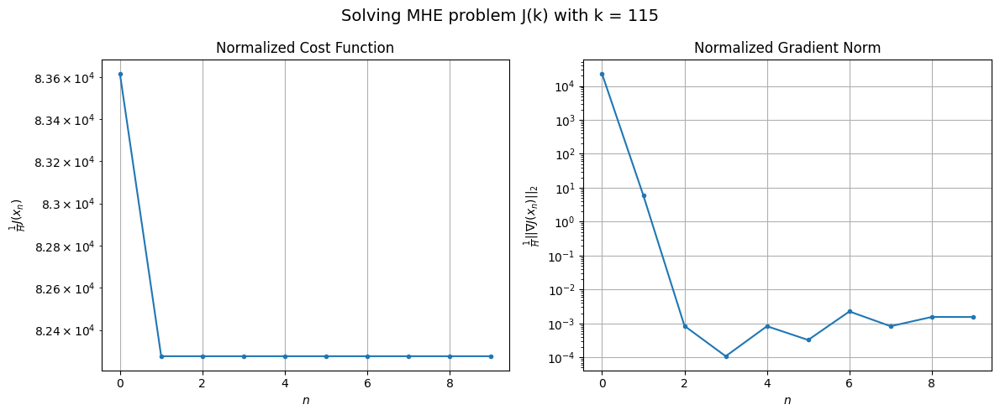

Windows:  19%|█▉        | 67/346 [10:55<42:10,  9.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4281431.369988321
Gradient norm: 2298869.685601407
Global estimation error: 159.16717016226798
Initial conditions estimation errors: 78.72474629935584 m, 79.39011077667178 m, 78.64765280770634 m, 81.53710909989212 m
Position estimation errors: 103.51491282127354 m, 102.87455231129745 m, 103.6672793080672 m, 100.6266026171977 m

[Gauss-Newton] Iteration 1
Cost function: 4213437.821818635 (-1.59%)
Gradient norm: 307.11150383508914 (-99.99%)
Global estimation error: 172.73692845857772 (8.53%)
Initial conditions estimation errors: 85.9326959409913 m, 86.1593645420607 m, 85.86007886191993 m, 87.51097128109471 m
Position estimation errors: 96.33855780430845 m, 96.09429190595233 m, 96.53401062236465 m, 94.61282260104993 m

[Gauss-Newton] Iteration 2
Cost function: 4213437.821832278 (0.00%)
Gradient norm: 0.10849361522086129 (-99.96%)
Global estimation error: 172.73651620693138 (-0.00%)
Initial conditions estimation errors: 85.9326951

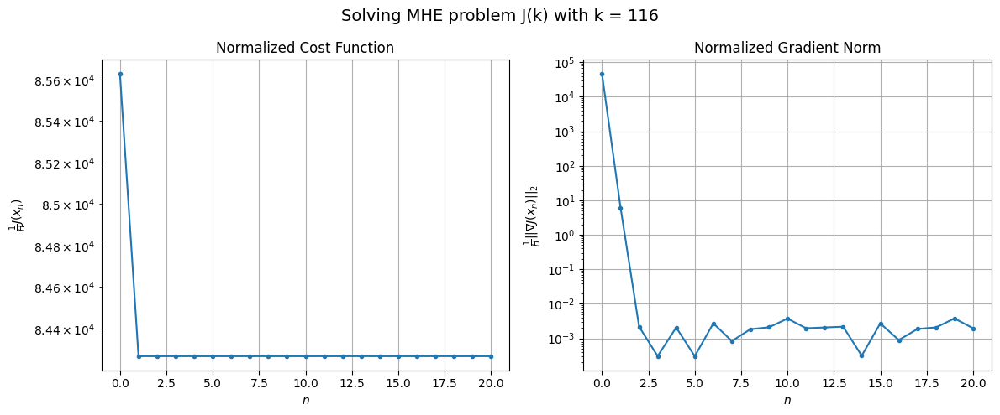

Windows:  20%|█▉        | 68/346 [11:20<1:03:55, 13.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4390187.490544915
Gradient norm: 3926099.288616754
Global estimation error: 158.65697209968656
Initial conditions estimation errors: 78.8513234551525 m, 79.07006688265713 m, 78.7509827346113 m, 80.62662843701435 m
Position estimation errors: 104.64320987074588 m, 104.41103956035032 m, 104.87420745256911 m, 102.6666362532083 m

[Gauss-Newton] Iteration 1
Cost function: 4321262.696965622 (-1.57%)
Gradient norm: 311.46930756483056 (-99.99%)
Global estimation error: 172.54029916881086 (8.75%)
Initial conditions estimation errors: 86.11808928261813 m, 86.27889606850431 m, 85.98260271045228 m, 86.69899897002571 m
Position estimation errors: 97.4174307536653 m, 97.21142866165627 m, 97.62121830639842 m, 96.5882427243874 m

[Gauss-Newton] Iteration 2
Cost function: 4321262.696951976 (-0.00%)
Gradient norm: 0.05973541474360891 (-99.98%)
Global estimation error: 172.5399099449156 (-0.00%)
Initial conditions estimation errors: 86.11808741

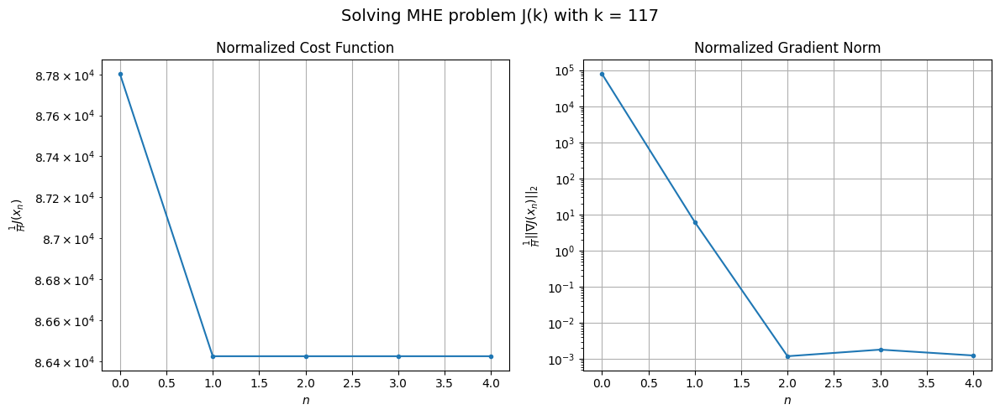

Windows:  20%|█▉        | 69/346 [11:27<53:53, 11.67s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 4507626.0018897485
Gradient norm: 5924985.670621508
Global estimation error: 158.56176075751839
Initial conditions estimation errors: 79.0778938119425 m, 79.23997986964447 m, 78.93174648301127 m, 79.87031733111267 m
Position estimation errors: 105.70414116565847 m, 105.48769898135193 m, 105.91710970152202 m, 104.60803176991446 m

[Gauss-Newton] Iteration 1
Cost function: 4437624.828511577 (-1.55%)
Gradient norm: 310.19710649304415 (-99.99%)
Global estimation error: 171.97307754817578 (8.46%)
Initial conditions estimation errors: 86.41275089039387 m, 85.8946819723715 m, 85.98845688374834 m, 85.6481690569071 m
Position estimation errors: 98.42153352207582 m, 98.88329817309437 m, 98.86512439025333 m, 98.90955165089893 m

[Gauss-Newton] Iteration 2
Cost function: 4437624.828480094 (-0.00%)
Gradient norm: 0.2128293437322747 (-99.93%)
Global estimation error: 171.9727223987018 (-0.00%)
Initial conditions estimation errors: 86.412747

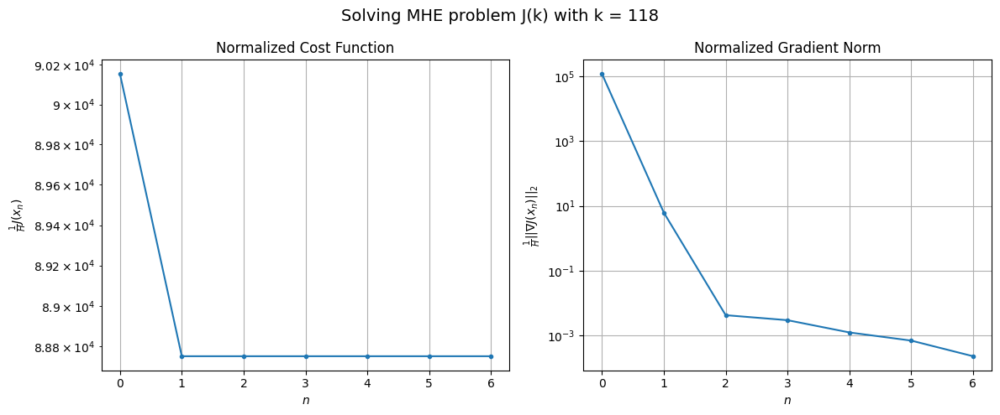

Windows:  20%|██        | 70/346 [11:35<49:36, 10.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4630434.842502211
Gradient norm: 8059734.625325237
Global estimation error: 158.09753121628444
Initial conditions estimation errors: 79.41961668994603 m, 78.92118753386481 m, 79.01156901571389 m, 78.84108541488646 m
Position estimation errors: 106.61753971671658 m, 107.05250152002624 m, 107.0347316106975 m, 106.86732632141643 m

[Gauss-Newton] Iteration 1
Cost function: 4559621.323539119 (-1.53%)
Gradient norm: 292.770255243798 (-100.00%)
Global estimation error: 173.43866862512778 (9.70%)
Initial conditions estimation errors: 86.80374655931706 m, 86.55230041795554 m, 86.51391057955581 m, 87.00613519362922 m
Position estimation errors: 99.28839163438901 m, 99.67549173404765 m, 99.63881015980215 m, 99.09699873423833 m

[Gauss-Newton] Iteration 2
Cost function: 4559621.323534841 (-0.00%)
Gradient norm: 0.04488006256578932 (-99.98%)
Global estimation error: 173.44004901884057 (0.00%)
Initial conditions estimation errors: 86.80374

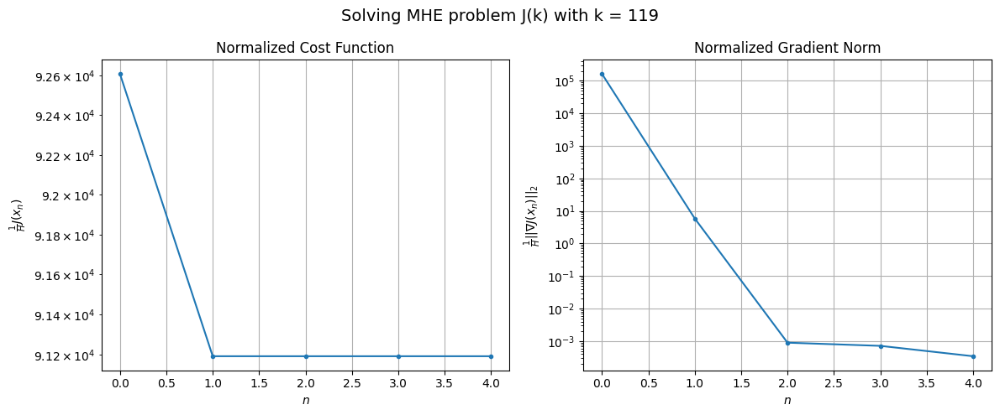

Windows:  21%|██        | 71/346 [11:42<44:13,  9.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4757801.08273138
Gradient norm: 9168681.948838325
Global estimation error: 159.52241563047087
Initial conditions estimation errors: 79.8644552150228 m, 79.5695046315866 m, 79.54430935090555 m, 80.06504016253147 m
Position estimation errors: 107.30909550816368 m, 107.74878150032788 m, 107.68062721568619 m, 107.08412861157429 m

[Gauss-Newton] Iteration 1
Cost function: 4685905.974678632 (-1.51%)
Gradient norm: 316.74928246707344 (-100.00%)
Global estimation error: 173.72581887192314 (8.90%)
Initial conditions estimation errors: 87.31213940352289 m, 86.85373267677197 m, 87.05044373523145 m, 86.23133342345521 m
Position estimation errors: 99.9203138925784 m, 100.66718444443995 m, 100.18182292696133 m, 101.32466998182208 m

[Gauss-Newton] Iteration 2
Cost function: 4685905.974690117 (0.00%)
Gradient norm: 0.22293690467379354 (-99.93%)
Global estimation error: 173.72631065009557 (0.00%)
Initial conditions estimation errors: 87.3121

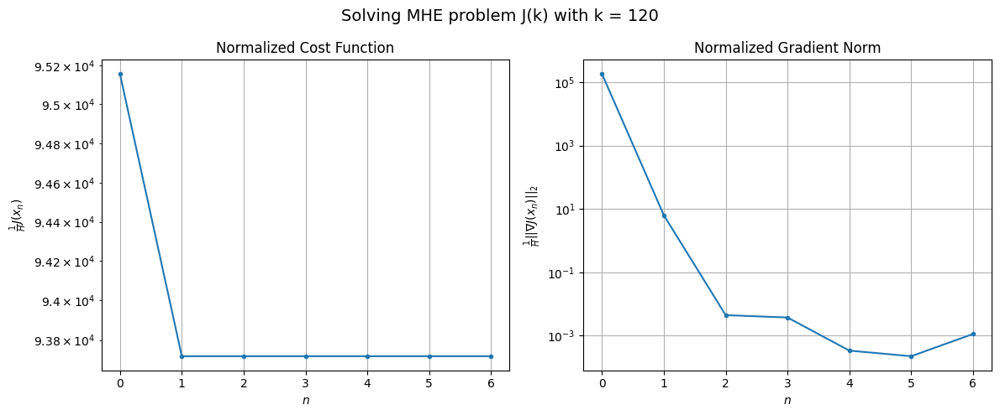

Windows:  21%|██        | 72/346 [11:52<44:23,  9.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4883869.438149139
Gradient norm: 10084280.662088476
Global estimation error: 159.85859841442468
Initial conditions estimation errors: 80.45182530462061 m, 79.89456217191922 m, 80.1932906846028 m, 79.17142123298288 m
Position estimation errors: 107.66344671922424 m, 108.51385228444872 m, 107.9061875967441 m, 109.23768701475105 m

[Gauss-Newton] Iteration 1
Cost function: 4811438.848565858 (-1.48%)
Gradient norm: 327.851028421275 (-100.00%)
Global estimation error: 174.9595054953146 (9.45%)
Initial conditions estimation errors: 87.9246107303794 m, 87.58533037139972 m, 87.69704716099292 m, 86.70682007733008 m
Position estimation errors: 100.23700903203225 m, 100.85548788322949 m, 100.51215987450925 m, 101.64119517757064 m

[Gauss-Newton] Iteration 2
Cost function: 4811438.848555785 (-0.00%)
Gradient norm: 0.18192060032019228 (-99.94%)
Global estimation error: 174.9595173773326 (0.00%)
Initial conditions estimation errors: 87.9246

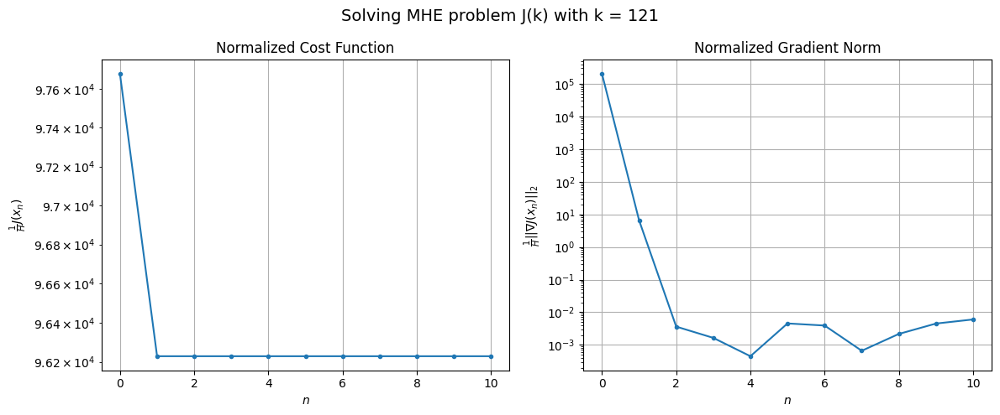

Windows:  21%|██        | 73/346 [12:06<49:11, 10.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5004350.939610132
Gradient norm: 10699233.464816995
Global estimation error: 161.32747762712
Initial conditions estimation errors: 81.17693428140738 m, 80.75327275913392 m, 80.89901989663352 m, 79.81893436103701 m
Position estimation errors: 107.57485994448412 m, 108.27783006062545 m, 107.89525644453768 m, 109.09373184959152 m

[Gauss-Newton] Iteration 1
Cost function: 4931366.0025519775 (-1.46%)
Gradient norm: 331.1438596797005 (-100.00%)
Global estimation error: 176.0095136328048 (9.10%)
Initial conditions estimation errors: 88.67151545426475 m, 88.07580491591791 m, 88.23900410104147 m, 87.02405220808024 m
Position estimation errors: 100.11063346899292 m, 101.07827118948278 m, 100.46790354082073 m, 102.09004982758756 m

[Gauss-Newton] Iteration 2
Cost function: 4931366.002549666 (-0.00%)
Gradient norm: 0.3278214589009439 (-99.90%)
Global estimation error: 176.00948451326343 (-0.00%)
Initial conditions estimation errors: 88.6

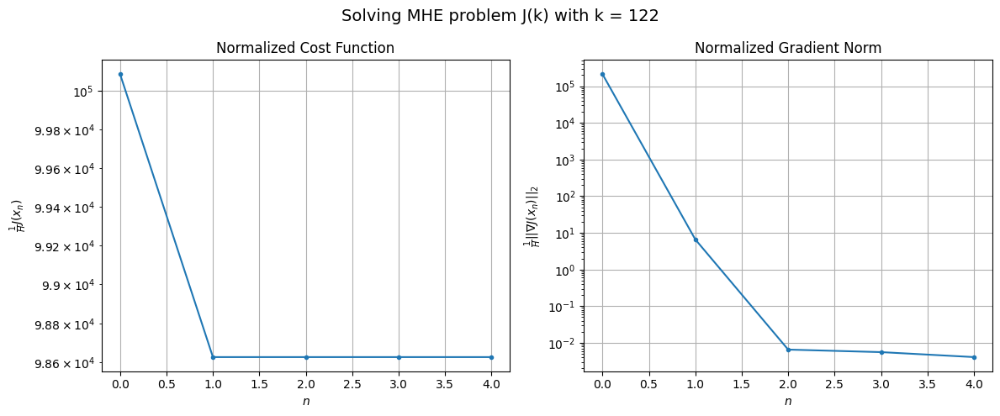

Windows:  21%|██▏       | 74/346 [12:12<43:32,  9.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5109543.936016958
Gradient norm: 10732045.405126294
Global estimation error: 162.59898803366625
Initial conditions estimation errors: 82.05298905574712 m, 81.3261082785615 m, 81.63426716943037 m, 80.1722740758716 m
Position estimation errors: 106.8986671688891 m, 107.97682037034905 m, 107.22579576736706 m, 109.08614261688287 m

[Gauss-Newton] Iteration 1
Cost function: 5036435.815070826 (-1.43%)
Gradient norm: 317.90638010962317 (-100.00%)
Global estimation error: 178.8823924877055 (10.01%)
Initial conditions estimation errors: 89.54321883556375 m, 89.58460343402932 m, 89.22191299242508 m, 89.41429456056231 m
Position estimation errors: 99.41954905850771 m, 99.7164820884691 m, 99.57775256687216 m, 99.94842766359146 m

[Gauss-Newton] Iteration 2
Cost function: 5036435.815090393 (0.00%)
Gradient norm: 0.35067390144599975 (-99.89%)
Global estimation error: 178.88312194483754 (0.00%)
Initial conditions estimation errors: 89.543212

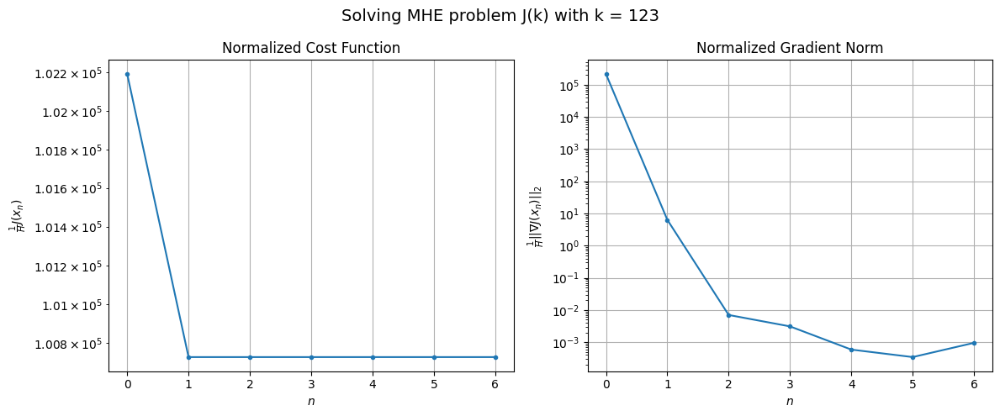

Windows:  22%|██▏       | 75/346 [12:22<42:44,  9.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5192361.440971798
Gradient norm: 10053971.281441389
Global estimation error: 165.72153477129243
Initial conditions estimation errors: 83.04545716561442 m, 82.97749290072797 m, 82.75877514732439 m, 82.66042805699294 m
Position estimation errors: 105.51002609034519 m, 105.89306250261424 m, 105.63805426539544 m, 106.28514531548292 m

[Gauss-Newton] Iteration 1
Cost function: 5119419.329893543 (-1.40%)
Gradient norm: 309.7330769001624 (-100.00%)
Global estimation error: 180.57023631143184 (8.96%)
Initial conditions estimation errors: 90.51524366975349 m, 90.59428849085761 m, 90.18502127387639 m, 89.84366811072452 m
Position estimation errors: 98.0329221854203 m, 98.13575837623756 m, 98.2601570098894 m, 98.723394157299 m

[Gauss-Newton] Iteration 2
Cost function: 5119419.329863991 (-0.00%)
Gradient norm: 0.392695309055718 (-99.87%)
Global estimation error: 180.57049756221392 (0.00%)
Initial conditions estimation errors: 90.51523786

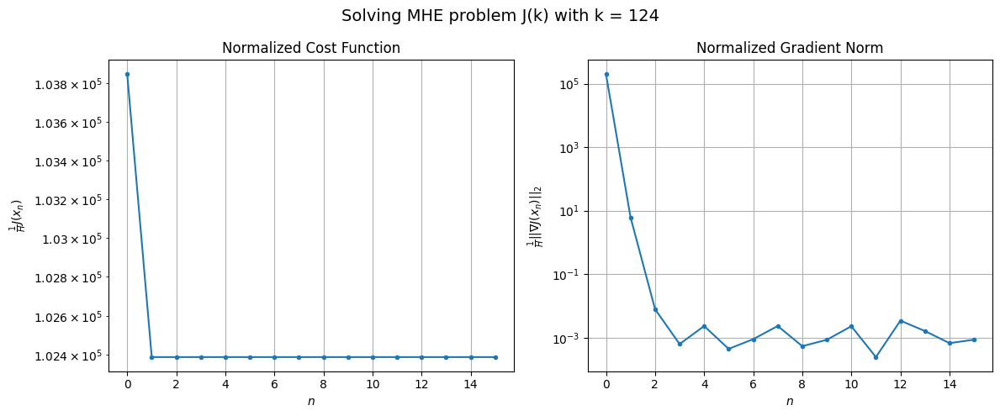

Windows:  22%|██▏       | 76/346 [12:41<55:30, 12.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5242575.427061868
Gradient norm: 9010370.828675186
Global estimation error: 167.7335326022826
Initial conditions estimation errors: 84.11481498585202 m, 84.17649346770193 m, 83.77659050570017 m, 83.39655514751941 m
Position estimation errors: 103.29720538776708 m, 103.38828620758308 m, 103.54262116563815 m, 104.0310975818029 m

[Gauss-Newton] Iteration 1
Cost function: 5170724.994319037 (-1.37%)
Gradient norm: 314.6859362862644 (-100.00%)
Global estimation error: 183.71014517573713 (9.52%)
Initial conditions estimation errors: 91.51732373041085 m, 92.19580429595197 m, 91.55434970485439 m, 92.15031342939406 m
Position estimation errors: 95.87156136743457 m, 95.39949510814567 m, 95.58049602233312 m, 95.25979706805387 m

[Gauss-Newton] Iteration 2
Cost function: 5170724.994311419 (-0.00%)
Gradient norm: 0.027687137648964247 (-99.99%)
Global estimation error: 183.7094260172249 (-0.00%)
Initial conditions estimation errors: 91.5173

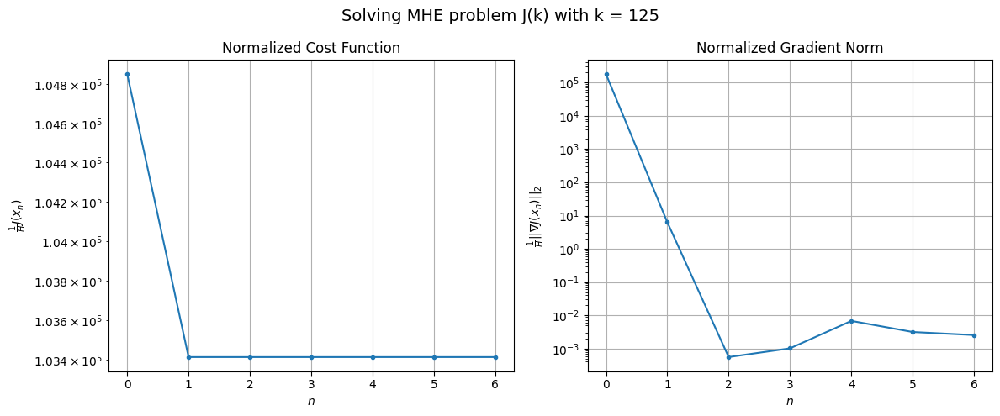

Windows:  22%|██▏       | 77/346 [12:50<50:41, 11.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5252607.179146967
Gradient norm: 8192681.608701912
Global estimation error: 171.03336085835159
Initial conditions estimation errors: 85.18247800862068 m, 85.8198615273488 m, 85.30700753447012 m, 85.75530153874604 m
Position estimation errors: 100.23411398203973 m, 99.78476743242446 m, 99.8756519264641 m, 99.69848453987339 m

[Gauss-Newton] Iteration 1
Cost function: 5182700.416601368 (-1.33%)
Gradient norm: 299.027436664837 (-100.00%)
Global estimation error: 185.24816116985644 (8.31%)
Initial conditions estimation errors: 92.47284563954821 m, 92.45671130788365 m, 92.30997331406805 m, 93.25357788336086 m
Position estimation errors: 92.90434956986856 m, 93.02686727642859 m, 92.95520972800988 m, 91.81297784915509 m

[Gauss-Newton] Iteration 2
Cost function: 5182700.416595778 (-0.00%)
Gradient norm: 0.170549420912472 (-99.94%)
Global estimation error: 185.24880744699544 (0.00%)
Initial conditions estimation errors: 92.47284094901

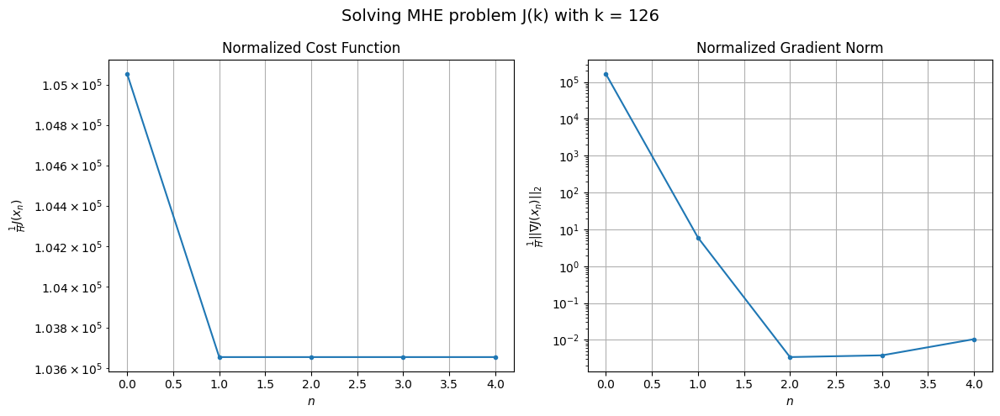

Windows:  23%|██▎       | 78/346 [12:56<44:23,  9.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5220504.846024925
Gradient norm: 7408093.666416721
Global estimation error: 172.69804768421852
Initial conditions estimation errors: 86.1585753280337 m, 86.15713291154583 m, 86.01310918919522 m, 87.06296524463912 m
Position estimation errors: 96.37609129469466 m, 96.4753865821308 m, 96.43322374192427 m, 95.17555163899499 m

[Gauss-Newton] Iteration 1
Cost function: 5152453.963561411 (-1.30%)
Gradient norm: 307.38769193547637 (-100.00%)
Global estimation error: 186.26406415200455 (7.86%)
Initial conditions estimation errors: 93.34309826320373 m, 93.16156059210292 m, 93.04495634825908 m, 92.97783574935477 m
Position estimation errors: 89.14007239566983 m, 89.42802884893555 m, 89.35837490133447 m, 89.26954319326812 m

[Gauss-Newton] Iteration 2
Cost function: 5152453.963569704 (0.00%)
Gradient norm: 0.4946894092080528 (-99.84%)
Global estimation error: 186.2637935390287 (-0.00%)
Initial conditions estimation errors: 93.3430943041

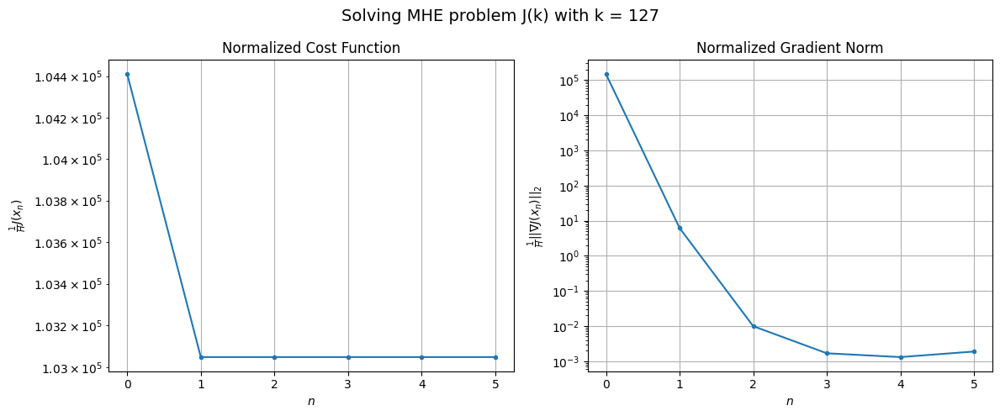

Windows:  23%|██▎       | 79/346 [13:04<41:34,  9.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5138676.737979078
Gradient norm: 6394910.029225748
Global estimation error: 173.610013611391
Initial conditions estimation errors: 86.99120541320723 m, 86.81724625208744 m, 86.69510756501609 m, 86.71586477547446 m
Position estimation errors: 91.82456773743432 m, 92.09697062871265 m, 92.05566688319766 m, 91.88653796858694 m

[Gauss-Newton] Iteration 1
Cost function: 5073130.420091359 (-1.28%)
Gradient norm: 292.6589956396633 (-100.00%)
Global estimation error: 187.62614629268091 (8.07%)
Initial conditions estimation errors: 94.03787742486759 m, 94.26761635044436 m, 93.70456317669444 m, 93.23877994209033 m
Position estimation errors: 84.72174023505185 m, 84.57403766111499 m, 84.86464872266919 m, 85.30132180678459 m

[Gauss-Newton] Iteration 2
Cost function: 5073130.420120594 (0.00%)
Gradient norm: 0.02284593858229009 (-99.99%)
Global estimation error: 187.62510427362923 (-0.00%)
Initial conditions estimation errors: 94.037874288

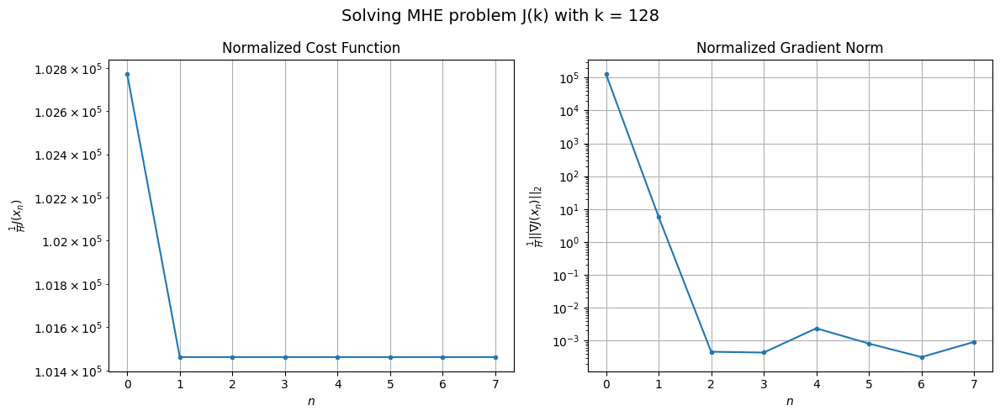

Windows:  23%|██▎       | 80/346 [13:16<44:24, 10.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5007292.261737865
Gradient norm: 5429850.739543384
Global estimation error: 174.81492443715612
Initial conditions estimation errors: 87.59328845524685 m, 87.83814985644017 m, 87.30926577340952 m, 86.8859842577059 m
Position estimation errors: 86.78028490027499 m, 86.6108877283687 m, 86.88827948060758 m, 87.29072575788575 m

[Gauss-Newton] Iteration 1
Cost function: 4944979.942135879 (-1.24%)
Gradient norm: 269.16750427214845 (-100.00%)
Global estimation error: 187.73858646708183 (7.39%)
Initial conditions estimation errors: 94.46322368179803 m, 94.66175306533852 m, 94.20730118880353 m, 92.12254152326194 m
Position estimation errors: 79.85632254599722 m, 79.71498917732272 m, 79.97435434413302 m, 81.84804609828127 m

[Gauss-Newton] Iteration 2
Cost function: 4944979.942154275 (0.00%)
Gradient norm: 0.2670521066795868 (-99.90%)
Global estimation error: 187.73798331591402 (-0.00%)
Initial conditions estimation errors: 94.463221415

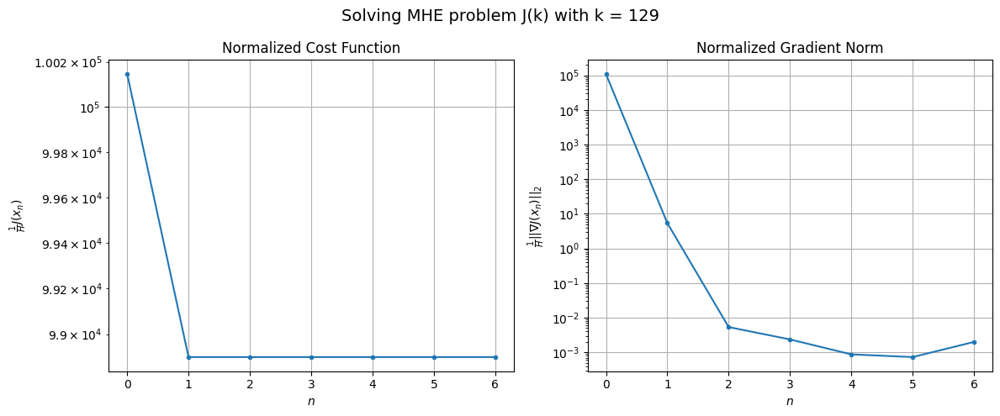

Windows:  23%|██▎       | 81/346 [13:26<44:55, 10.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4829423.799400527
Gradient norm: 4220649.657322969
Global estimation error: 174.7239127717335
Initial conditions estimation errors: 87.89122075581307 m, 88.1288340618597 m, 87.6641851319478 m, 85.74279081184723 m
Position estimation errors: 81.45413333858605 m, 81.2730505196673 m, 81.55791007233962 m, 83.26017538290179 m

[Gauss-Newton] Iteration 1
Cost function: 4770420.630359813 (-1.22%)
Gradient norm: 259.8234218599229 (-99.99%)
Global estimation error: 187.15536940975173 (7.11%)
Initial conditions estimation errors: 94.57868888187143 m, 94.80834548950885 m, 94.01402758587652 m, 90.855335913394 m
Position estimation errors: 74.71977798958301 m, 74.52948452016717 m, 75.1380965333763 m, 78.17775121533467 m

[Gauss-Newton] Iteration 2
Cost function: 4770420.630365202 (0.00%)
Gradient norm: 0.23714528459987685 (-99.91%)
Global estimation error: 187.15301723600848 (-0.00%)
Initial conditions estimation errors: 94.57868751463782 

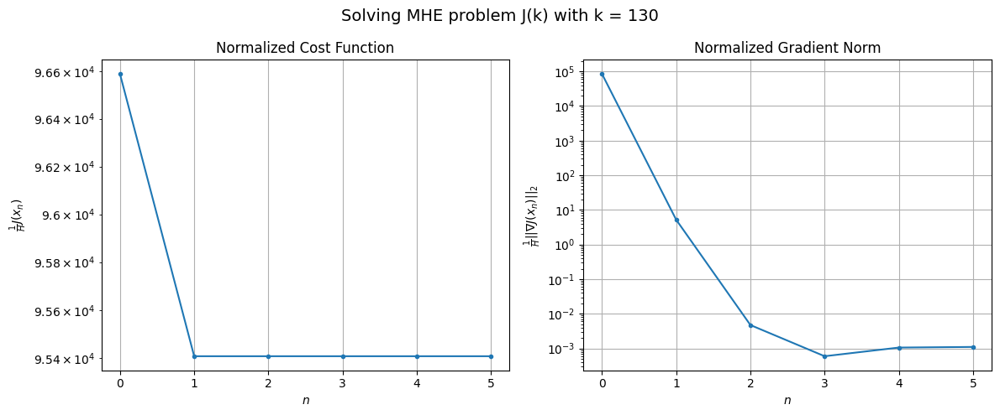

Windows:  24%|██▎       | 82/346 [13:34<41:45,  9.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4612468.52291245
Gradient norm: 2889701.770099122
Global estimation error: 173.84816291808139
Initial conditions estimation errors: 87.86598839080439 m, 88.1370163557297 m, 87.32817545626062 m, 84.31105585138808 m
Position estimation errors: 75.98428072142265 m, 75.75276036804193 m, 76.38427867524362 m, 79.26993864178654 m

[Gauss-Newton] Iteration 1
Cost function: 4557007.536945058 (-1.20%)
Gradient norm: 241.29947686349286 (-99.99%)
Global estimation error: 187.38478586881163 (7.79%)
Initial conditions estimation errors: 94.35591366466105 m, 94.9241585218986 m, 94.0621482095342 m, 91.38754006216911 m
Position estimation errors: 69.46268651779553 m, 68.9048454056598 m, 69.55625177124324 m, 72.08478967226308 m

[Gauss-Newton] Iteration 2
Cost function: 4557007.536954659 (0.00%)
Gradient norm: 0.05325252807634755 (-99.98%)
Global estimation error: 187.38492397617554 (0.00%)
Initial conditions estimation errors: 94.3559131926306

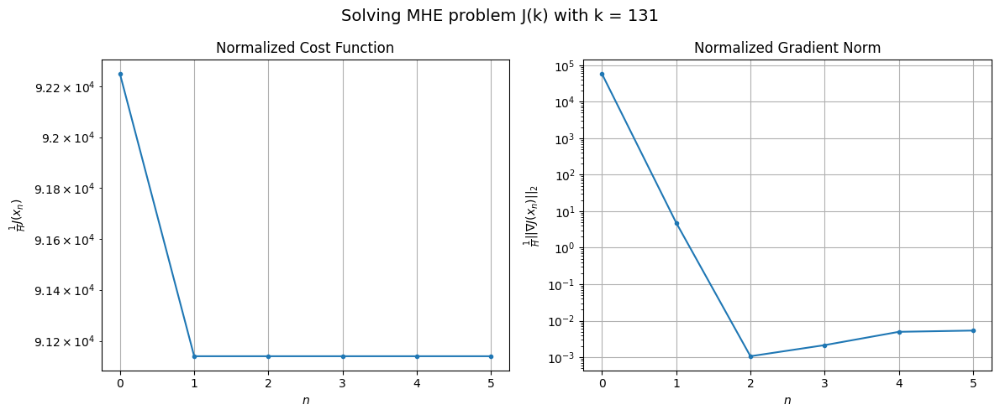

Windows:  24%|██▍       | 83/346 [13:42<39:32,  9.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4360576.72057508
Gradient norm: 1645667.1289705946
Global estimation error: 173.83548592108696
Initial conditions estimation errors: 87.50208888526674 m, 88.12098840532411 m, 87.26020774237745 m, 84.74935369751901 m
Position estimation errors: 70.46772317625417 m, 69.86424598995237 m, 70.5134416928036 m, 72.86599694155812 m

[Gauss-Newton] Iteration 1
Cost function: 4309160.687205052 (-1.18%)
Gradient norm: 219.15367363891278 (-99.99%)
Global estimation error: 187.2178595274803 (7.70%)
Initial conditions estimation errors: 93.75984751669456 m, 94.69472398024256 m, 93.66892238472988 m, 92.29628962322916 m
Position estimation errors: 64.20192244287493 m, 63.23313828337641 m, 64.10488128950595 m, 65.28440567199694 m

[Gauss-Newton] Iteration 2
Cost function: 4309160.68720925 (0.00%)
Gradient norm: 0.04356888943491894 (-99.98%)
Global estimation error: 187.21855312032886 (0.00%)
Initial conditions estimation errors: 93.75984785448

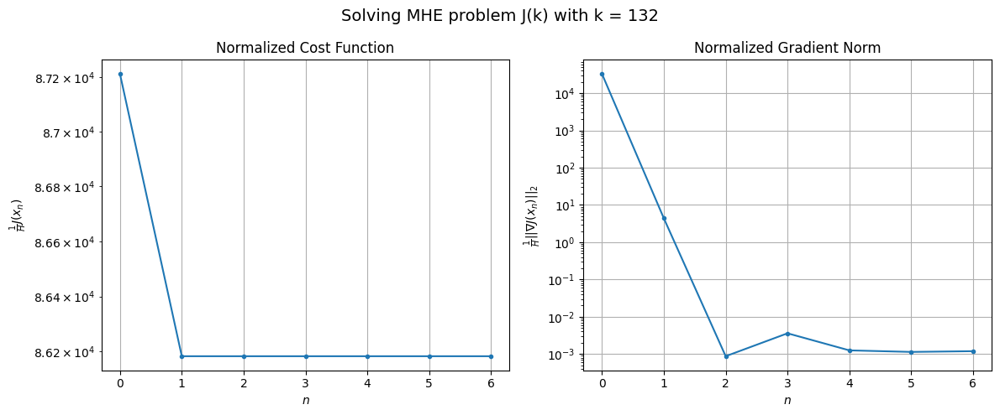

Windows:  24%|██▍       | 84/346 [13:51<39:02,  8.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4079884.7336867494
Gradient norm: 1440158.5924220413
Global estimation error: 173.4178574498624
Initial conditions estimation errors: 86.77504606031093 m, 87.7844589965972 m, 86.72694722297223 m, 85.53428192752354 m
Position estimation errors: 64.97061769170075 m, 63.93369852589503 m, 64.83056441717228 m, 65.83988965979651 m

[Gauss-Newton] Iteration 1
Cost function: 4032068.6422658744 (-1.17%)
Gradient norm: 209.48880437194182 (-99.99%)
Global estimation error: 185.71882437012 (7.09%)
Initial conditions estimation errors: 92.82112833516203 m, 93.66143722979564 m, 93.06736275978972 m, 91.87852875117473 m
Position estimation errors: 58.94508481339314 m, 58.09103561210287 m, 58.48082394858981 m, 59.623528044753876 m

[Gauss-Newton] Iteration 2
Cost function: 4032068.642269018 (0.00%)
Gradient norm: 0.10421317248490859 (-99.95%)
Global estimation error: 185.71967502216063 (0.00%)
Initial conditions estimation errors: 92.821129486

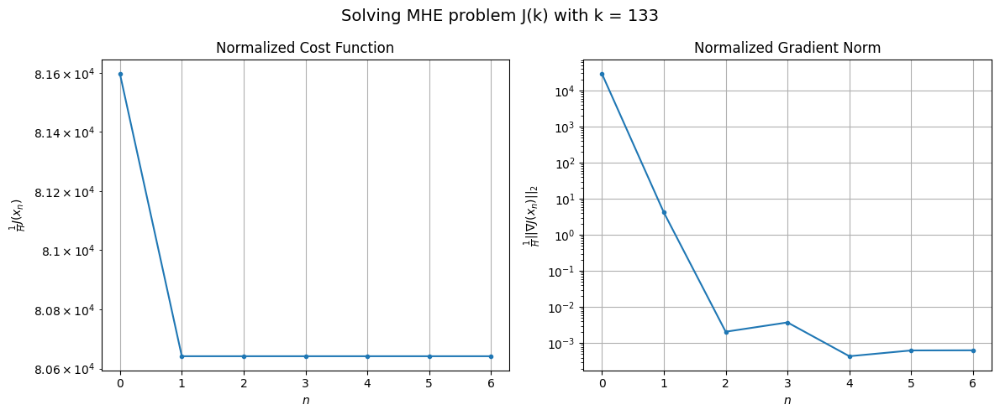

Windows:  25%|██▍       | 85/346 [14:00<38:55,  8.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3778841.6851471704
Gradient norm: 3023775.142416422
Global estimation error: 171.66191236060752
Initial conditions estimation errors: 85.72390291537948 m, 86.62345501211826 m, 86.02069021534518 m, 84.94694854675596 m
Position estimation errors: 59.46196781182525 m, 58.55761668307024 m, 58.947501236658404 m, 59.99896305699961 m

[Gauss-Newton] Iteration 1
Cost function: 3734701.390531821 (-1.17%)
Gradient norm: 176.85139794646895 (-99.99%)
Global estimation error: 184.8227530712358 (7.67%)
Initial conditions estimation errors: 91.54252525570531 m, 92.5039744997917 m, 92.59796972426035 m, 92.9945589143264 m
Position estimation errors: 53.68813175352679 m, 52.75240153041739 m, 52.357645185418704 m, 52.083213148522475 m

[Gauss-Newton] Iteration 2
Cost function: 3734701.3905316587 (-0.00%)
Gradient norm: 0.0958388478397262 (-99.95%)
Global estimation error: 184.83282848961812 (0.01%)
Initial conditions estimation errors: 91.542527

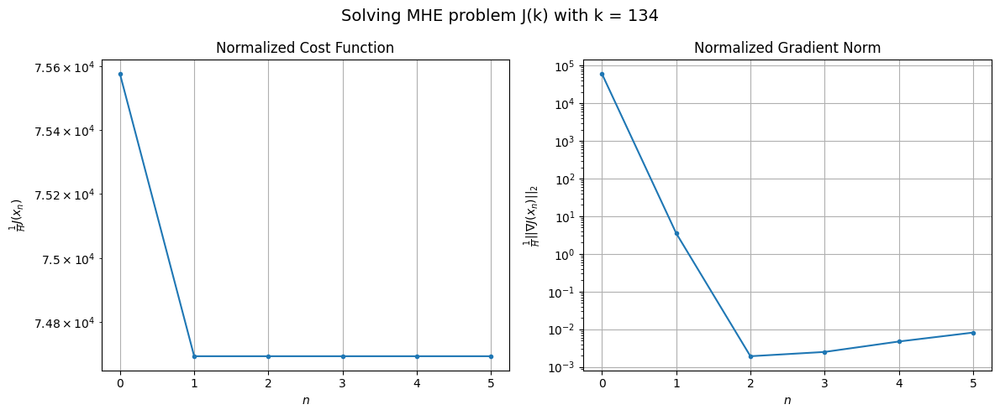

Windows:  25%|██▍       | 86/346 [14:08<37:25,  8.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3461031.8744674157
Gradient norm: 4803597.823716747
Global estimation error: 170.53498831984453
Initial conditions estimation errors: 84.34158480633809 m, 85.33659259609584 m, 85.46442086194502 m, 85.91925006279301 m
Position estimation errors: 53.92783183652466 m, 52.95684293108589 m, 52.51819010973473 m, 52.23706222913411 m

[Gauss-Newton] Iteration 1
Cost function: 3420720.3454387346 (-1.16%)
Gradient norm: 178.83833946074532 (-100.00%)
Global estimation error: 180.78628152030367 (6.01%)
Initial conditions estimation errors: 89.90995276216542 m, 90.65108212016878 m, 90.89503585192399 m, 90.11266804986788 m
Position estimation errors: 48.42140404846432 m, 47.737988407484266 m, 47.12648297173128 m, 48.079745748826596 m

[Gauss-Newton] Iteration 2
Cost function: 3420720.345421071 (-0.00%)
Gradient norm: 0.04173011119434845 (-99.98%)
Global estimation error: 180.78330157027844 (-0.00%)
Initial conditions estimation errors: 89.9

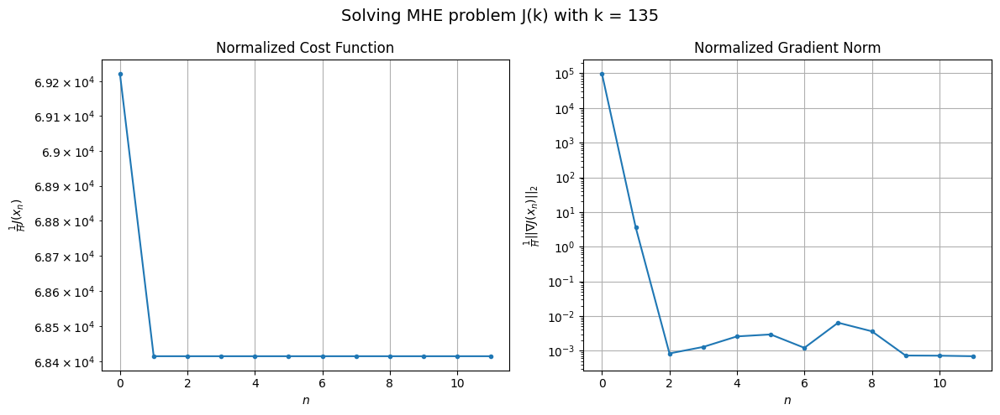

Windows:  25%|██▌       | 87/346 [14:23<45:24, 10.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3133978.9983352297
Gradient norm: 7032755.855724896
Global estimation error: 166.24400340208098
Initial conditions estimation errors: 82.58920245497247 m, 83.34388168342315 m, 83.6451343184722 m, 82.90547759320195 m
Position estimation errors: 48.376597600831005 m, 47.66861589687409 m, 46.996269236878334 m, 47.963966763061464 m

[Gauss-Newton] Iteration 1
Cost function: 3097412.629783454 (-1.17%)
Gradient norm: 164.27498186683403 (-100.00%)
Global estimation error: 176.11096387369795 (5.94%)
Initial conditions estimation errors: 87.89314516709068 m, 88.17487687468939 m, 88.9046728195997 m, 87.24077878774663 m
Position estimation errors: 43.12886454422216 m, 42.93763487001362 m, 41.75146986284352 m, 43.664744400508575 m

[Gauss-Newton] Iteration 2
Cost function: 3097412.629811329 (0.00%)
Gradient norm: 0.17897155134978218 (-99.89%)
Global estimation error: 176.11261881862913 (0.00%)
Initial conditions estimation errors: 87.8931

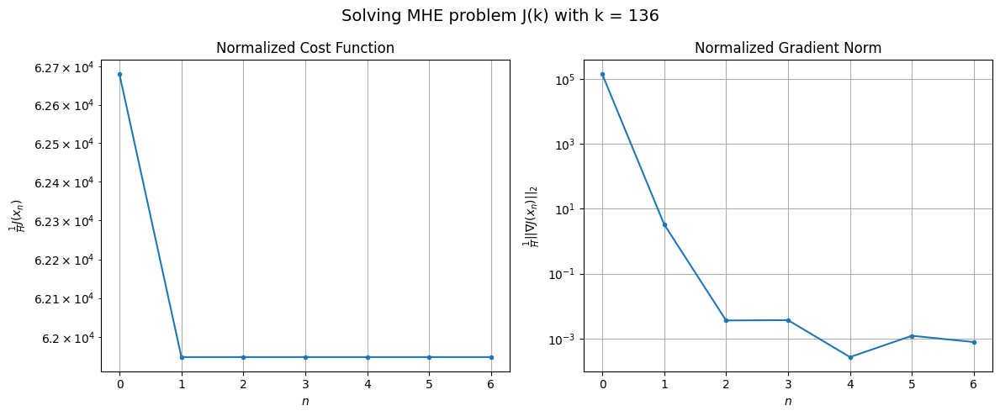

Windows:  25%|██▌       | 88/346 [14:32<43:04, 10.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2803424.8566212407
Gradient norm: 8465603.053808898
Global estimation error: 161.26800257788045
Initial conditions estimation errors: 80.42119496328506 m, 80.69199157159119 m, 81.51562276872318 m, 79.89830871501134 m
Position estimation errors: 42.82374276192022 m, 42.621418537800864 m, 41.32601782053848 m, 43.27430100588681 m

[Gauss-Newton] Iteration 1
Cost function: 2770801.230289765 (-1.16%)
Gradient norm: 144.81391697267767 (-100.00%)
Global estimation error: 172.0485336065423 (6.68%)
Initial conditions estimation errors: 85.42743294521252 m, 85.57489117984471 m, 86.84578803920611 m, 86.24112604003106 m
Position estimation errors: 37.85370597499854 m, 37.7860423668325 m, 35.98795124741237 m, 37.05206386501018 m

[Gauss-Newton] Iteration 2
Cost function: 2770801.2302886336 (-0.00%)
Gradient norm: 0.12490616569178134 (-99.91%)
Global estimation error: 172.05614650190867 (0.00%)
Initial conditions estimation errors: 85.42743

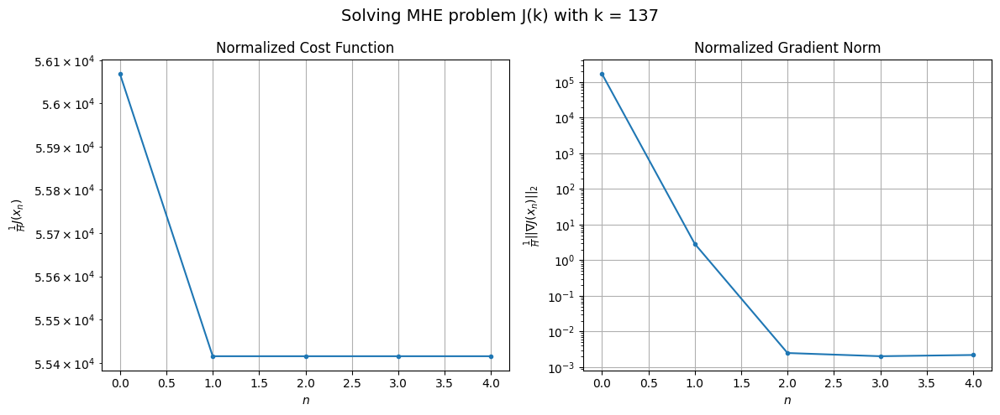

Windows:  26%|██▌       | 89/346 [14:38<38:53,  9.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2475299.3892240827
Gradient norm: 10397693.345021809
Global estimation error: 156.8285310491124
Initial conditions estimation errors: 77.78649525966827 m, 77.89997384644566 m, 79.30141583005827 m, 78.65913256837051 m
Position estimation errors: 37.34979853634656 m, 37.27251999913141 m, 35.350492688304826 m, 36.51058477606429 m

[Gauss-Newton] Iteration 1
Cost function: 2446334.3112532115 (-1.17%)
Gradient norm: 131.48140917140046 (-100.00%)
Global estimation error: 168.10385480470896 (7.19%)
Initial conditions estimation errors: 82.48797850622324 m, 82.81752715208572 m, 84.65014677079326 m, 86.19848524876141 m
Position estimation errors: 32.62451463011838 m, 32.34505998289114 m, 29.958301884061367 m, 29.019663956879008 m

[Gauss-Newton] Iteration 2
Cost function: 2446334.311238903 (-0.00%)
Gradient norm: 0.19252067395545308 (-99.85%)
Global estimation error: 168.1199698042386 (0.01%)
Initial conditions estimation errors: 82.48

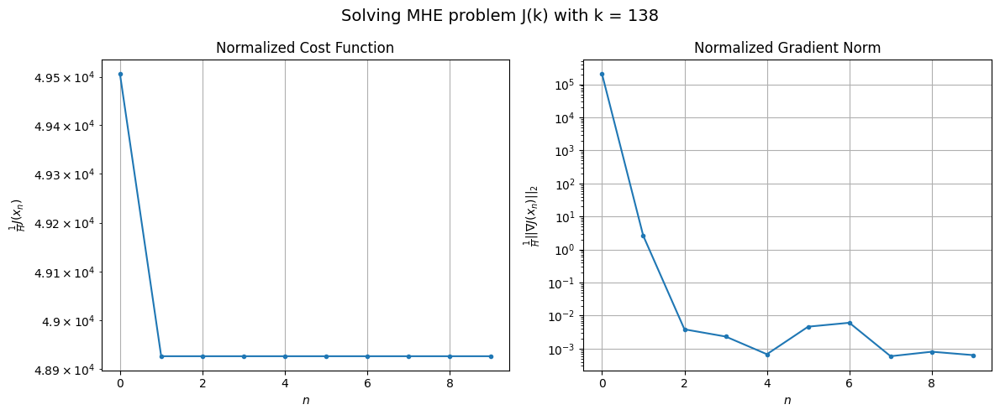

Windows:  26%|██▌       | 90/346 [14:51<43:47, 10.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2156378.012179583
Gradient norm: 11716969.22538661
Global estimation error: 152.56398631518903
Initial conditions estimation errors: 74.69353744816782 m, 74.96984004311196 m, 76.9663659015167 m, 78.43643454595076 m
Position estimation errors: 32.00536229578118 m, 31.712484724149412 m, 29.223383954936764 m, 28.37161842998369 m

[Gauss-Newton] Iteration 1
Cost function: 2131208.300875618 (-1.17%)
Gradient norm: 118.68302697849194 (-100.00%)
Global estimation error: 159.58289495988063 (4.60%)
Initial conditions estimation errors: 79.05186411872472 m, 79.28993140374386 m, 80.8460147945502 m, 79.96535641914231 m
Position estimation errors: 27.535067901697133 m, 27.28426365254067 m, 25.208773002303683 m, 26.78668127611376 m

[Gauss-Newton] Iteration 2
Cost function: 2131208.300817515 (-0.00%)
Gradient norm: 0.39953833139722994 (-99.66%)
Global estimation error: 159.56424502573466 (-0.01%)
Initial conditions estimation errors: 79.051

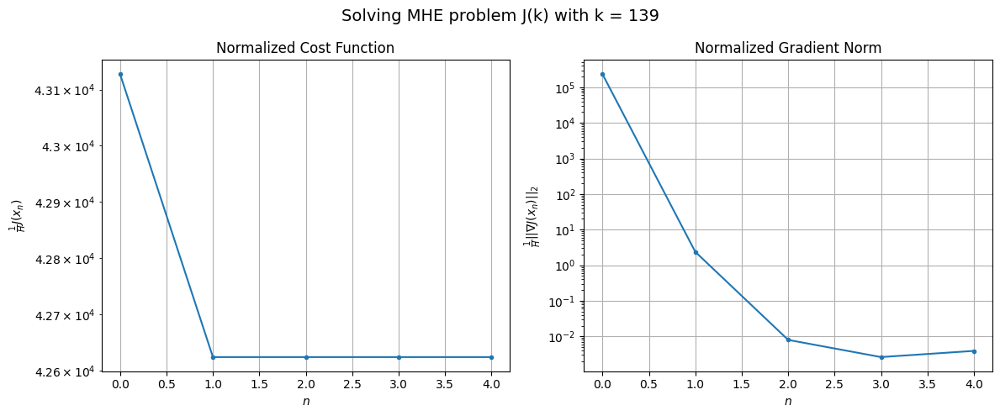

Windows:  26%|██▋       | 91/346 [14:58<39:16,  9.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1854837.1000761096
Gradient norm: 12650186.758810328
Global estimation error: 143.74915518922128
Initial conditions estimation errors: 71.15319617961188 m, 71.36030397701919 m, 73.03750760427852 m, 71.9318917193285 m
Position estimation errors: 26.923333090442398 m, 26.63591153400315 m, 24.48683835322575 m, 26.2207755145496 m

[Gauss-Newton] Iteration 1
Cost function: 1833462.2037335031 (-1.15%)
Gradient norm: 149.28690355545703 (-100.00%)
Global estimation error: 148.80623211361404 (3.52%)
Initial conditions estimation errors: 75.13685800782942 m, 74.86770020058052 m, 75.58919886752815 m, 71.96369198491539 m
Position estimation errors: 22.725818527756307 m, 22.982680769318076 m, 21.76921361484866 m, 26.127191116192776 m

[Gauss-Newton] Iteration 2
Cost function: 1833462.2036954712 (-0.00%)
Gradient norm: 0.18431268571813925 (-99.88%)
Global estimation error: 148.79251543253693 (-0.01%)
Initial conditions estimation errors: 75

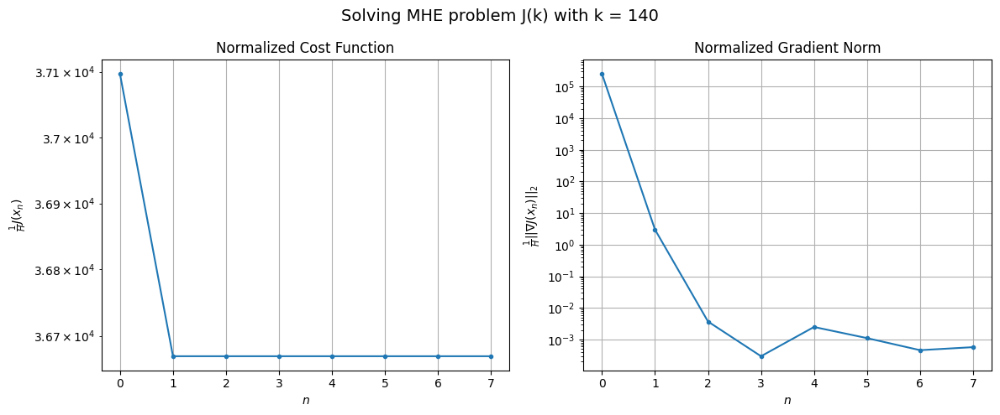

Windows:  27%|██▋       | 92/346 [15:09<40:42,  9.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1575802.7867092867
Gradient norm: 13446369.427858062
Global estimation error: 132.95877814057602
Initial conditions estimation errors: 67.20393790990116 m, 66.91237345548981 m, 67.73625901497245 m, 64.00098846973462 m
Position estimation errors: 22.306499629318548 m, 22.515018014009534 m, 21.21102259960143 m, 25.66836248594947 m

[Gauss-Newton] Iteration 1
Cost function: 1557741.5984353127 (-1.15%)
Gradient norm: 85.01753377416317 (-100.00%)
Global estimation error: 141.08570316782 (6.11%)
Initial conditions estimation errors: 70.82051180593658 m, 70.81953339998776 m, 71.68929333309883 m, 68.80984400193746 m
Position estimation errors: 18.362191651342393 m, 18.276662239551978 m, 17.10723960844956 m, 20.50764387503174 m

[Gauss-Newton] Iteration 2
Cost function: 1557741.5984281243 (-0.00%)
Gradient norm: 0.313252946118816 (-99.63%)
Global estimation error: 141.08974594864245 (0.00%)
Initial conditions estimation errors: 70.8205

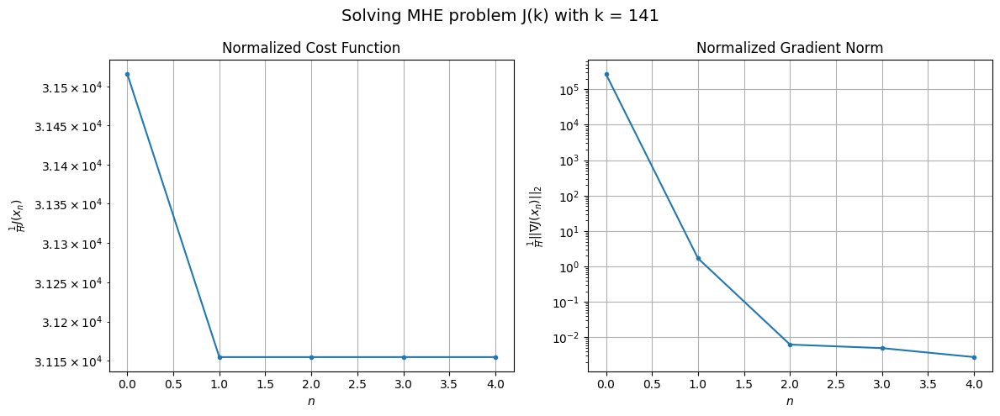

Windows:  27%|██▋       | 93/346 [15:16<37:29,  8.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1324202.2671060597
Gradient norm: 13700218.720584104
Global estimation error: 125.32413427790726
Initial conditions estimation errors: 62.9296551911186 m, 62.90126499048801 m, 63.8630701208621 m, 60.916852792703835 m
Position estimation errors: 18.40046323314342 m, 18.25399771510694 m, 17.13187002787458 m, 20.421148367766648 m

[Gauss-Newton] Iteration 1
Cost function: 1309521.5766676387 (-1.11%)
Gradient norm: 72.72303701107727 (-100.00%)
Global estimation error: 131.89716495957217 (5.24%)
Initial conditions estimation errors: 66.13968934003466 m, 65.9731721136552 m, 67.12954394182869 m, 64.52514613645087 m
Position estimation errors: 14.846766502252924 m, 15.044898778446331 m, 13.841454746297375 m, 16.4396009656546 m

[Gauss-Newton] Iteration 2
Cost function: 1309521.5766752944 (0.00%)
Gradient norm: 0.09951739384201493 (-99.86%)
Global estimation error: 131.89885926893382 (0.00%)
Initial conditions estimation errors: 66.139

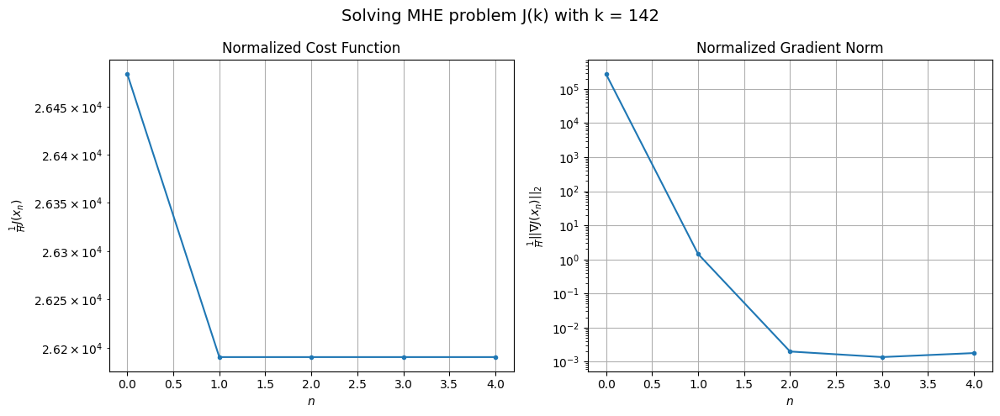

Windows:  27%|██▋       | 94/346 [15:23<35:12,  8.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1103636.4453498055
Gradient norm: 13841002.403500734
Global estimation error: 116.30072497394116
Initial conditions estimation errors: 58.35110420100006 m, 58.12846662103661 m, 59.40141938209886 m, 56.68764026002862 m
Position estimation errors: 15.697661075131887 m, 15.867913044955362 m, 14.858540980735617 m, 17.074127240342733 m

[Gauss-Newton] Iteration 1
Cost function: 1091882.0867345976 (-1.07%)
Gradient norm: 57.29338152346381 (-100.00%)
Global estimation error: 121.84407340638451 (4.77%)
Initial conditions estimation errors: 61.1608098762895 m, 61.01227710610835 m, 62.01568681479072 m, 59.47115938231743 m
Position estimation errors: 12.711669885110888 m, 12.990155682155256 m, 11.85262668596214 m, 13.978318176231552 m

[Gauss-Newton] Iteration 2
Cost function: 1091882.0867553735 (0.00%)
Gradient norm: 0.2137418541772647 (-99.63%)
Global estimation error: 121.8441444279328 (0.00%)
Initial conditions estimation errors: 61.

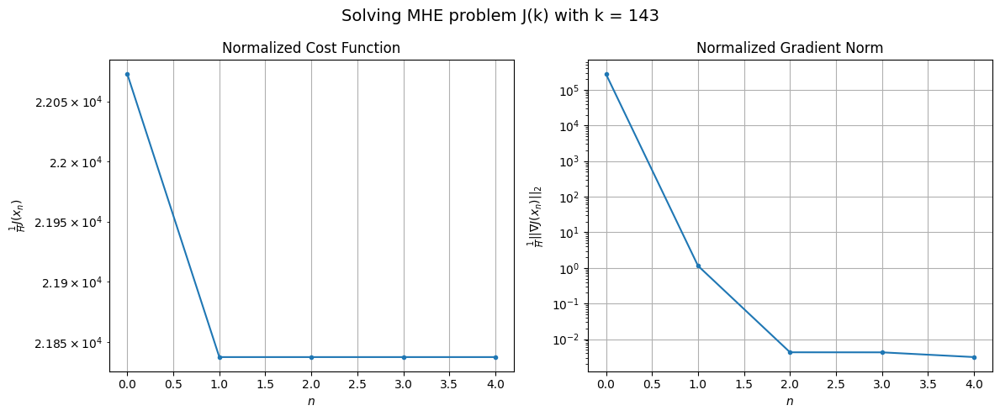

Windows:  27%|██▋       | 95/346 [15:30<32:59,  7.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 915732.8514695154
Gradient norm: 13689892.43137724
Global estimation error: 106.5522743447463
Initial conditions estimation errors: 53.50537369093275 m, 53.296642732555775 m, 54.41404732490174 m, 51.85627411486576 m
Position estimation errors: 14.667883699095922 m, 14.932887704367769 m, 13.977553189085684 m, 15.614958253865973 m

[Gauss-Newton] Iteration 1
Cost function: 906632.2055594851 (-0.99%)
Gradient norm: 40.72718023201066 (-100.00%)
Global estimation error: 110.89219004535815 (4.07%)
Initial conditions estimation errors: 55.909232009457256 m, 55.39175850255929 m, 56.79554558240694 m, 53.639404016380695 m
Position estimation errors: 12.509416354646232 m, 12.712965942849328 m, 12.17951038548448 m, 13.356675228442832 m

[Gauss-Newton] Iteration 2
Cost function: 906632.2055594341 (-0.00%)
Gradient norm: 0.09433960918533663 (-99.77%)
Global estimation error: 110.88995552511545 (-0.00%)
Initial conditions estimation errors: 

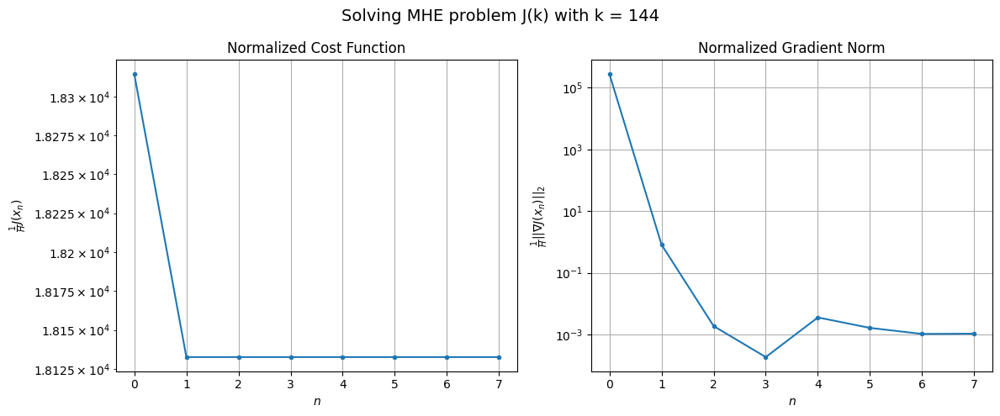

Windows:  28%|██▊       | 96/346 [15:40<35:33,  8.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 762739.1249819181
Gradient norm: 13584059.692680268
Global estimation error: 95.8465506668269
Initial conditions estimation errors: 48.40390456218766 m, 47.81833209305038 m, 49.34146504377137 m, 46.069348969449514 m
Position estimation errors: 15.505291272462618 m, 15.606944020938494 m, 15.315341408137146 m, 15.933728745282128 m

[Gauss-Newton] Iteration 1
Cost function: 755898.0858120886 (-0.90%)
Gradient norm: 46.56324521220775 (-100.00%)
Global estimation error: 101.15703334594447 (5.54%)
Initial conditions estimation errors: 50.4065444019644 m, 49.94356103144129 m, 51.76347833997905 m, 50.18010433178504 m
Position estimation errors: 14.145459514507206 m, 13.905384199961519 m, 14.910366022421323 m, 13.877658662978869 m

[Gauss-Newton] Iteration 2
Cost function: 755898.0858029622 (-0.00%)
Gradient norm: 0.22934160985134083 (-99.51%)
Global estimation error: 101.1658985862845 (0.01%)
Initial conditions estimation errors: 50.4

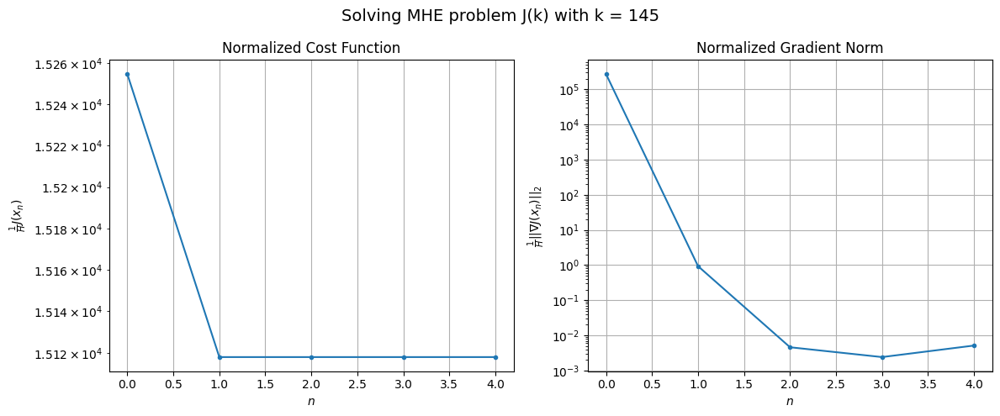

Windows:  28%|██▊       | 97/346 [15:47<33:47,  8.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 644624.1249973759
Gradient norm: 13230572.800983483
Global estimation error: 86.44760856759207
Initial conditions estimation errors: 43.08205001464707 m, 42.56799989549581 m, 44.46213837131885 m, 42.756851134453555 m
Position estimation errors: 17.803932857437076 m, 17.485730832305798 m, 18.6668073434528 m, 17.411366222041188 m

[Gauss-Newton] Iteration 1
Cost function: 639636.1965038937 (-0.77%)
Gradient norm: 42.75745921273649 (-100.00%)
Global estimation error: 90.44674453605542 (4.63%)
Initial conditions estimation errors: 44.69857623788181 m, 44.32310386833433 m, 45.49105702400737 m, 46.35317288495737 m
Position estimation errors: 16.952968826999324 m, 16.651590349030084 m, 17.613832411636736 m, 17.328599167055252 m

[Gauss-Newton] Iteration 2
Cost function: 639636.1965034145 (-0.00%)
Gradient norm: 0.20515618367817057 (-99.52%)
Global estimation error: 90.45206527016302 (0.01%)
Initial conditions estimation errors: 44.69

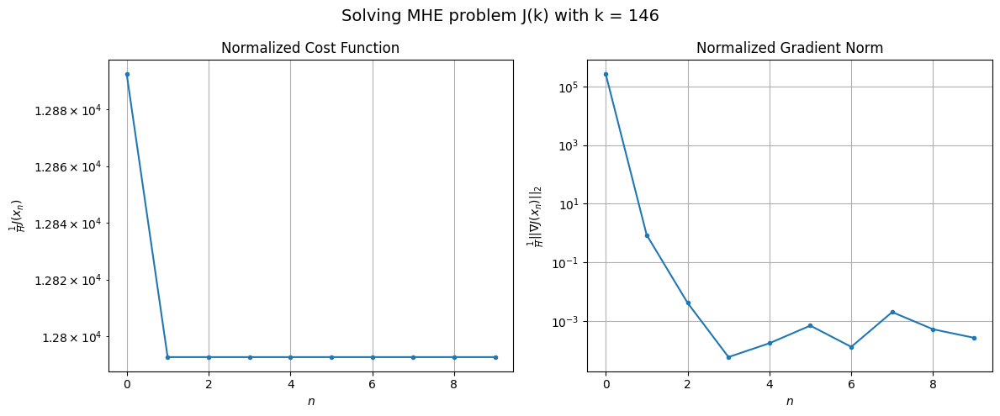

Windows:  28%|██▊       | 98/346 [16:00<39:02,  9.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 561445.5818688269
Gradient norm: 13280727.449714588
Global estimation error: 76.35038889771245
Initial conditions estimation errors: 37.617808826717436 m, 37.222681587444946 m, 38.4346612866993 m, 39.38878051400796 m
Position estimation errors: 20.947512534235575 m, 20.620176565750825 m, 21.643549760245733 m, 21.354600348846983 m

[Gauss-Newton] Iteration 1
Cost function: 557823.6524249188 (-0.65%)
Gradient norm: 27.62388932314298 (-100.00%)
Global estimation error: 77.46330643225564 (1.46%)
Initial conditions estimation errors: 38.859134133110985 m, 38.33879047293112 m, 39.17690856009732 m, 38.54586203274896 m
Position estimation errors: 20.26256996613053 m, 19.560806545415794 m, 20.12790480895284 m, 19.48752810194933 m

[Gauss-Newton] Iteration 2
Cost function: 557823.6524184329 (-0.00%)
Gradient norm: 0.019560844586061703 (-99.93%)
Global estimation error: 77.45738700465628 (-0.01%)
Initial conditions estimation errors: 38.

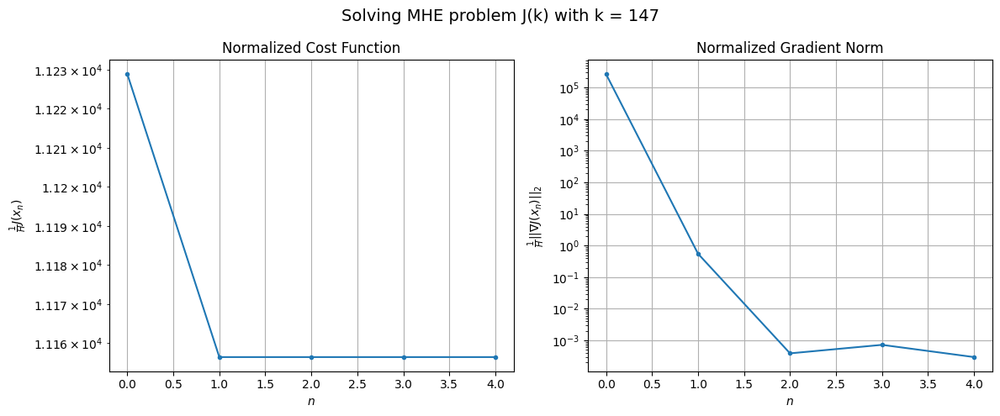

Windows:  29%|██▊       | 99/346 [16:07<36:01,  8.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 512647.7359446827
Gradient norm: 13797983.111299027
Global estimation error: 64.02173061828772
Initial conditions estimation errors: 32.09684909179403 m, 31.576266304897363 m, 32.45736366155823 m, 31.90586165095816 m
Position estimation errors: 24.41579706763898 m, 23.692043315701998 m, 24.26949228595729 m, 23.684058940731436 m

[Gauss-Newton] Iteration 1
Cost function: 509894.18913291045 (-0.54%)
Gradient norm: 7.847221806552311 (-100.00%)
Global estimation error: 66.53978780917396 (3.93%)
Initial conditions estimation errors: 32.98296385685774 m, 32.68798722760754 m, 33.53612670260201 m, 33.85914961181988 m
Position estimation errors: 23.676289973552894 m, 23.28369146962281 m, 24.1769331845006 m, 24.020079674774824 m

[Gauss-Newton] Iteration 2
Cost function: 509894.1891231479 (-0.00%)
Gradient norm: 0.029054259462659947 (-99.63%)
Global estimation error: 66.54097183605052 (0.00%)
Initial conditions estimation errors: 32.982

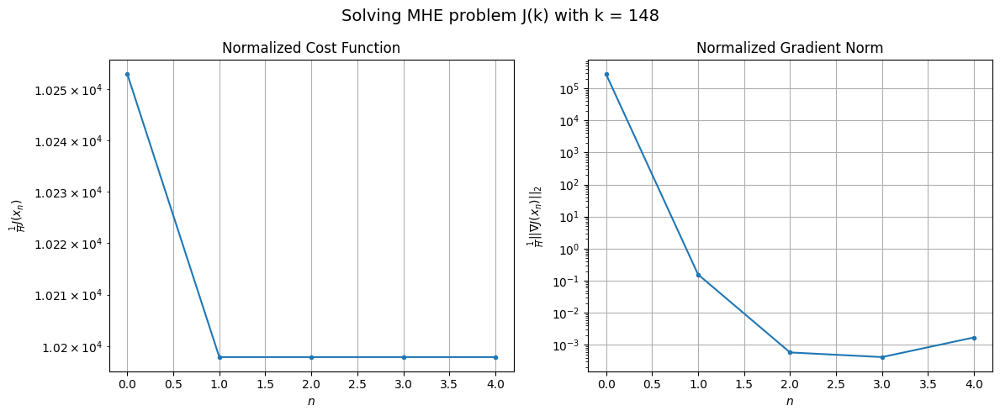

Windows:  29%|██▉       | 100/346 [16:14<33:41,  8.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 493681.27915079665
Gradient norm: 13687920.203653771
Global estimation error: 53.860017282823385
Initial conditions estimation errors: 26.58795102339173 m, 26.288611815157616 m, 27.170786152606283 m, 27.651329721140552 m
Position estimation errors: 27.900857185129876 m, 27.51070579751553 m, 28.419016398962533 m, 28.359864858225976 m

[Gauss-Newton] Iteration 1
Cost function: 491449.204848045 (-0.45%)
Gradient norm: 27.708801579716415 (-100.00%)
Global estimation error: 54.09738706675255 (0.44%)
Initial conditions estimation errors: 27.16719318663939 m, 26.70890819119413 m, 27.131927990389308 m, 27.183087731718842 m
Position estimation errors: 27.045080851908683 m, 26.423161279259464 m, 27.003649089371176 m, 26.732450429133355 m

[Gauss-Newton] Iteration 2
Cost function: 491449.2048434293 (-0.00%)
Gradient norm: 0.26453996817268066 (-99.05%)
Global estimation error: 54.09588656036078 (-0.00%)
Initial conditions estimation error

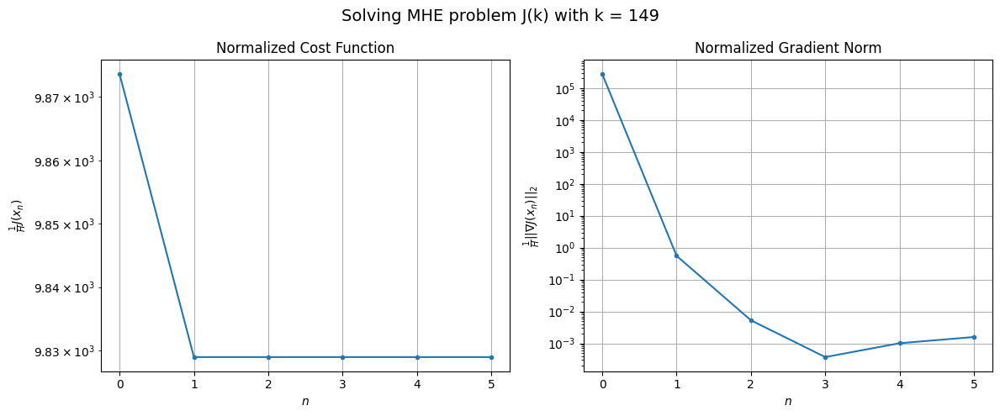

Windows:  29%|██▉       | 101/346 [16:22<34:06,  8.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 503878.20800633176
Gradient norm: 14288037.527937002
Global estimation error: 42.22769812106015
Initial conditions estimation errors: 21.13643399767693 m, 20.702125917115197 m, 21.153011044582172 m, 21.456076648721357 m
Position estimation errors: 31.29974539013085 m, 30.693181692073104 m, 31.292364419790154 m, 31.218381324585923 m

[Gauss-Newton] Iteration 1
Cost function: 501693.8801208709 (-0.43%)
Gradient norm: 88.08966371358426 (-100.00%)
Global estimation error: 43.6102114129369 (3.27%)
Initial conditions estimation errors: 21.436971307270287 m, 21.287911653240307 m, 20.417093644083277 m, 23.921459290844396 m
Position estimation errors: 30.213793543489867 m, 29.659416815970147 m, 29.19462433926176 m, 31.465046813745882 m

[Gauss-Newton] Iteration 2
Cost function: 501693.8801035974 (-0.00%)
Gradient norm: 0.11896900741502167 (-99.86%)
Global estimation error: 43.61007032519312 (-0.00%)
Initial conditions estimation errors

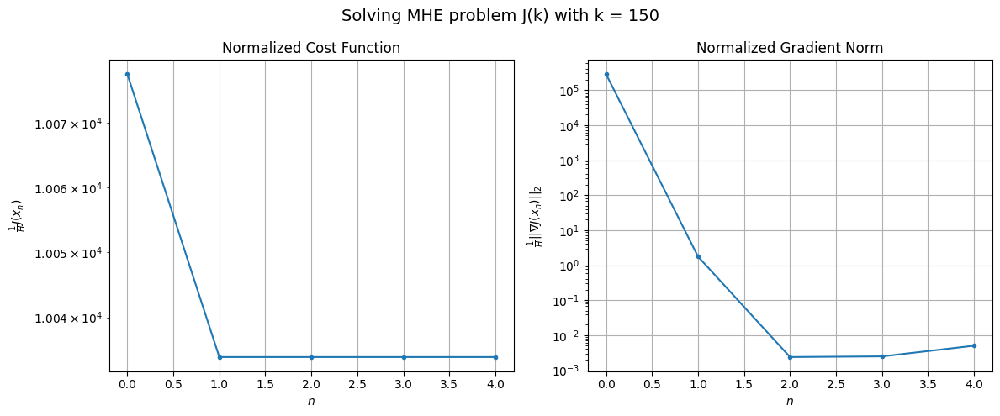

Windows:  29%|██▉       | 102/346 [16:29<31:52,  7.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 538074.5497509821
Gradient norm: 14566202.39924282
Global estimation error: 32.65369283209191
Initial conditions estimation errors: 15.733549460848778 m, 15.66031461671685 m, 14.832533165307995 m, 18.799888043498957 m
Position estimation errors: 34.47392874609222 m, 33.94957448864186 m, 33.53522491128719 m, 36.148655270675754 m

[Gauss-Newton] Iteration 1
Cost function: 535649.88194737 (-0.45%)
Gradient norm: 96.10884212635355 (-100.00%)
Global estimation error: 35.370262234875604 (8.32%)
Initial conditions estimation errors: 15.845378444996987 m, 16.649479485155247 m, 14.484649188021873 m, 22.648088810327106 m
Position estimation errors: 33.159530956320566 m, 33.878421903606224 m, 32.60316068527724 m, 38.32142809800113 m

[Gauss-Newton] Iteration 2
Cost function: 535649.8819126888 (-0.00%)
Gradient norm: 0.039247573145060846 (-99.96%)
Global estimation error: 35.36890301281467 (-0.00%)
Initial conditions estimation errors: 15

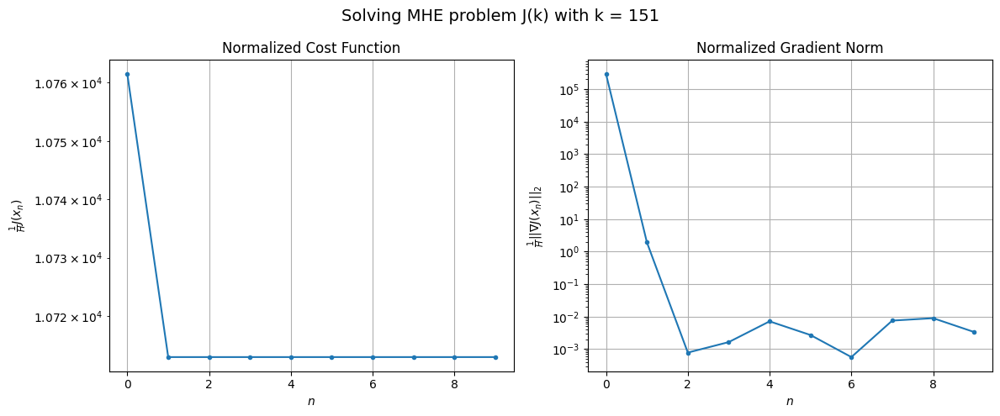

Windows:  30%|██▉       | 103/346 [16:43<39:27,  9.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 592605.8252606512
Gradient norm: 14726416.959043361
Global estimation error: 25.433613544456612
Initial conditions estimation errors: 10.498797613592284 m, 11.333098218884226 m, 9.280572827084317 m, 17.945643600128314 m
Position estimation errors: 37.410365494864536 m, 38.182364065927615 m, 37.037106828905735 m, 43.15254290663561 m

[Gauss-Newton] Iteration 1
Cost function: 589699.5775920857 (-0.49%)
Gradient norm: 275.4935432339186 (-100.00%)
Global estimation error: 22.212115155779742 (-12.67%)
Initial conditions estimation errors: 10.58265931098323 m, 10.628749043783902 m, 10.69373338369069 m, 12.410774207918857 m
Position estimation errors: 35.85653137851191 m, 35.35452415955035 m, 35.72151484755337 m, 36.48859621520783 m

[Gauss-Newton] Iteration 2
Cost function: 589699.5774045208 (-0.00%)
Gradient norm: 0.21774429964648437 (-99.92%)
Global estimation error: 22.212485544444426 (0.00%)
Initial conditions estimation errors:

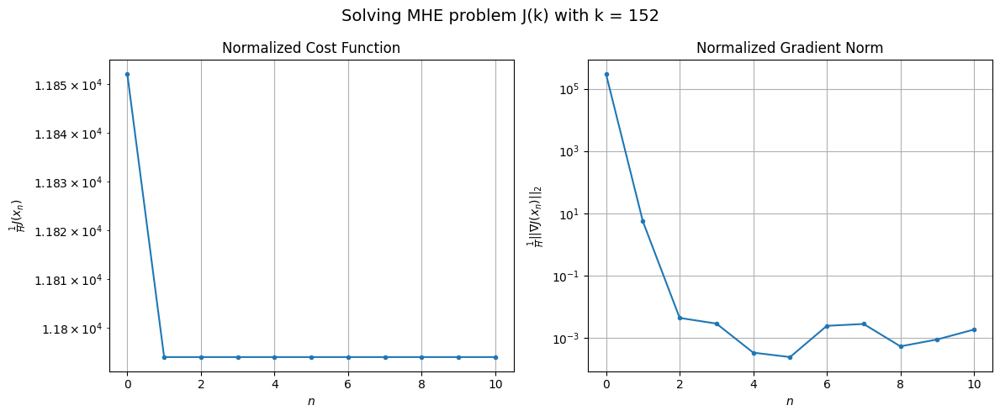

Windows:  30%|███       | 104/346 [16:58<44:44, 11.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 664221.739541131
Gradient norm: 15167952.257273167
Global estimation error: 13.454722662954062
Initial conditions estimation errors: 6.084740719442284 m, 6.258708544122391 m, 6.259549276683729 m, 8.100915158425606 m
Position estimation errors: 40.095576615152034 m, 39.59212142462727 m, 39.97613647415265 m, 40.9757842251234 m

[Gauss-Newton] Iteration 1
Cost function: 660542.621050528 (-0.55%)
Gradient norm: 20.55063108978732 (-100.00%)
Global estimation error: 14.343747204716887 (6.61%)
Initial conditions estimation errors: 6.648934219503635 m, 6.75266536023325 m, 6.983997526166579 m, 8.193415864407264 m
Position estimation errors: 38.27886189563653 m, 37.46578935549638 m, 38.278010625177124 m, 37.6072535406533 m

[Gauss-Newton] Iteration 2
Cost function: 660542.6210383916 (-0.00%)
Gradient norm: 0.03968641840343217 (-99.81%)
Global estimation error: 14.343945628013595 (0.00%)
Initial conditions estimation errors: 6.6489335451

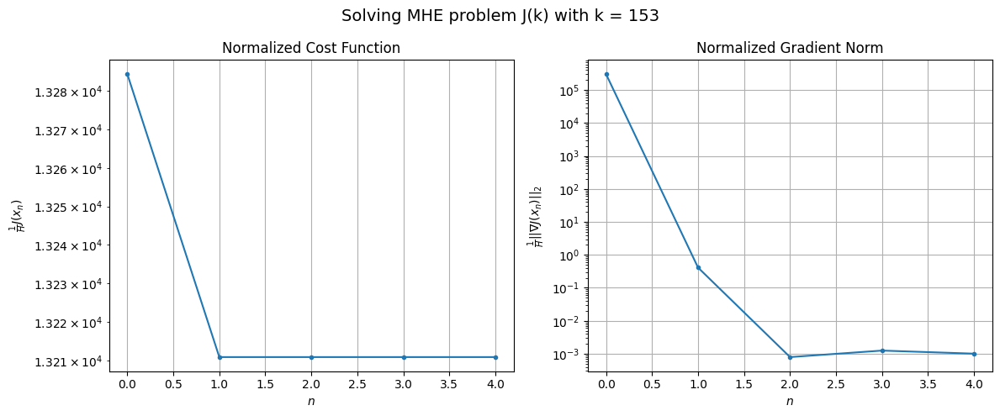

Windows:  30%|███       | 105/346 [17:05<40:13, 10.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 748924.6312544061
Gradient norm: 15803964.873549102
Global estimation error: 11.892133725306302
Initial conditions estimation errors: 5.351451606630597 m, 5.863164210948062 m, 5.542714684542718 m, 6.903923528563996 m
Position estimation errors: 42.50679926613076 m, 41.70175468877093 m, 42.505419304578176 m, 42.06914139709604 m

[Gauss-Newton] Iteration 1
Cost function: 744154.5844986916 (-0.64%)
Gradient norm: 65.74098203006697 (-100.00%)
Global estimation error: 15.400620304718926 (29.50%)
Initial conditions estimation errors: 6.980769043190362 m, 7.353100587501546 m, 6.817061614132343 m, 9.374730852294563 m
Position estimation errors: 40.40926855189627 m, 40.17773122611511 m, 40.32896322802964 m, 41.63904013522898 m

[Gauss-Newton] Iteration 2
Cost function: 744154.5844809344 (-0.00%)
Gradient norm: 0.12785585806893215 (-99.81%)
Global estimation error: 15.400166560952526 (-0.00%)
Initial conditions estimation errors: 6.9807

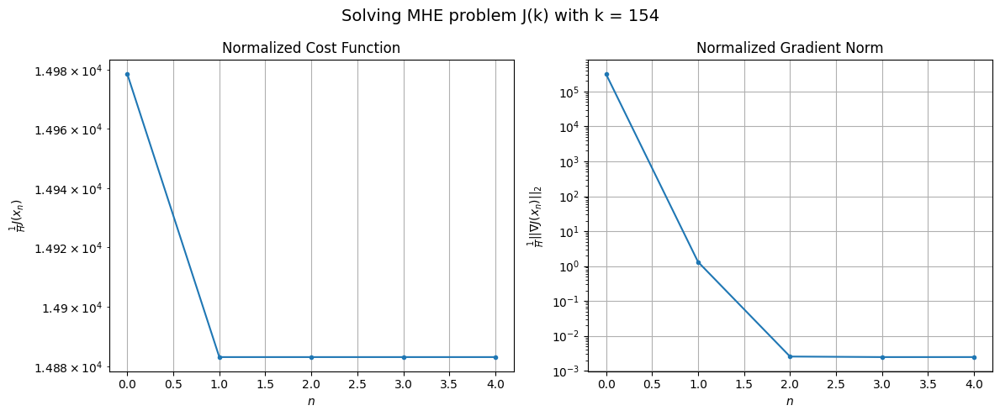

Windows:  31%|███       | 106/346 [17:12<36:51,  9.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 842107.8214265412
Gradient norm: 16397732.96616741
Global estimation error: 18.143293450299627
Initial conditions estimation errors: 8.959855946888263 m, 9.117232288082764 m, 8.813949961974723 m, 9.384797422614191 m
Position estimation errors: 44.61556019726961 m, 44.393542747598175 m, 44.60155756951112 m, 46.27529124462349 m

[Gauss-Newton] Iteration 1
Cost function: 836069.3478248434 (-0.72%)
Gradient norm: 18.512813226871927 (-100.00%)
Global estimation error: 22.4148233935338 (23.54%)
Initial conditions estimation errors: 10.94947977202787 m, 11.035174414561997 m, 10.613302612440442 m, 12.169612042473744 m
Position estimation errors: 42.25361629075199 m, 42.04844231125272 m, 42.400639188787 m, 42.557775114561856 m

[Gauss-Newton] Iteration 2
Cost function: 836069.3478088949 (-0.00%)
Gradient norm: 0.14287490663290842 (-99.23%)
Global estimation error: 22.415115717730963 (0.00%)
Initial conditions estimation errors: 10.9494

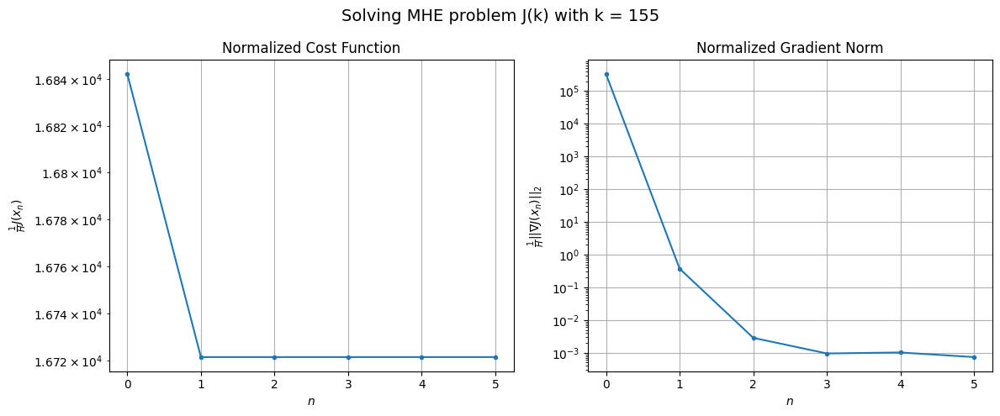

Windows:  31%|███       | 107/346 [17:21<35:47,  8.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 938035.0235692888
Gradient norm: 16808411.14484468
Global estimation error: 26.775192195493418
Initial conditions estimation errors: 13.445959986830436 m, 13.450324063965681 m, 13.0718649295076 m, 13.576480269359866 m
Position estimation errors: 46.408138734127284 m, 46.21760329674104 m, 46.59886371740898 m, 47.127727752514936 m

[Gauss-Newton] Iteration 1
Cost function: 930770.1582114128 (-0.77%)
Gradient norm: 60.83486306449614 (-100.00%)
Global estimation error: 30.478231091632292 (13.83%)
Initial conditions estimation errors: 15.60017334211271 m, 15.399540255641348 m, 14.567790461392276 m, 15.36810659211183 m
Position estimation errors: 43.81340111010457 m, 43.777336579121645 m, 44.6413471615428 m, 44.15182173735642 m

[Gauss-Newton] Iteration 2
Cost function: 930770.1582097244 (-0.00%)
Gradient norm: 0.016890006856858434 (-99.97%)
Global estimation error: 30.477228807087606 (-0.00%)
Initial conditions estimation errors: 1

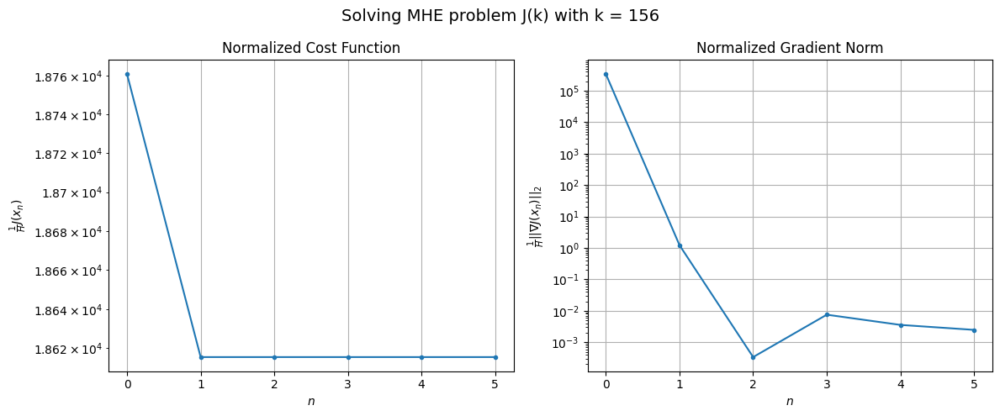

Windows:  31%|███       | 108/346 [17:29<35:14,  8.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1033667.0605067448
Gradient norm: 17534977.722352426
Global estimation error: 34.67111702086319
Initial conditions estimation errors: 17.79031770065379 m, 17.607527262685593 m, 16.75215942987493 m, 17.173311854174564 m
Position estimation errors: 47.88067057490926 m, 47.85676550722619 m, 48.68489236262513 m, 48.39190114075706 m

[Gauss-Newton] Iteration 1
Cost function: 1024959.9181558917 (-0.84%)
Gradient norm: 82.18183555583698 (-100.00%)
Global estimation error: 37.90154798650449 (9.32%)
Initial conditions estimation errors: 20.141375388138066 m, 19.504024239785988 m, 19.17264377298438 m, 16.818032306569766 m
Position estimation errors: 45.04814824582406 m, 45.40716735375802 m, 45.89318372853824 m, 47.62665677364368 m

[Gauss-Newton] Iteration 2
Cost function: 1024959.9181540357 (-0.00%)
Gradient norm: 0.06923858672297035 (-99.92%)
Global estimation error: 37.90219772788301 (0.00%)
Initial conditions estimation errors: 20.1

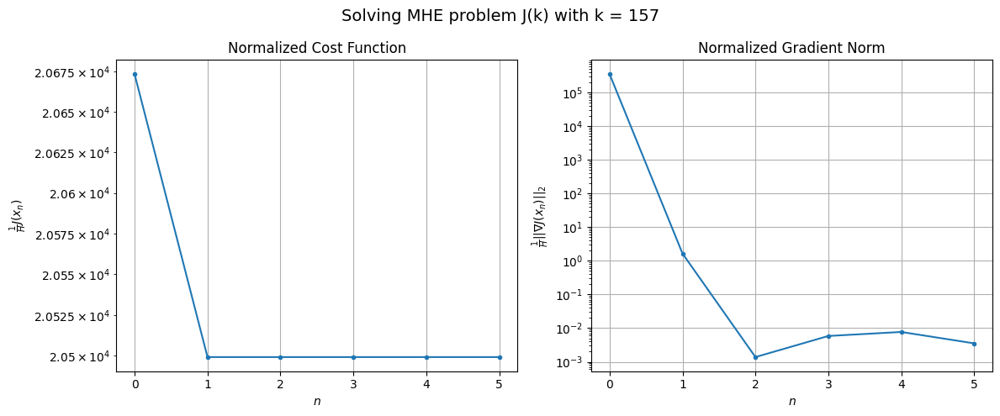

Windows:  32%|███▏      | 109/346 [17:38<34:38,  8.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1126047.5619436007
Gradient norm: 18174964.917417135
Global estimation error: 41.37327538675661
Initial conditions estimation errors: 21.880267878336 m, 21.2718002511019 m, 20.924734476544693 m, 18.51111357028648 m
Position estimation errors: 48.99950781678325 m, 49.34262637288511 m, 49.804518484238905 m, 51.50178022503857 m

[Gauss-Newton] Iteration 1
Cost function: 1115937.4679619197 (-0.90%)
Gradient norm: 52.28254914823713 (-100.00%)
Global estimation error: 46.97801316935611 (13.55%)
Initial conditions estimation errors: 24.415225788927454 m, 24.12728824720762 m, 23.87333026193082 m, 21.418730803985376 m
Position estimation errors: 45.95181832649216 m, 46.087402243795815 m, 46.40645656215096 m, 48.62050427620729 m

[Gauss-Newton] Iteration 2
Cost function: 1115937.4679397368 (-0.00%)
Gradient norm: 0.2773354847789169 (-99.47%)
Global estimation error: 46.97897869626121 (0.00%)
Initial conditions estimation errors: 24.4152

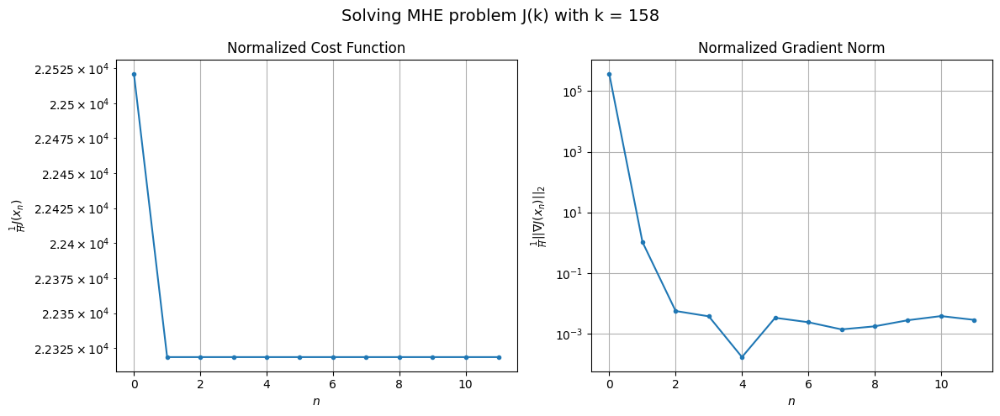

Windows:  32%|███▏      | 110/346 [17:54<42:31, 10.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1209612.140034854
Gradient norm: 19302591.86237102
Global estimation error: 49.37397928124398
Initial conditions estimation errors: 25.733579334141048 m, 25.415963396171367 m, 25.163080791982605 m, 22.280395803976774 m
Position estimation errors: 49.79062929420804 m, 49.942501957234974 m, 50.270352255804404 m, 52.56311723946988 m

[Gauss-Newton] Iteration 1
Cost function: 1198132.1979140653 (-0.95%)
Gradient norm: 32.4475924625075 (-100.00%)
Global estimation error: 55.33740410970858 (12.08%)
Initial conditions estimation errors: 28.426914759166323 m, 28.33932289643171 m, 27.84835523865788 m, 25.990107739346954 m
Position estimation errors: 46.540420367342186 m, 46.61594392040358 m, 47.13895711943715 m, 48.5277056129109 m

[Gauss-Newton] Iteration 2
Cost function: 1198132.1979111475 (-0.00%)
Gradient norm: 0.22319386860970203 (-99.31%)
Global estimation error: 55.33770040930766 (0.00%)
Initial conditions estimation errors: 28.

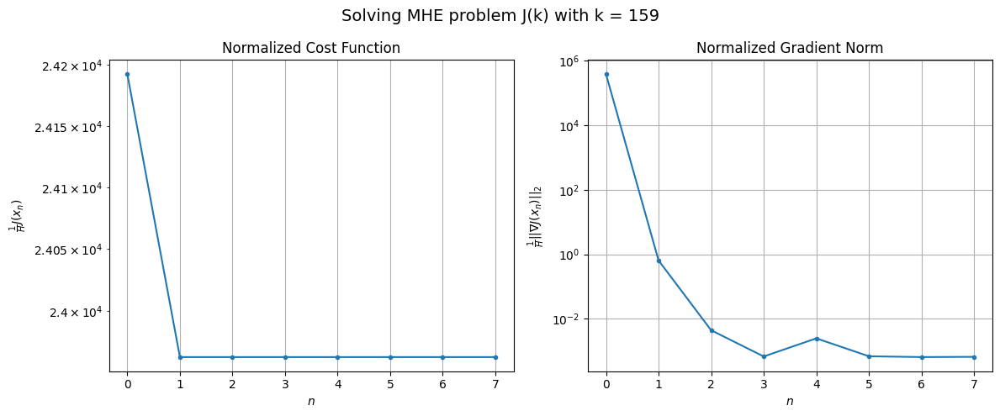

Windows:  32%|███▏      | 111/346 [18:04<41:57, 10.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1283836.1085478594
Gradient norm: 20196846.57160776
Global estimation error: 57.041180441197284
Initial conditions estimation errors: 29.36170122180252 m, 29.247340392392733 m, 28.767729577648673 m, 26.619426842824694 m
Position estimation errors: 50.29148058104281 m, 50.42253424701025 m, 50.935863745340306 m, 52.33855430295562 m

[Gauss-Newton] Iteration 1
Cost function: 1271210.6881651229 (-0.98%)
Gradient norm: 36.42158903793508 (-100.00%)
Global estimation error: 63.53822344205775 (11.39%)
Initial conditions estimation errors: 32.188193652182335 m, 32.36764489752149 m, 31.581281757488252 m, 30.91893227926956 m
Position estimation errors: 46.872611749092265 m, 46.726478574289686 m, 47.39201002567384 m, 47.60719842270615 m

[Gauss-Newton] Iteration 2
Cost function: 1271210.6881736398 (0.00%)
Gradient norm: 0.17066537714260788 (-99.53%)
Global estimation error: 63.53883795045679 (0.00%)
Initial conditions estimation errors: 3

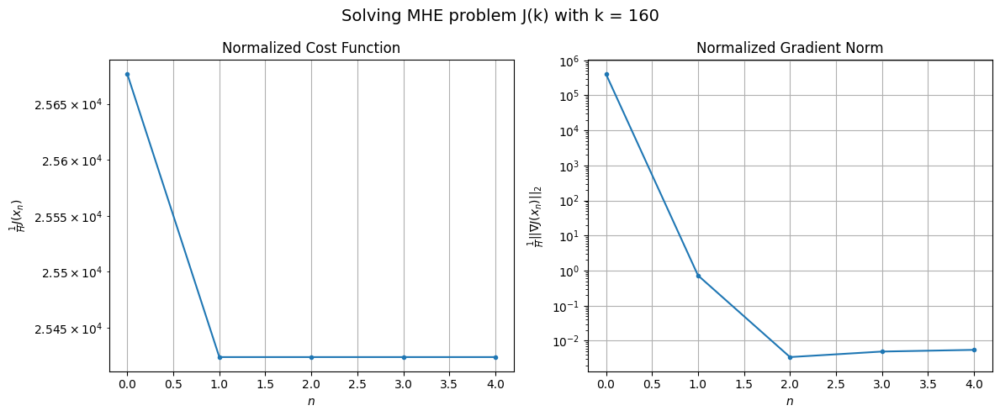

Windows:  32%|███▏      | 112/346 [18:11<37:54,  9.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1347770.2216856678
Gradient norm: 21806644.843928266
Global estimation error: 64.5886181174349
Initial conditions estimation errors: 32.746521414595456 m, 32.90023441142838 m, 32.15635762334984 m, 31.351159800574003 m
Position estimation errors: 50.562656343441304 m, 50.46755814896797 m, 51.06732724264313 m, 51.27721361199203 m

[Gauss-Newton] Iteration 1
Cost function: 1333794.8909053246 (-1.04%)
Gradient norm: 56.38800614033628 (-100.00%)
Global estimation error: 72.278585879781 (11.91%)
Initial conditions estimation errors: 35.710310688560895 m, 36.3820237113044 m, 34.99195010193685 m, 37.42828350637206 m
Position estimation errors: 46.93869272927195 m, 46.33014210844306 m, 47.37432350111448 m, 44.97600300659152 m

[Gauss-Newton] Iteration 2
Cost function: 1333794.8909048678 (-0.00%)
Gradient norm: 0.1862201739623976 (-99.67%)
Global estimation error: 72.27928381686414 (0.00%)
Initial conditions estimation errors: 35.710313

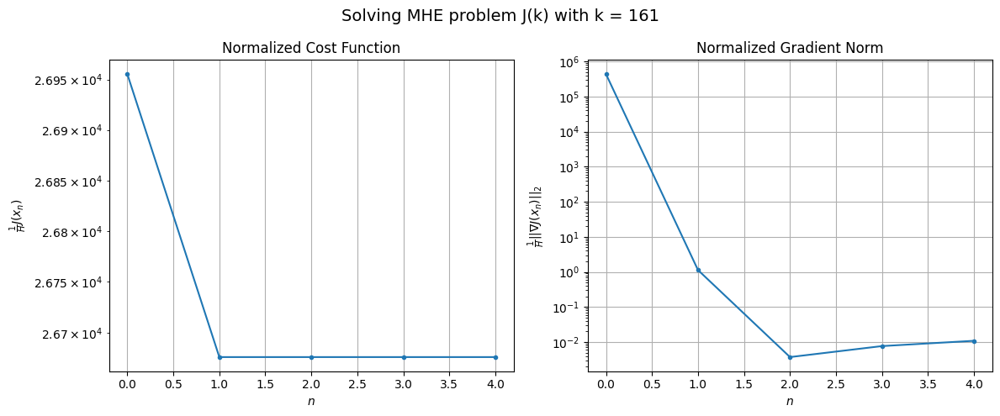

Windows:  33%|███▎      | 113/346 [18:19<34:52,  8.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1398192.7365825358
Gradient norm: 23497401.097278044
Global estimation error: 72.59896210484213
Initial conditions estimation errors: 35.859096569230914 m, 36.51242878479143 m, 35.21724318602864 m, 37.56754112482876 m
Position estimation errors: 50.55505472988557 m, 49.987962188860514 m, 50.885965042646454 m, 48.59348536860842 m

[Gauss-Newton] Iteration 1
Cost function: 1382899.7242059554 (-1.09%)
Gradient norm: 48.40180408398484 (-100.00%)
Global estimation error: 79.03437756877543 (8.86%)
Initial conditions estimation errors: 38.95746906464571 m, 39.64847241462555 m, 38.24031097084961 m, 41.16337314558644 m
Position estimation errors: 46.725539554976976 m, 46.0902592673632 m, 47.124446747416265 m, 44.58546008823182 m

[Gauss-Newton] Iteration 2
Cost function: 1382899.724266135 (0.00%)
Gradient norm: 0.17212259500535707 (-99.64%)
Global estimation error: 79.0360018978547 (0.00%)
Initial conditions estimation errors: 38.95747

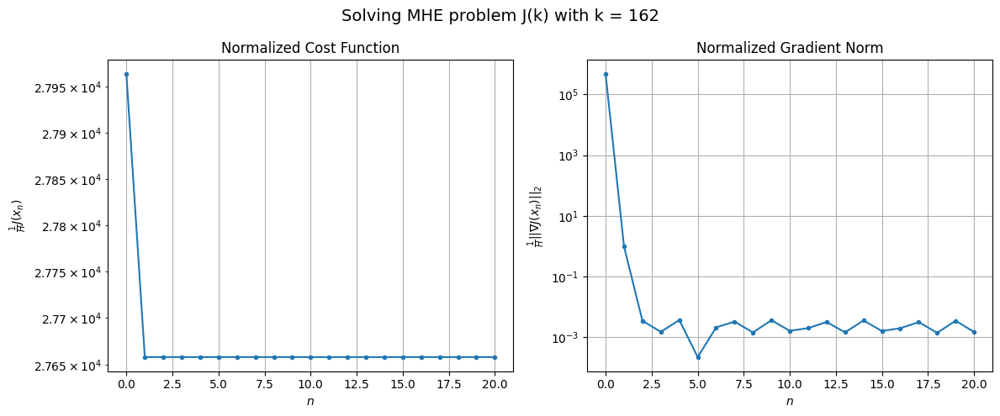

Windows:  33%|███▎      | 114/346 [18:49<58:54, 15.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1432627.0087741406
Gradient norm: 24755060.200906508
Global estimation error: 78.56004110790538
Initial conditions estimation errors: 38.63224289311925 m, 39.320557608313706 m, 38.040592643793694 m, 41.06134700801428 m
Position estimation errors: 50.218510235466766 m, 49.620950479613605 m, 50.47242905492725 m, 48.10543877785898 m

[Gauss-Newton] Iteration 1
Cost function: 1416270.4236785294 (-1.14%)
Gradient norm: 305.3987212286386 (-100.00%)
Global estimation error: 84.12740947300331 (7.09%)
Initial conditions estimation errors: 41.84647434437205 m, 42.03078013379608 m, 40.80282892183852 m, 43.52968072306951 m
Position estimation errors: 46.21342921673911 m, 45.88188152532224 m, 46.850847662487226 m, 44.47583700478496 m

[Gauss-Newton] Iteration 2
Cost function: 1416270.4236045722 (-0.00%)
Gradient norm: 0.1265602000911071 (-99.96%)
Global estimation error: 84.12369183101855 (-0.00%)
Initial conditions estimation errors: 41.8

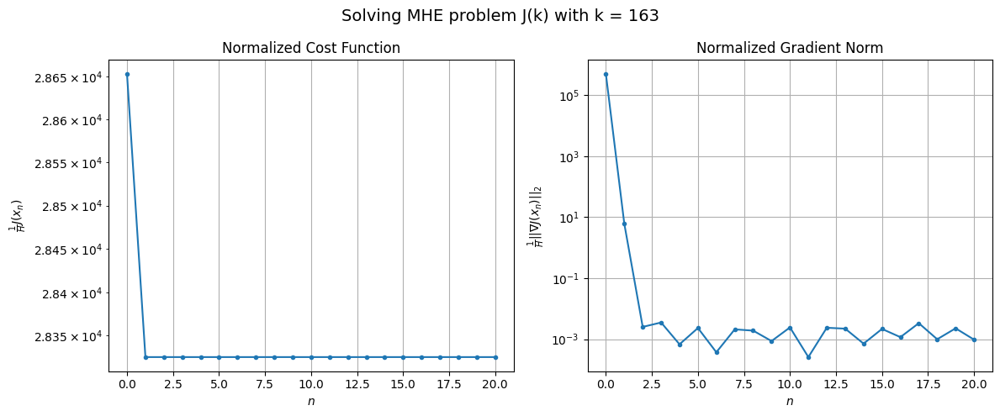

Windows:  33%|███▎      | 115/346 [19:21<1:18:06, 20.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1451015.157493729
Gradient norm: 26350267.888499934
Global estimation error: 82.07910293168707
Initial conditions estimation errors: 40.96500485534467 m, 41.11254562977774 m, 39.93393760329819 m, 42.117479473383 m
Position estimation errors: 49.51950621146205 m, 49.17724166222876 m, 50.09844831415234 m, 48.03368055865285 m

[Gauss-Newton] Iteration 1
Cost function: 1433710.7426749596 (-1.19%)
Gradient norm: 52.12073840418098 (-100.00%)
Global estimation error: 89.40916213811994 (8.93%)
Initial conditions estimation errors: 44.276441798861384 m, 44.45293854197823 m, 43.27353809082481 m, 46.74321361938737 m
Position estimation errors: 45.33642465987172 m, 44.990160961896244 m, 45.860794932888666 m, 42.937059018803915 m

[Gauss-Newton] Iteration 2
Cost function: 1433710.7426658375 (-0.00%)
Gradient norm: 0.1390993266419556 (-99.73%)
Global estimation error: 89.41117524514372 (0.00%)
Initial conditions estimation errors: 44.276446

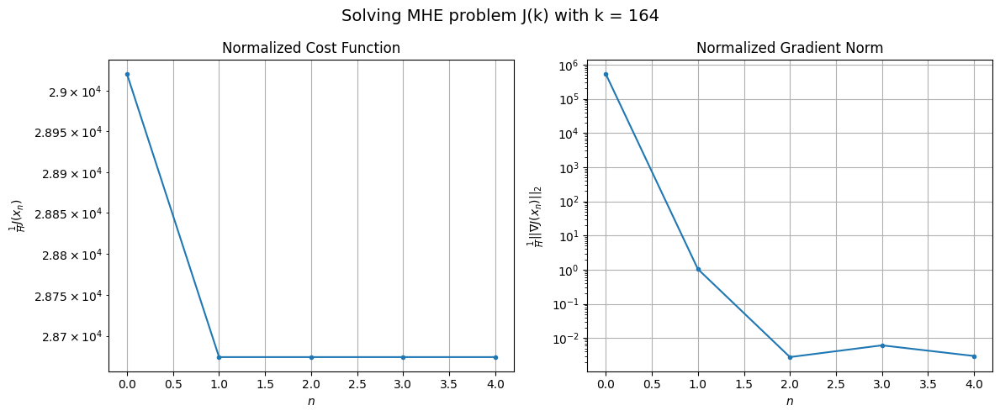

Windows:  34%|███▎      | 116/346 [19:29<1:04:35, 16.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1453788.0328092873
Gradient norm: 27625063.423680946
Global estimation error: 86.29261791178085
Initial conditions estimation errors: 42.77201869329824 m, 42.94262868207602 m, 41.846410786150344 m, 44.96412129669812 m
Position estimation errors: 48.39029358048699 m, 48.016926402305465 m, 48.79109948007885 m, 46.19734697881544 m

[Gauss-Newton] Iteration 1
Cost function: 1435780.1131610158 (-1.24%)
Gradient norm: 55.04836924750022 (-100.00%)
Global estimation error: 93.77854546762603 (8.68%)
Initial conditions estimation errors: 46.17283693746745 m, 46.35116752553688 m, 45.24321051867928 m, 49.66990619574484 m
Position estimation errors: 44.05794773934558 m, 43.65778003432372 m, 44.402082487132084 m, 41.25421065778223 m

[Gauss-Newton] Iteration 2
Cost function: 1435780.113168298 (0.00%)
Gradient norm: 0.2520462578630816 (-99.54%)
Global estimation error: 93.77891017265782 (0.00%)
Initial conditions estimation errors: 46.172841

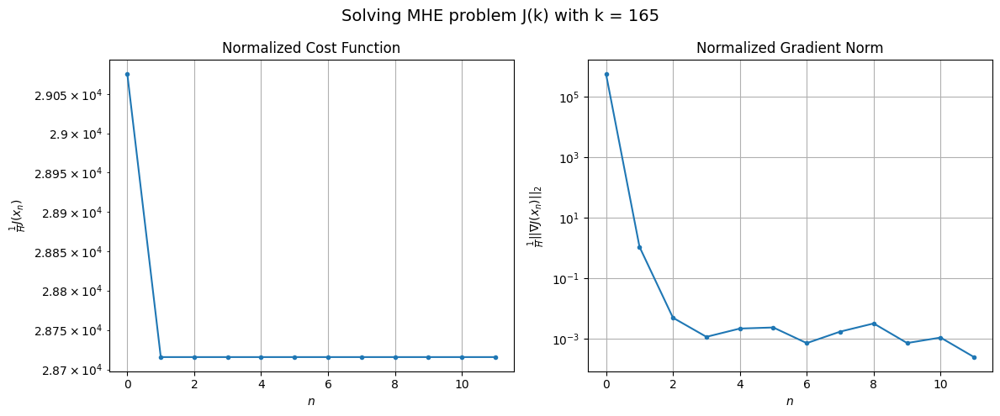

Windows:  34%|███▍      | 117/346 [19:48<1:06:37, 17.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1439681.521057833
Gradient norm: 28475904.25211927
Global estimation error: 89.42751711071628
Initial conditions estimation errors: 44.020601303630635 m, 44.20710785993977 m, 43.21147162648868 m, 47.30705874999982 m
Position estimation errors: 46.798140052494894 m, 46.358623074633606 m, 46.95682161072944 m, 44.325130686715326 m

[Gauss-Newton] Iteration 1
Cost function: 1421327.7033687707 (-1.27%)
Gradient norm: 136.01585590758012 (-100.00%)
Global estimation error: 95.53140885903387 (6.83%)
Initial conditions estimation errors: 47.48792144699171 m, 47.51966661744655 m, 47.03409405642156 m, 48.99809352415396 m
Position estimation errors: 42.35778691102708 m, 42.263945063645835 m, 42.627278032930086 m, 41.63751994080258 m

[Gauss-Newton] Iteration 2
Cost function: 1421327.7033508332 (-0.00%)
Gradient norm: 0.02585474845052481 (-99.98%)
Global estimation error: 95.53351112943533 (0.00%)
Initial conditions estimation errors: 47.4

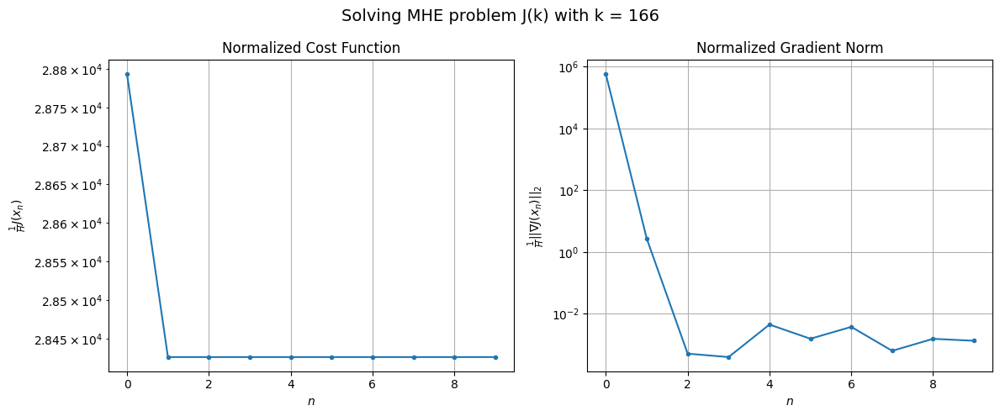

Windows:  34%|███▍      | 118/346 [20:04<1:04:43, 17.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1408421.4310218329
Gradient norm: 28826648.665982954
Global estimation error: 90.06398688950779
Initial conditions estimation errors: 44.70133651947967 m, 44.75374995016204 m, 44.36776864363399 m, 46.280677910814816 m
Position estimation errors: 44.72125310869482 m, 44.610944172021604 m, 44.872092692038535 m, 44.1777440041343 m

[Gauss-Newton] Iteration 1
Cost function: 1390015.8160882168 (-1.31%)
Gradient norm: 61.14457335929822 (-100.00%)
Global estimation error: 97.10105738141607 (7.81%)
Initial conditions estimation errors: 48.2211586694837 m, 48.2037267818256 m, 47.805923039564796 m, 49.943122842647135 m
Position estimation errors: 40.21343215945664 m, 40.04620167594672 m, 40.45278529790584 m, 39.79507012098344 m

[Gauss-Newton] Iteration 2
Cost function: 1390015.816062306 (-0.00%)
Gradient norm: 0.11403804613632318 (-99.81%)
Global estimation error: 97.10111019655557 (0.00%)
Initial conditions estimation errors: 48.22116

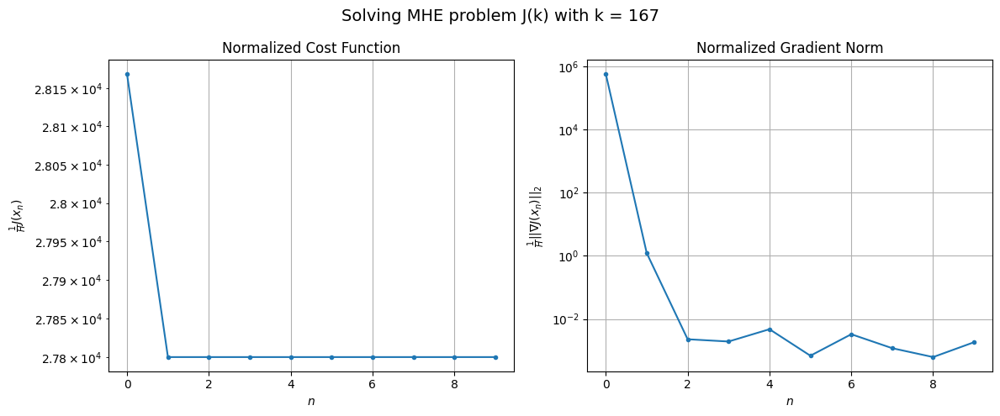

Windows:  34%|███▍      | 119/346 [20:20<1:03:11, 16.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1361974.1123143383
Gradient norm: 28251244.136892576
Global estimation error: 90.45811710014853
Initial conditions estimation errors: 44.837534312541315 m, 44.85598021238555 m, 44.55306250226664 m, 46.63917735758712 m
Position estimation errors: 42.142309308125384 m, 41.91898637237384 m, 42.22784545049898 m, 41.94638921460846 m

[Gauss-Newton] Iteration 1
Cost function: 1343997.1230024658 (-1.32%)
Gradient norm: 65.11366169641961 (-100.00%)
Global estimation error: 96.90750639853977 (7.13%)
Initial conditions estimation errors: 48.395895327634285 m, 48.53532365817472 m, 47.79290254071688 m, 49.08200318489604 m
Position estimation errors: 37.6621410065984 m, 37.035895128076795 m, 37.697330316413726 m, 37.590580603589544 m

[Gauss-Newton] Iteration 2
Cost function: 1343997.1230009336 (-0.00%)
Gradient norm: 0.06814314349877279 (-99.90%)
Global estimation error: 96.90720194732681 (-0.00%)
Initial conditions estimation errors: 48.

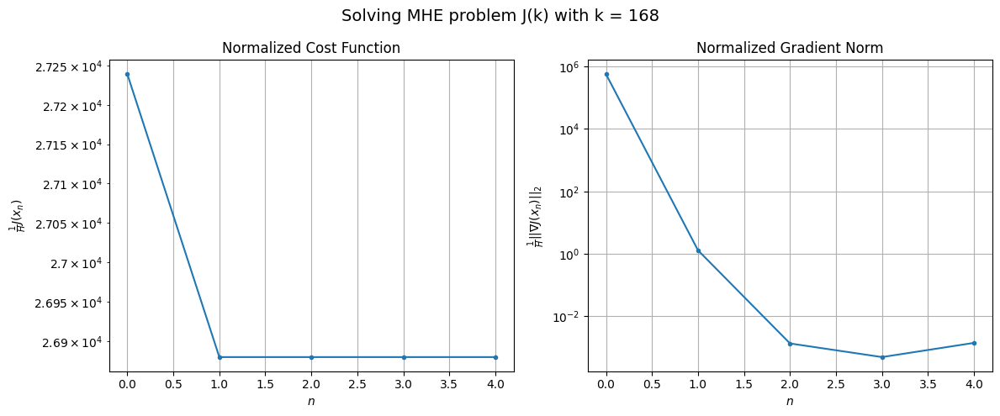

Windows:  35%|███▍      | 120/346 [20:29<53:20, 14.16s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 1302064.8443529743
Gradient norm: 27539174.945221115
Global estimation error: 89.11415650353388
Initial conditions estimation errors: 44.46622055982345 m, 44.658582260335066 m, 43.99774010242248 m, 45.09848023365864 m
Position estimation errors: 39.13315660898336 m, 38.40006567563122 m, 38.952491402776175 m, 39.17812983941585 m

[Gauss-Newton] Iteration 1
Cost function: 1284690.6733682943 (-1.33%)
Gradient norm: 389.1214609925604 (-100.00%)
Global estimation error: 97.2355368248707 (9.11%)
Initial conditions estimation errors: 48.05060963163347 m, 48.717395734380894 m, 47.56499407865749 m, 50.100372899798934 m
Position estimation errors: 34.72119649618142 m, 33.89140206593111 m, 35.16951605309962 m, 33.01606704264028 m

[Gauss-Newton] Iteration 2
Cost function: 1284690.6732820743 (-0.00%)
Gradient norm: 0.07862735589361328 (-99.98%)
Global estimation error: 97.24108526058723 (0.01%)
Initial conditions estimation errors: 48.050

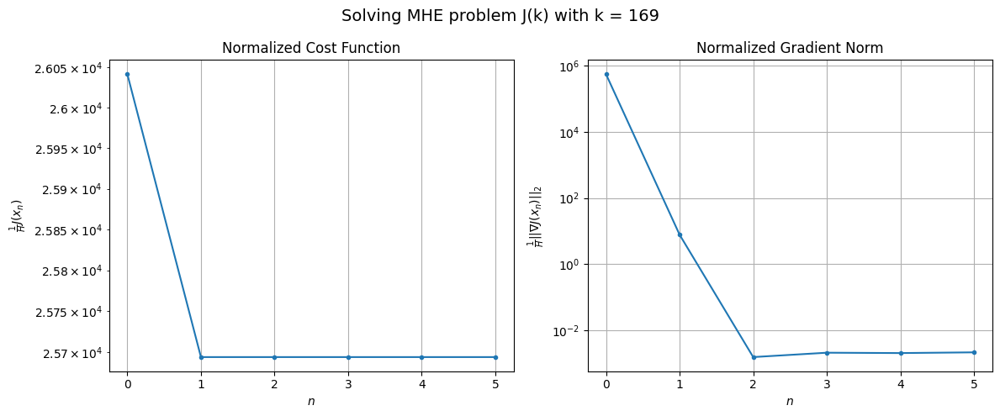

Windows:  35%|███▍      | 121/346 [20:38<47:21, 12.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1232960.852471694
Gradient norm: 26052137.186516523
Global estimation error: 88.0876216449156
Initial conditions estimation errors: 43.6458111909567 m, 44.2650960954533 m, 43.12180216195199 m, 45.1170841158056 m
Position estimation errors: 35.73616663033347 m, 34.91725232787684 m, 36.138699138090296 m, 34.39866956859118 m

[Gauss-Newton] Iteration 1
Cost function: 1216782.199115077 (-1.31%)
Gradient norm: 123.42241214807855 (-100.00%)
Global estimation error: 93.0014008825197 (5.58%)
Initial conditions estimation errors: 47.193922875821826 m, 46.76387976047177 m, 45.933875480304565 m, 46.099679258751046 m
Position estimation errors: 31.49454371181619 m, 31.371767715089643 m, 31.935644248364085 m, 31.825585718460754 m

[Gauss-Newton] Iteration 2
Cost function: 1216782.1991182165 (0.00%)
Gradient norm: 0.26249456524468484 (-99.79%)
Global estimation error: 93.00074391612446 (-0.00%)
Initial conditions estimation errors: 47.19392

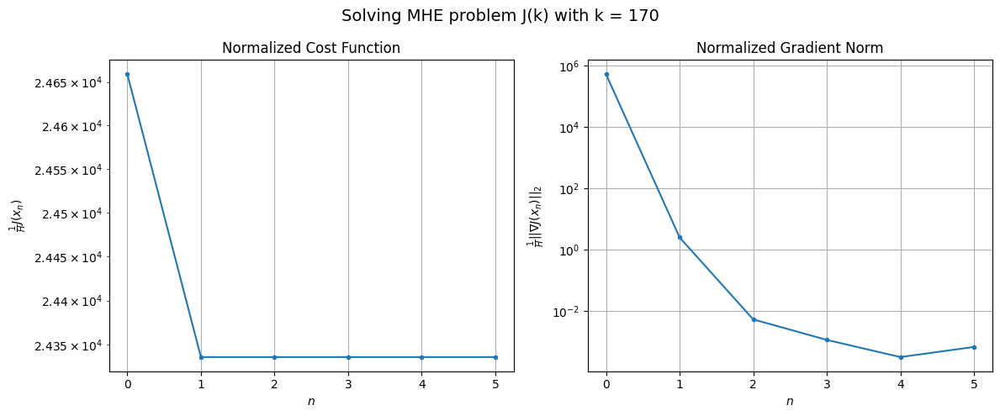

Windows:  35%|███▌      | 122/346 [20:46<41:54, 11.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1156865.1782807382
Gradient norm: 24072349.7412766
Global estimation error: 83.31812204430982
Initial conditions estimation errors: 42.41827052683966 m, 41.988625255042194 m, 41.217636208711916 m, 40.995446651108175 m
Position estimation errors: 32.069906807639015 m, 31.87697382649665 m, 32.37248652749372 m, 32.475070080842826 m

[Gauss-Newton] Iteration 1
Cost function: 1142078.939597068 (-1.28%)
Gradient norm: 215.7244458290511 (-100.00%)
Global estimation error: 92.73058716429645 (11.30%)
Initial conditions estimation errors: 45.90950177702202 m, 46.31299710765603 m, 45.452663174627475 m, 47.75357310800527 m
Position estimation errors: 28.06976313003959 m, 27.342616458128713 m, 28.462485856734236 m, 26.031734456218196 m

[Gauss-Newton] Iteration 2
Cost function: 1142078.9395668514 (-0.00%)
Gradient norm: 0.027743820307310745 (-99.99%)
Global estimation error: 92.7308457664648 (0.00%)
Initial conditions estimation errors: 45

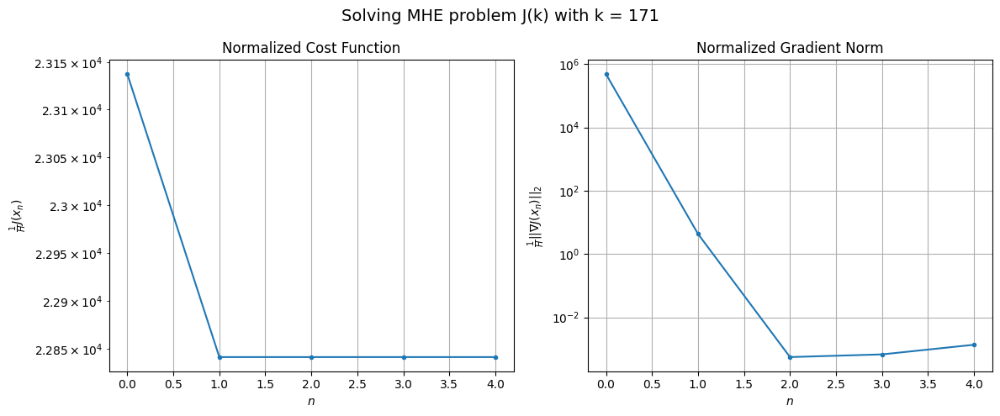

Windows:  36%|███▌      | 123/346 [20:52<36:32,  9.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1076257.4103816457
Gradient norm: 21685960.90164454
Global estimation error: 82.4152984710365
Initial conditions estimation errors: 40.91221173555851 m, 41.276986490900285 m, 40.412177385762476 m, 42.2078358885028 m
Position estimation errors: 28.22782646297148 m, 27.50177855132014 m, 28.619400689275185 m, 26.51407475714505 m

[Gauss-Newton] Iteration 1
Cost function: 1063135.9455158648 (-1.22%)
Gradient norm: 1040.7510058823254 (-100.00%)
Global estimation error: 86.0105771550676 (4.36%)
Initial conditions estimation errors: 44.30068228090659 m, 43.560785734640874 m, 43.03011578218988 m, 41.062142320563524 m
Position estimation errors: 24.54496623996361 m, 24.704668030374624 m, 24.493924592749874 m, 27.39960193108348 m

[Gauss-Newton] Iteration 2
Cost function: 1063135.9451980162 (-0.00%)
Gradient norm: 0.2512164723160912 (-99.98%)
Global estimation error: 86.01241433874661 (0.00%)
Initial conditions estimation errors: 44.300

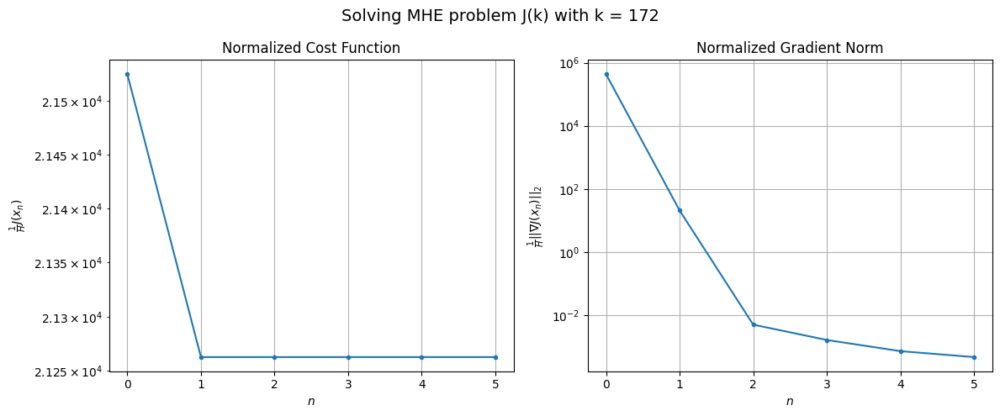

Windows:  36%|███▌      | 124/346 [21:00<34:02,  9.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 993907.0688786737
Gradient norm: 19228737.741953902
Global estimation error: 76.05079735380444
Initial conditions estimation errors: 39.27030575953903 m, 38.561216943426004 m, 38.17549888662467 m, 36.01662379969599 m
Position estimation errors: 24.313212283632293 m, 24.37813898032184 m, 24.051093625427512 m, 26.93963841386872 m

[Gauss-Newton] Iteration 1
Cost function: 982410.3574302592 (-1.16%)
Gradient norm: 462.46263953201344 (-100.00%)
Global estimation error: 84.5996104621579 (11.24%)
Initial conditions estimation errors: 42.54002870495975 m, 42.119840912916565 m, 41.872264905360666 m, 42.6618812274925 m
Position estimation errors: 20.975643452215795 m, 20.839193479802972 m, 21.242744522845776 m, 19.87440931202719 m

[Gauss-Newton] Iteration 2
Cost function: 982410.3573744374 (-0.00%)
Gradient norm: 0.18394354994240072 (-99.96%)
Global estimation error: 84.59930859394053 (-0.00%)
Initial conditions estimation errors: 42.

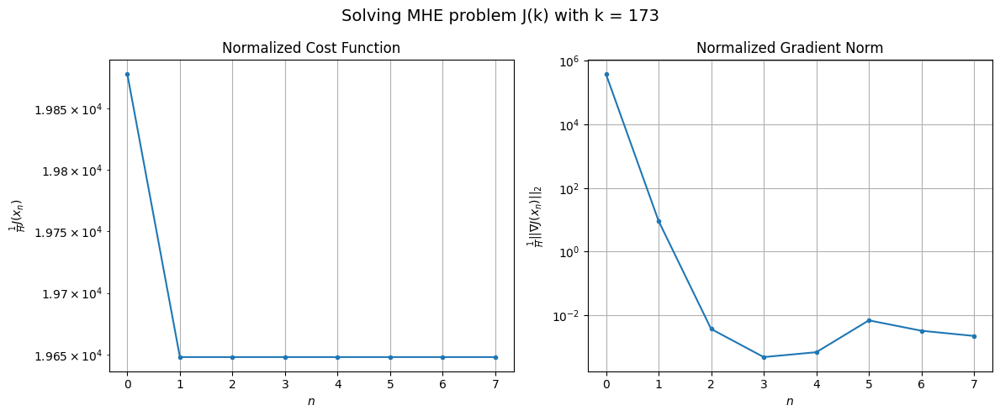

Windows:  36%|███▌      | 125/346 [21:11<36:22,  9.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 913135.993524241
Gradient norm: 16664820.825569427
Global estimation error: 74.73571259303411
Initial conditions estimation errors: 37.66556516378756 m, 37.22265361509651 m, 37.01203816540497 m, 37.5670512984502 m
Position estimation errors: 20.37702386515383 m, 20.195903473008688 m, 20.548843707853294 m, 19.35215197409903 m

[Gauss-Newton] Iteration 1
Cost function: 903230.2640146139 (-1.08%)
Gradient norm: 160.97319686306986 (-100.00%)
Global estimation error: 81.80354109584216 (9.46%)
Initial conditions estimation errors: 40.800605146589334 m, 39.957783765802304 m, 40.97648962011256 m, 41.849734344282 m
Position estimation errors: 17.421739259092778 m, 18.20821592928655 m, 17.245419804212794 m, 17.15233287169457 m

[Gauss-Newton] Iteration 2
Cost function: 903230.2639650257 (-0.00%)
Gradient norm: 0.28989641345794226 (-99.82%)
Global estimation error: 81.80656945243474 (0.00%)
Initial conditions estimation errors: 40.800608

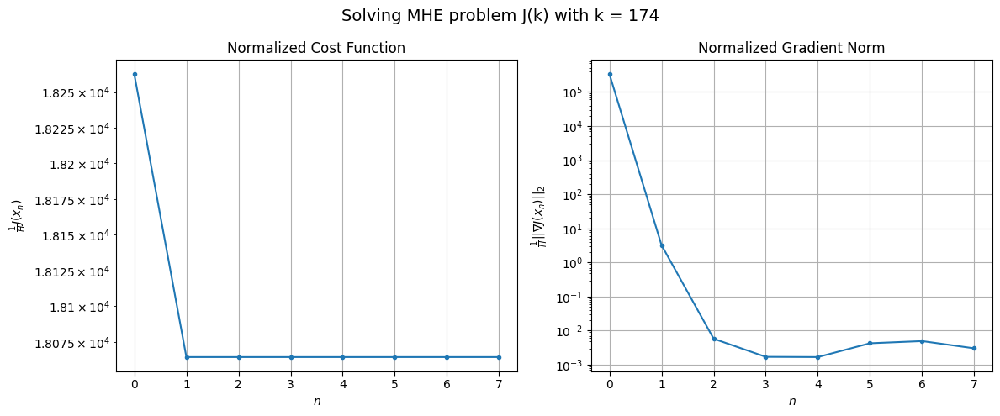

Windows:  36%|███▋      | 126/346 [21:24<39:27, 10.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 833792.0216251126
Gradient norm: 13913533.830263946
Global estimation error: 72.68674693923832
Initial conditions estimation errors: 36.207977968431926 m, 35.34609183672008 m, 36.42645216733297 m, 37.36422299743046 m
Position estimation errors: 16.452346495456123 m, 17.21061387891006 m, 16.179775097038018 m, 16.26924295551955 m

[Gauss-Newton] Iteration 1
Cost function: 825433.7219419635 (-1.00%)
Gradient norm: 63.94376682215816 (-100.00%)
Global estimation error: 78.22099947921117 (7.61%)
Initial conditions estimation errors: 39.192599141624605 m, 37.922760884574764 m, 38.899753496159185 m, 40.386987348252234 m
Position estimation errors: 13.93202120643305 m, 15.189764663466903 m, 13.927730069864076 m, 13.736971160753283 m

[Gauss-Newton] Iteration 2
Cost function: 825433.721921547 (-0.00%)
Gradient norm: 0.028762588297209398 (-99.96%)
Global estimation error: 78.22164827321251 (0.00%)
Initial conditions estimation errors: 39

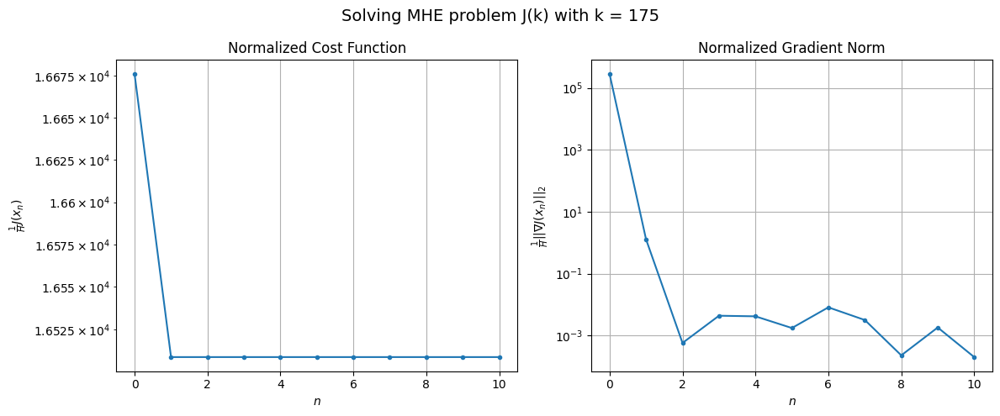

Windows:  37%|███▋      | 127/346 [21:41<45:44, 12.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 756142.7545483081
Gradient norm: 11215591.064128947
Global estimation error: 69.6759961387385
Initial conditions estimation errors: 34.89722501920616 m, 33.57163588312119 m, 34.638873437290734 m, 36.19386657360819 m
Position estimation errors: 12.566289998952774 m, 13.800782981461486 m, 12.440640972700136 m, 12.5009001463843 m

[Gauss-Newton] Iteration 1
Cost function: 748921.7718208963 (-0.95%)
Gradient norm: 80.06078631353597 (-100.00%)
Global estimation error: 74.04313076802359 (6.27%)
Initial conditions estimation errors: 37.77075973575986 m, 36.378565620424496 m, 37.087628100491955 m, 36.835235898806964 m
Position estimation errors: 10.467077885458924 m, 11.328961062404908 m, 10.343449415631397 m, 11.253989590407485 m

[Gauss-Newton] Iteration 2
Cost function: 748921.7718452998 (0.00%)
Gradient norm: 0.14430914621950805 (-99.82%)
Global estimation error: 74.0430164237993 (-0.00%)
Initial conditions estimation errors: 37.7

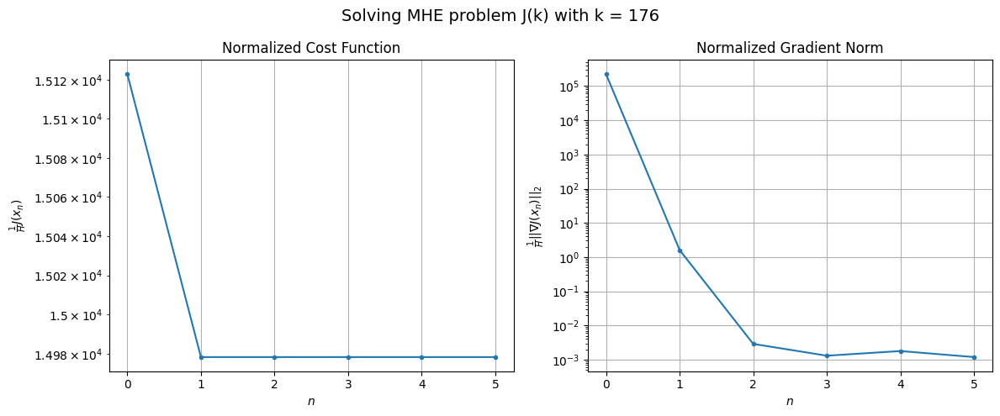

Windows:  37%|███▋      | 128/346 [21:50<41:59, 11.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 681644.5527871992
Gradient norm: 8307842.259621169
Global estimation error: 65.79686521465851
Initial conditions estimation errors: 33.68332081288417 m, 32.274204606359845 m, 33.06563804455479 m, 32.55264604081339 m
Position estimation errors: 8.715094082868328 m, 9.51974709715244 m, 8.446238653032275 m, 9.516517271847501 m

[Gauss-Newton] Iteration 1
Cost function: 675485.9574163506 (-0.90%)
Gradient norm: 53.78565219481358 (-100.00%)
Global estimation error: 71.99131221502938 (9.41%)
Initial conditions estimation errors: 36.43402364737203 m, 35.08907768738436 m, 36.435835507441936 m, 36.00652553071238 m
Position estimation errors: 7.145410215916316 m, 7.897967476252069 m, 6.755383851901244 m, 7.579547450834392 m

[Gauss-Newton] Iteration 2
Cost function: 675485.9574302811 (0.00%)
Gradient norm: 0.5240077531933697 (-99.03%)
Global estimation error: 71.99176104401805 (0.00%)
Initial conditions estimation errors: 36.43402548982

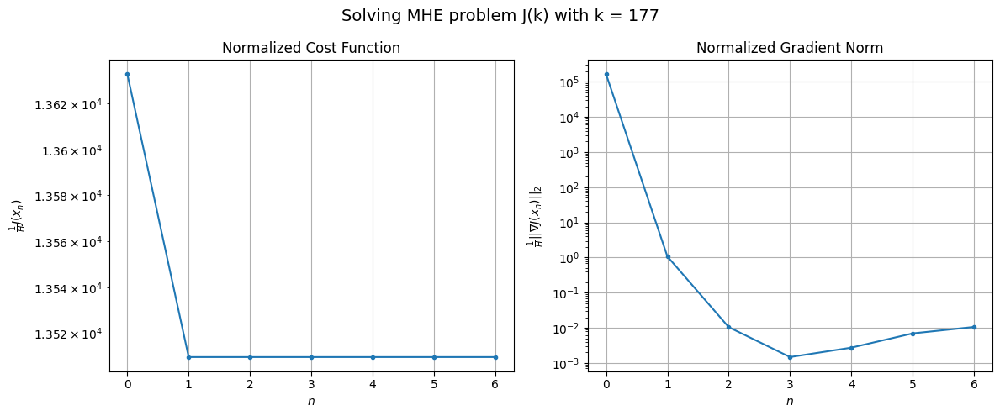

Windows:  37%|███▋      | 129/346 [22:00<39:31, 10.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 611157.7092484557
Gradient norm: 5564180.8057117965
Global estimation error: 63.93830891084074
Initial conditions estimation errors: 32.4029410590076 m, 31.068232013624453 m, 32.466991081990344 m, 31.918481671420505 m
Position estimation errors: 5.222942118749212 m, 5.812104134556072 m, 4.70617063386061 m, 5.526409773735693 m

[Gauss-Newton] Iteration 1
Cost function: 605835.031759531 (-0.87%)
Gradient norm: 159.86058597429036 (-100.00%)
Global estimation error: 70.55718538597019 (10.35%)
Initial conditions estimation errors: 35.02997714604303 m, 33.825675724178275 m, 35.72963529544331 m, 36.47470881801381 m
Position estimation errors: 4.296138315551469 m, 4.811388129569905 m, 4.60037582293503 m, 4.6339984353494845 m

[Gauss-Newton] Iteration 2
Cost function: 605835.0317758551 (0.00%)
Gradient norm: 0.12453368500018053 (-99.92%)
Global estimation error: 70.5563742922638 (-0.00%)
Initial conditions estimation errors: 35.0299785

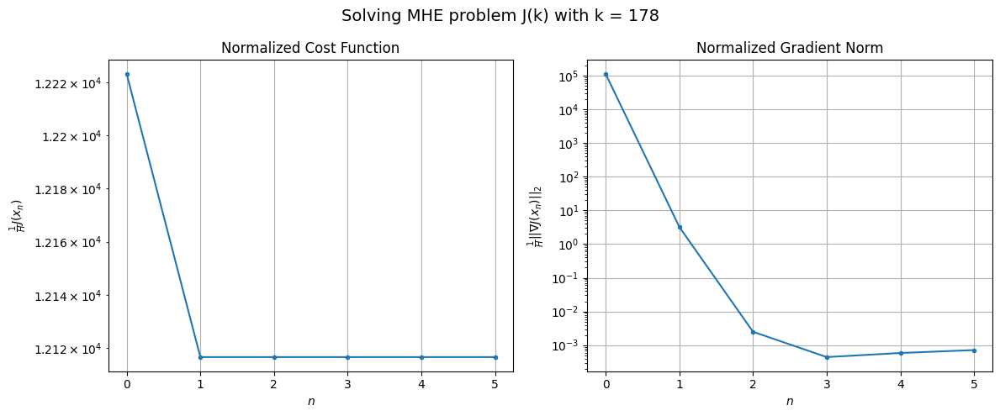

Windows:  38%|███▊      | 130/346 [22:07<36:05, 10.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 544936.1205173396
Gradient norm: 2593471.813249073
Global estimation error: 62.155256638514274
Initial conditions estimation errors: 30.904779472137133 m, 29.641337772652495 m, 31.512294941645298 m, 32.194836614117186 m
Position estimation errors: 3.404568606950109 m, 3.0535133989209 m, 3.1460559274322493 m, 4.207184264631259 m

[Gauss-Newton] Iteration 1
Cost function: 540162.3221346771 (-0.88%)
Gradient norm: 42.66007535458919 (-100.00%)
Global estimation error: 67.16831554415008 (8.07%)
Initial conditions estimation errors: 33.43391221700632 m, 32.23099495766368 m, 33.947268747101525 m, 34.676652986486175 m
Position estimation errors: 3.4518456450059065 m, 2.670208158008698 m, 3.2658186556429767 m, 4.440302291486715 m

[Gauss-Newton] Iteration 2
Cost function: 540162.3221196412 (-0.00%)
Gradient norm: 0.1668601425636431 (-99.61%)
Global estimation error: 67.16770078636115 (-0.00%)
Initial conditions estimation errors: 33.43

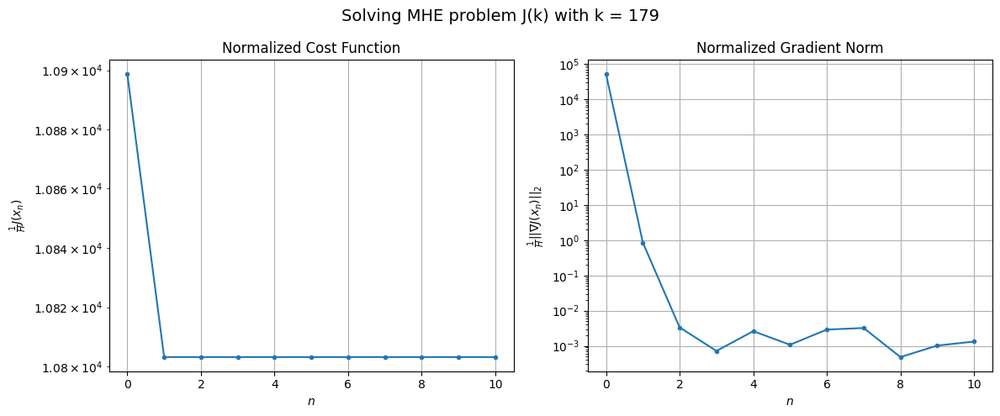

Windows:  38%|███▊      | 131/346 [22:22<40:17, 11.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 485733.7582009663
Gradient norm: 514597.94517529325
Global estimation error: 58.32981261752766
Initial conditions estimation errors: 29.102110765504563 m, 27.842498370078093 m, 29.51086317464697 m, 30.15471728390059 m
Position estimation errors: 5.1849188170349185 m, 3.653501815196625 m, 4.210445105515426 m, 5.856997809622364 m

[Gauss-Newton] Iteration 1
Cost function: 481439.28667736007 (-0.88%)
Gradient norm: 66.70639136970775 (-99.99%)
Global estimation error: 63.52187158314383 (8.90%)
Initial conditions estimation errors: 31.503395466364665 m, 30.48923776780622 m, 32.202558472094694 m, 32.801396139167274 m
Position estimation errors: 5.403360447252824 m, 3.432035356586958 m, 4.5366051730864605 m, 7.103168634868373 m

[Gauss-Newton] Iteration 2
Cost function: 481439.2866657694 (-0.00%)
Gradient norm: 0.20926785125673694 (-99.69%)
Global estimation error: 63.52180089739622 (-0.00%)
Initial conditions estimation errors: 31.5

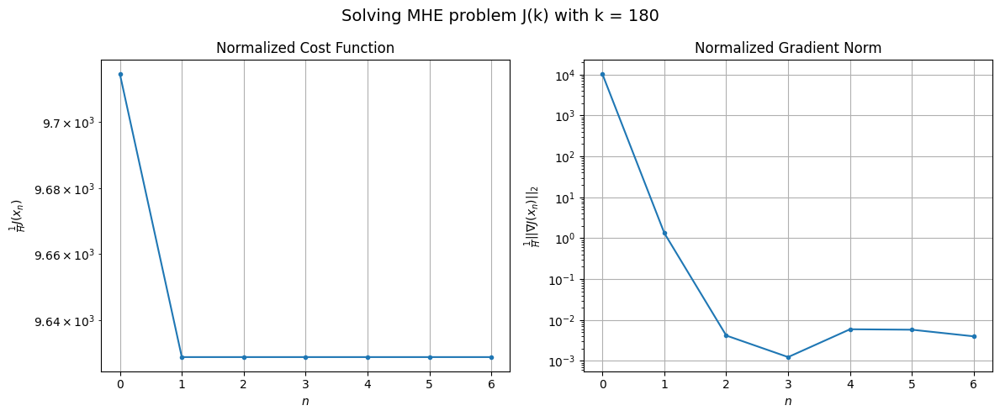

Windows:  38%|███▊      | 132/346 [22:31<37:55, 10.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 435667.7144481843
Gradient norm: 2394994.276546622
Global estimation error: 54.10641788277736
Initial conditions estimation errors: 26.926946263069034 m, 25.80208955890012 m, 27.4852656360202 m, 27.950372836464805 m
Position estimation errors: 8.271963601265277 m, 6.2372924577745215 m, 6.832578595771805 m, 9.789578636012584 m

[Gauss-Newton] Iteration 1
Cost function: 431763.9013336334 (-0.90%)
Gradient norm: 26.99163290539721 (-100.00%)
Global estimation error: 58.326254459063655 (7.80%)
Initial conditions estimation errors: 29.188452700910233 m, 28.076096825785267 m, 29.84739520158208 m, 29.50959809511697 m
Position estimation errors: 8.16987527904095 m, 5.838525779453508 m, 6.676829708307554 m, 8.365095399250194 m

[Gauss-Newton] Iteration 2
Cost function: 431763.9013387487 (0.00%)
Gradient norm: 0.05778210004942117 (-99.79%)
Global estimation error: 58.326378230210885 (0.00%)
Initial conditions estimation errors: 29.188453

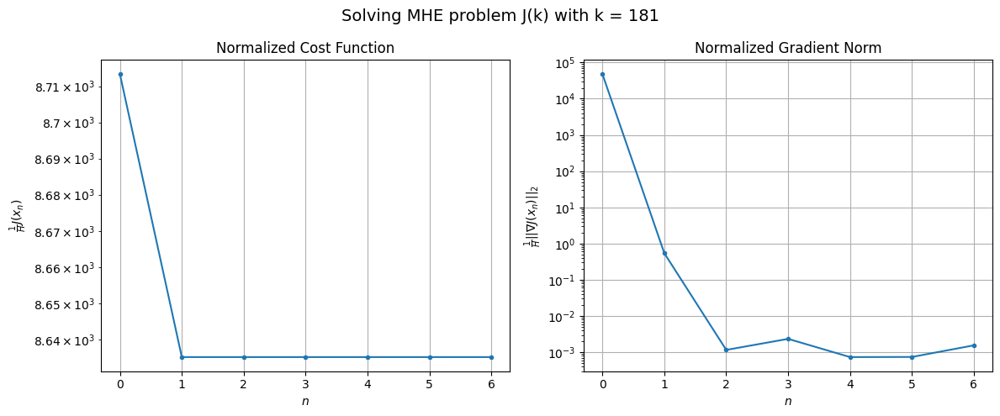

Windows:  38%|███▊      | 133/346 [22:40<36:35, 10.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 394858.2182016154
Gradient norm: 4378959.669631813
Global estimation error: 48.450788292703045
Initial conditions estimation errors: 24.408318992513713 m, 23.189545196627915 m, 24.911551134609677 m, 24.358561836099568 m
Position estimation errors: 11.422673644365887 m, 9.154134259452677 m, 9.569756829029647 m, 11.558085462199081 m

[Gauss-Newton] Iteration 1
Cost function: 391093.8313566792 (-0.95%)
Gradient norm: 102.63990679635259 (-100.00%)
Global estimation error: 53.54267722680295 (10.51%)
Initial conditions estimation errors: 26.578118743472753 m, 25.597523811153973 m, 28.00565128965047 m, 26.84841851931691 m
Position estimation errors: 10.95031071615906 m, 8.135755128235658 m, 10.556669549200116 m, 10.265721219806203 m

[Gauss-Newton] Iteration 2
Cost function: 391093.831346879 (-0.00%)
Gradient norm: 0.07997622897589116 (-99.92%)
Global estimation error: 53.54475269261122 (0.00%)
Initial conditions estimation errors: 2

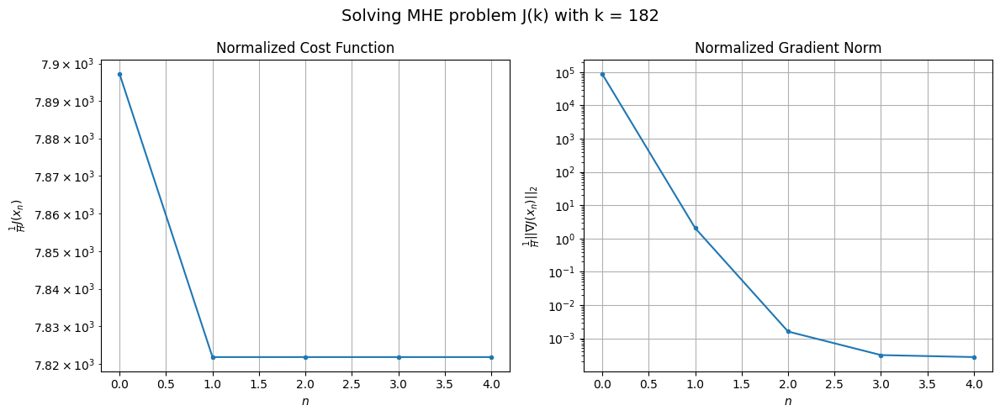

Windows:  39%|███▊      | 134/346 [22:47<32:49,  9.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 365850.08252100414
Gradient norm: 6053742.053963177
Global estimation error: 43.59154397479828
Initial conditions estimation errors: 21.69092013068337 m, 20.636224245431965 m, 23.024184634629936 m, 21.765323766518534 m
Position estimation errors: 14.382903657180638 m, 11.589815887739814 m, 13.692387107361133 m, 13.595961996125801 m

[Gauss-Newton] Iteration 1
Cost function: 362277.8701062604 (-0.98%)
Gradient norm: 62.53120439348547 (-100.00%)
Global estimation error: 47.33692256579268 (8.59%)
Initial conditions estimation errors: 23.74578288701543 m, 22.629317051296596 m, 25.34281165421928 m, 22.85925148658265 m
Position estimation errors: 13.56417777050263 m, 10.294795065906202 m, 13.23234576169821 m, 10.868190822839724 m

[Gauss-Newton] Iteration 2
Cost function: 362277.87007686007 (-0.00%)
Gradient norm: 0.022268044573406955 (-99.96%)
Global estimation error: 47.33681806979289 (-0.00%)
Initial conditions estimation errors:

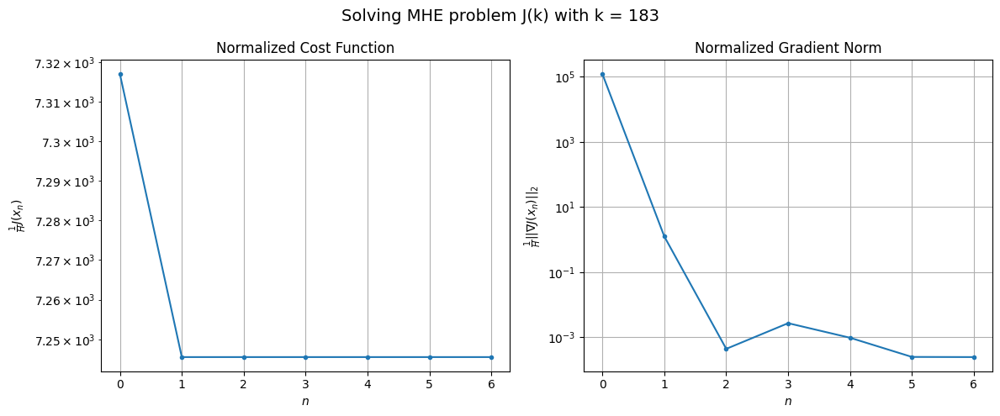

Windows:  39%|███▉      | 135/346 [22:56<32:15,  9.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 349106.81247645384
Gradient norm: 7447110.809392854
Global estimation error: 37.49877105500541
Initial conditions estimation errors: 18.881628052629456 m, 17.750333825382885 m, 20.38753153770351 m, 17.85745181694115 m
Position estimation errors: 17.093328230973775 m, 13.892398779246113 m, 16.526827882585202 m, 14.447267300975382 m

[Gauss-Newton] Iteration 1
Cost function: 345598.4816148601 (-1.00%)
Gradient norm: 28.65557589549179 (-100.00%)
Global estimation error: 41.576317021451885 (10.87%)
Initial conditions estimation errors: 20.867745425524962 m, 19.99675572143477 m, 22.34717831092979 m, 19.84519689925871 m
Position estimation errors: 15.959725622298048 m, 13.705143706263637 m, 16.41985602858899 m, 13.271155804394974 m

[Gauss-Newton] Iteration 2
Cost function: 345598.48161704326 (0.00%)
Gradient norm: 0.013556750766504474 (-99.95%)
Global estimation error: 41.578741009482634 (0.01%)
Initial conditions estimation errors

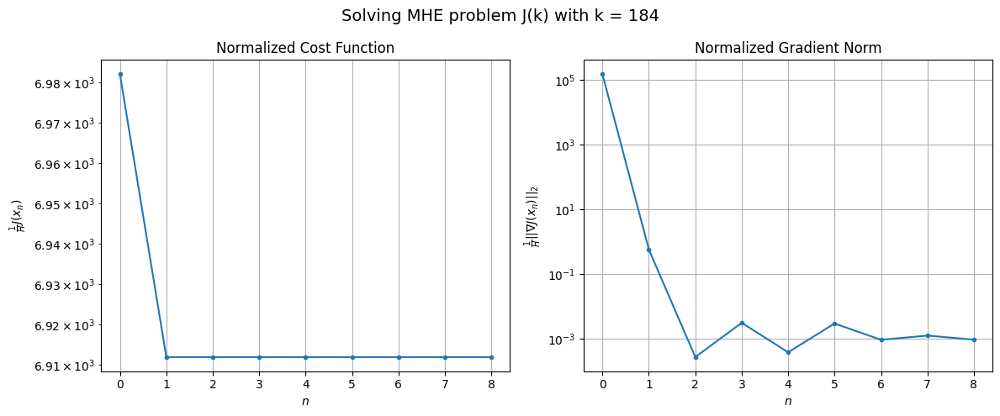

Windows:  39%|███▉      | 136/346 [23:08<34:31,  9.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 342539.48789247405
Gradient norm: 8253941.726937302
Global estimation error: 32.22225823656373
Initial conditions estimation errors: 16.15879203708004 m, 15.374476336526667 m, 17.615737173132114 m, 15.180745936763842 m
Position estimation errors: 19.523661217232068 m, 17.35808142320376 m, 19.855734576077086 m, 16.93497873689135 m

[Gauss-Newton] Iteration 1
Cost function: 338920.23697434645 (-1.06%)
Gradient norm: 81.15954527725657 (-100.00%)
Global estimation error: 36.194595455434616 (12.33%)
Initial conditions estimation errors: 18.199834223853287 m, 17.24807785694098 m, 19.55249189030057 m, 17.291427569332296 m
Position estimation errors: 18.142866371984393 m, 15.880089713222077 m, 18.653432808608592 m, 13.360920819077325 m

[Gauss-Newton] Iteration 2
Cost function: 338920.2369705238 (-0.00%)
Gradient norm: 0.084995094233146 (-99.90%)
Global estimation error: 36.19396585666324 (-0.00%)
Initial conditions estimation errors:

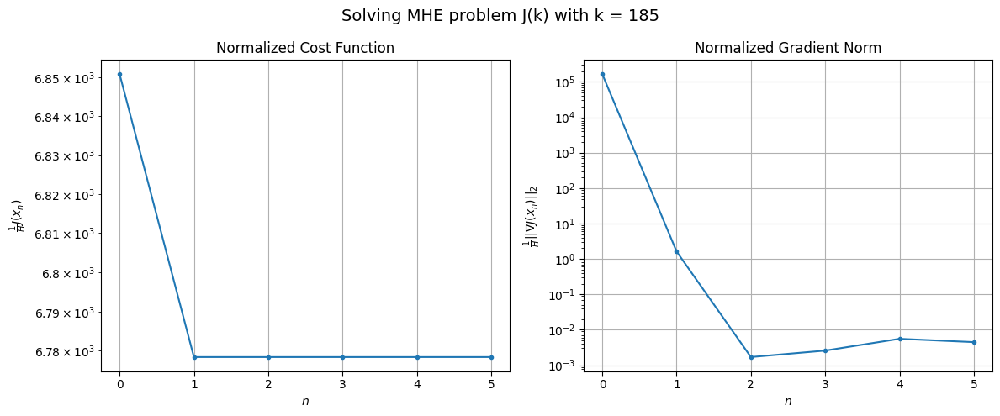

Windows:  40%|███▉      | 137/346 [23:16<32:52,  9.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 346324.85202962474
Gradient norm: 8967085.569536414
Global estimation error: 27.607941334178488
Initial conditions estimation errors: 13.786435025147515 m, 13.033002786843463 m, 15.090778868827432 m, 13.210679401049461 m
Position estimation errors: 21.6909420686131 m, 19.555448808845185 m, 22.123759134798757 m, 17.054301192595894 m

[Gauss-Newton] Iteration 1
Cost function: 342589.67916385666 (-1.08%)
Gradient norm: 300.2436033567645 (-100.00%)
Global estimation error: 31.529713314521143 (14.21%)
Initial conditions estimation errors: 15.913991625925558 m, 15.36174626784733 m, 16.19235960088076 m, 15.577872916486262 m
Position estimation errors: 20.088684108187472 m, 18.884627478517988 m, 19.508394336885424 m, 18.275185934646803 m

[Gauss-Newton] Iteration 2
Cost function: 342589.6791240507 (-0.00%)
Gradient norm: 0.08613269353908744 (-99.97%)
Global estimation error: 31.528842355512943 (-0.00%)
Initial conditions estimation er

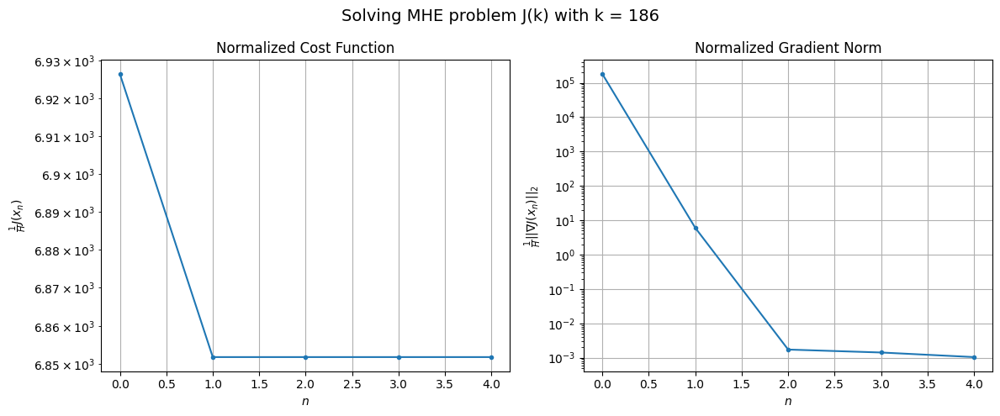

Windows:  40%|███▉      | 138/346 [23:24<30:42,  8.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 357546.2199905364
Gradient norm: 9069552.247500103
Global estimation error: 23.814769993125502
Initial conditions estimation errors: 11.9874332606921 m, 11.57966916402982 m, 12.279549895320683 m, 11.770813274243215 m
Position estimation errors: 23.608911577749367 m, 22.455469212345587 m, 23.040390003721967 m, 21.735732857925672 m

[Gauss-Newton] Iteration 1
Cost function: 353515.5655462754 (-1.13%)
Gradient norm: 96.5552642211206 (-100.00%)
Global estimation error: 28.55356309252526 (19.90%)
Initial conditions estimation errors: 14.373307557188648 m, 13.709030894736049 m, 14.740600810411996 m, 14.264420318261944 m
Position estimation errors: 21.852572328313972 m, 21.255665735905772 m, 21.890492807542493 m, 19.284914365793306 m

[Gauss-Newton] Iteration 2
Cost function: 353515.5655383426 (-0.00%)
Gradient norm: 0.010976306825964436 (-99.99%)
Global estimation error: 28.553835573204427 (0.00%)
Initial conditions estimation error

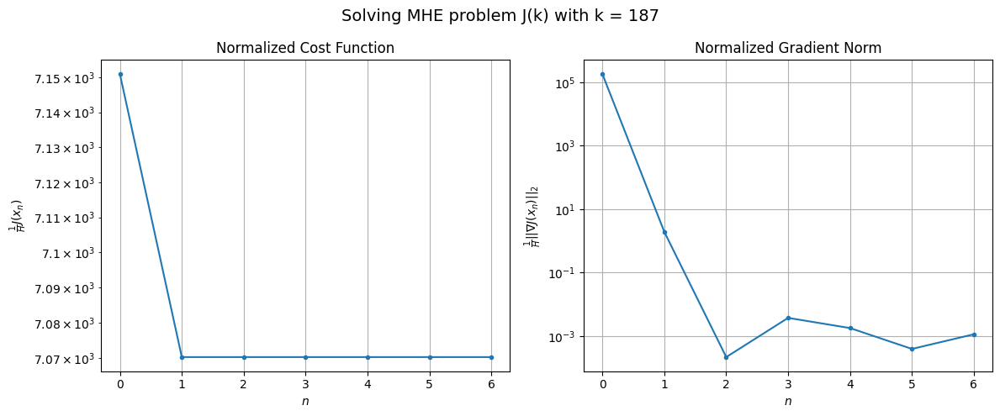

Windows:  40%|████      | 139/346 [23:32<30:35,  8.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 375110.9079028361
Gradient norm: 9014508.71343705
Global estimation error: 22.300917500005152
Initial conditions estimation errors: 11.154617537419579 m, 10.65133471205016 m, 11.436682778381192 m, 11.342139986249947 m
Position estimation errors: 25.383149228284044 m, 24.89441082255256 m, 25.44786089742319 m, 22.932840848903723 m

[Gauss-Newton] Iteration 1
Cost function: 370785.89964815596 (-1.15%)
Gradient norm: 14.500180671040614 (-100.00%)
Global estimation error: 26.689882647220006 (19.68%)
Initial conditions estimation errors: 13.767315813305974 m, 12.718061240477278 m, 13.697356694840392 m, 13.16930211707359 m
Position estimation errors: 23.499588648677182 m, 23.75644887632772 m, 24.400445220512594 m, 22.280462100132585 m

[Gauss-Newton] Iteration 2
Cost function: 370785.89965869527 (0.00%)
Gradient norm: 0.06145058828154592 (-99.58%)
Global estimation error: 26.689523210051032 (-0.00%)
Initial conditions estimation erro

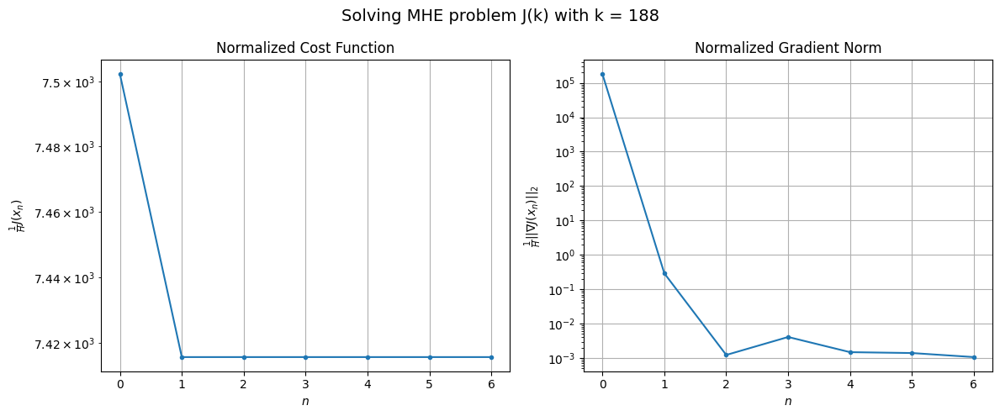

Windows:  40%|████      | 140/346 [23:42<30:57,  9.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 398060.37688021624
Gradient norm: 9022386.54333737
Global estimation error: 21.883427675980116
Initial conditions estimation errors: 11.356004575558302 m, 10.37716696680979 m, 11.075927126008962 m, 10.934084869673283 m
Position estimation errors: 27.078616433886594 m, 27.477162855015568 m, 28.02777729797599 m, 26.031827808320607 m

[Gauss-Newton] Iteration 1
Cost function: 393312.3365905524 (-1.19%)
Gradient norm: 27.033918949518203 (-100.00%)
Global estimation error: 27.156357327416558 (24.10%)
Initial conditions estimation errors: 14.144647368037203 m, 13.50490800541928 m, 13.234975355386831 m, 13.41039927712899 m
Position estimation errors: 25.079306813371044 m, 24.4507220123984 m, 26.854285487066708 m, 23.995444967359376 m

[Gauss-Newton] Iteration 2
Cost function: 393312.3365932801 (0.00%)
Gradient norm: 0.10581946337154882 (-99.61%)
Global estimation error: 27.155918684150787 (-0.00%)
Initial conditions estimation errors

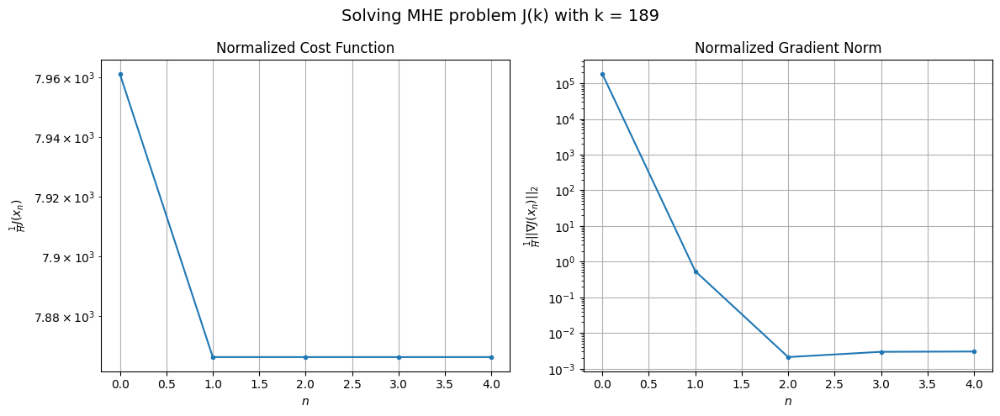

Windows:  41%|████      | 141/346 [23:49<28:32,  8.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 424627.3691255073
Gradient norm: 8931337.248670192
Global estimation error: 23.784780616322085
Initial conditions estimation errors: 12.391953186657815 m, 11.983569586152589 m, 11.20889573388146 m, 11.954177442872401 m
Position estimation errors: 28.69679045735996 m, 28.209017405227584 m, 30.5231440024239 m, 27.75301201876799 m

[Gauss-Newton] Iteration 1
Cost function: 419398.4055774883 (-1.23%)
Gradient norm: 145.99419441061397 (-100.00%)
Global estimation error: 30.943251384316262 (30.10%)
Initial conditions estimation errors: 15.28752443631022 m, 14.45964071488773 m, 13.670255742559094 m, 18.10553118432297 m
Position estimation errors: 26.60768792326573 m, 26.241169823248136 m, 28.57116541775777 m, 21.84015215286583 m

[Gauss-Newton] Iteration 2
Cost function: 419398.40555427177 (-0.00%)
Gradient norm: 0.30958874809231485 (-99.79%)
Global estimation error: 30.940514519874622 (-0.01%)
Initial conditions estimation errors: 1

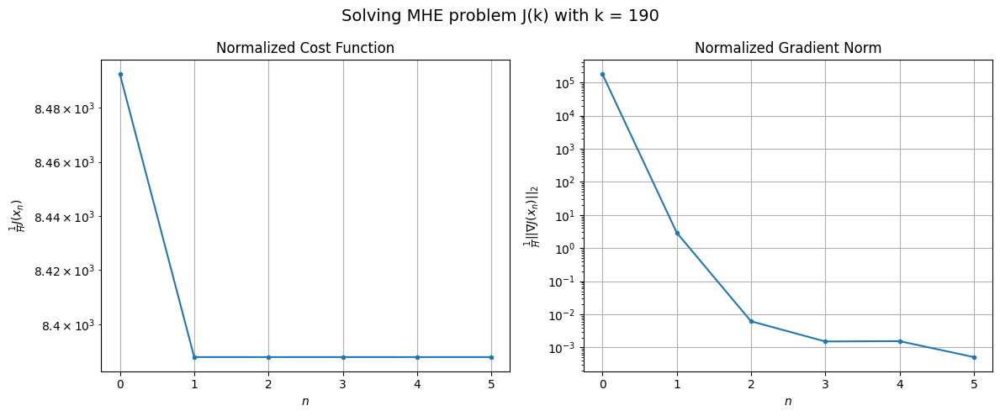

Windows:  41%|████      | 142/346 [23:57<28:19,  8.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 454033.9690768958
Gradient norm: 8795588.226713281
Global estimation error: 28.674922553458426
Initial conditions estimation errors: 13.901158019206925 m, 13.339452503857883 m, 12.159918753177898 m, 17.412567523563645 m
Position estimation errors: 30.221110377725385 m, 30.00757381926627 m, 32.271325661658175 m, 25.410051243447644 m

[Gauss-Newton] Iteration 1
Cost function: 448219.1969744997 (-1.28%)
Gradient norm: 12.420384152482455 (-100.00%)
Global estimation error: 33.90051233602141 (18.22%)
Initial conditions estimation errors: 16.857451021338758 m, 15.735355906642647 m, 14.231038286625047 m, 20.370058130381494 m
Position estimation errors: 28.028451134119965 m, 28.057883489902373 m, 31.025710613917475 m, 22.764881956918465 m

[Gauss-Newton] Iteration 2
Cost function: 448219.1969813586 (0.00%)
Gradient norm: 0.13241600648294863 (-98.93%)
Global estimation error: 33.895913652130545 (-0.01%)
Initial conditions estimation er

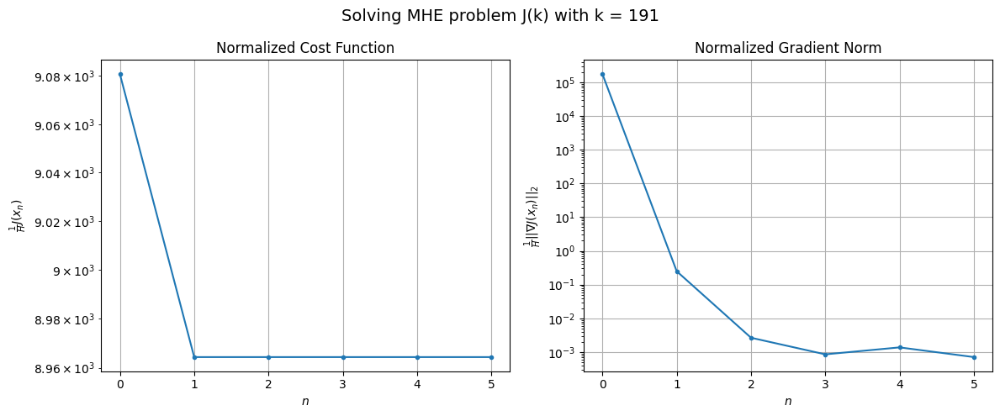

Windows:  41%|████▏     | 143/346 [24:05<27:51,  8.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 483552.3744833038
Gradient norm: 8707487.785406701
Global estimation error: 31.805791898347138
Initial conditions estimation errors: 15.575218528015697 m, 14.684199685020989 m, 12.833606790779376 m, 19.71514794116501 m
Position estimation errors: 31.6150304091575 m, 31.81608373297138 m, 34.69841955081645 m, 26.323443477519255 m

[Gauss-Newton] Iteration 1
Cost function: 477241.8689762816 (-1.31%)
Gradient norm: 21.798089180524588 (-100.00%)
Global estimation error: 36.8706718636044 (15.92%)
Initial conditions estimation errors: 18.567786865599963 m, 17.328006525781003 m, 16.1509040340048 m, 21.297048225315518 m
Position estimation errors: 29.364889966970683 m, 29.895373738463633 m, 32.31462746838663 m, 25.310708667344276 m

[Gauss-Newton] Iteration 2
Cost function: 477241.8689641937 (-0.00%)
Gradient norm: 0.1313763381844437 (-99.40%)
Global estimation error: 36.86838179847405 (-0.01%)
Initial conditions estimation errors: 18.

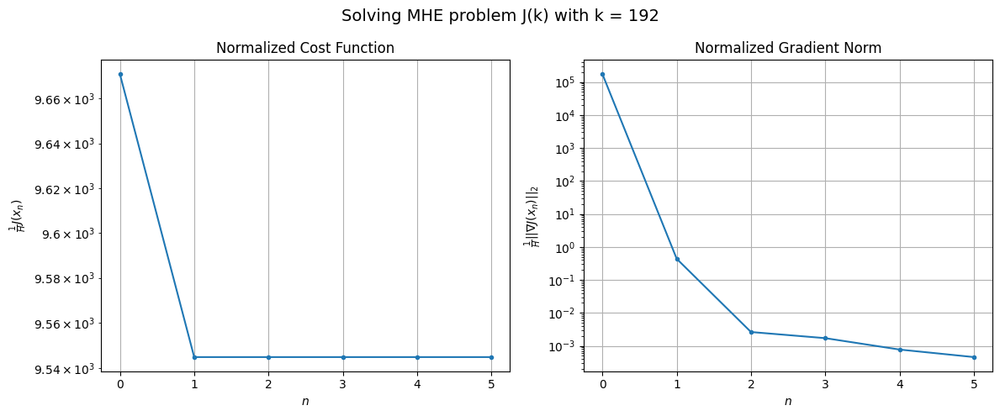

Windows:  42%|████▏     | 144/346 [24:13<27:54,  8.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 514130.0610614291
Gradient norm: 8789685.707104992
Global estimation error: 34.4227715222114
Initial conditions estimation errors: 17.212766186233864 m, 16.05863607771811 m, 14.682553258138201 m, 20.376045470891718 m
Position estimation errors: 32.9436421974868 m, 33.656107947522386 m, 35.947294570875926 m, 28.916401240298498 m

[Gauss-Newton] Iteration 1
Cost function: 507141.17163067573 (-1.36%)
Gradient norm: 85.67650752196697 (-100.00%)
Global estimation error: 42.06180789894458 (22.19%)
Initial conditions estimation errors: 20.2640424106144 m, 19.93080370451633 m, 16.8634090775499 m, 26.01814578199452 m
Position estimation errors: 30.604244381683735 m, 30.20838528046653 m, 34.46307951716986 m, 23.51730684582914 m

[Gauss-Newton] Iteration 2
Cost function: 507141.17161473783 (-0.00%)
Gradient norm: 0.20827328384897315 (-99.76%)
Global estimation error: 42.061972640427605 (0.00%)
Initial conditions estimation errors: 20.264

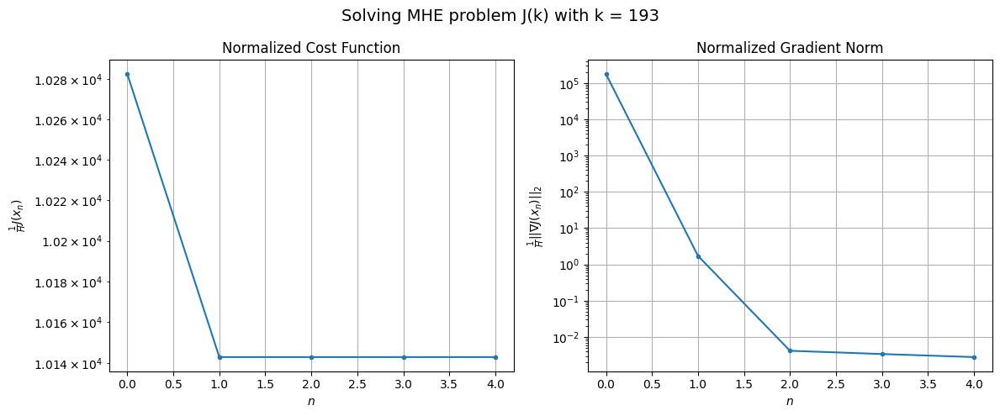

Windows:  42%|████▏     | 145/346 [24:20<26:17,  7.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 544975.0348889747
Gradient norm: 8827294.33944091
Global estimation error: 39.47745980104028
Initial conditions estimation errors: 18.76377832009633 m, 18.615238172122403 m, 15.3235764030227 m, 25.000854267460113 m
Position estimation errors: 34.212078068813746 m, 34.01305942148308 m, 38.13920760402555 m, 27.169515194012316 m

[Gauss-Newton] Iteration 1
Cost function: 537403.8191623503 (-1.39%)
Gradient norm: 406.97061380270424 (-100.00%)
Global estimation error: 50.900804905983485 (28.94%)
Initial conditions estimation errors: 21.845122329578345 m, 23.13473439358619 m, 18.879882378495534 m, 34.95720488848994 m
Position estimation errors: 31.80562810692398 m, 29.788896678586777 m, 34.90883057029345 m, 17.169193188353415 m

[Gauss-Newton] Iteration 2
Cost function: 537403.8191165818 (-0.00%)
Gradient norm: 0.10903379476718958 (-99.97%)
Global estimation error: 50.92439129869113 (0.05%)
Initial conditions estimation errors: 21.8

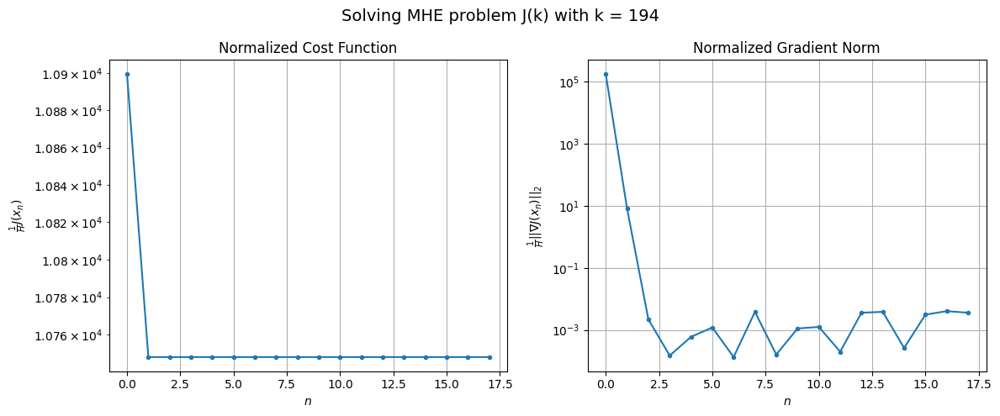

Windows:  42%|████▏     | 146/346 [24:42<40:34, 12.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 576585.0148362643
Gradient norm: 9168396.154422956
Global estimation error: 48.3094330719044
Initial conditions estimation errors: 20.216557513523846 m, 21.761158062490583 m, 17.288098875550773 m, 33.95078433092845 m
Position estimation errors: 35.472567890714664 m, 33.64096628781484 m, 38.68268394375016 m, 20.75369489033541 m

[Gauss-Newton] Iteration 1
Cost function: 568509.1770557066 (-1.40%)
Gradient norm: 37.95948335500868 (-100.00%)
Global estimation error: 54.044396984028275 (11.87%)
Initial conditions estimation errors: 23.285615091638523 m, 26.15518390248969 m, 19.81053124608089 m, 36.083440502599686 m
Position estimation errors: 32.99665552198215 m, 29.535850174959208 m, 36.74131237900786 m, 18.83767450324344 m

[Gauss-Newton] Iteration 2
Cost function: 568509.1770548376 (-0.00%)
Gradient norm: 0.01663552622567044 (-99.96%)
Global estimation error: 54.05727550039714 (0.02%)
Initial conditions estimation errors: 23.28

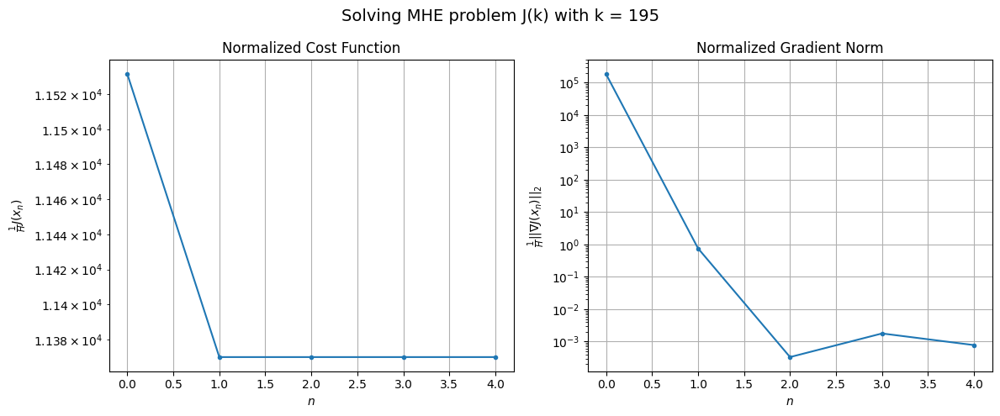

Windows:  42%|████▏     | 147/346 [24:50<35:22, 10.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 608718.4028474767
Gradient norm: 9465096.29613398
Global estimation error: 51.24226603806437
Initial conditions estimation errors: 21.591235605613445 m, 24.67200731380404 m, 18.16913991459241 m, 34.93926531156049 m
Position estimation errors: 36.737536988415116 m, 33.479274679319346 m, 40.60135778250543 m, 22.579656819350184 m

[Gauss-Newton] Iteration 1
Cost function: 600169.9783910083 (-1.40%)
Gradient norm: 77.40998201365497 (-100.00%)
Global estimation error: 54.41309935940257 (6.19%)
Initial conditions estimation errors: 24.642023448197587 m, 26.835278178109775 m, 21.242094610996503 m, 34.382923907930966 m
Position estimation errors: 34.195243130330894 m, 31.716017433985265 m, 37.89413139113601 m, 23.42815125598823 m

[Gauss-Newton] Iteration 2
Cost function: 600169.9783826128 (-0.00%)
Gradient norm: 0.08663918878078045 (-99.89%)
Global estimation error: 54.42022542050863 (0.01%)
Initial conditions estimation errors: 24.6

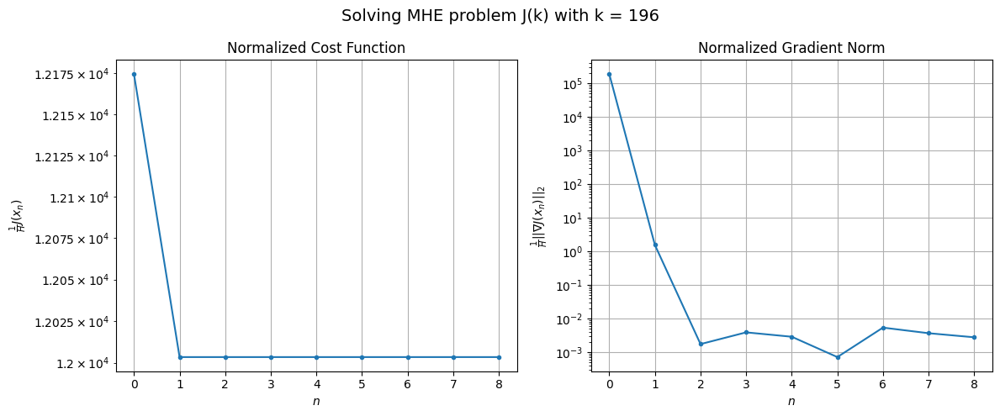

Windows:  43%|████▎     | 148/346 [25:01<35:57, 10.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 642577.3936554561
Gradient norm: 9899180.002300708
Global estimation error: 51.332991254259035
Initial conditions estimation errors: 22.928656316463368 m, 25.2623562398245 m, 19.555453614363387 m, 32.99605621703809 m
Position estimation errors: 38.01192561923096 m, 35.74643676344595 m, 41.83099818708045 m, 27.393373755130195 m

[Gauss-Newton] Iteration 1
Cost function: 633525.5637875268 (-1.41%)
Gradient norm: 142.07761480969833 (-100.00%)
Global estimation error: 54.49297035162166 (6.16%)
Initial conditions estimation errors: 25.954707082770135 m, 26.651902993729585 m, 23.940883729937738 m, 31.817212308213993 m
Position estimation errors: 35.39109867270845 m, 34.69712260643006 m, 37.759589285940294 m, 29.02947567553543 m

[Gauss-Newton] Iteration 2
Cost function: 633525.5637661276 (-0.00%)
Gradient norm: 0.37450009959468183 (-99.74%)
Global estimation error: 54.49167632033995 (-0.00%)
Initial conditions estimation errors: 25.

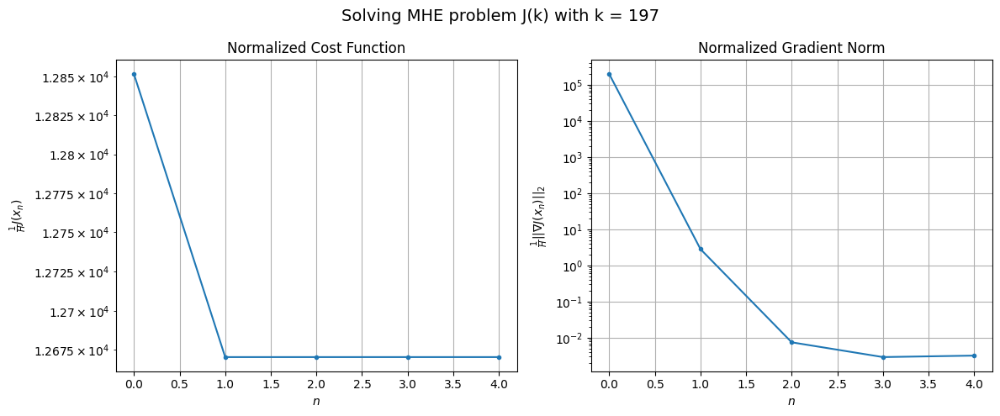

Windows:  43%|████▎     | 149/346 [25:08<31:46,  9.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 676407.4452903377
Gradient norm: 10159924.886473762
Global estimation error: 51.03908018462926
Initial conditions estimation errors: 24.230929703455583 m, 24.872429800328 m, 22.160651649043572 m, 30.13480939151216 m
Position estimation errors: 39.271027955410084 m, 38.8068319396044 m, 41.67176495723045 m, 33.13499323617718 m

[Gauss-Newton] Iteration 1
Cost function: 667113.7167635206 (-1.37%)
Gradient norm: 16.953758859142614 (-100.00%)
Global estimation error: 56.4502233757028 (10.60%)
Initial conditions estimation errors: 27.187314538329854 m, 27.0242959104901 m, 25.33678722004457 m, 32.79024691807451 m
Position estimation errors: 36.59968658912774 m, 36.84557991861254 m, 38.77123226733581 m, 30.69111323015483 m

[Gauss-Newton] Iteration 2
Cost function: 667113.7167799376 (0.00%)
Gradient norm: 0.39134823619045117 (-97.69%)
Global estimation error: 56.44194757792983 (-0.01%)
Initial conditions estimation errors: 27.18731492

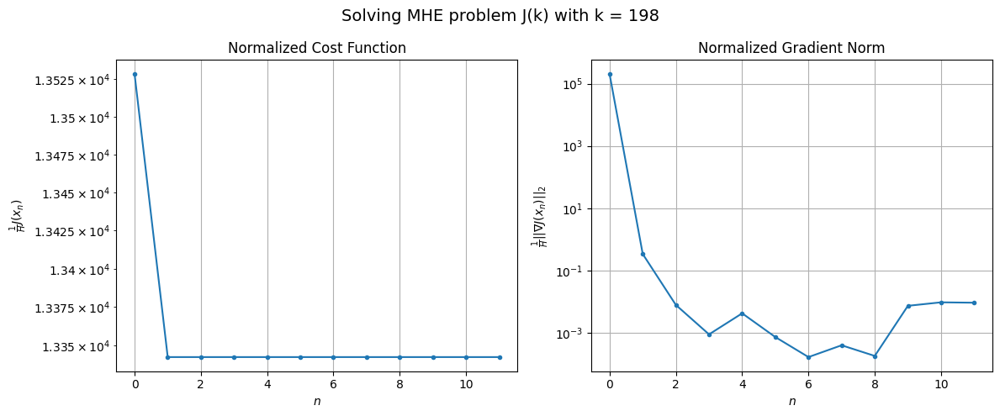

Windows:  43%|████▎     | 150/346 [25:22<36:24, 11.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 712031.8334999057
Gradient norm: 10670463.176591223
Global estimation error: 52.91541786850522
Initial conditions estimation errors: 25.44721092246245 m, 25.218610769855445 m, 23.542270769887686 m, 31.020208753879633 m
Position estimation errors: 40.5332555764614 m, 40.991661347989876 m, 42.73314379240889 m, 34.84579090362098 m

[Gauss-Newton] Iteration 1
Cost function: 702212.703553991 (-1.38%)
Gradient norm: 28.4696450736364 (-100.00%)
Global estimation error: 58.65536022292945 (10.85%)
Initial conditions estimation errors: 28.391673351712644 m, 28.44285669594281 m, 26.354919432146165 m, 33.62698901223295 m
Position estimation errors: 37.78085304321017 m, 37.886591865621945 m, 40.18782442944901 m, 32.49083401440037 m

[Gauss-Newton] Iteration 2
Cost function: 702212.7035570774 (0.00%)
Gradient norm: 0.19835457860650432 (-99.30%)
Global estimation error: 58.662076946670965 (0.01%)
Initial conditions estimation errors: 28.3916

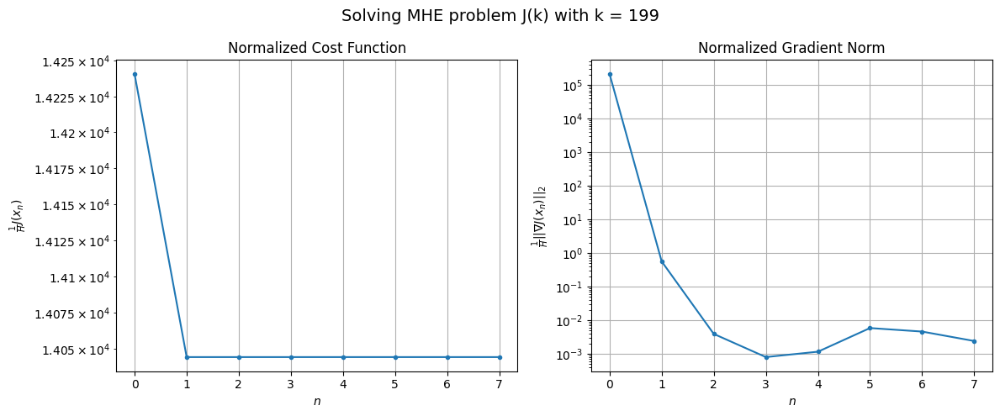

Windows:  44%|████▎     | 151/346 [25:35<37:37, 11.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 749180.5644462173
Gradient norm: 11189513.953433707
Global estimation error: 55.00021807095849
Initial conditions estimation errors: 26.61307113616901 m, 26.53477163746943 m, 24.56740973965597 m, 31.76642735640401 m
Position estimation errors: 41.774555361238704 m, 42.107173940715946 m, 44.14773037582832 m, 36.66195535266455 m

[Gauss-Newton] Iteration 1
Cost function: 739036.2007654604 (-1.35%)
Gradient norm: 278.4959104426082 (-100.00%)
Global estimation error: 55.82634326701221 (1.50%)
Initial conditions estimation errors: 29.51194626105863 m, 27.12340476145187 m, 27.17386588464753 m, 27.77617681794791 m
Position estimation errors: 38.95736133829953 m, 41.50256135614808 m, 41.45025183841196 m, 40.95048227881646 m

[Gauss-Newton] Iteration 2
Cost function: 739036.2007344003 (-0.00%)
Gradient norm: 0.260034238467302 (-99.91%)
Global estimation error: 55.8131666841029 (-0.02%)
Initial conditions estimation errors: 29.511946411

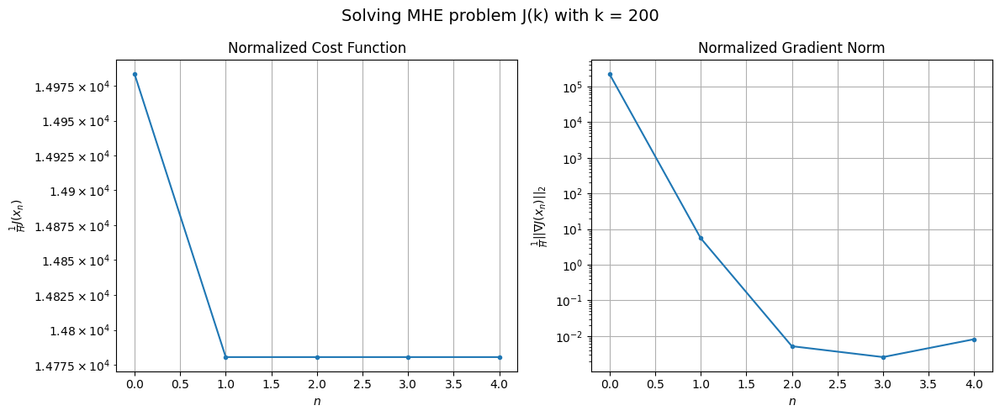

Windows:  44%|████▍     | 152/346 [25:43<33:49, 10.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 788172.2180768672
Gradient norm: 11812689.223316038
Global estimation error: 51.91979209430581
Initial conditions estimation errors: 27.67942984439644 m, 25.093129742927182 m, 25.378955858953443 m, 25.60755022290917 m
Position estimation errors: 43.03997387765155 m, 45.86704868250816 m, 45.41669225411426 m, 45.41851893180837 m

[Gauss-Newton] Iteration 1
Cost function: 777489.750024817 (-1.36%)
Gradient norm: 149.35988972507207 (-100.00%)
Global estimation error: 55.543478673599004 (6.98%)
Initial conditions estimation errors: 30.583144753810167 m, 27.356681166962783 m, 28.701199181964004 m, 24.033119356637616 m
Position estimation errors: 40.139514781082376 m, 43.63235794193962 m, 42.11173217846246 m, 47.212760578827826 m

[Gauss-Newton] Iteration 2
Cost function: 777489.7500204921 (-0.00%)
Gradient norm: 0.25660563056542063 (-99.83%)
Global estimation error: 55.55054215642706 (0.01%)
Initial conditions estimation errors: 30.

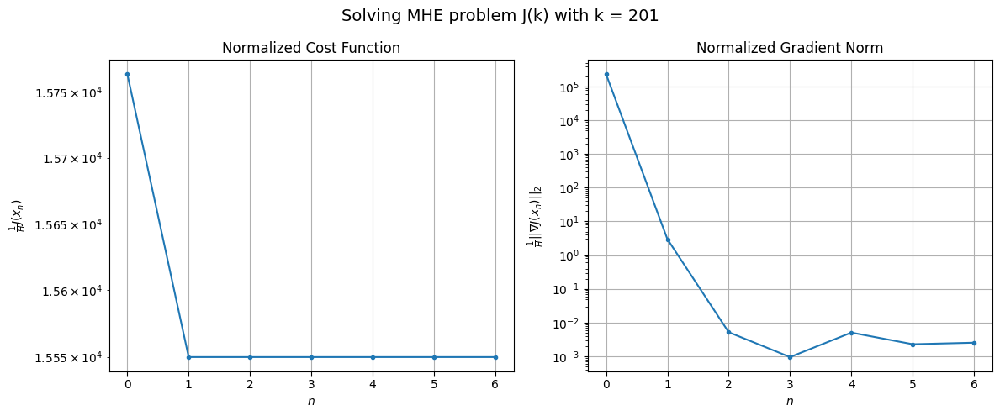

Windows:  44%|████▍     | 153/346 [25:53<33:46, 10.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 828512.1770082567
Gradient norm: 12590462.537616592
Global estimation error: 51.46544925156469
Initial conditions estimation errors: 28.670589806154315 m, 25.17931785298406 m, 26.87519223635673 m, 21.688812705948866 m
Position estimation errors: 44.34504682030007 m, 48.16659964901701 m, 46.15656741453992 m, 51.940199423497276 m

[Gauss-Newton] Iteration 1
Cost function: 817319.5633237804 (-1.35%)
Gradient norm: 58.614266635959616 (-100.00%)
Global estimation error: 56.98723403701487 (10.73%)
Initial conditions estimation errors: 31.576935328180635 m, 28.01365329813531 m, 30.87818677820637 m, 22.63189951940258 m
Position estimation errors: 41.351220995122375 m, 45.2183545291986 m, 42.00547546871456 m, 51.01600858989695 m

[Gauss-Newton] Iteration 2
Cost function: 817319.563311011 (-0.00%)
Gradient norm: 0.09430505596803923 (-99.84%)
Global estimation error: 56.99369275126737 (0.01%)
Initial conditions estimation errors: 31.5769

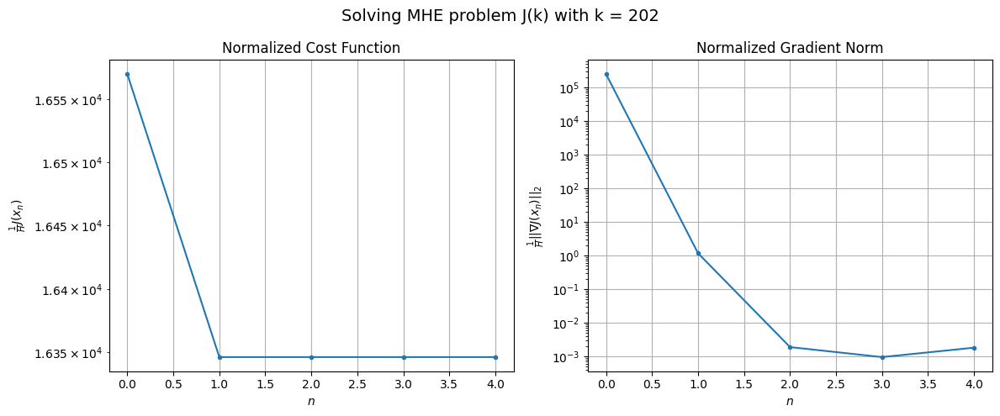

Windows:  45%|████▍     | 154/346 [26:00<30:07,  9.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 871745.6138066195
Gradient norm: 13725107.809430959
Global estimation error: 52.718005050947454
Initial conditions estimation errors: 29.569659596138344 m, 25.67971017441262 m, 28.986193680850956 m, 20.128703190098914 m
Position estimation errors: 45.70562292271606 m, 49.921278182828345 m, 46.107346562985924 m, 55.92016014557333 m

[Gauss-Newton] Iteration 1
Cost function: 859951.9752281411 (-1.35%)
Gradient norm: 84.51797586001656 (-100.00%)
Global estimation error: 56.49956346644368 (7.17%)
Initial conditions estimation errors: 32.4937876953131 m, 27.867539250061782 m, 31.031245047825976 m, 19.91995493222305 m
Position estimation errors: 42.60100613969838 m, 47.51743541746722 m, 43.8543284376061 m, 56.032821186650835 m

[Gauss-Newton] Iteration 2
Cost function: 859951.9752039829 (-0.00%)
Gradient norm: 0.2184804333598407 (-99.74%)
Global estimation error: 56.4979693892525 (-0.00%)
Initial conditions estimation errors: 32.493

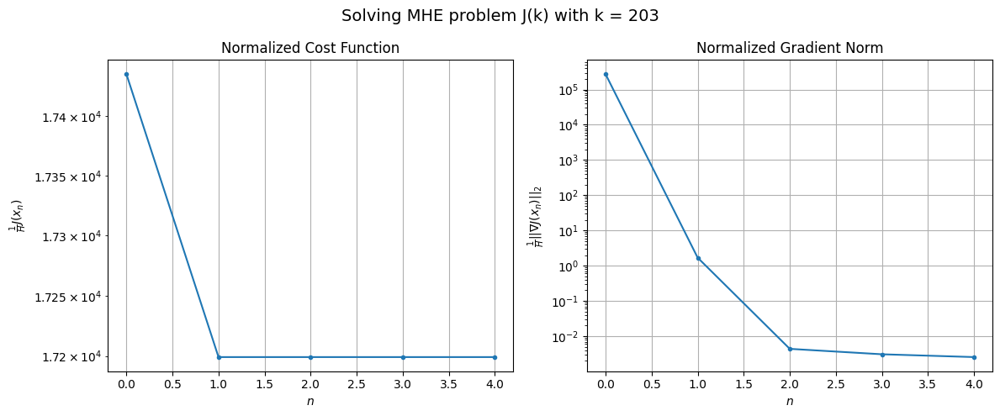

Windows:  45%|████▍     | 155/346 [26:07<27:35,  8.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 917721.9550752835
Gradient norm: 14412017.583239783
Global estimation error: 52.18889669053418
Initial conditions estimation errors: 30.389363588168155 m, 25.456984675581182 m, 29.14052426498477 m, 17.404814163868824 m
Position estimation errors: 47.11785795333466 m, 52.35295900777071 m, 48.07364404306223 m, 61.06606649670295 m

[Gauss-Newton] Iteration 1
Cost function: 905342.5861969083 (-1.35%)
Gradient norm: 44.91884228013718 (-100.00%)
Global estimation error: 59.49750440815783 (14.00%)
Initial conditions estimation errors: 33.345568120605954 m, 29.338349282328124 m, 32.567915158361416 m, 22.507913405123006 m
Position estimation errors: 43.91036423571577 m, 48.222713964517325 m, 44.4388962261436 m, 55.568000342488276 m

[Gauss-Newton] Iteration 2
Cost function: 905342.586193464 (-0.00%)
Gradient norm: 0.04647603926446145 (-99.90%)
Global estimation error: 59.500494886583 (0.01%)
Initial conditions estimation errors: 33.345

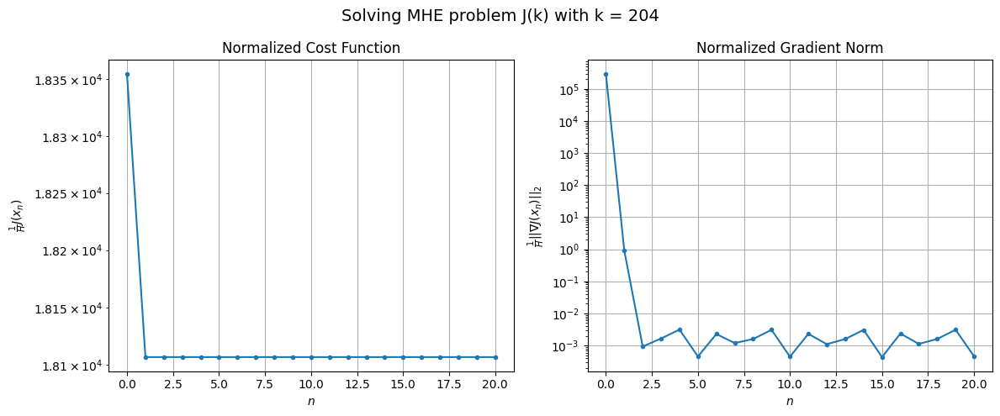

Windows:  45%|████▌     | 156/346 [26:34<44:31, 14.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 968544.4392536249
Gradient norm: 15268528.139838094
Global estimation error: 55.008847484396
Initial conditions estimation errors: 31.16348821401681 m, 26.86306232541474 m, 30.567493125595313 m, 19.97004144488255 m
Position estimation errors: 48.608748292314935 m, 53.246652445919736 m, 48.89517390724146 m, 60.77597172277113 m

[Gauss-Newton] Iteration 1
Cost function: 955438.6361703256 (-1.35%)
Gradient norm: 51.3322646781489 (-100.00%)
Global estimation error: 60.744115389179775 (10.43%)
Initial conditions estimation errors: 34.17994613234747 m, 30.00815697641947 m, 33.68785196216083 m, 22.050076358170074 m
Position estimation errors: 45.28891876094867 m, 49.741763455937246 m, 45.389478827744135 m, 58.29869042879605 m

[Gauss-Newton] Iteration 2
Cost function: 955438.6361662115 (-0.00%)
Gradient norm: 0.33845676856960827 (-99.34%)
Global estimation error: 60.7449285492917 (0.00%)
Initial conditions estimation errors: 34.17994

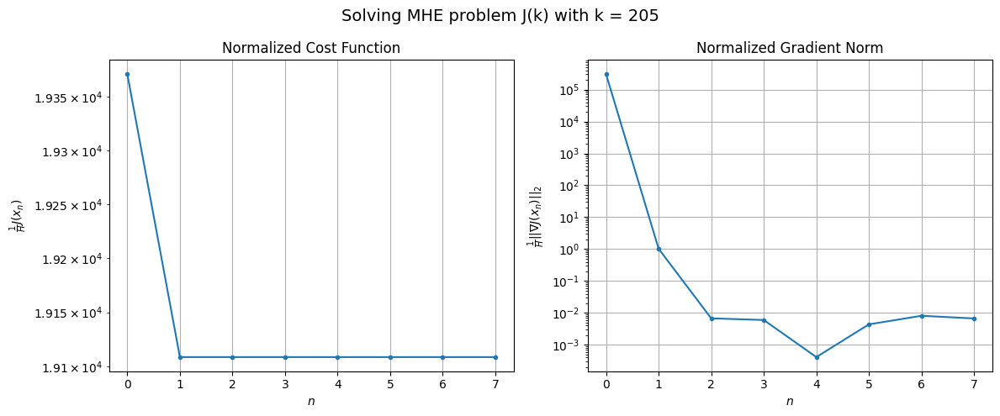

Windows:  45%|████▌     | 157/346 [26:45<41:29, 13.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1023010.9187599858
Gradient norm: 16160129.314470971
Global estimation error: 56.25084980384859
Initial conditions estimation errors: 31.953808469841785 m, 27.483685380440985 m, 31.70913144821441 m, 19.551940539246594 m
Position estimation errors: 50.20661222551115 m, 54.954456680950216 m, 49.98731898558413 m, 63.65084699566457 m

[Gauss-Newton] Iteration 1
Cost function: 1009063.8896789596 (-1.36%)
Gradient norm: 113.13989916682247 (-100.00%)
Global estimation error: 65.02542362008775 (15.60%)
Initial conditions estimation errors: 35.054110712242895 m, 32.82082828748059 m, 34.61371040303463 m, 26.91073109844264 m
Position estimation errors: 46.766011067344564 m, 49.158101091342616 m, 46.91617038351137 m, 55.377170266737096 m

[Gauss-Newton] Iteration 2
Cost function: 1009063.8896603435 (-0.00%)
Gradient norm: 0.07077957431912801 (-99.94%)
Global estimation error: 65.03279529847896 (0.01%)
Initial conditions estimation errors:

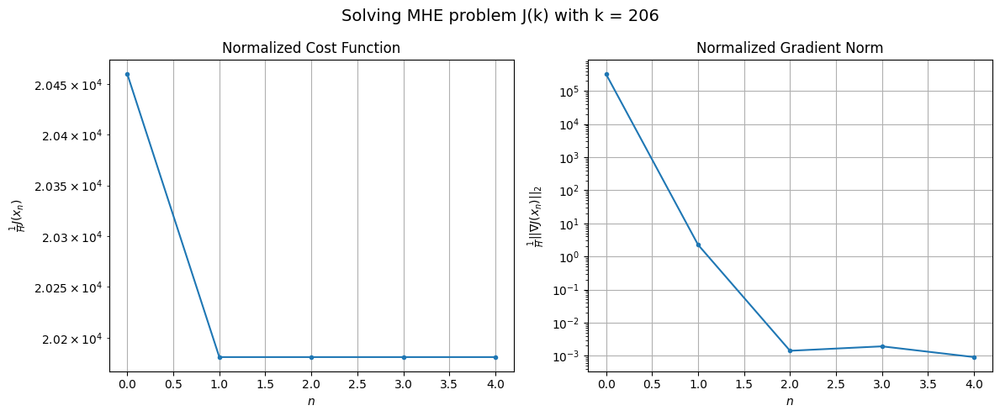

Windows:  46%|████▌     | 158/346 [26:52<35:20, 11.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1082808.9394163273
Gradient norm: 17113478.991662476
Global estimation error: 60.44264872847201
Initial conditions estimation errors: 32.81755053980445 m, 30.304521411797406 m, 32.53573328503933 m, 24.482088194328824 m
Position estimation errors: 51.96038516222366 m, 54.587312922977375 m, 51.898371961071796 m, 60.80202901706909 m

[Gauss-Newton] Iteration 1
Cost function: 1067930.0014284449 (-1.37%)
Gradient norm: 65.59547255436712 (-100.00%)
Global estimation error: 68.32502250646823 (13.04%)
Initial conditions estimation errors: 36.026735337571566 m, 34.376657705171326 m, 35.629546504417966 m, 30.317528067744053 m
Position estimation errors: 48.39806157739553 m, 50.179092077592074 m, 48.584718949351476 m, 54.39329181583763 m

[Gauss-Newton] Iteration 2
Cost function: 1067930.0014293334 (0.00%)
Gradient norm: 0.137497693595765 (-99.79%)
Global estimation error: 68.3265023205548 (0.00%)
Initial conditions estimation errors: 36

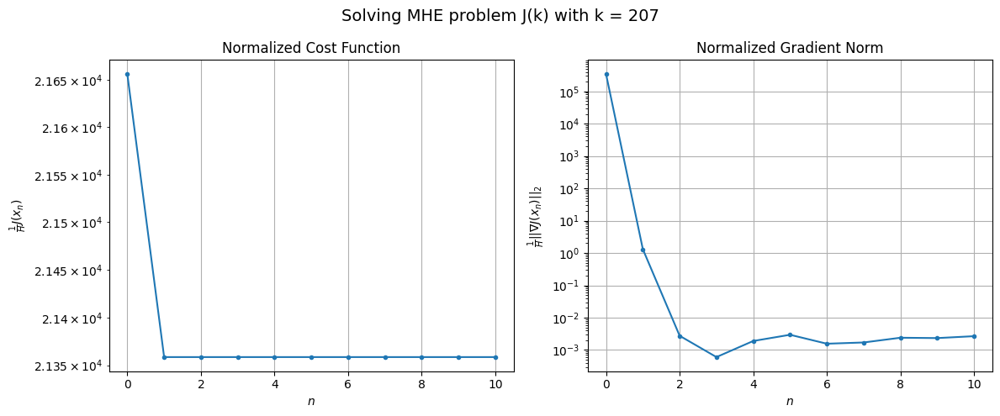

Windows:  46%|████▌     | 159/346 [27:06<37:53, 12.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1148970.873943886
Gradient norm: 18102261.238423258
Global estimation error: 63.73737282798112
Initial conditions estimation errors: 33.78656931132831 m, 31.91707407061587 m, 33.48055880202799 m, 27.951063126710366 m
Position estimation errors: 53.92395463650638 m, 55.90108240685476 m, 53.97462087710694 m, 60.06399632314975 m

[Gauss-Newton] Iteration 1
Cost function: 1133089.1512875047 (-1.38%)
Gradient norm: 94.40817480358389 (-100.00%)
Global estimation error: 70.32930749248722 (10.34%)
Initial conditions estimation errors: 37.128825064836235 m, 34.160256884289346 m, 38.16616100043338 m, 30.72574691675387 m
Position estimation errors: 50.23921383726578 m, 53.46701022574351 m, 48.48235444431175 m, 57.53153445410651 m

[Gauss-Newton] Iteration 2
Cost function: 1133089.1512681115 (-0.00%)
Gradient norm: 0.09349250963321665 (-99.90%)
Global estimation error: 70.3300089284573 (0.00%)
Initial conditions estimation errors: 37.1288

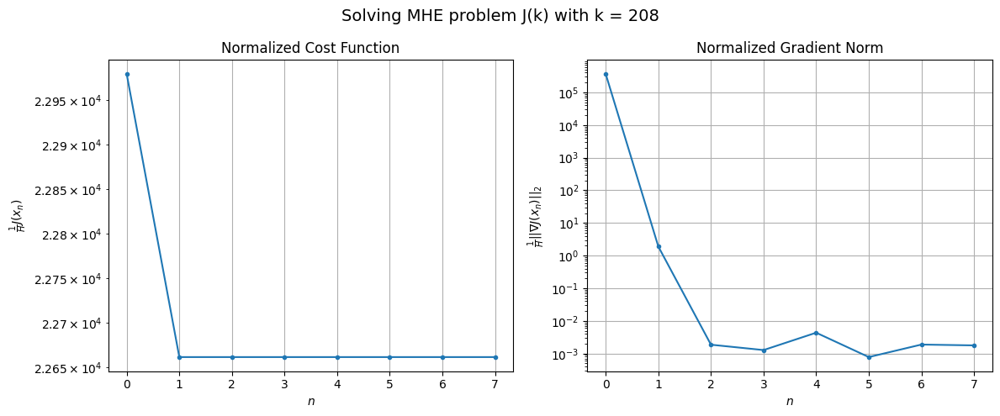

Windows:  46%|████▌     | 160/346 [27:17<36:16, 11.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1220818.5252507166
Gradient norm: 19455883.767051198
Global estimation error: 65.6122589404641
Initial conditions estimation errors: 34.85669146485096 m, 31.58452256964415 m, 36.054305438265985 m, 28.150904252608544 m
Position estimation errors: 56.12000715962164 m, 59.626082555598366 m, 54.0593676573919 m, 63.812558396935195 m

[Gauss-Newton] Iteration 1
Cost function: 1203508.1248472033 (-1.42%)
Gradient norm: 84.88106360549499 (-100.00%)
Global estimation error: 73.46504014135132 (11.97%)
Initial conditions estimation errors: 38.384887242026096 m, 35.577654339867024 m, 38.82244497250837 m, 33.92271183615015 m
Position estimation errors: 52.26701961333547 m, 55.25619685844577 m, 51.399936833773985 m, 57.18418710431508 m

[Gauss-Newton] Iteration 2
Cost function: 1203508.124861316 (0.00%)
Gradient norm: 0.14507836291919998 (-99.83%)
Global estimation error: 73.46338667410154 (-0.00%)
Initial conditions estimation errors: 38.3

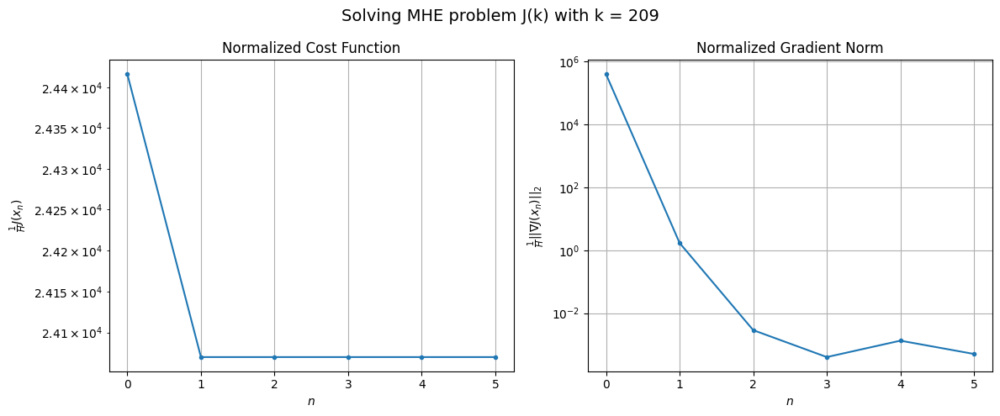

Windows:  47%|████▋     | 161/346 [27:24<32:27, 10.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1300639.9379641623
Gradient norm: 21526763.713905275
Global estimation error: 68.64240902037584
Initial conditions estimation errors: 36.01994323775379 m, 33.022888560261656 m, 36.55272940061325 m, 31.428015048642667 m
Position estimation errors: 58.477324668900636 m, 61.65618947777799 m, 57.44576849233677 m, 63.57125334800176 m

[Gauss-Newton] Iteration 1
Cost function: 1281596.2247776124 (-1.46%)
Gradient norm: 83.37092586981097 (-100.00%)
Global estimation error: 77.8989874212872 (13.49%)
Initial conditions estimation errors: 39.75679265873908 m, 37.5700917657347 m, 40.10760832394162 m, 38.30806005085073 m
Position estimation errors: 54.41869838416389 m, 56.38445319917483 m, 53.72197495158692 m, 55.68292924351981 m

[Gauss-Newton] Iteration 2
Cost function: 1281596.2247714964 (-0.00%)
Gradient norm: 0.16192109136543117 (-99.81%)
Global estimation error: 77.89865808679917 (-0.00%)
Initial conditions estimation errors: 39.756

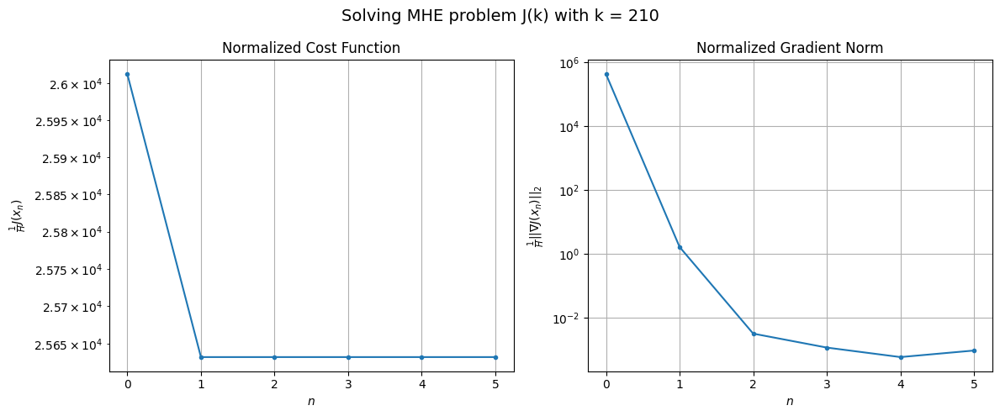

Windows:  47%|████▋     | 162/346 [27:32<29:51,  9.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1388452.756467549
Gradient norm: 22885156.30702524
Global estimation error: 72.80893615376459
Initial conditions estimation errors: 37.22754306606447 m, 34.913584706578504 m, 37.62700516573539 m, 35.78393802682868 m
Position estimation errors: 60.88657236919508 m, 62.9320641560197 m, 60.093747397539055 m, 62.11726753889598 m

[Gauss-Newton] Iteration 1
Cost function: 1367650.4698318932 (-1.50%)
Gradient norm: 80.88180913837371 (-100.00%)
Global estimation error: 81.78609188748109 (12.33%)
Initial conditions estimation errors: 41.200266479695614 m, 39.25150163231551 m, 42.25135654361569 m, 40.81218354868621 m
Position estimation errors: 56.63951134582875 m, 58.39146035689818 m, 54.61311586153943 m, 57.015716420862226 m

[Gauss-Newton] Iteration 2
Cost function: 1367650.4698335095 (0.00%)
Gradient norm: 0.12752545530552625 (-99.84%)
Global estimation error: 81.78693968323562 (0.00%)
Initial conditions estimation errors: 41.20026

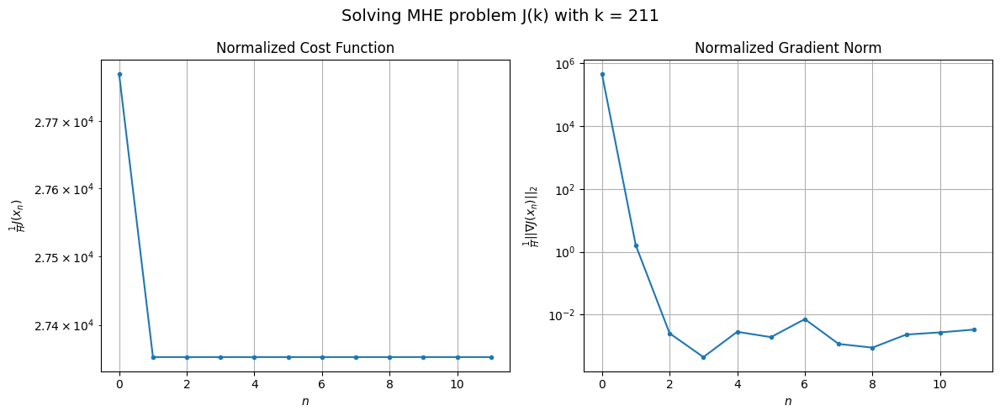

Windows:  47%|████▋     | 163/346 [27:48<34:52, 11.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1483100.373250173
Gradient norm: 24692885.056970943
Global estimation error: 76.28763294804247
Initial conditions estimation errors: 38.4591899561863 m, 36.36910900945732 m, 39.707968670407936 m, 37.963746408523534 m
Position estimation errors: 63.273840354189545 m, 65.14417128312081 m, 60.98428916323226 m, 63.73926629125828 m

[Gauss-Newton] Iteration 1
Cost function: 1460338.9993065135 (-1.53%)
Gradient norm: 110.37003905194028 (-100.00%)
Global estimation error: 83.32447954103091 (9.22%)
Initial conditions estimation errors: 42.66165745197254 m, 40.09168535806887 m, 44.766015272696144 m, 38.87929615954691 m
Position estimation errors: 58.81130150994465 m, 60.83941220470376 m, 55.51744355553985 m, 62.49799812432858 m

[Gauss-Newton] Iteration 2
Cost function: 1460338.9993070827 (0.00%)
Gradient norm: 0.13905000289448036 (-99.87%)
Global estimation error: 83.32405313890645 (-0.00%)
Initial conditions estimation errors: 42.661

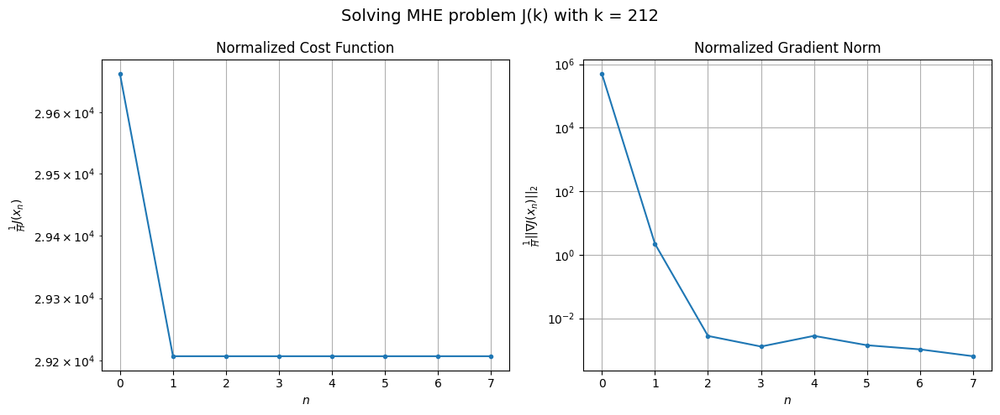

Windows:  47%|████▋     | 164/346 [27:58<33:59, 11.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1583660.2794139353
Gradient norm: 26347659.539374888
Global estimation error: 77.49301133897126
Initial conditions estimation errors: 39.71403528926456 m, 37.023817551477606 m, 42.11595950427239 m, 35.82499164534069 m
Position estimation errors: 65.50160154305112 m, 67.59907695686931 m, 61.86202361732618 m, 69.26414219541884 m

[Gauss-Newton] Iteration 1
Cost function: 1558894.1716146788 (-1.56%)
Gradient norm: 219.05610811266476 (-100.00%)
Global estimation error: 89.86109402615409 (15.96%)
Initial conditions estimation errors: 44.12966597755909 m, 44.5296967371416 m, 45.375258945652384 m, 45.670168029941564 m
Position estimation errors: 60.82101564076076 m, 60.42476673489529 m, 59.00385396250972 m, 59.68777866905889 m

[Gauss-Newton] Iteration 2
Cost function: 1558894.171556417 (-0.00%)
Gradient norm: 0.2200920645045138 (-99.90%)
Global estimation error: 89.86438426642026 (0.00%)
Initial conditions estimation errors: 44.1296

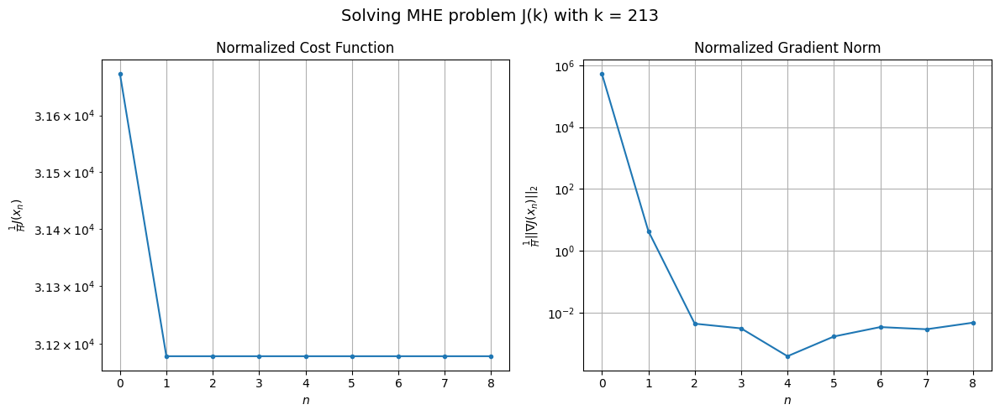

Windows:  48%|████▊     | 165/346 [28:10<34:00, 11.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1687893.8480975523
Gradient norm: 27796244.71044093
Global estimation error: 83.44014012844735
Initial conditions estimation errors: 41.025929075449255 m, 41.22716127648363 m, 42.293610580083026 m, 42.31645893570092 m
Position estimation errors: 67.4477025300311 m, 67.26480500372358 m, 65.61944961570795 m, 66.58843089271784 m

[Gauss-Newton] Iteration 1
Cost function: 1661211.0377325076 (-1.58%)
Gradient norm: 103.6544985988329 (-100.00%)
Global estimation error: 94.11021066132798 (12.79%)
Initial conditions estimation errors: 45.62215174890822 m, 47.6804852190042 m, 46.245580956861374 m, 48.613258306007275 m
Position estimation errors: 62.55719509321464 m, 60.447891267179735 m, 61.64557322738155 m, 59.47853798417355 m

[Gauss-Newton] Iteration 2
Cost function: 1661211.0377196888 (-0.00%)
Gradient norm: 0.3461820757323337 (-99.67%)
Global estimation error: 94.10964824578696 (-0.00%)
Initial conditions estimation errors: 45.622

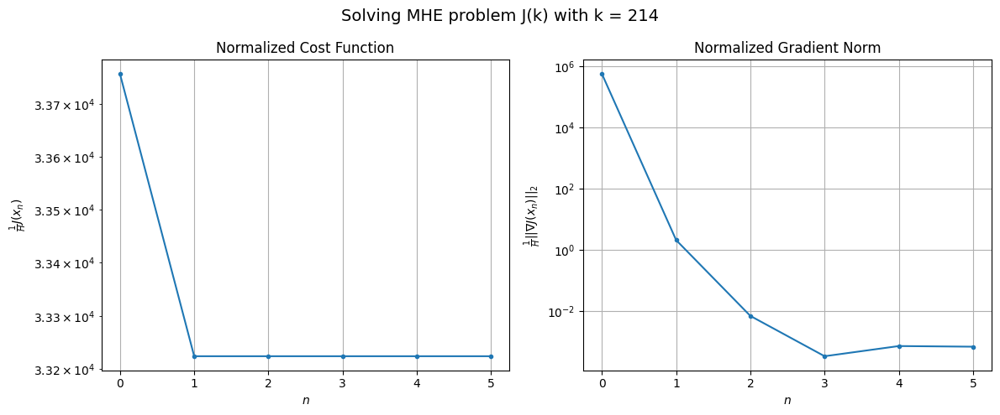

Windows:  48%|████▊     | 166/346 [28:18<30:50, 10.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1795835.3929602087
Gradient norm: 28504170.231512405
Global estimation error: 87.59561900867759
Initial conditions estimation errors: 42.42348317608716 m, 44.369894267138875 m, 42.96832245358453 m, 45.36798552071456 m
Position estimation errors: 68.98823250015332 m, 67.04242930317919 m, 68.20554949509048 m, 66.00743999343872 m

[Gauss-Newton] Iteration 1
Cost function: 1767301.3579801999 (-1.59%)
Gradient norm: 122.69982744187087 (-100.00%)
Global estimation error: 96.4438656348301 (10.10%)
Initial conditions estimation errors: 47.17731435641828 m, 49.063617225549926 m, 47.79125212068761 m, 48.83087473880767 m
Position estimation errors: 63.89882627731003 m, 62.18563259341764 m, 63.17930820901109 m, 62.31664332571514 m

[Gauss-Newton] Iteration 2
Cost function: 1767301.3579903466 (0.00%)
Gradient norm: 0.14908453676914152 (-99.88%)
Global estimation error: 96.44429653711009 (0.00%)
Initial conditions estimation errors: 47.1773

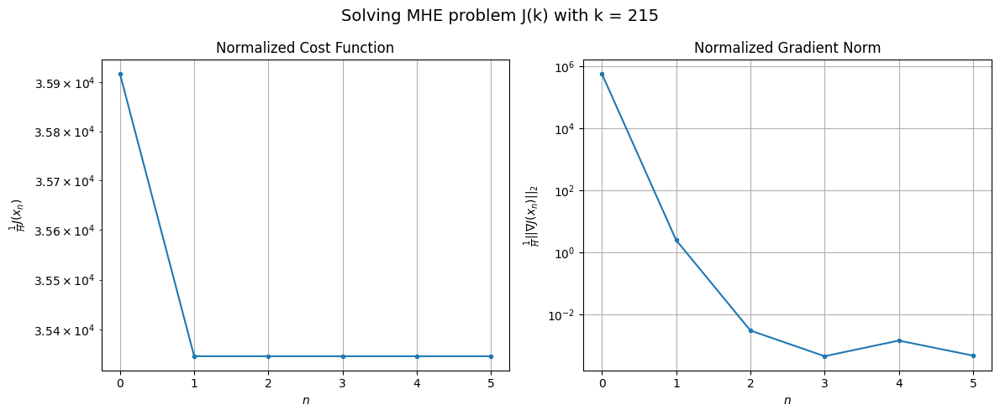

Windows:  48%|████▊     | 167/346 [28:25<28:20,  9.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1901271.4750628925
Gradient norm: 28970337.360828094
Global estimation error: 89.7681423289137
Initial conditions estimation errors: 43.92613129054382 m, 45.65360102063637 m, 44.46035156225184 m, 45.47323190868329 m
Position estimation errors: 69.99700373906091 m, 68.49164536307276 m, 69.40131772903223 m, 68.56958792699163 m

[Gauss-Newton] Iteration 1
Cost function: 1871223.087307369 (-1.58%)
Gradient norm: 148.76169806013766 (-100.00%)
Global estimation error: 99.5987587796961 (10.95%)
Initial conditions estimation errors: 48.78453090283532 m, 49.67230847321509 m, 50.90964681880545 m, 49.80788689080216 m
Position estimation errors: 64.73926593853464 m, 63.60185291835457 m, 62.22971171740264 m, 63.432990730149726 m

[Gauss-Newton] Iteration 2
Cost function: 1871223.0872893697 (-0.00%)
Gradient norm: 0.0321146557694106 (-99.98%)
Global estimation error: 99.59947873982833 (0.00%)
Initial conditions estimation errors: 48.7845221

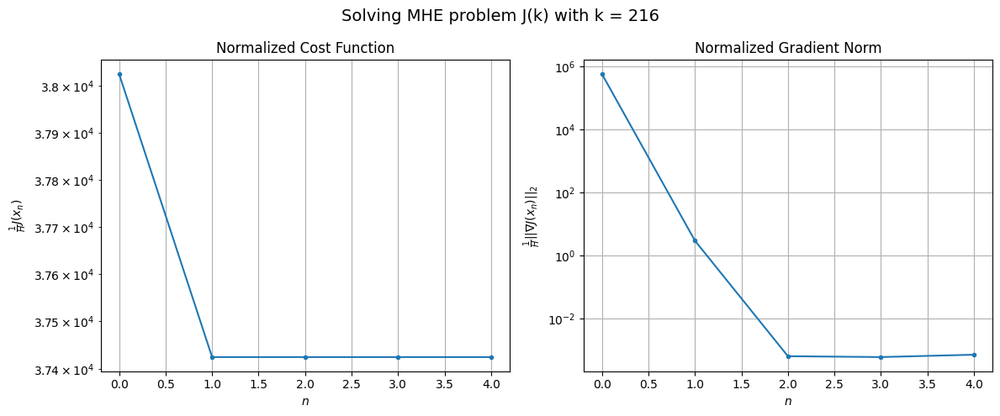

Windows:  49%|████▊     | 168/346 [28:32<25:30,  8.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1998840.099681601
Gradient norm: 29046376.058827195
Global estimation error: 92.98675373911425
Initial conditions estimation errors: 45.498094977577274 m, 46.34102245759657 m, 47.582765407561965 m, 46.52765749718544 m
Position estimation errors: 70.38694630263227 m, 69.34707588865149 m, 67.98583270808732 m, 69.13197213952756 m

[Gauss-Newton] Iteration 1
Cost function: 1967657.418758357 (-1.56%)
Gradient norm: 267.04357166863804 (-100.00%)
Global estimation error: 102.35808622291813 (10.08%)
Initial conditions estimation errors: 50.3942891122575 m, 50.76862806729718 m, 53.986977346284505 m, 49.4521809528963 m
Position estimation errors: 64.9783442516791 m, 64.22115541143862 m, 62.218515662703986 m, 64.71332324116055 m

[Gauss-Newton] Iteration 2
Cost function: 1967657.4187515147 (-0.00%)
Gradient norm: 0.026691120987821736 (-99.99%)
Global estimation error: 102.36233422563949 (0.00%)
Initial conditions estimation errors: 50.39

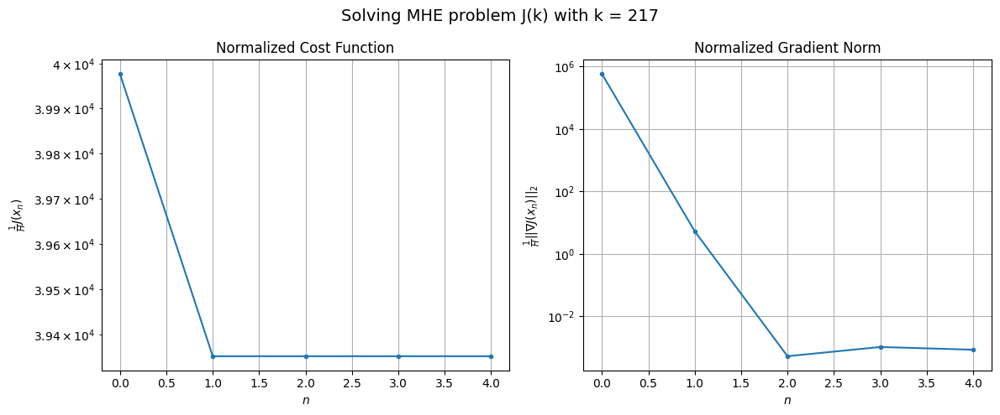

Windows:  49%|████▉     | 169/346 [28:39<23:44,  8.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2085832.028809597
Gradient norm: 28887349.06712761
Global estimation error: 95.85108883023942
Initial conditions estimation errors: 47.08089994370964 m, 47.567609228594385 m, 50.36218249209707 m, 46.602211473594814 m
Position estimation errors: 70.11434437256011 m, 69.27183165345467 m, 67.71923386933332 m, 69.41485816486579 m

[Gauss-Newton] Iteration 1
Cost function: 2053950.264449235 (-1.53%)
Gradient norm: 165.64173227371555 (-100.00%)
Global estimation error: 105.00924703514175 (9.55%)
Initial conditions estimation errors: 51.97450491285493 m, 52.51589492244462 m, 54.23107791798087 m, 51.250706746531 m
Position estimation errors: 64.59451242552288 m, 64.3032679808235 m, 62.85479801471367 m, 64.7141741383991 m

[Gauss-Newton] Iteration 2
Cost function: 2053950.2644226353 (-0.00%)
Gradient norm: 0.20158935250498244 (-99.88%)
Global estimation error: 105.0089306418945 (-0.00%)
Initial conditions estimation errors: 51.97449551

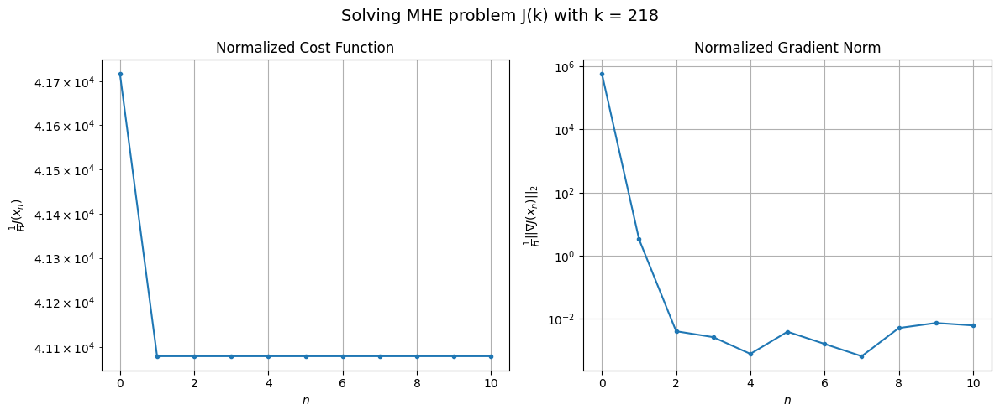

Windows:  49%|████▉     | 170/346 [28:53<29:15,  9.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2158722.674490723
Gradient norm: 28805617.51638243
Global estimation error: 98.31035209932568
Initial conditions estimation errors: 48.63069601640858 m, 49.13481558551916 m, 50.68539046686462 m, 48.132262670787554 m
Position estimation errors: 69.24597255455758 m, 68.99916495770213 m, 67.73584962646137 m, 69.15176733943467 m

[Gauss-Newton] Iteration 1
Cost function: 2126279.005617705 (-1.50%)
Gradient norm: 160.34358118564657 (-100.00%)
Global estimation error: 108.90137406157095 (10.77%)
Initial conditions estimation errors: 53.50874863642869 m, 54.536982354450814 m, 55.84410043084998 m, 53.883661537423365 m
Position estimation errors: 63.62243634984435 m, 62.818402289336014 m, 62.25507709540707 m, 62.19900532601825 m

[Gauss-Newton] Iteration 2
Cost function: 2126279.0056131715 (-0.00%)
Gradient norm: 0.09394977837831955 (-99.94%)
Global estimation error: 108.90344503527503 (0.00%)
Initial conditions estimation errors: 53.5

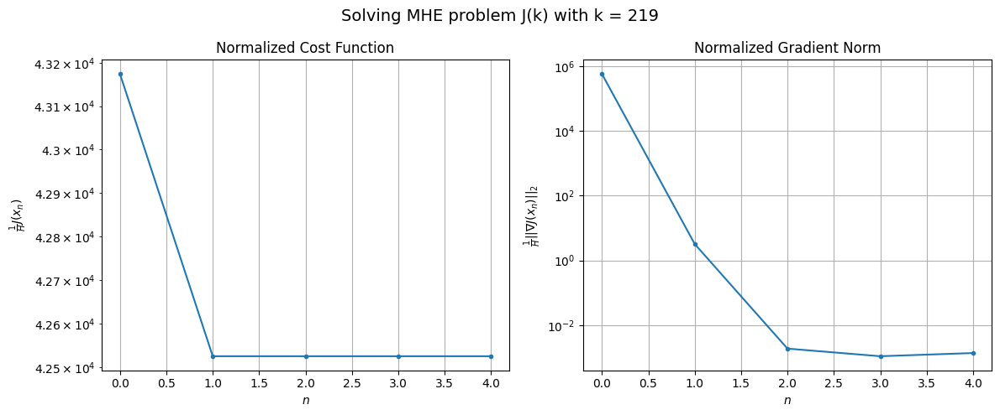

Windows:  49%|████▉     | 171/346 [29:00<26:11,  8.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2213804.17623512
Gradient norm: 28819536.797049914
Global estimation error: 102.20472459778384
Initial conditions estimation errors: 50.12205116270458 m, 51.20890108473805 m, 52.11078551485027 m, 50.94775826533765 m
Position estimation errors: 67.87606623112755 m, 67.05192270474788 m, 66.91677543143346 m, 65.99309240386191 m

[Gauss-Newton] Iteration 1
Cost function: 2181212.414302529 (-1.47%)
Gradient norm: 459.6404658809141 (-100.00%)
Global estimation error: 113.6684226677927 (11.22%)
Initial conditions estimation errors: 54.9453434688502 m, 58.10895178532689 m, 54.74014717151844 m, 59.39998606350704 m
Position estimation errors: 62.16672780413063 m, 59.39674147507954 m, 62.12467183384975 m, 57.57491790203027 m

[Gauss-Newton] Iteration 2
Cost function: 2181212.414218639 (-0.00%)
Gradient norm: 0.07313172654100293 (-99.98%)
Global estimation error: 113.66770397254743 (-0.00%)
Initial conditions estimation errors: 54.9453341

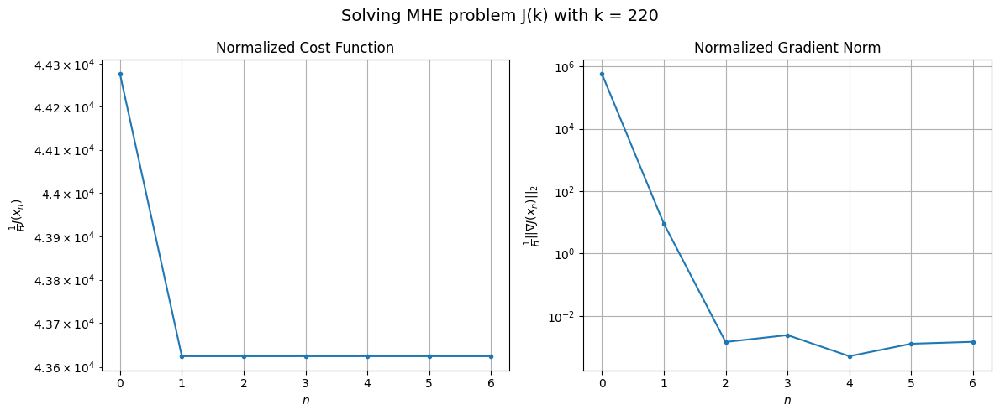

Windows:  50%|████▉     | 172/346 [29:09<25:56,  8.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2248863.0939707225
Gradient norm: 28725023.694464486
Global estimation error: 106.78151279940555
Initial conditions estimation errors: 51.4996094403733 m, 54.597823538412314 m, 51.29954169596581 m, 56.01331016170751 m
Position estimation errors: 66.1000804588939 m, 63.48845929566492 m, 66.1189814025916 m, 61.54763787318693 m

[Gauss-Newton] Iteration 1
Cost function: 2216557.4498612583 (-1.44%)
Gradient norm: 137.79629092567214 (-100.00%)
Global estimation error: 116.88378495544526 (9.46%)
Initial conditions estimation errors: 56.245310523839876 m, 61.22858934020992 m, 55.132655980261504 m, 60.90737787404071 m
Position estimation errors: 60.33663944331783 m, 55.68985024525291 m, 61.3672344583678 m, 55.04624384513776 m

[Gauss-Newton] Iteration 2
Cost function: 2216557.4499165774 (0.00%)
Gradient norm: 0.08211113609040986 (-99.94%)
Global estimation error: 116.88946379651955 (0.00%)
Initial conditions estimation errors: 56.2453

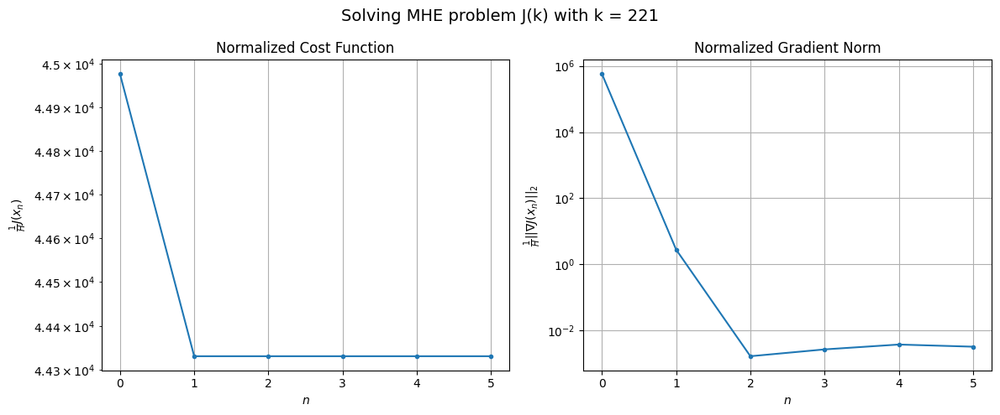

Windows:  50%|█████     | 173/346 [29:17<24:53,  8.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2262386.4832663643
Gradient norm: 28670424.277657047
Global estimation error: 109.98132359632558
Initial conditions estimation errors: 52.713843994578454 m, 57.748831550894316 m, 51.56493676850084 m, 57.647614628176925 m
Position estimation errors: 63.9648690302965 m, 59.43480864041274 m, 65.11865802721059 m, 58.510776809772665 m

[Gauss-Newton] Iteration 1
Cost function: 2230426.277894485 (-1.41%)
Gradient norm: 134.22039110024394 (-100.00%)
Global estimation error: 119.36716068286889 (8.53%)
Initial conditions estimation errors: 57.38118725954911 m, 61.7800146485509 m, 56.81087897455483 m, 62.54315577930084 m
Position estimation errors: 58.14010156615349 m, 54.87552379967781 m, 58.83417644885125 m, 53.187115474524035 m

[Gauss-Newton] Iteration 2
Cost function: 2230426.277881277 (-0.00%)
Gradient norm: 0.4063722866433558 (-99.70%)
Global estimation error: 119.36524143535891 (-0.00%)
Initial conditions estimation errors: 57.3

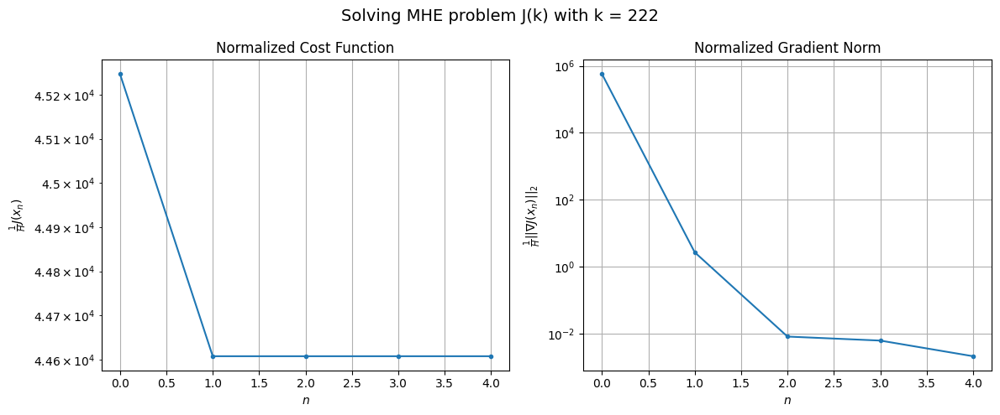

Windows:  50%|█████     | 174/346 [29:23<23:09,  8.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2254605.2128186286
Gradient norm: 28854664.73320754
Global estimation error: 111.97087478980238
Initial conditions estimation errors: 53.7257821633899 m, 57.99630998431685 m, 53.09268094483833 m, 58.894710502497496 m
Position estimation errors: 61.414412004875096 m, 58.49682966466313 m, 62.22920534875191 m, 56.63193064028661 m

[Gauss-Newton] Iteration 1
Cost function: 2223184.5534091257 (-1.39%)
Gradient norm: 508.1925577178009 (-100.00%)
Global estimation error: 123.27194714584164 (10.09%)
Initial conditions estimation errors: 58.29079389275277 m, 64.54112839541239 m, 55.53162703882041 m, 67.44487164975752 m
Position estimation errors: 55.525927548476496 m, 50.969378811715394 m, 57.41282647705732 m, 48.287811989857566 m

[Gauss-Newton] Iteration 2
Cost function: 2223184.553373085 (-0.00%)
Gradient norm: 0.041371342619083123 (-99.99%)
Global estimation error: 123.27219753918303 (0.00%)
Initial conditions estimation errors: 58

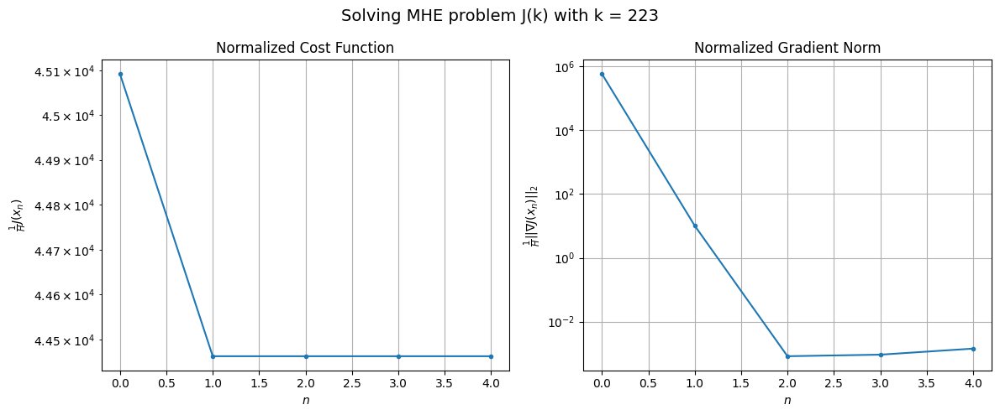

Windows:  51%|█████     | 175/346 [29:30<22:03,  7.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2224959.7153457673
Gradient norm: 28392116.174277894
Global estimation error: 115.31094344553578
Initial conditions estimation errors: 54.467838993356324 m, 60.40407495536553 m, 51.870804297754354 m, 63.171263450367626 m
Position estimation errors: 58.37071773014103 m, 54.416976764900305 m, 59.99654049382661 m, 52.01217105071357 m

[Gauss-Newton] Iteration 1
Cost function: 2194799.1112706196 (-1.36%)
Gradient norm: 568.6662633237065 (-100.00%)
Global estimation error: 121.47509623734868 (5.35%)
Initial conditions estimation errors: 58.89485590953089 m, 63.149603030913696 m, 58.419239324221074 m, 62.34491372016798 m
Position estimation errors: 52.495527482952824 m, 49.56986454112114 m, 53.25121756623692 m, 49.53854878129281 m

[Gauss-Newton] Iteration 2
Cost function: 2194799.111213973 (-0.00%)
Gradient norm: 0.1996854510227498 (-99.96%)
Global estimation error: 121.4718733446359 (-0.00%)
Initial conditions estimation errors: 5

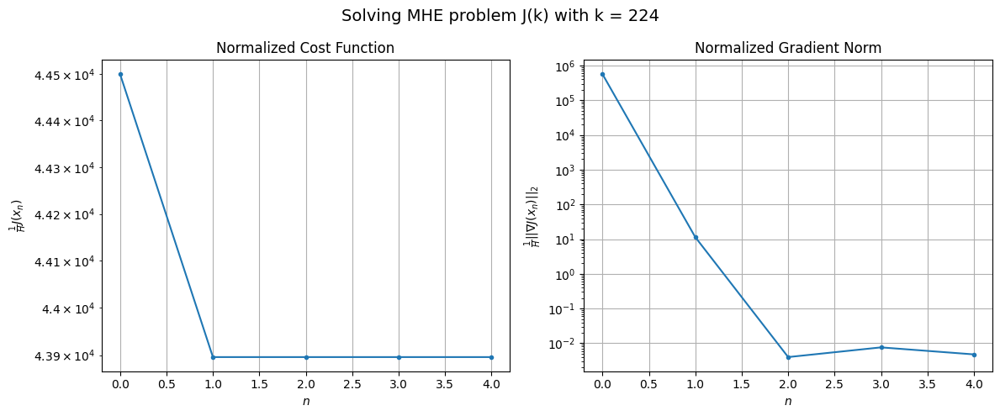

Windows:  51%|█████     | 176/346 [29:38<21:58,  7.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2171979.9079884817
Gradient norm: 27689034.81819399
Global estimation error: 113.2070903784106
Initial conditions estimation errors: 54.87146178874431 m, 58.92958540801139 m, 54.24993831347097 m, 58.216740551935935 m
Position estimation errors: 54.85597011894745 m, 52.37574612694459 m, 55.75796874282471 m, 52.18950865082458 m

[Gauss-Newton] Iteration 1
Cost function: 2143276.706835101 (-1.32%)
Gradient norm: 112.31552678949835 (-100.00%)
Global estimation error: 121.1720666853498 (7.04%)
Initial conditions estimation errors: 59.15904316601536 m, 62.932953803478455 m, 59.038462254690536 m, 61.1289943394766 m
Position estimation errors: 49.02960316150805 m, 46.329648779732196 m, 49.33534722365315 m, 46.71986845325842 m

[Gauss-Newton] Iteration 2
Cost function: 2143276.706824485 (-0.00%)
Gradient norm: 0.017325539191357153 (-99.98%)
Global estimation error: 121.17649856340815 (0.00%)
Initial conditions estimation errors: 59.159

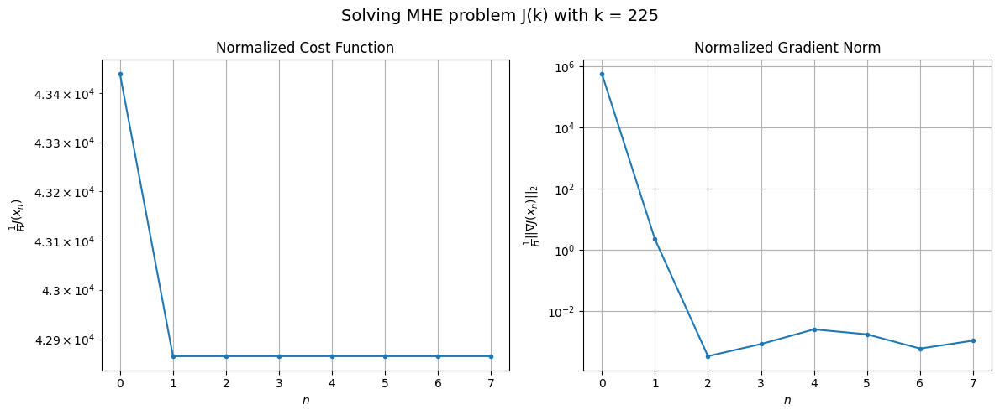

Windows:  51%|█████     | 177/346 [29:48<24:01,  8.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2100547.4952829964
Gradient norm: 27033357.068689488
Global estimation error: 112.6361580926163
Initial conditions estimation errors: 54.921156012298525 m, 58.59441786789275 m, 54.66318042604319 m, 57.00153071679392 m
Position estimation errors: 50.87804567482967 m, 48.523328804579975 m, 51.295267938014874 m, 48.517028605624674 m

[Gauss-Newton] Iteration 1
Cost function: 2073643.8495738006 (-1.28%)
Gradient norm: 139.33435943855383 (-100.00%)
Global estimation error: 121.39586112526129 (7.78%)
Initial conditions estimation errors: 59.028328341181165 m, 63.259465910570746 m, 58.14060038212071 m, 62.21329869833909 m
Position estimation errors: 45.1245647343209 m, 42.2747070947524 m, 45.64504494873707 m, 42.3319525850129 m

[Gauss-Newton] Iteration 2
Cost function: 2073643.849511854 (-0.00%)
Gradient norm: 0.19104530557190555 (-99.86%)
Global estimation error: 121.39639613313456 (0.00%)
Initial conditions estimation errors: 59.0

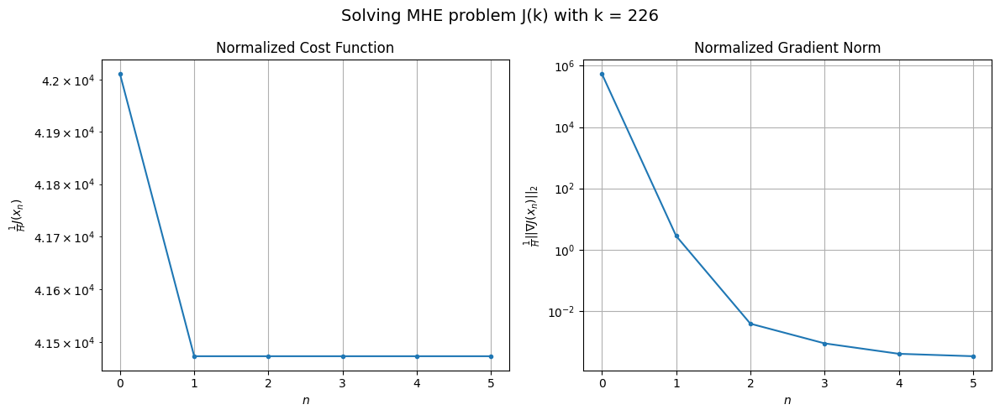

Windows:  51%|█████▏    | 178/346 [29:56<23:16,  8.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2008812.1209579494
Gradient norm: 25568637.116105907
Global estimation error: 112.33742089766943
Initial conditions estimation errors: 54.57489227556363 m, 58.61273818634453 m, 53.67219138805105 m, 57.663609966149146 m
Position estimation errors: 46.449803131471086 m, 44.050281538958686 m, 46.857516532178934 m, 43.901698180114764 m

[Gauss-Newton] Iteration 1
Cost function: 1984278.3006664766 (-1.22%)
Gradient norm: 112.1614350217996 (-100.00%)
Global estimation error: 121.07631604183565 (7.78%)
Initial conditions estimation errors: 58.48300079455852 m, 62.5631044357243 m, 57.23960707843506 m, 63.629155037577775 m
Position estimation errors: 40.87808327099392 m, 38.338167677817374 m, 41.52806501299367 m, 37.31355990770485 m

[Gauss-Newton] Iteration 2
Cost function: 1984278.3006777607 (0.00%)
Gradient norm: 0.0840523865050634 (-99.93%)
Global estimation error: 121.07317043482517 (-0.00%)
Initial conditions estimation errors: 5

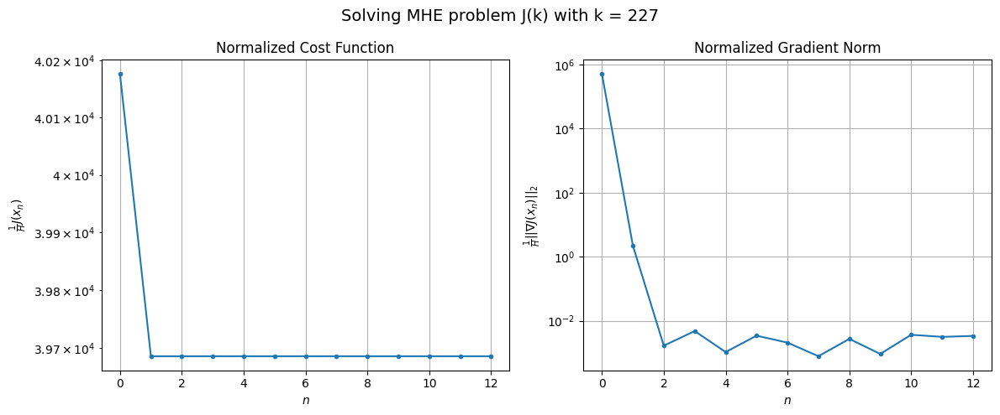

Windows:  52%|█████▏    | 179/346 [30:13<29:51, 10.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1901413.4292551032
Gradient norm: 24231667.262364954
Global estimation error: 111.42861821196318
Initial conditions estimation errors: 53.80857490457414 m, 57.61488958765207 m, 52.55393969541476 m, 58.647696540072076 m
Position estimation errors: 41.72226741703148 m, 39.69001983183619 m, 42.18698117539688 m, 38.77494560886423 m

[Gauss-Newton] Iteration 1
Cost function: 1879339.9026426638 (-1.16%)
Gradient norm: 88.66214101455985 (-100.00%)
Global estimation error: 118.80961135421548 (6.62%)
Initial conditions estimation errors: 57.50302909970675 m, 61.928126480292065 m, 56.17687126682443 m, 61.79127723442299 m
Position estimation errors: 36.36311015032883 m, 33.848522252806696 m, 36.84609033641657 m, 33.6065220542116 m

[Gauss-Newton] Iteration 2
Cost function: 1879339.902697395 (0.00%)
Gradient norm: 0.17129702191816135 (-99.81%)
Global estimation error: 118.81488220650996 (0.00%)
Initial conditions estimation errors: 57.503

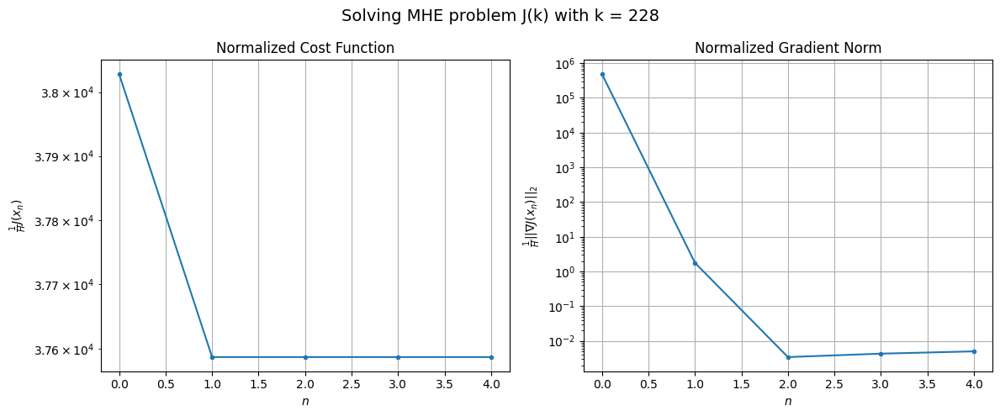

Windows:  52%|█████▏    | 180/346 [30:20<26:36,  9.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1782145.3552401785
Gradient norm: 22836246.81002278
Global estimation error: 108.75867491638633
Initial conditions estimation errors: 52.61151901510218 m, 56.77677592017454 m, 51.29114675647998 m, 56.62210307245494 m
Position estimation errors: 36.82169900321768 m, 34.86930012360835 m, 37.06605342911536 m, 34.61145783937485 m

[Gauss-Newton] Iteration 1
Cost function: 1762813.3494233226 (-1.08%)
Gradient norm: 79.02785652447338 (-100.00%)
Global estimation error: 115.28382977264694 (6.00%)
Initial conditions estimation errors: 56.05133954813307 m, 59.84968726439436 m, 54.945850914554875 m, 59.56127975489666 m
Position estimation errors: 31.725169357590854 m, 29.59679660420753 m, 31.711509663807362 m, 29.787213905303933 m

[Gauss-Newton] Iteration 2
Cost function: 1762813.3494005525 (-0.00%)
Gradient norm: 0.21283009816983758 (-99.73%)
Global estimation error: 115.28319579455696 (-0.00%)
Initial conditions estimation errors: 56

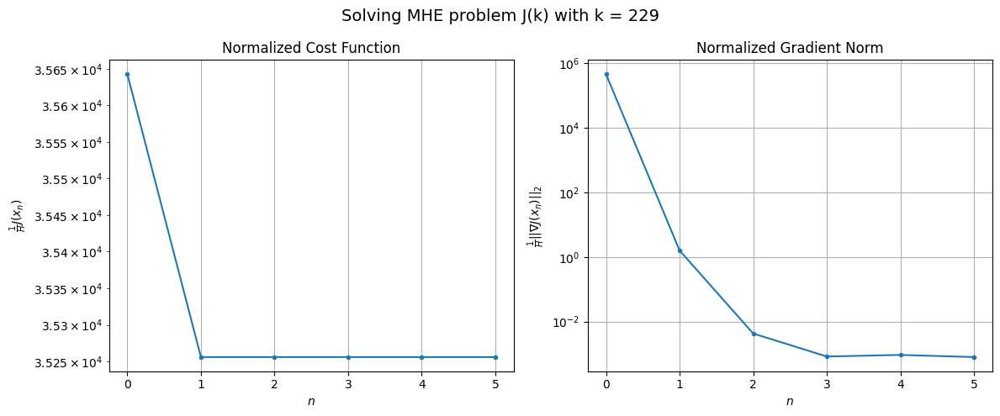

Windows:  52%|█████▏    | 181/346 [30:27<24:51,  9.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1657418.3725857884
Gradient norm: 21535553.20879072
Global estimation error: 104.83243908106738
Initial conditions estimation errors: 50.98448151187679 m, 54.483173827104714 m, 49.9143724439969 m, 54.134372186871715 m
Position estimation errors: 31.950979420912734 m, 30.33626472797406 m, 31.63914717067452 m, 30.555622736466447 m

[Gauss-Newton] Iteration 1
Cost function: 1640794.5465502234 (-1.00%)
Gradient norm: 256.64837067078685 (-100.00%)
Global estimation error: 116.43529075204809 (11.07%)
Initial conditions estimation errors: 54.16803003233843 m, 59.212408160880884 m, 53.80032137728229 m, 64.97988897260711 m
Position estimation errors: 27.166007994548284 m, 24.813833833707054 m, 27.413547167317116 m, 22.69442876327436 m

[Gauss-Newton] Iteration 2
Cost function: 1640794.5464325922 (-0.00%)
Gradient norm: 0.2473139299953283 (-99.90%)
Global estimation error: 116.43457100573218 (-0.00%)
Initial conditions estimation errors

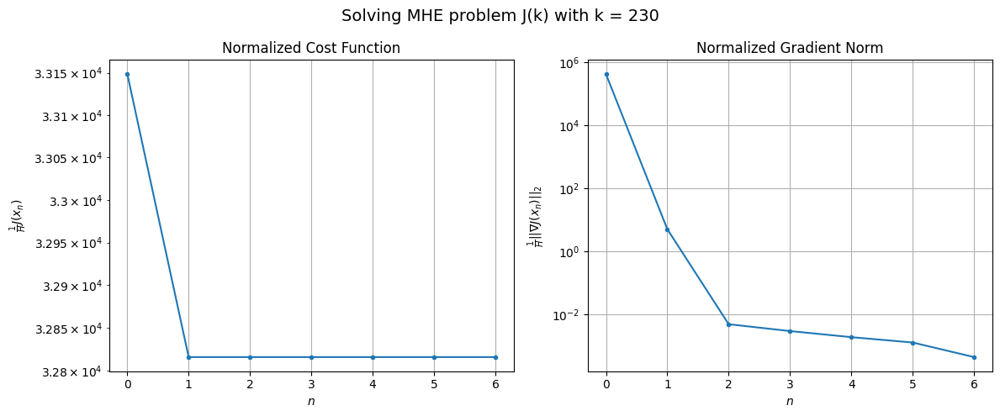

Windows:  53%|█████▎    | 182/346 [30:36<24:43,  9.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1532382.410136328
Gradient norm: 20425697.28181083
Global estimation error: 105.87569985875847
Initial conditions estimation errors: 49.0110608749151 m, 53.83632809864956 m, 48.650786888666055 m, 59.51721456904163 m
Position estimation errors: 27.377839825466808 m, 25.7308967627418 m, 27.569981184680433 m, 24.3458414376955 m

[Gauss-Newton] Iteration 1
Cost function: 1518416.2902881787 (-0.91%)
Gradient norm: 66.68606197436598 (-100.00%)
Global estimation error: 113.18166597038322 (6.90%)
Initial conditions estimation errors: 51.918186525807634 m, 56.85943715545499 m, 51.63405780786017 m, 64.92679046335792 m
Position estimation errors: 22.94101456147768 m, 21.03140187832838 m, 23.102640277090156 m, 20.396328731995638 m

[Gauss-Newton] Iteration 2
Cost function: 1518416.2902958144 (0.00%)
Gradient norm: 0.24815971668098158 (-99.63%)
Global estimation error: 113.17548148855447 (-0.01%)
Initial conditions estimation errors: 51.91

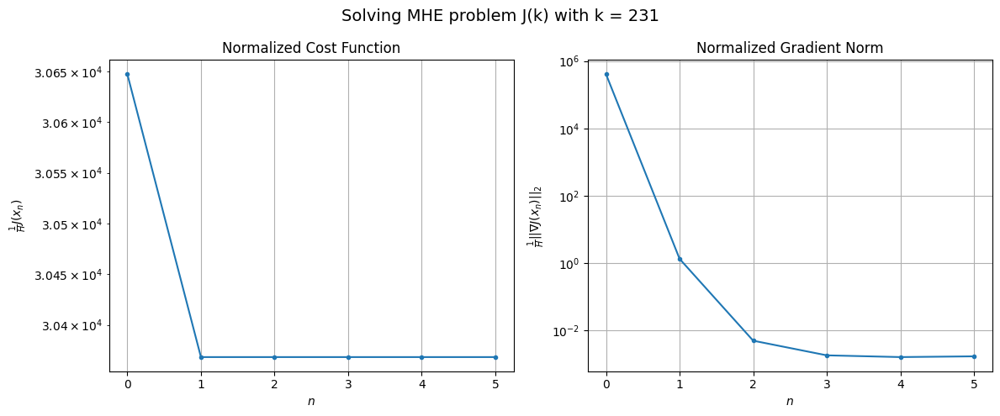

Windows:  53%|█████▎    | 183/346 [30:44<23:21,  8.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1410603.3091797754
Gradient norm: 19424363.901891667
Global estimation error: 102.60705524471288
Initial conditions estimation errors: 46.77416199896678 m, 51.46523505053558 m, 46.51978516092779 m, 59.393550445222125 m
Position estimation errors: 23.41543124444038 m, 22.277742117806273 m, 23.52535533971429 m, 22.74529549379045 m

[Gauss-Newton] Iteration 1
Cost function: 1399120.3534680828 (-0.81%)
Gradient norm: 94.29371952356587 (-100.00%)
Global estimation error: 106.10848139503186 (3.41%)
Initial conditions estimation errors: 49.40795945528655 m, 52.352129173872655 m, 49.44963431152414 m, 60.26459245820578 m
Position estimation errors: 19.416638279288648 m, 18.242310317403543 m, 19.587930472701643 m, 18.6790972953812 m

[Gauss-Newton] Iteration 2
Cost function: 1399120.3534367557 (-0.00%)
Gradient norm: 0.10231541476909847 (-99.89%)
Global estimation error: 106.0844218592356 (-0.02%)
Initial conditions estimation errors: 4

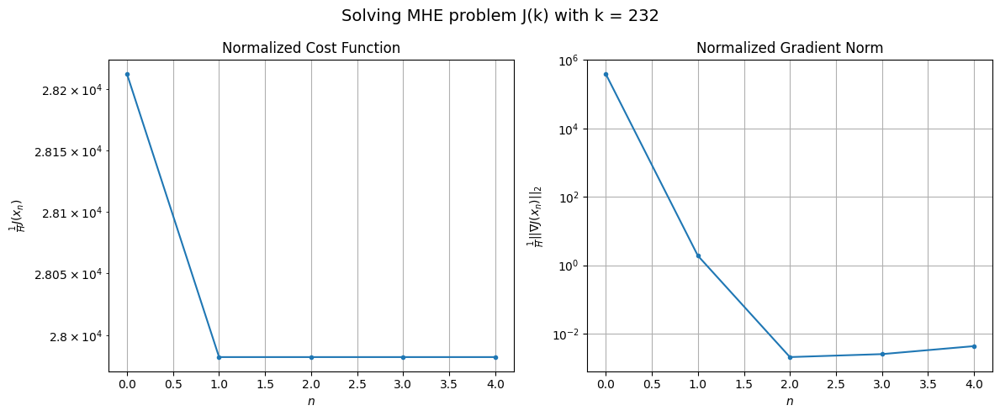

Windows:  53%|█████▎    | 184/346 [30:51<21:43,  8.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1298345.7879163837
Gradient norm: 19166224.007307936
Global estimation error: 95.76776004518523
Initial conditions estimation errors: 44.36618955007027 m, 47.06153781926139 m, 44.402540387330895 m, 54.92451416948527 m
Position estimation errors: 20.475359671082227 m, 19.76021775607453 m, 20.678518771558107 m, 21.379074699990085 m

[Gauss-Newton] Iteration 1
Cost function: 1288830.1537800585 (-0.73%)
Gradient norm: 48.245365972571186 (-100.00%)
Global estimation error: 100.44602528977227 (4.89%)
Initial conditions estimation errors: 46.73598796052222 m, 48.725328455965624 m, 46.72108143861529 m, 57.86281683874398 m
Position estimation errors: 16.920174755716904 m, 16.42464314856201 m, 16.923389090456446 m, 18.887102138933987 m

[Gauss-Newton] Iteration 2
Cost function: 1288830.1538003588 (0.00%)
Gradient norm: 0.06212034012672635 (-99.87%)
Global estimation error: 100.43116279139255 (-0.01%)
Initial conditions estimation errors

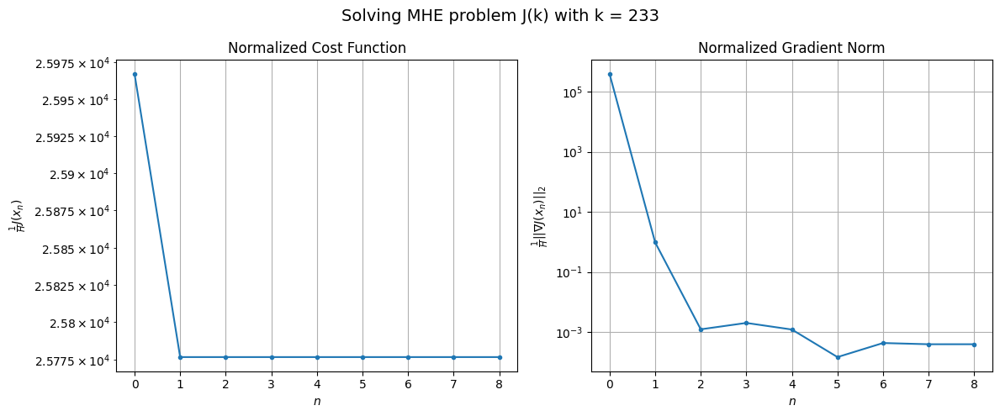

Windows:  53%|█████▎    | 185/346 [31:02<24:30,  9.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1197741.2475025915
Gradient norm: 19063381.632461082
Global estimation error: 90.46773205714238
Initial conditions estimation errors: 41.8626706657455 m, 43.605634832844125 m, 41.841431971438304 m, 52.723274636337976 m
Position estimation errors: 18.83745272229012 m, 18.61268728182405 m, 18.829697329957106 m, 22.205800926336916 m

[Gauss-Newton] Iteration 1
Cost function: 1189904.4507444396 (-0.65%)
Gradient norm: 46.79946819697514 (-100.00%)
Global estimation error: 94.42721590641256 (4.38%)
Initial conditions estimation errors: 43.99687486114728 m, 45.40147781226602 m, 43.973781866782076 m, 54.64210286195976 m
Position estimation errors: 15.892323698526116 m, 15.783972900637673 m, 15.893600372772577 m, 20.31320612814214 m

[Gauss-Newton] Iteration 2
Cost function: 1189904.4507468722 (0.00%)
Gradient norm: 0.10954458015495892 (-99.77%)
Global estimation error: 94.42257866498107 (-0.00%)
Initial conditions estimation errors: 4

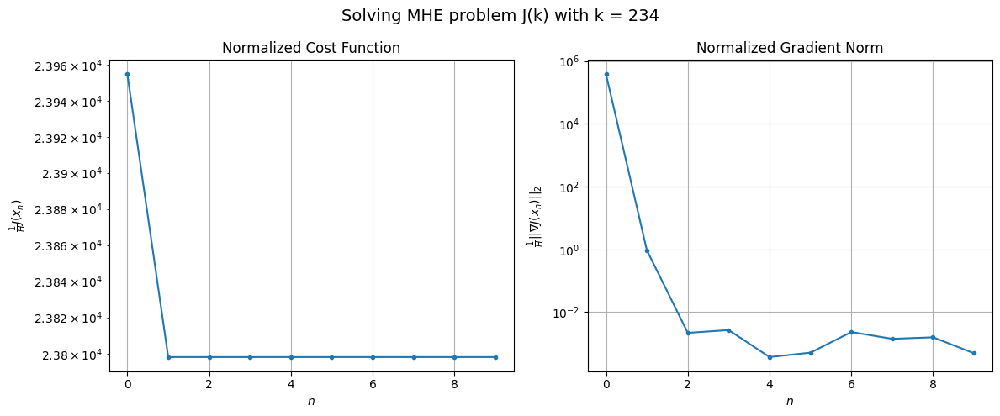

Windows:  54%|█████▍    | 186/346 [31:16<27:56, 10.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1110410.6808962468
Gradient norm: 18816850.467719004
Global estimation error: 84.84434017563615
Initial conditions estimation errors: 39.338453662966074 m, 40.487278841622796 m, 39.307491177550375 m, 49.666129767297335 m
Position estimation errors: 18.780361801296568 m, 18.745628399389034 m, 18.751783616037024 m, 24.021936731199762 m

[Gauss-Newton] Iteration 1
Cost function: 1103866.801465676 (-0.59%)
Gradient norm: 61.46974545142713 (-100.00%)
Global estimation error: 85.8862490405932 (1.23%)
Initial conditions estimation errors: 41.28099935486332 m, 41.167578855027735 m, 41.33472973699908 m, 47.63372749421084 m
Position estimation errors: 16.50145841616152 m, 15.831670968432185 m, 16.176571003875885 m, 19.69610568398823 m

[Gauss-Newton] Iteration 2
Cost function: 1103866.8014892028 (0.00%)
Gradient norm: 0.15045713127530433 (-99.76%)
Global estimation error: 85.8942749134954 (0.01%)
Initial conditions estimation errors: 41

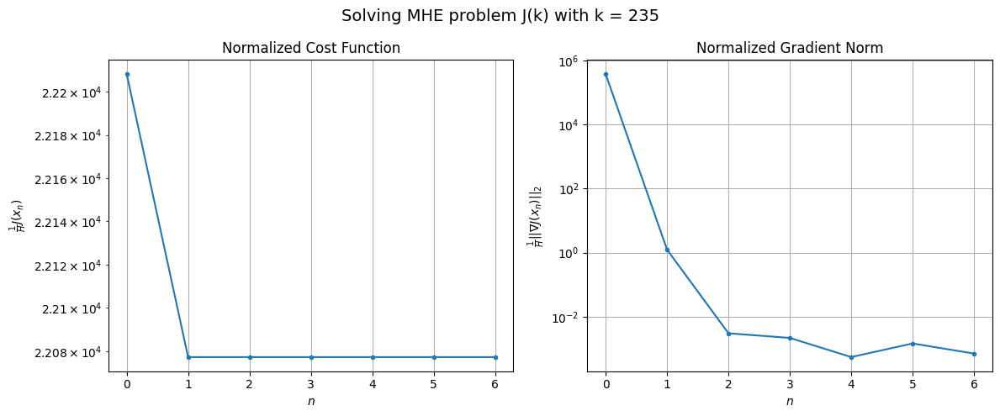

Windows:  54%|█████▍    | 187/346 [31:26<27:06, 10.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1039048.8096923728
Gradient norm: 18744591.19525477
Global estimation error: 76.73487308217821
Initial conditions estimation errors: 36.86385822957947 m, 36.484471786689966 m, 36.923837208122556 m, 42.8344103244282 m
Position estimation errors: 20.199722036338944 m, 19.32258952025746 m, 19.856756394320424 m, 23.553786603511384 m

[Gauss-Newton] Iteration 1
Cost function: 1033535.3664245968 (-0.53%)
Gradient norm: 74.06787635331293 (-100.00%)
Global estimation error: 83.01244178526095 (8.18%)
Initial conditions estimation errors: 38.64618970925174 m, 39.212116692930636 m, 38.53719938774196 m, 48.73200314531836 m
Position estimation errors: 18.47084830363645 m, 18.110391828168375 m, 18.196098419553987 m, 25.880739509311457 m

[Gauss-Newton] Iteration 2
Cost function: 1033535.3664337792 (0.00%)
Gradient norm: 0.049208298471471325 (-99.93%)
Global estimation error: 83.00234177865318 (-0.01%)
Initial conditions estimation errors: 3

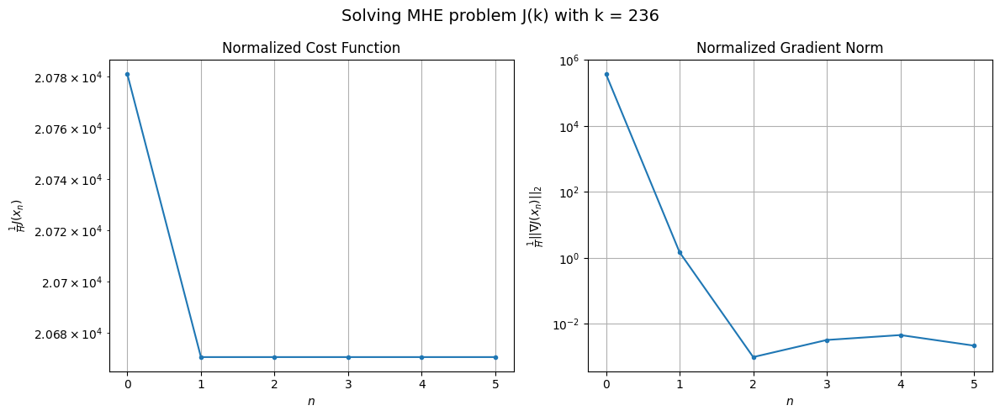

Windows:  54%|█████▍    | 188/346 [31:34<25:03,  9.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 984815.0836407049
Gradient norm: 19084007.014299426
Global estimation error: 74.35993282606543
Initial conditions estimation errors: 34.46805854513601 m, 34.81197718444837 m, 34.36708048746177 m, 44.140237505743194 m
Position estimation errors: 22.648862252431112 m, 22.103768735509973 m, 22.326707129011275 m, 29.98208300002738 m

[Gauss-Newton] Iteration 1
Cost function: 979794.7908706226 (-0.51%)
Gradient norm: 153.91661650926685 (-100.00%)
Global estimation error: 73.67241020978453 (-0.92%)
Initial conditions estimation errors: 36.15630772947222 m, 35.3831791250767 m, 36.09914148717231 m, 39.56266852636854 m
Position estimation errors: 21.18568076185899 m, 20.074503510183426 m, 20.981295845783357 m, 23.64168628225287 m

[Gauss-Newton] Iteration 2
Cost function: 979794.790742276 (-0.00%)
Gradient norm: 0.1382588961003463 (-99.91%)
Global estimation error: 73.70911853269443 (0.05%)
Initial conditions estimation errors: 36.1563

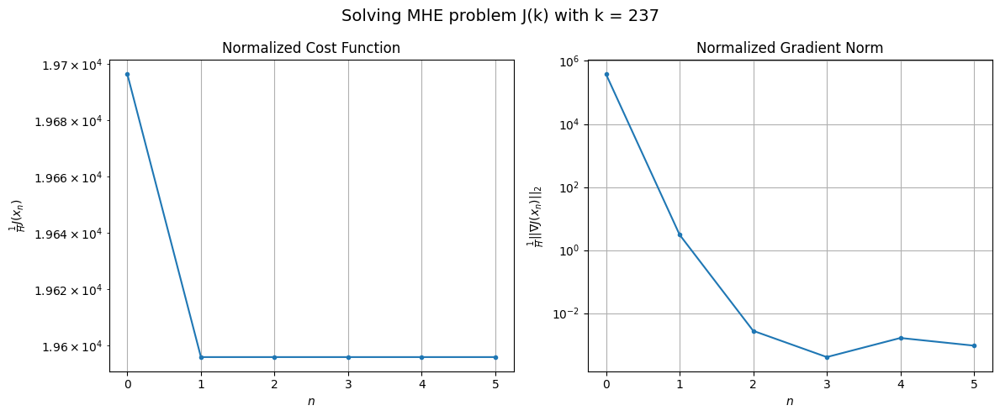

Windows:  55%|█████▍    | 189/346 [31:41<23:15,  8.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 947178.868121852
Gradient norm: 19151093.25235224
Global estimation error: 65.33672937614517
Initial conditions estimation errors: 32.18264257950228 m, 31.168405687280597 m, 32.11569135619176 m, 35.07501171316376 m
Position estimation errors: 25.537649175362667 m, 24.156017133551607 m, 25.28963026007778 m, 27.641718691474953 m

[Gauss-Newton] Iteration 1
Cost function: 942361.0500282918 (-0.51%)
Gradient norm: 38.25219968383397 (-100.00%)
Global estimation error: 67.33644680048529 (3.06%)
Initial conditions estimation errors: 33.85952478231619 m, 32.05964527441647 m, 33.8383968893381 m, 34.85468058201858 m
Position estimation errors: 24.20150844533109 m, 21.98243993836194 m, 23.958678269481556 m, 24.71810301512003 m

[Gauss-Newton] Iteration 2
Cost function: 942361.0500176756 (-0.00%)
Gradient norm: 0.035011259249452475 (-99.91%)
Global estimation error: 67.33824889963849 (0.00%)
Initial conditions estimation errors: 33.859524

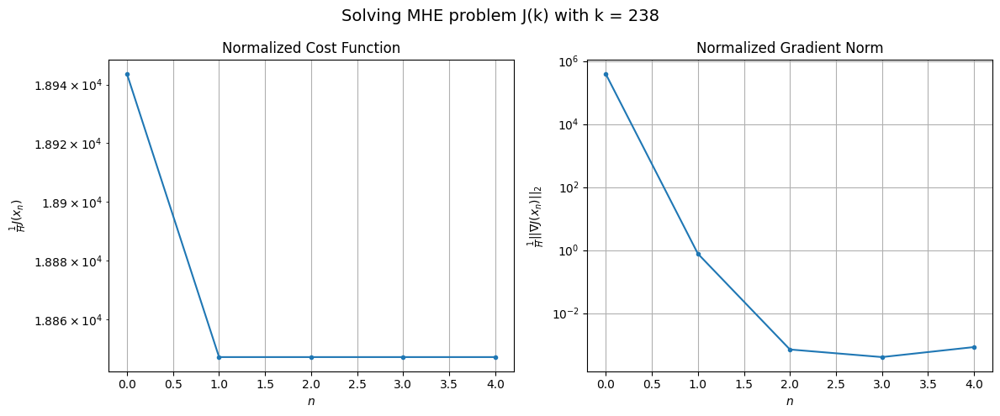

Windows:  55%|█████▍    | 190/346 [31:47<21:06,  8.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 925445.5854198032
Gradient norm: 19075213.37351271
Global estimation error: 59.30068842051033
Initial conditions estimation errors: 30.023089279246584 m, 28.051277986972345 m, 29.98558281765003 m, 30.482026462277172 m
Position estimation errors: 28.548786974041573 m, 26.020477926792612 m, 28.261427422118324 m, 28.555144638950228 m

[Gauss-Newton] Iteration 1
Cost function: 920577.5211117057 (-0.53%)
Gradient norm: 44.89904417923936 (-100.00%)
Global estimation error: 64.08984732179766 (8.08%)
Initial conditions estimation errors: 31.765660815362363 m, 30.863650301399105 m, 31.55941591321938 m, 33.90968298925691 m
Position estimation errors: 27.232061862979457 m, 25.87867028419749 m, 27.02248637058288 m, 29.15925946954329 m

[Gauss-Newton] Iteration 2
Cost function: 920577.5211082945 (-0.00%)
Gradient norm: 0.1823653145309088 (-99.59%)
Global estimation error: 64.09461708485401 (0.01%)
Initial conditions estimation errors: 31.7

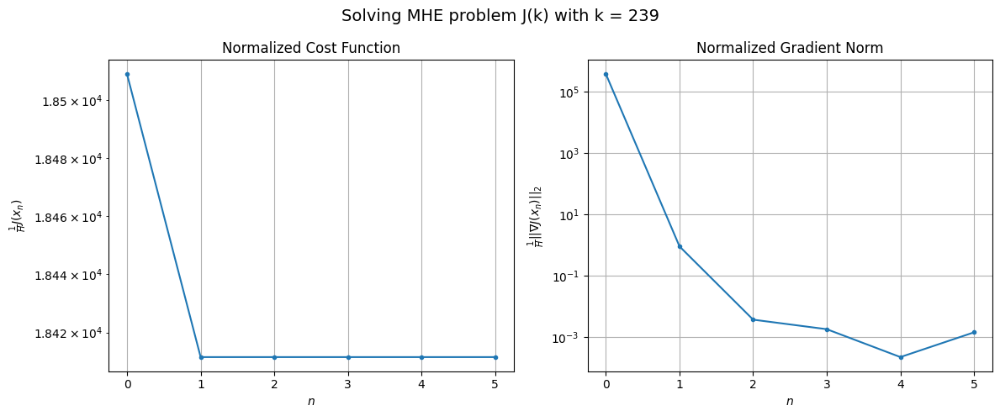

Windows:  55%|█████▌    | 191/346 [31:55<20:35,  7.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 919542.9102393878
Gradient norm: 18955028.256878898
Global estimation error: 56.19878562551871
Initial conditions estimation errors: 27.98832747804953 m, 26.9364051791688 m, 27.783722168024937 m, 29.62142132640992 m
Position estimation errors: 31.524191837523187 m, 29.876485064997993 m, 31.258507101440603 m, 32.95622543000562 m

[Gauss-Newton] Iteration 1
Cost function: 914374.6346310138 (-0.56%)
Gradient norm: 91.82705569439419 (-100.00%)
Global estimation error: 58.082623333753375 (3.35%)
Initial conditions estimation errors: 29.878665658505422 m, 27.878272953881766 m, 30.073621517534797 m, 28.27032281974256 m
Position estimation errors: 30.14981004915223 m, 27.0705851629354 m, 29.965921758187474 m, 27.549599367575276 m

[Gauss-Newton] Iteration 2
Cost function: 914374.6346103835 (-0.00%)
Gradient norm: 0.08835839225545218 (-99.90%)
Global estimation error: 58.08239017195757 (-0.00%)
Initial conditions estimation errors: 29.

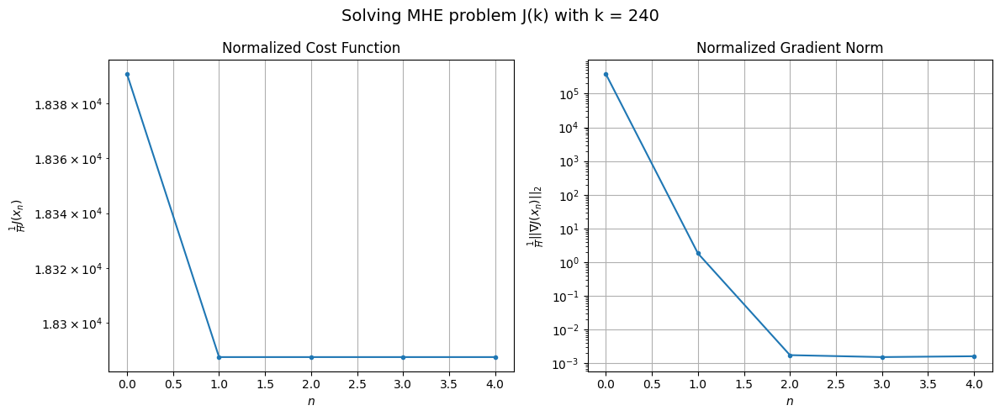

Windows:  55%|█████▌    | 192/346 [32:02<19:45,  7.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 929281.9062216982
Gradient norm: 19150673.56270486
Global estimation error: 50.47335772013318
Initial conditions estimation errors: 26.113283633652394 m, 24.117386770955648 m, 26.272477125791816 m, 24.366781629362883 m
Position estimation errors: 34.41113028536424 m, 31.01801968561365 m, 34.19544689627668 m, 31.283953275444457 m

[Gauss-Newton] Iteration 1
Cost function: 923537.4694870964 (-0.62%)
Gradient norm: 47.88067773246369 (-100.00%)
Global estimation error: 54.0451362943835 (7.08%)
Initial conditions estimation errors: 28.238246199636805 m, 25.851010385121803 m, 28.486620273043705 m, 25.371043674142303 m
Position estimation errors: 32.91837585736853 m, 28.51968825460789 m, 32.72530630517917 m, 27.435046146312004 m

[Gauss-Newton] Iteration 2
Cost function: 923537.4694823737 (-0.00%)
Gradient norm: 0.020139496105616616 (-99.96%)
Global estimation error: 54.04484668558994 (-0.00%)
Initial conditions estimation errors: 28

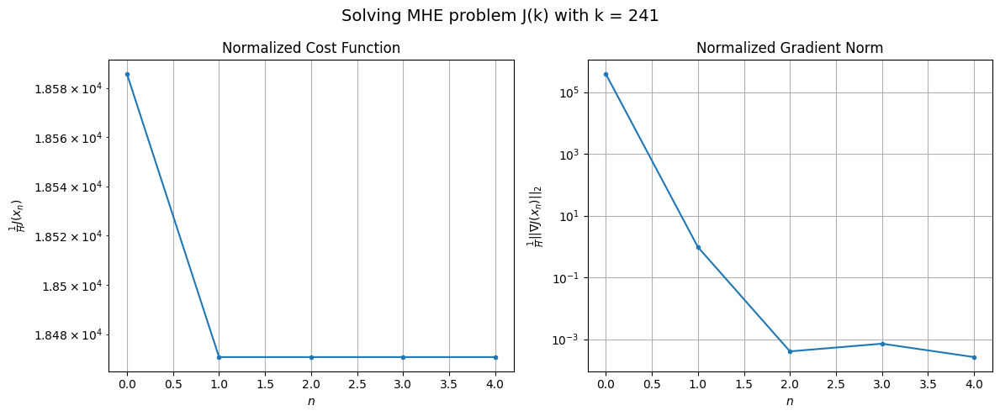

Windows:  56%|█████▌    | 193/346 [32:09<18:45,  7.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 953576.9164147641
Gradient norm: 18894784.65319036
Global estimation error: 46.867929742427656
Initial conditions estimation errors: 24.497154412413973 m, 22.38180627651997 m, 24.688483786891183 m, 22.045402028934912 m
Position estimation errors: 37.19148480198977 m, 32.4794509587007 m, 36.9736740644355 m, 31.180120803948952 m

[Gauss-Newton] Iteration 1
Cost function: 947129.8223900696 (-0.68%)
Gradient norm: 51.39869168094001 (-100.00%)
Global estimation error: 52.25242803658268 (11.49%)
Initial conditions estimation errors: 26.933678548864528 m, 24.783946279817155 m, 27.148007605482334 m, 25.56574566042873 m
Position estimation errors: 35.566197000505696 m, 31.10501530582745 m, 35.43262629727116 m, 31.379774309288123 m

[Gauss-Newton] Iteration 2
Cost function: 947129.8223736932 (-0.00%)
Gradient norm: 0.09672676393204137 (-99.81%)
Global estimation error: 52.251609536480494 (-0.00%)
Initial conditions estimation errors: 26

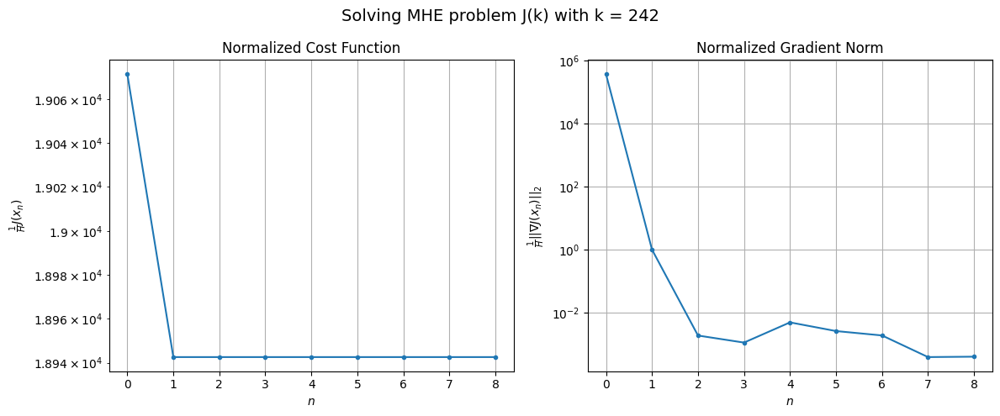

Windows:  56%|█████▌    | 194/346 [32:20<21:42,  8.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 991407.958042723
Gradient norm: 18385881.699820884
Global estimation error: 45.31461968053638
Initial conditions estimation errors: 23.271949392897323 m, 21.60279252649644 m, 23.417729465725387 m, 22.287516739300813 m
Position estimation errors: 39.89724157448911 m, 35.11647749047605 m, 39.745220940825746 m, 35.288369710622185 m

[Gauss-Newton] Iteration 1
Cost function: 984024.1447095089 (-0.74%)
Gradient norm: 55.35324483033502 (-100.00%)
Global estimation error: 51.72598762791996 (14.15%)
Initial conditions estimation errors: 26.112836707553917 m, 25.089159691117015 m, 26.700844248878774 m, 25.519936373900183 m
Position estimation errors: 38.12155139987585 m, 33.4564666295836 m, 38.08420615373717 m, 31.5483329029583 m

[Gauss-Newton] Iteration 2
Cost function: 984024.1446947192 (-0.00%)
Gradient norm: 0.22142932894732784 (-99.60%)
Global estimation error: 51.72614616846337 (0.00%)
Initial conditions estimation errors: 26.11

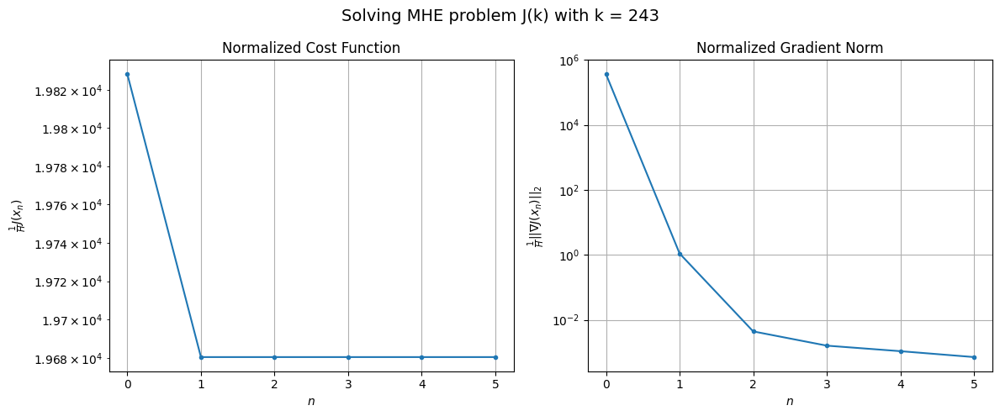

Windows:  56%|█████▋    | 195/346 [32:28<20:52,  8.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1040429.5465512957
Gradient norm: 17992353.507508263
Global estimation error: 45.41114363646407
Initial conditions estimation errors: 22.604944656648474 m, 22.193189587452174 m, 23.054577801213004 m, 22.95885326338037 m
Position estimation errors: 42.55437050302147 m, 37.57397731531181 m, 42.51841794597064 m, 35.54253278880223 m

[Gauss-Newton] Iteration 1
Cost function: 1031943.398319475 (-0.82%)
Gradient norm: 72.36132032954957 (-100.00%)
Global estimation error: 51.86154235357332 (14.20%)
Initial conditions estimation errors: 25.88706813886312 m, 25.796504847549066 m, 26.285026767058916 m, 25.75045849967319 m
Position estimation errors: 40.61427596498939 m, 36.39920808480437 m, 40.541833437962865 m, 35.68193436108609 m

[Gauss-Newton] Iteration 2
Cost function: 1031943.3983042655 (-0.00%)
Gradient norm: 0.010171709103742552 (-99.99%)
Global estimation error: 51.86200205743788 (0.00%)
Initial conditions estimation errors: 25

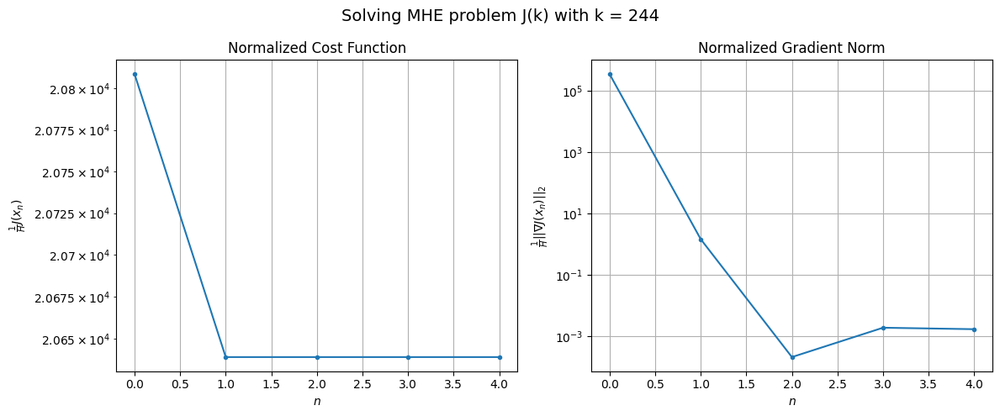

Windows:  57%|█████▋    | 196/346 [32:34<19:27,  7.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1100468.0798254348
Gradient norm: 17126387.296751298
Global estimation error: 46.02561644711917
Initial conditions estimation errors: 22.631415305272967 m, 23.170122202342238 m, 22.90429863342898 m, 23.338506603410774 m
Position estimation errors: 45.17859728883508 m, 40.664747779993185 m, 45.10488461216374 m, 39.67454208034145 m

[Gauss-Newton] Iteration 1
Cost function: 1090764.715501905 (-0.88%)
Gradient norm: 61.9447072065747 (-100.00%)
Global estimation error: 54.44982510353128 (18.30%)
Initial conditions estimation errors: 26.332759202340238 m, 27.121730803157604 m, 27.154570828005216 m, 28.255588378507323 m
Position estimation errors: 43.061077293750394 m, 37.838763025924095 m, 43.264374890787025 m, 35.274145356392964 m

[Gauss-Newton] Iteration 2
Cost function: 1090764.7155288511 (0.00%)
Gradient norm: 0.05948612367025375 (-99.90%)
Global estimation error: 54.449556747740274 (-0.00%)
Initial conditions estimation error

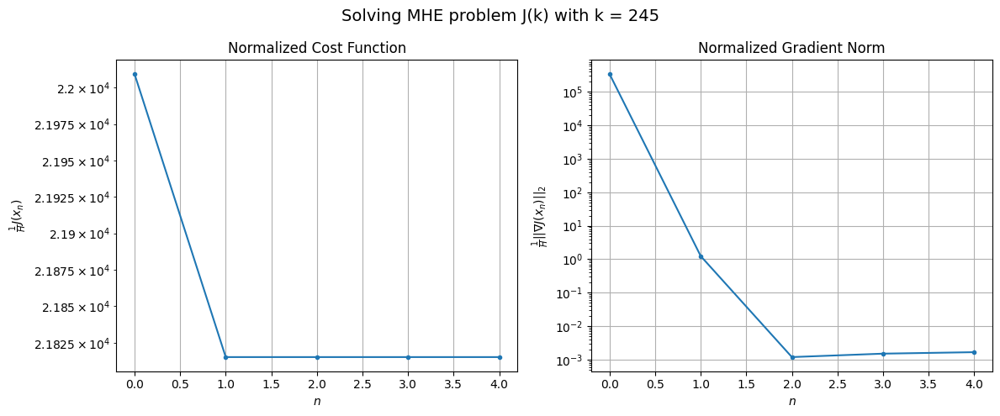

Windows:  57%|█████▋    | 197/346 [32:41<18:50,  7.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1170351.531528626
Gradient norm: 16283908.851036292
Global estimation error: 49.67265262291364
Initial conditions estimation errors: 23.427713045216898 m, 25.081386470224633 m, 23.980625504986854 m, 26.727115477931413 m
Position estimation errors: 47.76032490678055 m, 42.21693620205055 m, 47.99370932636034 m, 39.38457337151954 m

[Gauss-Newton] Iteration 1
Cost function: 1159292.9420023717 (-0.94%)
Gradient norm: 68.89376673775722 (-100.00%)
Global estimation error: 58.174665044277695 (17.12%)
Initial conditions estimation errors: 27.48208364663516 m, 29.306840925251638 m, 28.18057159419889 m, 31.240335188959804 m
Position estimation errors: 45.44672690672615 m, 40.43094963999864 m, 45.706860602071416 m, 36.2856429323337 m

[Gauss-Newton] Iteration 2
Cost function: 1159292.942015784 (0.00%)
Gradient norm: 0.0570767696424972 (-99.92%)
Global estimation error: 58.1740871924931 (-0.00%)
Initial conditions estimation errors: 27.48

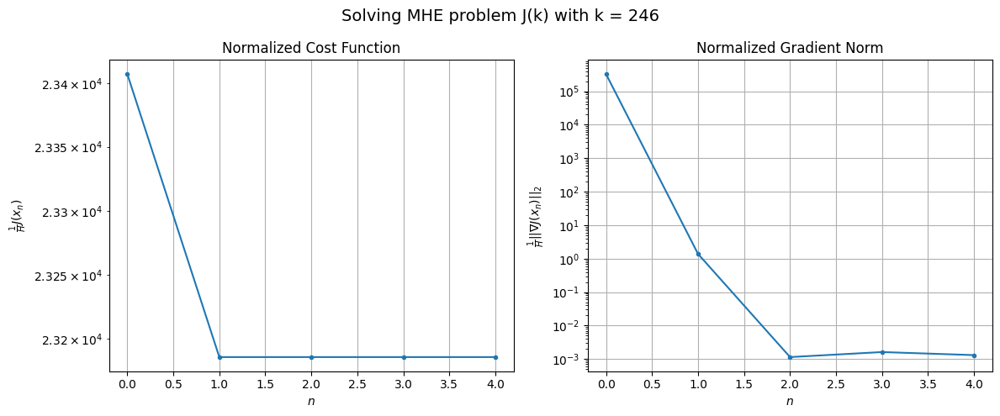

Windows:  57%|█████▋    | 198/346 [32:48<18:08,  7.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1246992.7874530978
Gradient norm: 15033811.557047026
Global estimation error: 54.1850427202649
Initial conditions estimation errors: 24.949893641341124 m, 27.522742306828825 m, 25.344205866989633 m, 30.22682472548067 m
Position estimation errors: 50.25569451372072 m, 44.92684893731405 m, 50.549571692263214 m, 40.488386092030346 m

[Gauss-Newton] Iteration 1
Cost function: 1234421.9553186148 (-1.01%)
Gradient norm: 74.73490663176716 (-100.00%)
Global estimation error: 62.219101387509404 (14.83%)
Initial conditions estimation errors: 29.310278802711263 m, 31.80106675446585 m, 29.501055395860444 m, 33.622474728194554 m
Position estimation errors: 47.75317450711517 m, 42.32964634209089 m, 47.628459492519184 m, 39.43696775741661 m

[Gauss-Newton] Iteration 2
Cost function: 1234421.9553243062 (0.00%)
Gradient norm: 0.04240752237513302 (-99.94%)
Global estimation error: 62.220190544967465 (0.00%)
Initial conditions estimation errors:

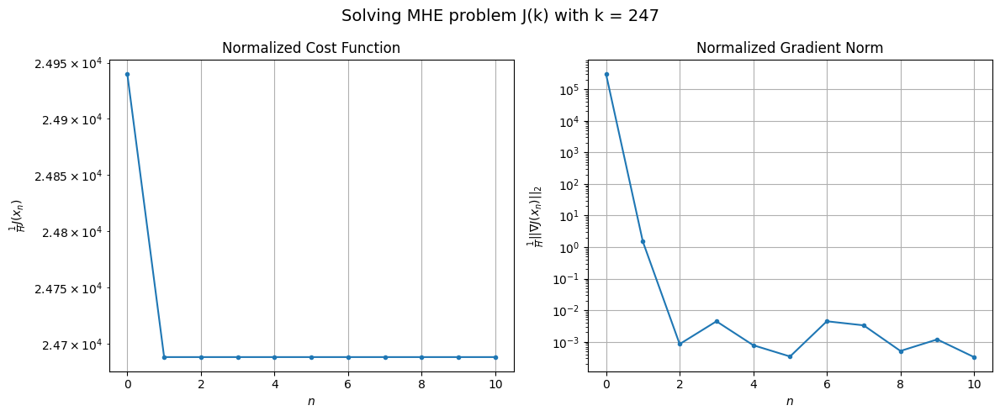

Windows:  58%|█████▊    | 199/346 [33:02<22:57,  9.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1329213.7003653196
Gradient norm: 13991219.618349805
Global estimation error: 58.702174620762804
Initial conditions estimation errors: 27.059938519942076 m, 30.311439971025155 m, 27.11047176837323 m, 32.556289486568566 m
Position estimation errors: 52.63277970881086 m, 46.96769188863698 m, 52.51816387891093 m, 43.89199652524479 m

[Gauss-Newton] Iteration 1
Cost function: 1314946.1923407014 (-1.07%)
Gradient norm: 80.30365621558607 (-100.00%)
Global estimation error: 67.39616039556427 (14.81%)
Initial conditions estimation errors: 31.63105875786694 m, 34.37572453830652 m, 31.75520155885937 m, 36.76411527796438 m
Position estimation errors: 49.907778596779714 m, 45.31959842911164 m, 49.51043188233425 m, 41.71667301643545 m

[Gauss-Newton] Iteration 2
Cost function: 1314946.1923399374 (-0.00%)
Gradient norm: 0.023756630396062628 (-99.97%)
Global estimation error: 67.39687314256994 (0.00%)
Initial conditions estimation errors: 31

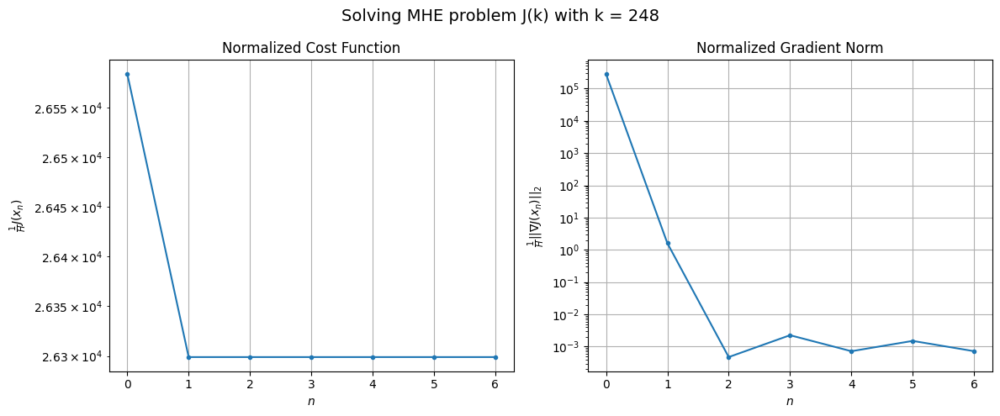

Windows:  58%|█████▊    | 200/346 [33:11<22:45,  9.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1414632.6159095932
Gradient norm: 12433217.514963312
Global estimation error: 64.03639447624198
Initial conditions estimation errors: 29.56559013688646 m, 32.85222372578415 m, 29.654150294014386 m, 35.607087673146076 m
Position estimation errors: 54.81486173485436 m, 50.03173946770691 m, 54.41386640136661 m, 46.40035900556014 m

[Gauss-Newton] Iteration 1
Cost function: 1398651.4536641333 (-1.13%)
Gradient norm: 128.95504875676582 (-100.00%)
Global estimation error: 73.67945685134029 (15.06%)
Initial conditions estimation errors: 34.293370227992654 m, 37.307196924825305 m, 34.05272339856648 m, 41.24529348171423 m
Position estimation errors: 51.88894474829088 m, 46.979211153461776 m, 52.58786551756803 m, 41.045970345532865 m

[Gauss-Newton] Iteration 2
Cost function: 1398651.4536307575 (-0.00%)
Gradient norm: 0.07485718561016638 (-99.94%)
Global estimation error: 73.68037890902033 (0.00%)
Initial conditions estimation errors: 3

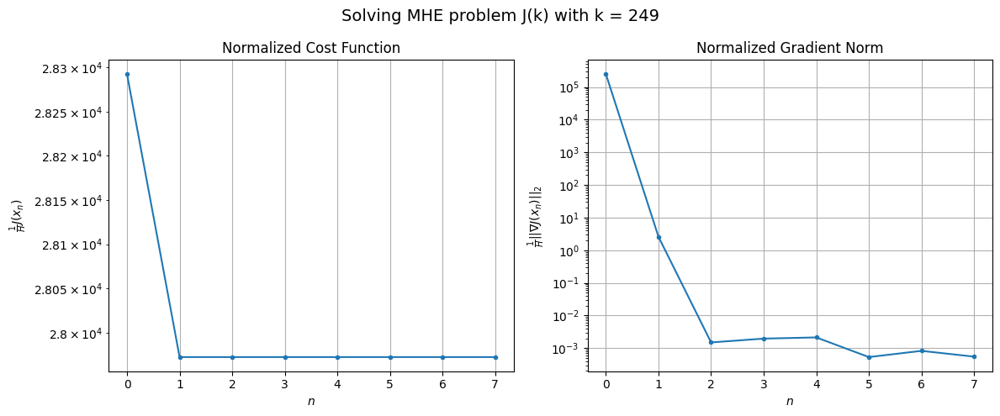

Windows:  58%|█████▊    | 201/346 [33:22<23:21,  9.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1500675.3912218888
Gradient norm: 10521515.985380275
Global estimation error: 70.8628778698632
Initial conditions estimation errors: 32.366612390643155 m, 36.016441840653194 m, 31.843978054426696 m, 40.77612027815002 m
Position estimation errors: 56.78667803626924 m, 51.58236506751874 m, 57.525261044174364 m, 45.32762673032949 m

[Gauss-Newton] Iteration 1
Cost function: 1483038.6067331037 (-1.18%)
Gradient norm: 97.53325084206934 (-100.00%)
Global estimation error: 78.9687730692234 (11.44%)
Initial conditions estimation errors: 37.17654886955208 m, 40.471878404110754 m, 36.91370571658413 m, 43.050419979121536 m
Position estimation errors: 53.65710940389886 m, 48.879644803046595 m, 53.84613218127253 m, 45.25513308122896 m

[Gauss-Newton] Iteration 2
Cost function: 1483038.6067310737 (-0.00%)
Gradient norm: 0.01769403479500602 (-99.98%)
Global estimation error: 78.96922034909052 (0.00%)
Initial conditions estimation errors: 37.

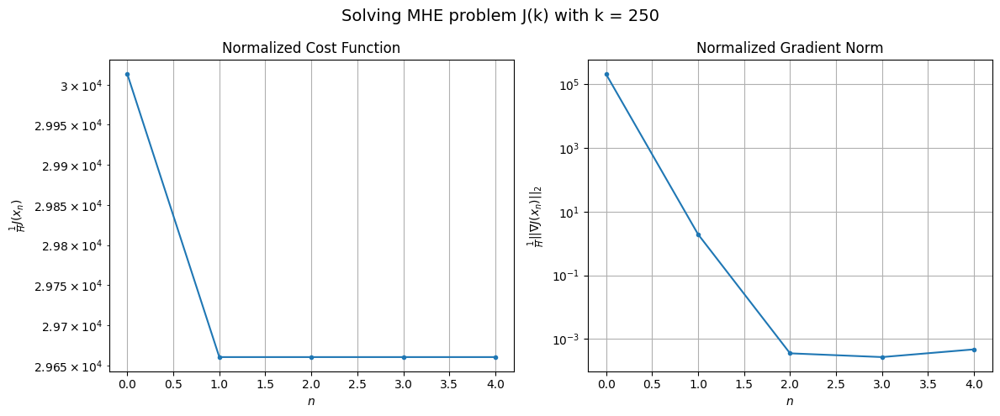

Windows:  58%|█████▊    | 202/346 [33:29<21:02,  8.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1585903.755721567
Gradient norm: 8771037.38490385
Global estimation error: 76.09644526523518
Initial conditions estimation errors: 35.38616502461457 m, 39.19027076958676 m, 35.02910039454822 m, 42.13715972993129 m
Position estimation errors: 58.51688319587043 m, 53.54277732067246 m, 58.71302097370178 m, 49.81302548423882 m

[Gauss-Newton] Iteration 1
Cost function: 1566379.8235633872 (-1.23%)
Gradient norm: 104.35795195702187 (-100.00%)
Global estimation error: 86.29439976527424 (13.40%)
Initial conditions estimation errors: 40.28591995150585 m, 44.20047930425573 m, 39.88160681027358 m, 47.744177866279074 m
Position estimation errors: 55.17615891435514 m, 49.91422358892064 m, 55.62945714783042 m, 45.0877521921142 m

[Gauss-Newton] Iteration 2
Cost function: 1566379.8235591508 (-0.00%)
Gradient norm: 0.09925704335113367 (-99.90%)
Global estimation error: 86.29481233327283 (0.00%)
Initial conditions estimation errors: 40.2859145

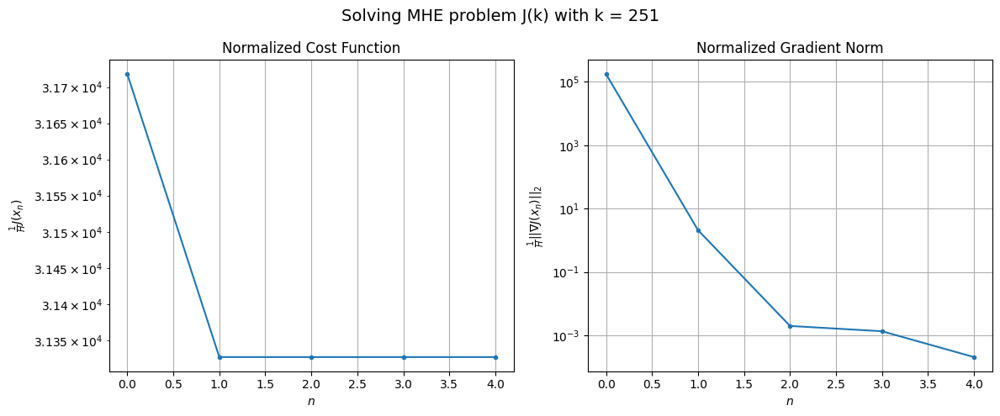

Windows:  59%|█████▊    | 203/346 [33:35<19:26,  8.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1663881.8407221457
Gradient norm: 6271798.450425324
Global estimation error: 83.66578819531952
Initial conditions estimation errors: 38.584290351158856 m, 42.9940073032284 m, 38.042224363390886 m, 47.068999909534504 m
Position estimation errors: 59.97682356143579 m, 54.50675723558144 m, 60.44192496050511 m, 49.46360979482048 m

[Gauss-Newton] Iteration 1
Cost function: 1642817.3513099477 (-1.27%)
Gradient norm: 143.81539258515784 (-100.00%)
Global estimation error: 90.61733546169657 (8.31%)
Initial conditions estimation errors: 43.51417988289472 m, 46.66604048948832 m, 43.51572292687727 m, 47.3988041458706 m
Position estimation errors: 56.453674235871915 m, 52.4211762615366 m, 56.234583843905405 m, 51.602672552687274 m

[Gauss-Newton] Iteration 2
Cost function: 1642817.3512511346 (-0.00%)
Gradient norm: 0.050770422743210246 (-99.96%)
Global estimation error: 90.61818044565474 (0.00%)
Initial conditions estimation errors: 43.51

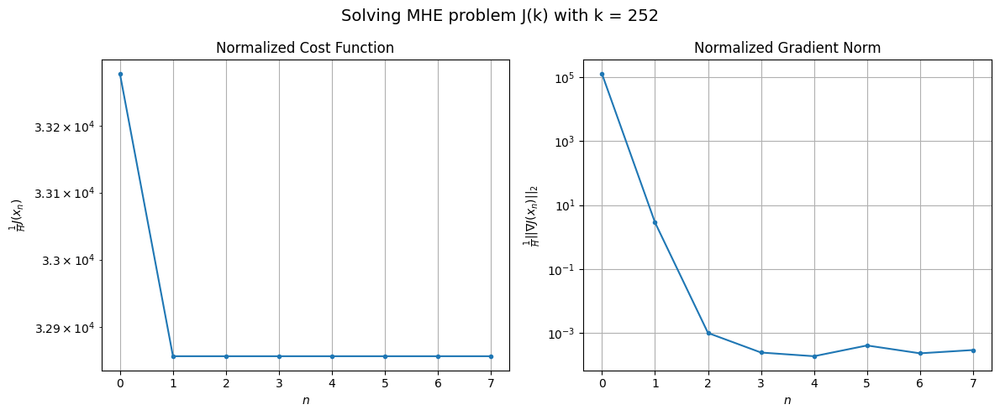

Windows:  59%|█████▉    | 204/346 [33:46<20:47,  8.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1735592.7022940193
Gradient norm: 3432382.207578982
Global estimation error: 87.46362479069138
Initial conditions estimation errors: 41.799976883260165 m, 45.27136906661233 m, 41.79358280557225 m, 45.8957410894348 m
Position estimation errors: 61.17578548195216 m, 57.025077579534724 m, 60.942026452236995 m, 56.34538518540762 m

[Gauss-Newton] Iteration 1
Cost function: 1712831.210388057 (-1.31%)
Gradient norm: 334.4474290784747 (-99.99%)
Global estimation error: 94.61310875136927 (8.17%)
Initial conditions estimation errors: 46.77095688559741 m, 49.16331684516976 m, 48.635846386958406 m, 44.515270273603946 m
Position estimation errors: 57.45530365977357 m, 54.77611522882364 m, 55.111572435909146 m, 61.12839039682191 m

[Gauss-Newton] Iteration 2
Cost function: 1712831.2101435342 (-0.00%)
Gradient norm: 0.27636894330086414 (-99.92%)
Global estimation error: 94.61141360684996 (-0.00%)
Initial conditions estimation errors: 46.770

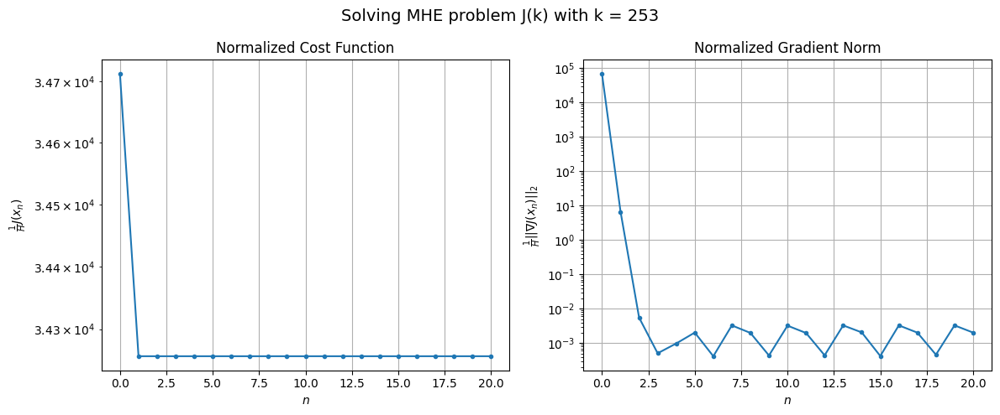

Windows:  59%|█████▉    | 205/346 [34:12<32:49, 13.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1795026.135671923
Gradient norm: 760685.703258401
Global estimation error: 90.58820052031058
Initial conditions estimation errors: 44.90820706588771 m, 47.36892898538984 m, 46.953059774467924 m, 41.725792527373116 m
Position estimation errors: 62.09014913732734 m, 59.493565672040035 m, 59.74371040644055 m, 66.38724483536316 m

[Gauss-Newton] Iteration 1
Cost function: 1770578.3210828176 (-1.36%)
Gradient norm: 122.67067677136095 (-99.98%)
Global estimation error: 100.45044987874262 (10.89%)
Initial conditions estimation errors: 49.92746345180318 m, 52.3387698358949 m, 52.09145904218379 m, 46.310290552695925 m
Position estimation errors: 58.18356933205942 m, 55.776483535380336 m, 55.645183167818736 m, 63.463647216939776 m

[Gauss-Newton] Iteration 2
Cost function: 1770578.321083798 (0.00%)
Gradient norm: 0.09965156302563301 (-99.92%)
Global estimation error: 100.45051342038899 (0.00%)
Initial conditions estimation errors: 49.92

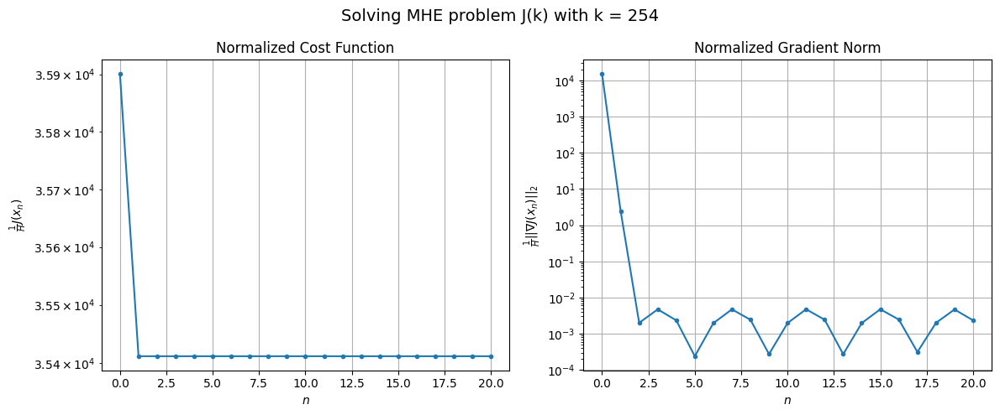

Windows:  60%|█████▉    | 206/346 [34:38<41:13, 17.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1842169.4612034096
Gradient norm: 2585739.434206869
Global estimation error: 95.72071138226562
Initial conditions estimation errors: 47.7756926705135 m, 50.15165592147619 m, 50.10071091150348 m, 43.06550874304747 m
Position estimation errors: 62.752896306518984 m, 60.46646776300086 m, 60.249308609055646 m, 68.72604303129962 m

[Gauss-Newton] Iteration 1
Cost function: 1816283.2847368862 (-1.41%)
Gradient norm: 144.90106344376184 (-99.99%)
Global estimation error: 107.6898979052512 (12.50%)
Initial conditions estimation errors: 52.80679535659488 m, 55.51997653835411 m, 55.458520506200294 m, 51.48210945728233 m
Position estimation errors: 58.66698474870344 m, 56.08073532268579 m, 55.78620186465378 m, 62.22916710081109 m

[Gauss-Newton] Iteration 2
Cost function: 1816283.284735145 (-0.00%)
Gradient norm: 0.27292137627046936 (-99.81%)
Global estimation error: 107.69119445121225 (0.00%)
Initial conditions estimation errors: 52.8067

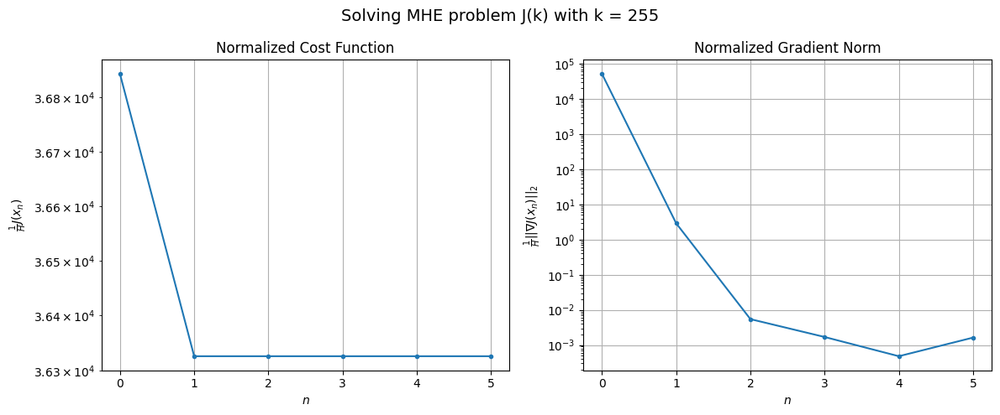

Windows:  60%|█████▉    | 207/346 [34:46<34:30, 14.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1876816.2315404376
Gradient norm: 5660963.186916129
Global estimation error: 101.96242990464403
Initial conditions estimation errors: 50.25786108749108 m, 52.88163310736642 m, 53.0576973004547 m, 47.527515046114615 m
Position estimation errors: 63.22084392876893 m, 60.83237417640483 m, 60.42226401880162 m, 67.72467883320809 m

[Gauss-Newton] Iteration 1
Cost function: 1849421.4693821564 (-1.46%)
Gradient norm: 400.8680715096387 (-99.99%)
Global estimation error: 114.30623092562031 (12.11%)
Initial conditions estimation errors: 55.298472063813236 m, 58.90515317104016 m, 56.2637323918638 m, 58.0735218317753 m
Position estimation errors: 58.93782944796785 m, 55.089004122327516 m, 57.720377674461034 m, 56.285646972098 m

[Gauss-Newton] Iteration 2
Cost function: 1849421.4691404072 (-0.00%)
Gradient norm: 0.07771188690928132 (-99.98%)
Global estimation error: 114.30778395665091 (0.00%)
Initial conditions estimation errors: 55.29846

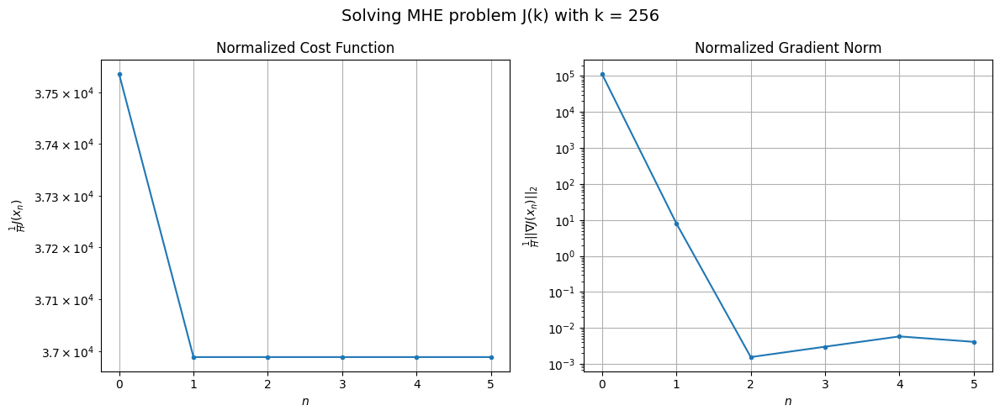

Windows:  60%|██████    | 208/346 [34:55<29:41, 12.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1897063.1563558166
Gradient norm: 8887703.404111905
Global estimation error: 108.2567174269483
Initial conditions estimation errors: 52.29026305971082 m, 55.99926265375894 m, 53.328241997589764 m, 54.821455182076505 m
Position estimation errors: 63.52175422795572 m, 59.75316625140165 m, 62.353430624571295 m, 61.176131942933296 m

[Gauss-Newton] Iteration 1
Cost function: 1868623.9607350517 (-1.50%)
Gradient norm: 126.79700658016927 (-100.00%)
Global estimation error: 117.92501730700658 (8.93%)
Initial conditions estimation errors: 57.290904190264826 m, 61.29775866983455 m, 58.06290349776181 m, 59.12113603925652 m
Position estimation errors: 59.060744519610985 m, 54.96509008949391 m, 58.05155781428258 m, 57.531034144654 m

[Gauss-Newton] Iteration 2
Cost function: 1868623.9607251144 (-0.00%)
Gradient norm: 0.02670288714449524 (-99.98%)
Global estimation error: 117.9244042330217 (-0.00%)
Initial conditions estimation errors: 57.

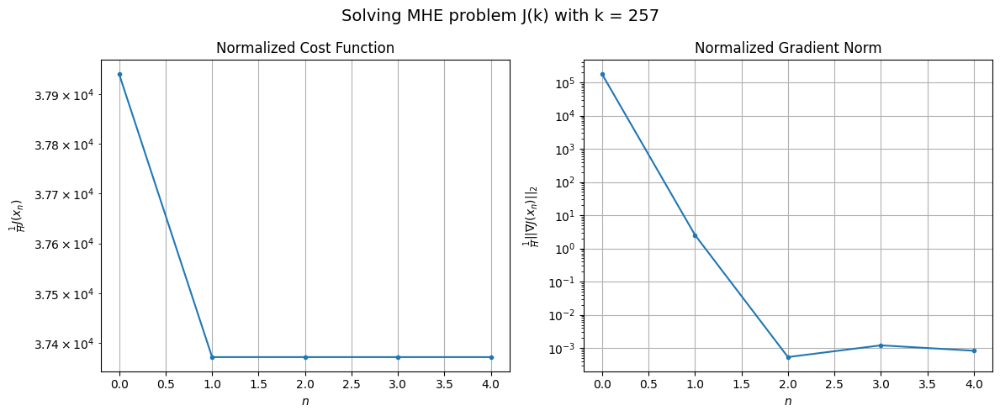

Windows:  60%|██████    | 209/346 [35:02<25:32, 11.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1905998.9347279635
Gradient norm: 11645613.755028866
Global estimation error: 110.85578699006581
Initial conditions estimation errors: 53.8156366246682 m, 57.873751979742764 m, 54.67352484633397 m, 55.26554987937487 m
Position estimation errors: 63.67621271585887 m, 59.7274705301003 m, 62.7296049868991 m, 62.55781963446617 m

[Gauss-Newton] Iteration 1
Cost function: 1876582.3788681964 (-1.54%)
Gradient norm: 133.57122689530124 (-100.00%)
Global estimation error: 120.60749683929747 (8.80%)
Initial conditions estimation errors: 58.77367789964364 m, 63.70941498810969 m, 58.5246415635593 m, 60.06464145802667 m
Position estimation errors: 59.02976010551643 m, 54.22914755676699 m, 58.92850845345342 m, 58.06637130953932 m

[Gauss-Newton] Iteration 2
Cost function: 1876582.3788701554 (0.00%)
Gradient norm: 0.03257522901979664 (-99.98%)
Global estimation error: 120.60725491612374 (-0.00%)
Initial conditions estimation errors: 58.77367

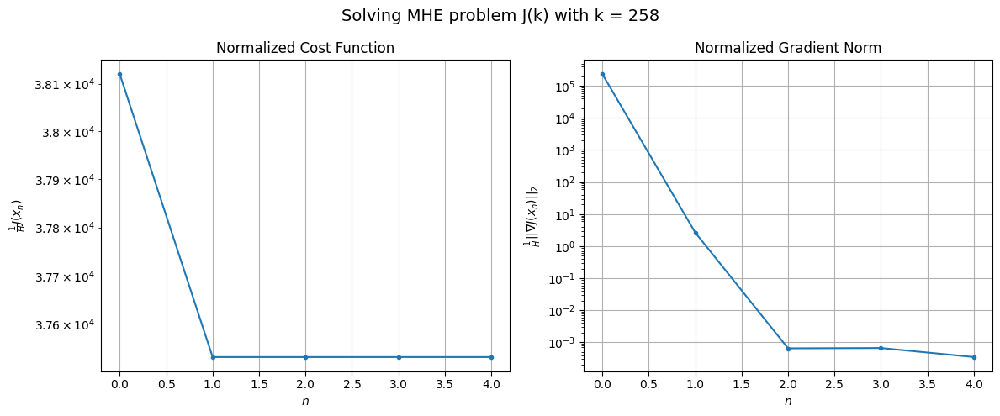

Windows:  61%|██████    | 210/346 [35:09<22:33,  9.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1904944.5256996294
Gradient norm: 14467886.610598907
Global estimation error: 112.6193558643686
Initial conditions estimation errors: 54.862806071203885 m, 59.77371332018816 m, 54.72352146088492 m, 55.72785885028828 m
Position estimation errors: 63.630761062643835 m, 59.06685738647392 m, 63.554391663212115 m, 63.06633274101469 m

[Gauss-Newton] Iteration 1
Cost function: 1874839.4797194835 (-1.58%)
Gradient norm: 190.19138372641643 (-100.00%)
Global estimation error: 126.0054553766572 (11.89%)
Initial conditions estimation errors: 59.756436141375566 m, 65.21558394915706 m, 59.466966540672665 m, 67.2094618849227 m
Position estimation errors: 58.80557985133117 m, 53.51695280552093 m, 58.77536934541493 m, 52.10553614643963 m

[Gauss-Newton] Iteration 2
Cost function: 1874839.479692991 (-0.00%)
Gradient norm: 0.0673264541775609 (-99.96%)
Global estimation error: 126.00228057851615 (-0.00%)
Initial conditions estimation errors: 59.

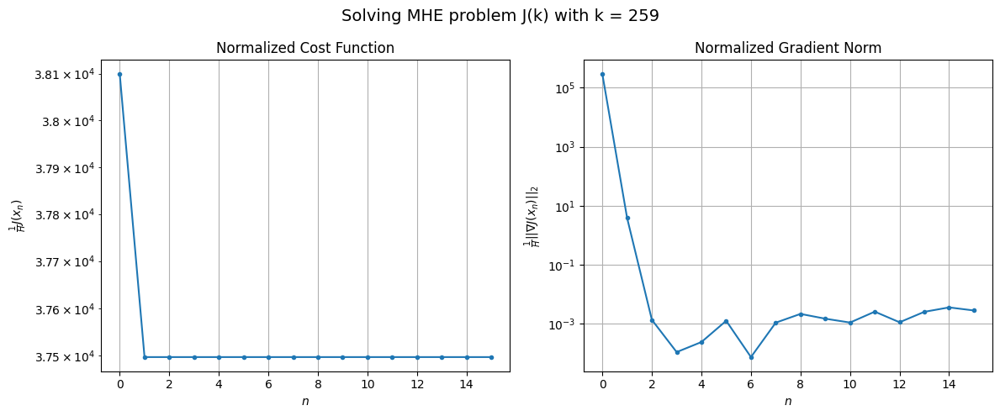

Windows:  61%|██████    | 211/346 [35:28<28:45, 12.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1896205.6872006992
Gradient norm: 16493225.739378855
Global estimation error: 117.2891869038066
Initial conditions estimation errors: 55.462442405208805 m, 60.92979305653302 m, 55.231462809188415 m, 62.591371863212345 m
Position estimation errors: 63.31824627830213 m, 58.21225885999612 m, 63.26027727274985 m, 57.088031994404155 m

[Gauss-Newton] Iteration 1
Cost function: 1865723.5744080532 (-1.61%)
Gradient norm: 114.09812171972932 (-100.00%)
Global estimation error: 126.41565516125729 (7.78%)
Initial conditions estimation errors: 60.28214702930119 m, 65.33921770128967 m, 59.73834314443666 m, 67.14953322311982 m
Position estimation errors: 58.336721241471594 m, 53.38417471221967 m, 58.48690532958587 m, 52.13921319312363 m

[Gauss-Newton] Iteration 2
Cost function: 1865723.5744117703 (0.00%)
Gradient norm: 0.24048154435686 (-99.79%)
Global estimation error: 126.41609698081642 (0.00%)
Initial conditions estimation errors: 60.28

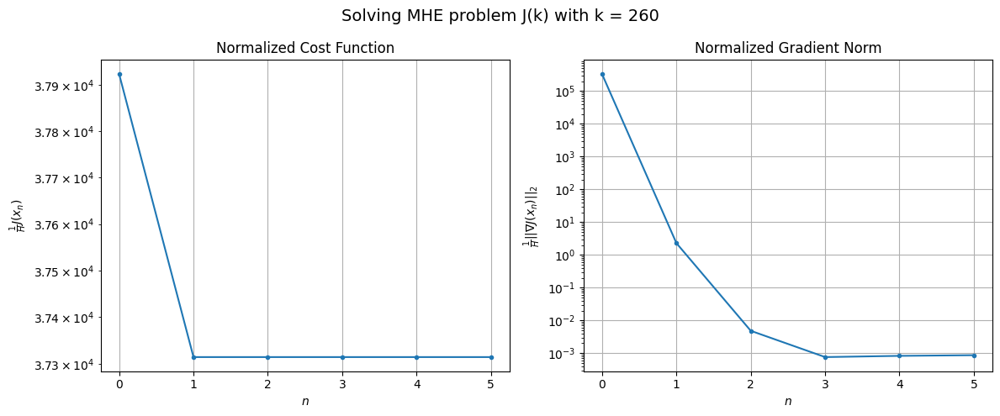

Windows:  61%|██████▏   | 212/346 [35:37<25:33, 11.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1880491.5601773679
Gradient norm: 17999227.8345304
Global estimation error: 117.1486312002482
Initial conditions estimation errors: 55.66744619768724 m, 60.76815238128112 m, 55.18559651114466 m, 62.343266125804846 m
Position estimation errors: 62.69150540035963 m, 57.86976991954971 m, 62.77949721499931 m, 56.882856380701966 m

[Gauss-Newton] Iteration 1
Cost function: 1850073.9376475653 (-1.62%)
Gradient norm: 108.31410626199877 (-100.00%)
Global estimation error: 127.08956045348123 (8.49%)
Initial conditions estimation errors: 60.40336467628553 m, 64.78508206439162 m, 60.09101111001906 m, 68.52092441420754 m
Position estimation errors: 57.604899050091596 m, 53.282820108618154 m, 57.564964477786084 m, 50.21361062433166 m

[Gauss-Newton] Iteration 2
Cost function: 1850073.9376533683 (0.00%)
Gradient norm: 0.35518829165440613 (-99.67%)
Global estimation error: 127.08990121479818 (0.00%)
Initial conditions estimation errors: 60.4

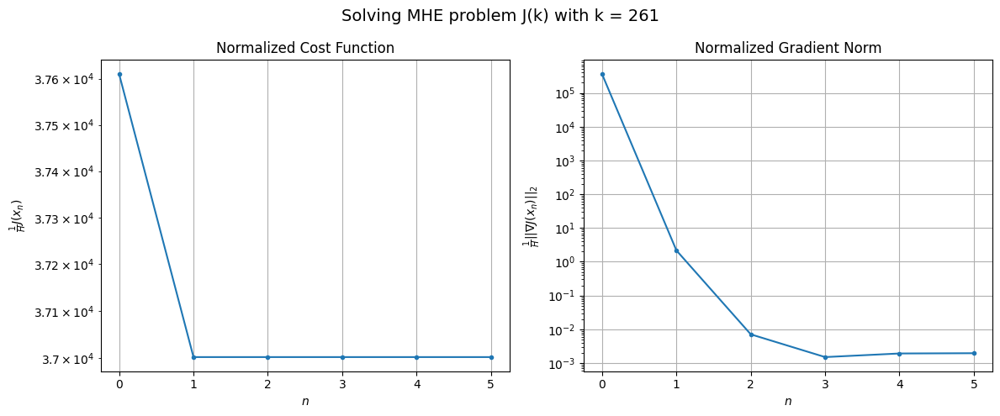

Windows:  62%|██████▏   | 213/346 [35:45<23:02, 10.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1858778.4002779464
Gradient norm: 18739016.934899155
Global estimation error: 117.45425819307897
Initial conditions estimation errors: 55.53525503769587 m, 59.95132456687253 m, 55.25845787011849 m, 63.746725925538435 m
Position estimation errors: 61.75487459073657 m, 57.460723868878055 m, 61.63565811911746 m, 54.57829389623865 m

[Gauss-Newton] Iteration 1
Cost function: 1828515.8907784272 (-1.63%)
Gradient norm: 160.30811514732676 (-100.00%)
Global estimation error: 126.82374465845764 (7.98%)
Initial conditions estimation errors: 60.203047852307826 m, 64.67264276961924 m, 60.20913925650536 m, 68.20652330201398 m
Position estimation errors: 56.5907094348362 m, 52.14429302516916 m, 56.24448912778677 m, 49.0787271401973 m

[Gauss-Newton] Iteration 2
Cost function: 1828515.8907588427 (-0.00%)
Gradient norm: 0.07673319192177595 (-99.95%)
Global estimation error: 126.8258384712545 (0.00%)
Initial conditions estimation errors: 60.20

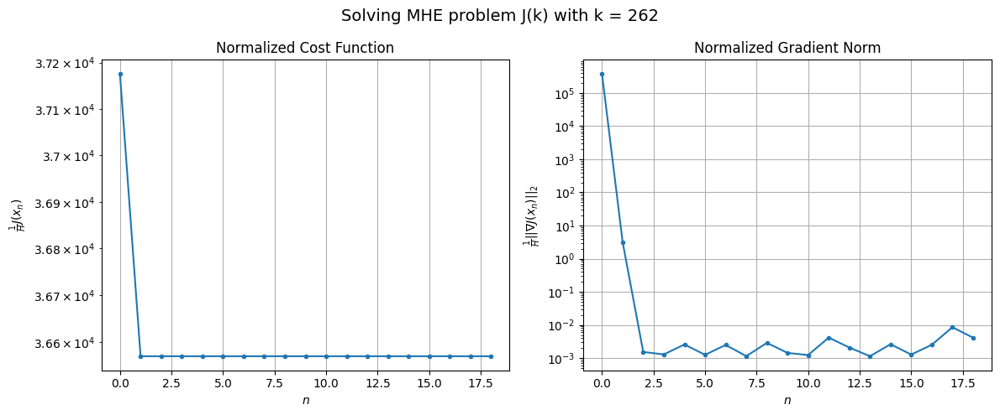

Windows:  62%|██████▏   | 214/346 [36:08<31:35, 14.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1829960.3083018519
Gradient norm: 18853945.87421722
Global estimation error: 117.07284343661318
Initial conditions estimation errors: 55.155424969984445 m, 59.677721233802075 m, 55.17582934043306 m, 63.70317629480268 m
Position estimation errors: 60.512467700270136 m, 56.05683853320257 m, 60.07448798165139 m, 52.85879243598663 m

[Gauss-Newton] Iteration 1
Cost function: 1800347.1748157274 (-1.62%)
Gradient norm: 103.96750500769753 (-100.00%)
Global estimation error: 126.89202476047478 (8.39%)
Initial conditions estimation errors: 59.74190304827689 m, 64.75158663335954 m, 59.36561416480875 m, 69.3931816278637 m
Position estimation errors: 55.345348166486886 m, 50.54165794152905 m, 55.318777018064644 m, 46.816328841955794 m

[Gauss-Newton] Iteration 2
Cost function: 1800347.1747823367 (-0.00%)
Gradient norm: 0.06660915957739039 (-99.94%)
Global estimation error: 126.89194431172427 (-0.00%)
Initial conditions estimation errors: 

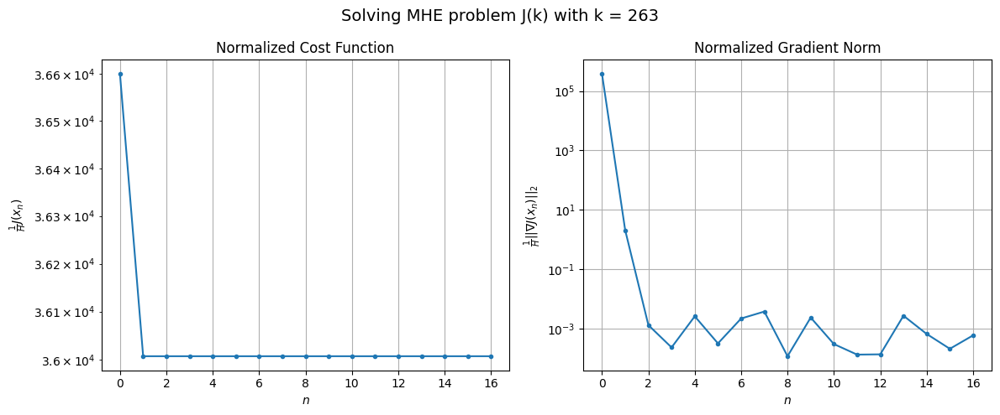

Windows:  62%|██████▏   | 215/346 [36:29<35:50, 16.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1794857.3462815278
Gradient norm: 18161547.34613141
Global estimation error: 116.88948714097398
Initial conditions estimation errors: 54.59214421479209 m, 59.62615206057774 m, 54.25569784460884 m, 64.6827620849779 m
Position estimation errors: 59.03299995614572 m, 54.28029104993819 m, 58.9246507835244 m, 50.46424068983364 m

[Gauss-Newton] Iteration 1
Cost function: 1766102.6729539328 (-1.60%)
Gradient norm: 373.80004986134384 (-100.00%)
Global estimation error: 123.34196555437524 (5.52%)
Initial conditions estimation errors: 59.103383629711345 m, 62.756932408595425 m, 58.44852037290043 m, 66.07067079555462 m
Position estimation errors: 53.91762968775093 m, 50.5777745025383 m, 54.253067437083445 m, 48.30815726851895 m

[Gauss-Newton] Iteration 2
Cost function: 1766102.6727848845 (-0.00%)
Gradient norm: 0.024864742786699034 (-99.99%)
Global estimation error: 123.3508761844934 (0.01%)
Initial conditions estimation errors: 59.103

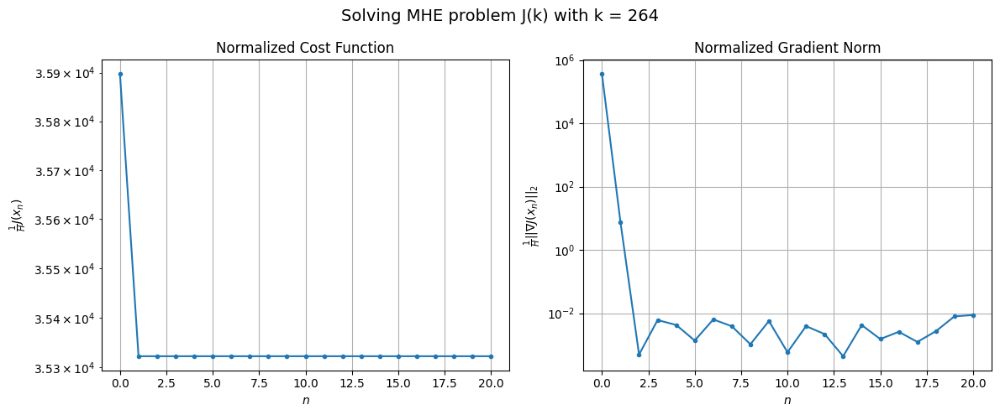

Windows:  62%|██████▏   | 216/346 [36:54<40:56, 18.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1756381.145110105
Gradient norm: 16907186.26108608
Global estimation error: 112.68676834190053
Initial conditions estimation errors: 53.925337680758794 m, 57.461031882043414 m, 53.32938874589474 m, 60.37001423914703 m
Position estimation errors: 57.36990883925022 m, 54.1857680285417 m, 57.66687460371013 m, 52.28083548620124 m

[Gauss-Newton] Iteration 1
Cost function: 1728951.3677886343 (-1.56%)
Gradient norm: 165.2286623732233 (-100.00%)
Global estimation error: 124.58064016934821 (10.55%)
Initial conditions estimation errors: 58.338392365648126 m, 63.235721638032395 m, 56.94310205057149 m, 69.82592825692079 m
Position estimation errors: 52.38128448720123 m, 48.0010480277868 m, 53.39825054148042 m, 42.84538130553966 m

[Gauss-Newton] Iteration 2
Cost function: 1728951.3677933463 (0.00%)
Gradient norm: 0.18008742848687107 (-99.89%)
Global estimation error: 124.58018227505008 (-0.00%)
Initial conditions estimation errors: 58.33

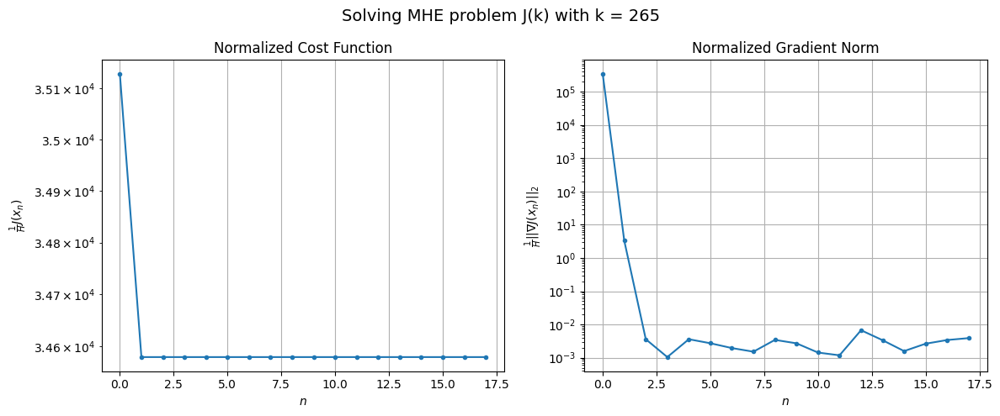

Windows:  63%|██████▎   | 217/346 [37:17<42:57, 19.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1713916.0280685688
Gradient norm: 15605891.372245025
Global estimation error: 113.82013078852403
Initial conditions estimation errors: 53.18903985772285 m, 57.854531784456995 m, 51.89463556943538 m, 63.919600477004515 m
Position estimation errors: 55.60378481744483 m, 51.48718252439126 m, 56.56747574595358 m, 46.763977862908476 m

[Gauss-Newton] Iteration 1
Cost function: 1687792.6267850618 (-1.52%)
Gradient norm: 87.78817510753387 (-100.00%)
Global estimation error: 121.83694243069823 (7.04%)
Initial conditions estimation errors: 57.50986266322165 m, 61.18317774254299 m, 56.24388081300648 m, 68.0446058423075 m
Position estimation errors: 50.76341920724452 m, 47.512799909675984 m, 51.71786588705602 m, 41.8739480760277 m

[Gauss-Newton] Iteration 2
Cost function: 1687792.6267770194 (-0.00%)
Gradient norm: 0.08982911721978445 (-99.90%)
Global estimation error: 121.83608197166679 (-0.00%)
Initial conditions estimation errors: 57.

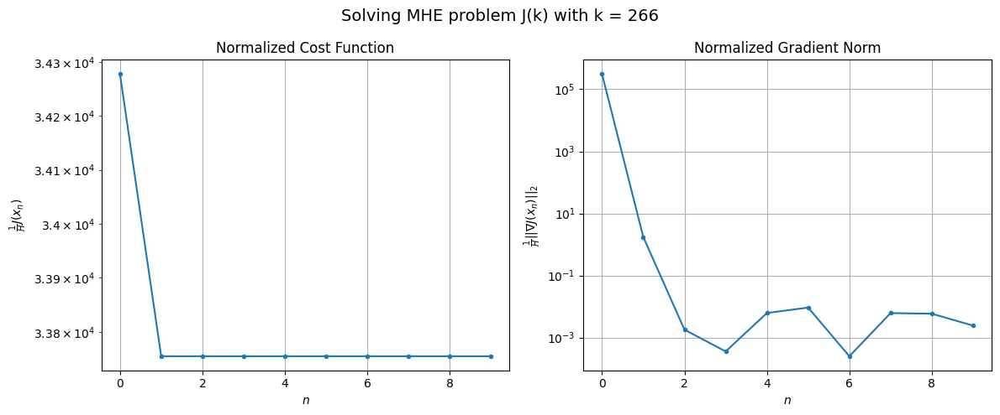

Windows:  63%|██████▎   | 218/346 [37:29<37:53, 17.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1666685.6188453676
Gradient norm: 13892641.499694906
Global estimation error: 111.28040149697148
Initial conditions estimation errors: 52.42539647176433 m, 55.887758916784165 m, 51.252592358510555 m, 62.32659457551009 m
Position estimation errors: 53.787725310511966 m, 50.76309165406612 m, 54.686712870414034 m, 45.46257120961692 m

[Gauss-Newton] Iteration 1
Cost function: 1641874.3967689048 (-1.49%)
Gradient norm: 405.8167929267399 (-100.00%)
Global estimation error: 116.93235320707356 (5.08%)
Initial conditions estimation errors: 56.65533866858807 m, 59.2143689402057 m, 56.652439528740025 m, 61.21664319916078 m
Position estimation errors: 49.11628355673388 m, 46.8364864904907 m, 48.992208089315 m, 45.27654473791145 m

[Gauss-Newton] Iteration 2
Cost function: 1641874.3967263734 (-0.00%)
Gradient norm: 0.21536568782633464 (-99.95%)
Global estimation error: 116.93302565167536 (0.00%)
Initial conditions estimation errors: 56.65

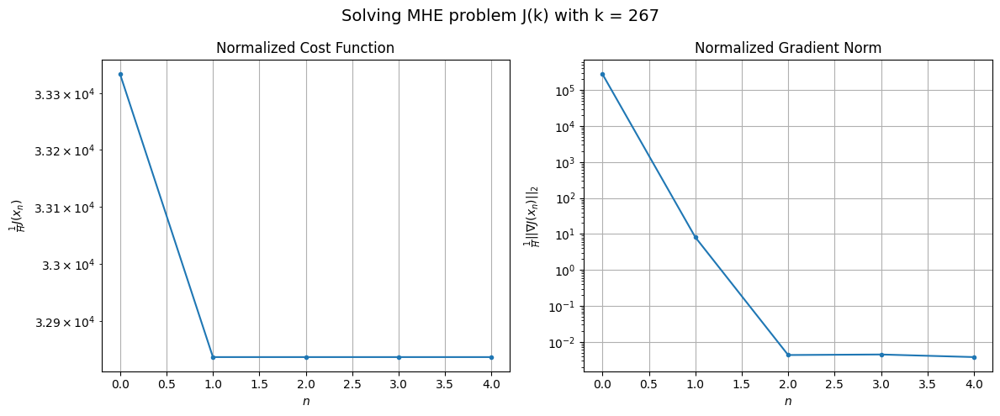

Windows:  63%|██████▎   | 219/346 [37:36<30:39, 14.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1616603.4462907328
Gradient norm: 12227341.9108781
Global estimation error: 106.78953370113736
Initial conditions estimation errors: 51.650423409010145 m, 54.02042617725615 m, 51.67182944488055 m, 56.10726184489815 m
Position estimation errors: 51.99607125784109 m, 49.9014663088227 m, 51.85960614002502 m, 48.285328535858554 m

[Gauss-Newton] Iteration 1
Cost function: 1593134.2090191534 (-1.45%)
Gradient norm: 1064.331012957552 (-99.99%)
Global estimation error: 119.103491306712 (11.53%)
Initial conditions estimation errors: 55.78263520452966 m, 60.42592917345806 m, 54.330006823822806 m, 66.86451745544622 m
Position estimation errors: 47.504691079620954 m, 43.393110494152054 m, 48.750911286685934 m, 38.47019433954948 m

[Gauss-Newton] Iteration 2
Cost function: 1593134.2086483778 (-0.00%)
Gradient norm: 0.2867786724641761 (-99.97%)
Global estimation error: 119.12231640639071 (0.02%)
Initial conditions estimation errors: 55.782

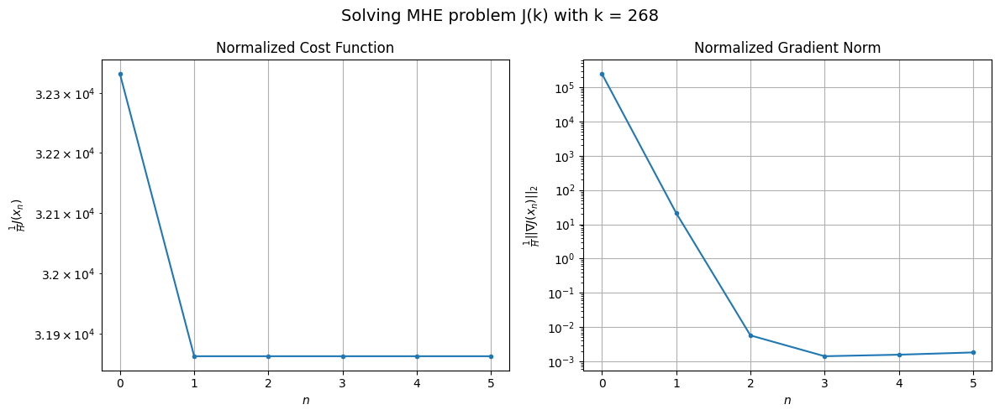

Windows:  64%|██████▎   | 220/346 [37:44<26:22, 12.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1564463.8871565065
Gradient norm: 10471297.347618505
Global estimation error: 108.4695870718667
Initial conditions estimation errors: 50.860908298237845 m, 55.11150457384166 m, 49.53060267767349 m, 60.7307895383449 m
Position estimation errors: 50.28937880817547 m, 46.557694918231654 m, 51.4680954824112 m, 42.34569890505336 m

[Gauss-Newton] Iteration 1
Cost function: 1542397.0863213977 (-1.41%)
Gradient norm: 274.3613062476888 (-100.00%)
Global estimation error: 115.31939400426283 (6.31%)
Initial conditions estimation errors: 54.88685321273504 m, 59.0808326846388 m, 54.4092379584339 m, 61.92782723803913 m
Position estimation errors: 45.988342403116015 m, 42.15051296948091 m, 46.33862950819032 m, 40.25870860123629 m

[Gauss-Newton] Iteration 2
Cost function: 1542397.0862872412 (-0.00%)
Gradient norm: 0.3040605358452028 (-99.89%)
Global estimation error: 115.3153294948688 (-0.00%)
Initial conditions estimation errors: 54.886855

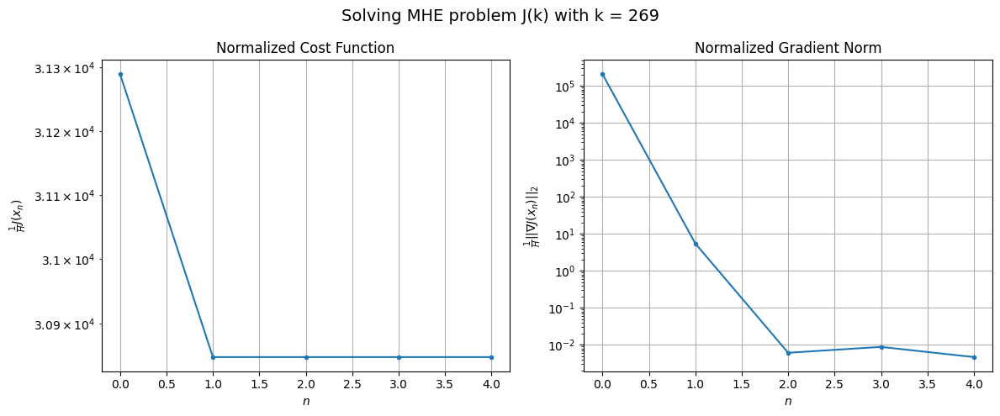

Windows:  64%|██████▍   | 221/346 [37:51<22:47, 10.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1511117.5438306734
Gradient norm: 8513538.304989038
Global estimation error: 105.14023404463207
Initial conditions estimation errors: 50.05055750515891 m, 53.91376487247276 m, 49.63505929477203 m, 56.38304980346828 m
Position estimation errors: 48.70578514305511 m, 45.18144164574586 m, 49.021227389833115 m, 43.649615962614234 m

[Gauss-Newton] Iteration 1
Cost function: 1490253.085644605 (-1.38%)
Gradient norm: 211.3592057161156 (-100.00%)
Global estimation error: 114.17671280268577 (8.59%)
Initial conditions estimation errors: 53.98713008671325 m, 57.69270650685587 m, 52.7752520725866 m, 63.30880856906526 m
Position estimation errors: 44.57884202119638 m, 41.352608232967555 m, 45.68953795744585 m, 37.14393154718908 m

[Gauss-Newton] Iteration 2
Cost function: 1490253.0856107844 (-0.00%)
Gradient norm: 0.1291398042381578 (-99.94%)
Global estimation error: 114.18473905628728 (0.01%)
Initial conditions estimation errors: 53.9871

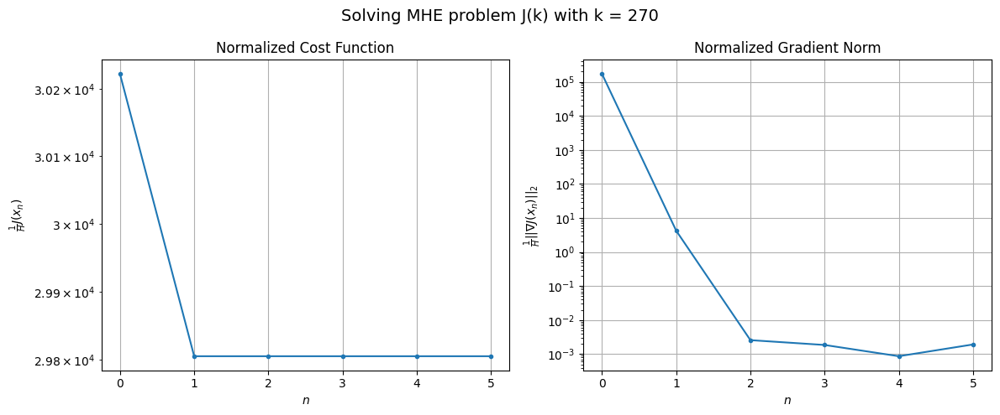

Windows:  64%|██████▍   | 222/346 [37:59<20:48, 10.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1456546.4767102983
Gradient norm: 6549301.1911878325
Global estimation error: 103.90388948646574
Initial conditions estimation errors: 49.24314978888902 m, 52.50760825686056 m, 48.14824105223034 m, 57.40904972013881 m
Position estimation errors: 47.2472806450454 m, 44.46338632798912 m, 48.27088817483091 m, 40.94350037716737 m

[Gauss-Newton] Iteration 1
Cost function: 1436762.3261451006 (-1.36%)
Gradient norm: 177.35927009525838 (-100.00%)
Global estimation error: 108.77964680710785 (4.69%)
Initial conditions estimation errors: 53.09734633820517 m, 54.535792931002206 m, 52.710063456689575 m, 57.10649240596884 m
Position estimation errors: 43.280597139288396 m, 42.26781929298599 m, 43.625638017302656 m, 40.73795480909837 m

[Gauss-Newton] Iteration 2
Cost function: 1436762.326126972 (-0.00%)
Gradient norm: 0.0033964196124548454 (-100.00%)
Global estimation error: 108.77680025185832 (-0.00%)
Initial conditions estimation errors:

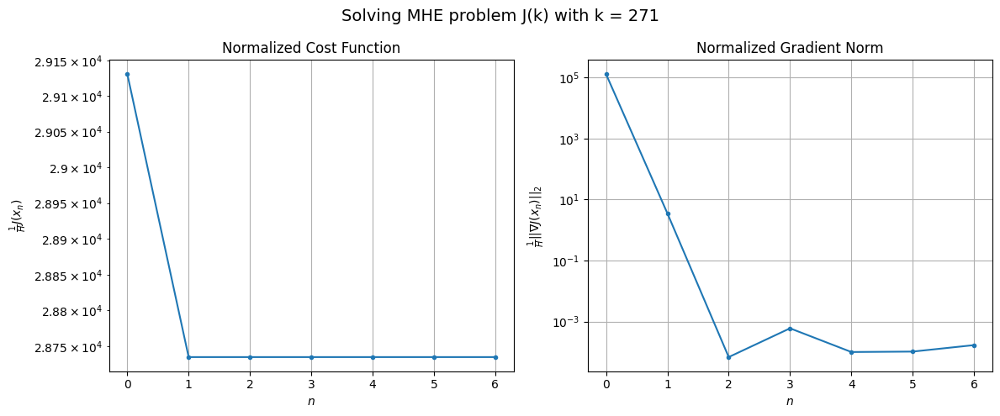

Windows:  64%|██████▍   | 223/346 [38:08<20:00,  9.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1401809.4362574546
Gradient norm: 5059091.271465718
Global estimation error: 98.88144488070611
Initial conditions estimation errors: 48.455910750450585 m, 49.512045074388645 m, 48.124404667969934 m, 51.59589936563536 m
Position estimation errors: 45.9208516305399 m, 45.30121312663883 m, 46.217638479234296 m, 44.283078266215675 m

[Gauss-Newton] Iteration 1
Cost function: 1383031.7169379871 (-1.34%)
Gradient norm: 83.68509215912985 (-100.00%)
Global estimation error: 107.19883486910146 (8.41%)
Initial conditions estimation errors: 52.22417507742216 m, 53.89962167684745 m, 52.25006429867168 m, 55.937110956284016 m
Position estimation errors: 42.09796948824269 m, 40.74468194471534 m, 42.056039399713605 m, 39.93530919411135 m

[Gauss-Newton] Iteration 2
Cost function: 1383031.7169416547 (0.00%)
Gradient norm: 0.2771043736971009 (-99.67%)
Global estimation error: 107.19858438710398 (-0.00%)
Initial conditions estimation errors: 52.

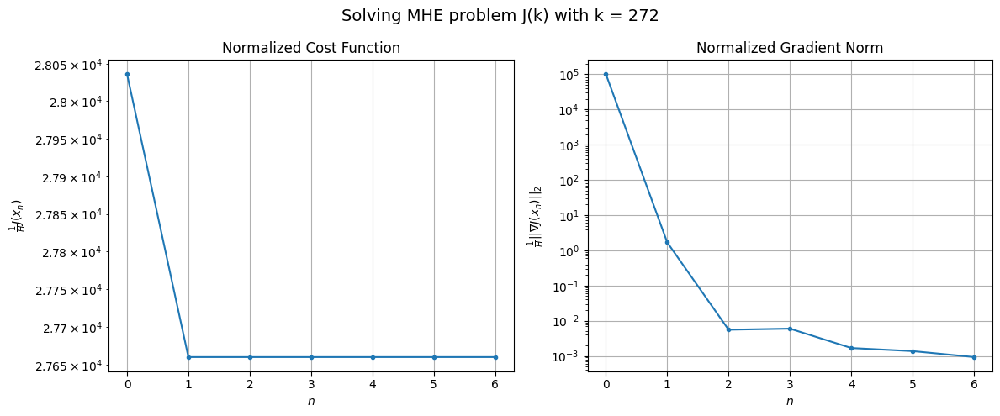

Windows:  65%|██████▍   | 224/346 [38:18<19:45,  9.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1346650.4479071542
Gradient norm: 3301655.3220718713
Global estimation error: 97.54180782140985
Initial conditions estimation errors: 47.690974233690916 m, 49.078536554694566 m, 47.73826236766024 m, 50.520342945129265 m
Position estimation errors: 44.72873273048953 m, 43.670710013264035 m, 44.66904618825438 m, 43.52515469237674 m

[Gauss-Newton] Iteration 1
Cost function: 1328758.6617430332 (-1.33%)
Gradient norm: 371.7864715894573 (-99.99%)
Global estimation error: 109.82586104488695 (12.59%)
Initial conditions estimation errors: 51.381151690959015 m, 55.06715655226103 m, 50.66275958355496 m, 61.82688379524704 m
Position estimation errors: 41.03356399823881 m, 37.808593275106844 m, 41.73735975898323 m, 32.54965048158834 m

[Gauss-Newton] Iteration 2
Cost function: 1328758.6617151345 (-0.00%)
Gradient norm: 0.11705699912413309 (-99.97%)
Global estimation error: 109.82897720057777 (0.00%)
Initial conditions estimation errors: 5

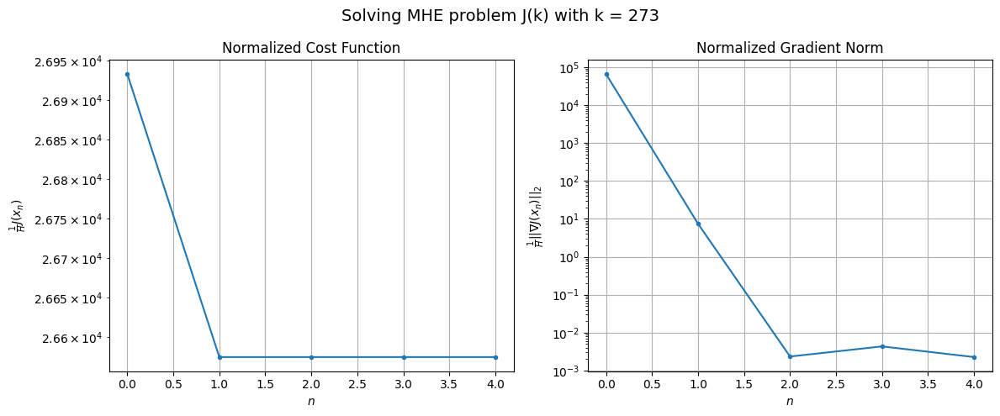

Windows:  65%|██████▌   | 225/346 [38:26<18:29,  9.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1292004.0921309881
Gradient norm: 1366668.0685781974
Global estimation error: 100.20298880351629
Initial conditions estimation errors: 46.94891339523722 m, 50.22490874105639 m, 46.31435425746963 m, 56.292556369447325 m
Position estimation errors: 43.66474721835194 m, 40.888994771829566 m, 44.2594133596702 m, 36.446583822169714 m

[Gauss-Newton] Iteration 1
Cost function: 1274906.8864061274 (-1.32%)
Gradient norm: 171.23483935847025 (-99.99%)
Global estimation error: 105.53578545987662 (5.32%)
Initial conditions estimation errors: 50.56185317495301 m, 52.55538274897064 m, 50.44430802812805 m, 57.223946862752065 m
Position estimation errors: 40.07602701241332 m, 38.47739065910977 m, 40.20688356078765 m, 34.88053539717427 m

[Gauss-Newton] Iteration 2
Cost function: 1274906.8863850548 (-0.00%)
Gradient norm: 0.05779319033307993 (-99.97%)
Global estimation error: 105.53631035120455 (0.00%)
Initial conditions estimation errors: 50.

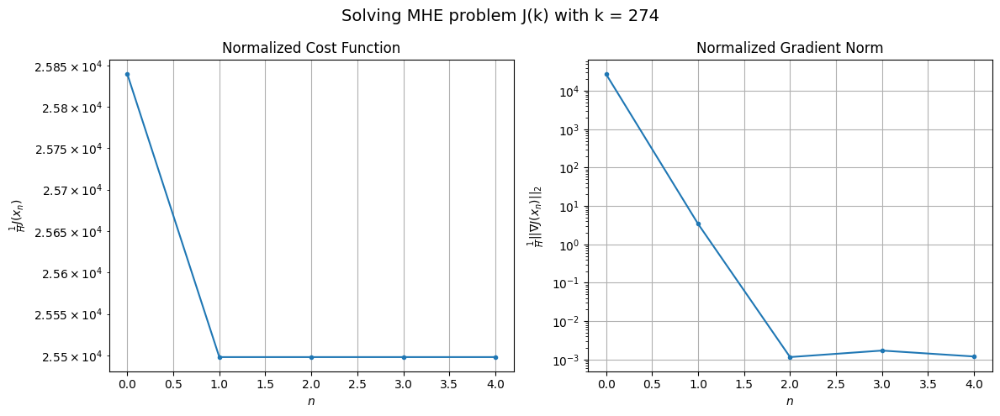

Windows:  65%|██████▌   | 226/346 [38:34<17:41,  8.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1239866.8665361279
Gradient norm: 246678.35953578693
Global estimation error: 96.29823954200916
Initial conditions estimation errors: 46.21068635639288 m, 47.87147263668156 m, 46.121831544517654 m, 52.14401357423254 m
Position estimation errors: 42.714160506758084 m, 41.46764428458648 m, 42.79337188653578 m, 38.37498852648807 m

[Gauss-Newton] Iteration 1
Cost function: 1223344.2726505522 (-1.33%)
Gradient norm: 272.0818328726248 (-99.89%)
Global estimation error: 100.23193670625366 (4.08%)
Initial conditions estimation errors: 49.7612289028636 m, 49.67501744128562 m, 50.03464407997626 m, 50.98201027511345 m
Position estimation errors: 39.19558281894545 m, 39.6121405413836 m, 38.987463054676795 m, 38.939609073979064 m

[Gauss-Newton] Iteration 2
Cost function: 1223344.2726263192 (-0.00%)
Gradient norm: 0.23827125714838507 (-99.91%)
Global estimation error: 100.23386902634577 (0.00%)
Initial conditions estimation errors: 49.761

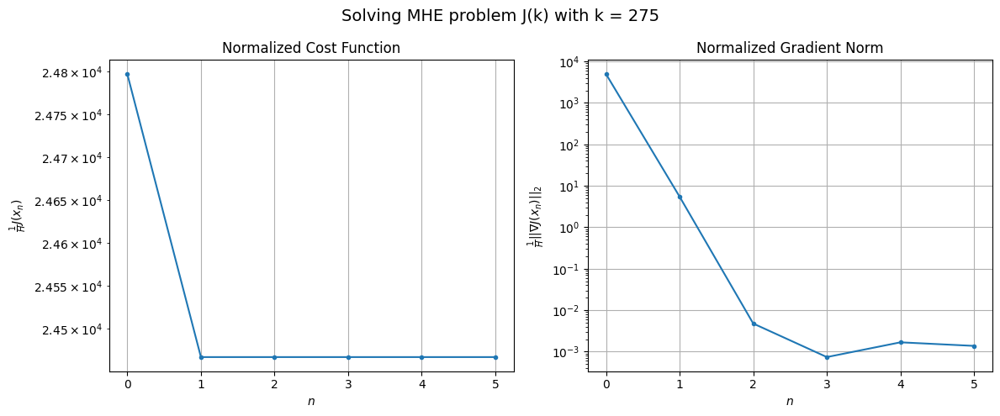

Windows:  66%|██████▌   | 227/346 [38:43<17:41,  8.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1187536.5196500723
Gradient norm: 1728880.7012917676
Global estimation error: 91.33308988091103
Initial conditions estimation errors: 45.46964486786779 m, 45.12486429596974 m, 45.72479804410362 m, 46.33801339781421 m
Position estimation errors: 41.85392087620067 m, 42.53244550605786 m, 41.65808944189066 m, 41.96949328429939 m

[Gauss-Newton] Iteration 1
Cost function: 1171720.881216335 (-1.33%)
Gradient norm: 74.58612082029946 (-100.00%)
Global estimation error: 97.81758811677444 (7.10%)
Initial conditions estimation errors: 48.93969379969579 m, 48.20205935683371 m, 49.28966059755604 m, 49.19608675123955 m
Position estimation errors: 38.40928084459062 m, 39.395438257877665 m, 38.1399502498996 m, 39.23833219472546 m

[Gauss-Newton] Iteration 2
Cost function: 1171720.8812238378 (0.00%)
Gradient norm: 0.23310184751644578 (-99.69%)
Global estimation error: 97.8183114748023 (0.00%)
Initial conditions estimation errors: 48.939694690

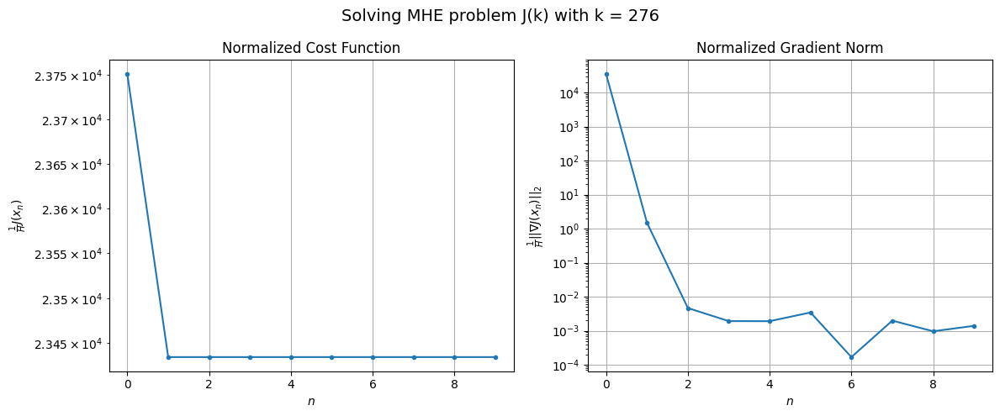

Windows:  66%|██████▌   | 228/346 [38:56<20:00, 10.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1137172.0252653877
Gradient norm: 3356546.753946406
Global estimation error: 88.99309644079636
Initial conditions estimation errors: 44.694997840199505 m, 43.7343439923043 m, 45.01152134139925 m, 44.535107751209125 m
Position estimation errors: 41.10411297576896 m, 42.269942518637855 m, 40.85583349746038 m, 42.35430552407369 m

[Gauss-Newton] Iteration 1
Cost function: 1121846.5358348566 (-1.35%)
Gradient norm: 101.54780717251897 (-100.00%)
Global estimation error: 96.9260321608036 (8.91%)
Initial conditions estimation errors: 48.100900094879705 m, 48.223398472540445 m, 48.51076901161206 m, 49.01167861305633 m
Position estimation errors: 37.69325492238972 m, 37.7395486598758 m, 37.358343076894315 m, 38.537412390555076 m

[Gauss-Newton] Iteration 2
Cost function: 1121846.5358341055 (-0.00%)
Gradient norm: 0.21191445829678146 (-99.79%)
Global estimation error: 96.92569543597757 (-0.00%)
Initial conditions estimation errors: 48.1

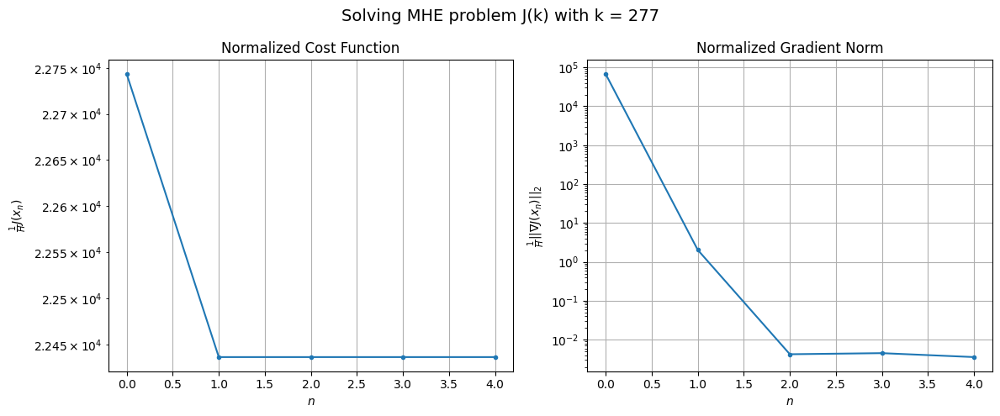

Windows:  66%|██████▌   | 229/346 [39:03<18:01,  9.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1088561.2472243765
Gradient norm: 4939500.0333312
Global estimation error: 88.01274915585397
Initial conditions estimation errors: 43.904012128646706 m, 43.81785894800496 m, 44.266185595995246 m, 44.03587641092674 m
Position estimation errors: 40.43116958891464 m, 40.62055342831189 m, 40.08765293702669 m, 42.11706783853882 m

[Gauss-Newton] Iteration 1
Cost function: 1073794.669574 (-1.36%)
Gradient norm: 91.44447530831027 (-100.00%)
Global estimation error: 94.30927976635714 (7.15%)
Initial conditions estimation errors: 47.23634382747235 m, 46.47565949314662 m, 47.904589510515194 m, 46.99052024832647 m
Position estimation errors: 37.0496895723163 m, 37.85781290183428 m, 36.58327447714385 m, 38.53659344651235 m

[Gauss-Newton] Iteration 2
Cost function: 1073794.6695742754 (0.00%)
Gradient norm: 0.09465585758436475 (-99.90%)
Global estimation error: 94.3109168864996 (0.00%)
Initial conditions estimation errors: 47.2363443055989

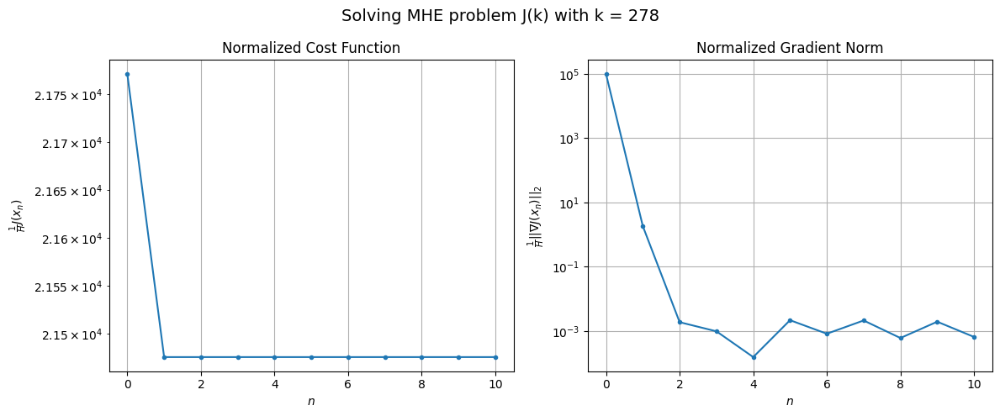

Windows:  66%|██████▋   | 230/346 [39:17<20:25, 10.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1041216.371478892
Gradient norm: 6528612.2475722
Global estimation error: 85.69877395174566
Initial conditions estimation errors: 43.10138224318717 m, 42.21600840316718 m, 43.65592887970441 m, 42.40869364229722 m
Position estimation errors: 39.827166954863955 m, 40.69740214574983 m, 39.44133179981814 m, 41.786077830330875 m

[Gauss-Newton] Iteration 1
Cost function: 1026700.3917346337 (-1.39%)
Gradient norm: 84.37006665166226 (-100.00%)
Global estimation error: 92.24470174157581 (7.64%)
Initial conditions estimation errors: 46.390785364075164 m, 45.00315814467989 m, 47.21162948803512 m, 45.85560754506363 m
Position estimation errors: 36.423359544483795 m, 37.76844593916244 m, 35.963253780094476 m, 37.63847631471576 m

[Gauss-Newton] Iteration 2
Cost function: 1026700.3917318702 (-0.00%)
Gradient norm: 0.09479656085253223 (-99.89%)
Global estimation error: 92.24550909176222 (0.00%)
Initial conditions estimation errors: 46.39078

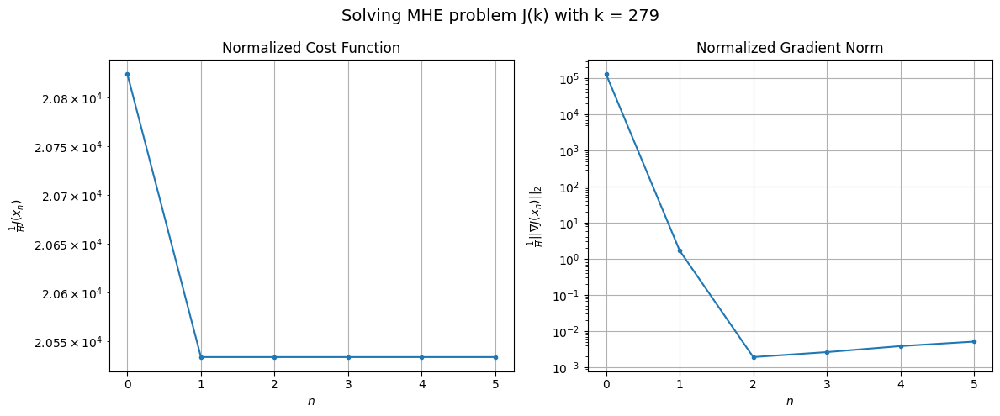

Windows:  67%|██████▋   | 231/346 [39:25<18:46,  9.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 996173.5377258665
Gradient norm: 8374664.855475009
Global estimation error: 83.95897430060573
Initial conditions estimation errors: 42.337745918010334 m, 40.88746515283858 m, 42.977077414558536 m, 41.68681345769462 m
Position estimation errors: 39.23433715590165 m, 40.56172446939354 m, 38.93655677443313 m, 40.551364315338326 m

[Gauss-Newton] Iteration 1
Cost function: 982008.4575799019 (-1.42%)
Gradient norm: 52.88443993602452 (-100.00%)
Global estimation error: 91.23264985115993 (8.66%)
Initial conditions estimation errors: 45.56697709221122 m, 45.21625079944072 m, 46.16146291329983 m, 45.515234723031455 m
Position estimation errors: 35.80253224478199 m, 36.31999145752022 m, 35.627334530231714 m, 36.80683033956002 m

[Gauss-Newton] Iteration 2
Cost function: 982008.4575834066 (0.00%)
Gradient norm: 0.03159281352220465 (-99.94%)
Global estimation error: 91.22820718634838 (-0.00%)
Initial conditions estimation errors: 45.56697

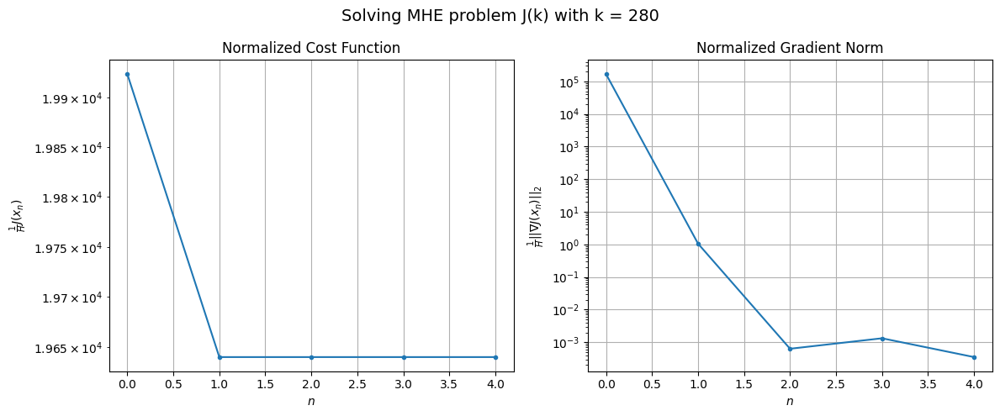

Windows:  67%|██████▋   | 232/346 [39:32<17:07,  9.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 952733.1540118954
Gradient norm: 9548704.340032786
Global estimation error: 83.07411091619117
Initial conditions estimation errors: 41.60492576019229 m, 41.16043851755707 m, 42.0254487131535 m, 41.35212870089456 m
Position estimation errors: 38.64849653168007 m, 39.277344791966996 m, 38.653673087558744 m, 39.898925265951036 m

[Gauss-Newton] Iteration 1
Cost function: 938813.0581740832 (-1.46%)
Gradient norm: 66.61965611051203 (-100.00%)
Global estimation error: 92.27679619278688 (11.08%)
Initial conditions estimation errors: 44.79498282040176 m, 46.30680006765886 m, 45.230015249525785 m, 48.14897538113354 m
Position estimation errors: 35.17649598842669 m, 33.8461382720763 m, 35.460497853782144 m, 32.65052302798121 m

[Gauss-Newton] Iteration 2
Cost function: 938813.0581840986 (0.00%)
Gradient norm: 0.34828962261211055 (-99.48%)
Global estimation error: 92.25656673645216 (-0.02%)
Initial conditions estimation errors: 44.794982

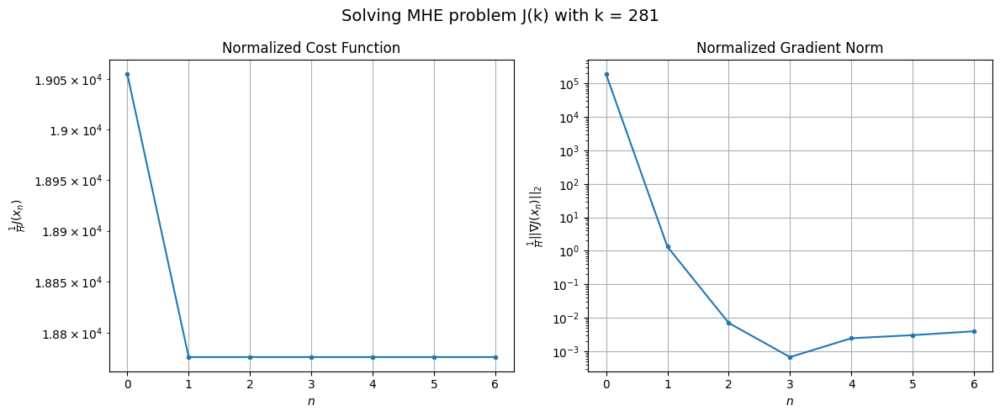

Windows:  67%|██████▋   | 233/346 [39:41<17:05,  9.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 910609.5845359539
Gradient norm: 10812684.742133487
Global estimation error: 84.39454538171589
Initial conditions estimation errors: 40.91107799819723 m, 42.40220091294419 m, 41.113582292950156 m, 44.27676162835024 m
Position estimation errors: 38.06536095585419 m, 36.84862361972578 m, 38.64239844272122 m, 35.71901277606449 m

[Gauss-Newton] Iteration 1
Cost function: 896784.7502824247 (-1.52%)
Gradient norm: 49.16708999553422 (-100.00%)
Global estimation error: 91.20961475829652 (8.08%)
Initial conditions estimation errors: 44.076057516219606 m, 46.11540236471911 m, 44.294463940058314 m, 47.83144910309389 m
Position estimation errors: 34.521855348005204 m, 32.670825716421334 m, 35.069612957935256 m, 31.269294493651472 m

[Gauss-Newton] Iteration 2
Cost function: 896784.7502669767 (-0.00%)
Gradient norm: 0.26662461562878437 (-99.46%)
Global estimation error: 91.20424762839728 (-0.01%)
Initial conditions estimation errors: 44.0

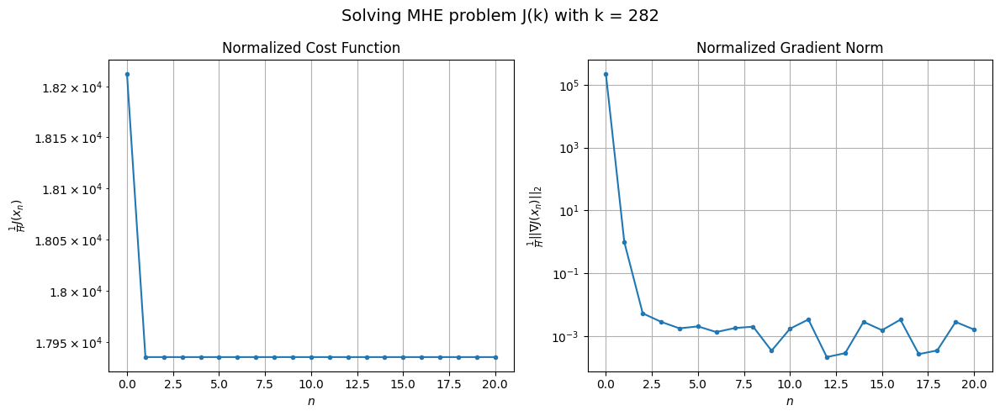

Windows:  68%|██████▊   | 234/346 [40:06<25:43, 13.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 869594.1918197988
Gradient norm: 12113451.601271873
Global estimation error: 83.53051822490347
Initial conditions estimation errors: 40.240117819518 m, 42.29398363545448 m, 40.2233472659516 m, 44.17425116896147 m
Position estimation errors: 37.41537875679575 m, 35.654081059792006 m, 38.24948146817192 m, 34.16809805681783 m

[Gauss-Newton] Iteration 1
Cost function: 855908.6346944779 (-1.57%)
Gradient norm: 46.630962545312286 (-100.00%)
Global estimation error: 89.49180865015128 (7.14%)
Initial conditions estimation errors: 43.37664445833864 m, 45.610936804514004 m, 43.636334483959196 m, 46.28980517408826 m
Position estimation errors: 33.80348064402052 m, 31.649843487222967 m, 34.20740976307008 m, 31.351433712627767 m

[Gauss-Newton] Iteration 2
Cost function: 855908.634687793 (-0.00%)
Gradient norm: 0.03532169678771802 (-99.92%)
Global estimation error: 89.48836674893529 (-0.00%)
Initial conditions estimation errors: 43.376644

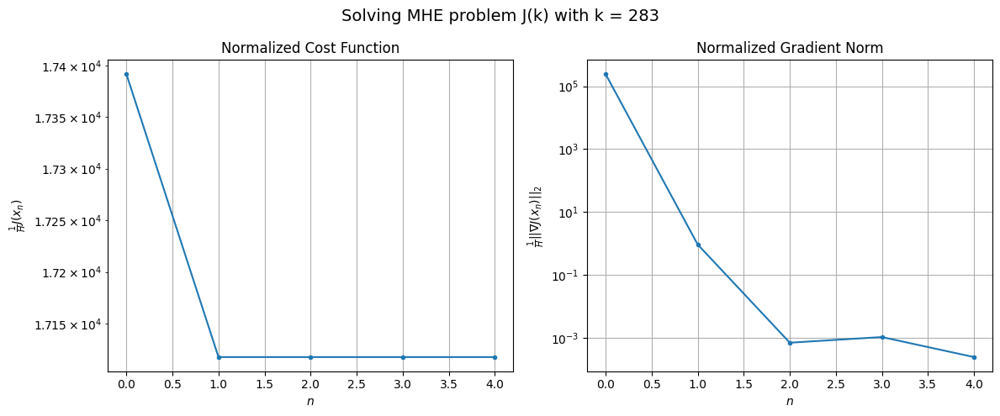

Windows:  68%|██████▊   | 235/346 [40:12<21:21, 11.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 828296.1660897383
Gradient norm: 12947147.473178426
Global estimation error: 81.79337094850281
Initial conditions estimation errors: 39.544375688686735 m, 41.79465479309304 m, 39.57085584862506 m, 42.58796572750995 m
Position estimation errors: 36.61713222048585 m, 34.52295539218624 m, 37.253309972530886 m, 34.15564589075848 m

[Gauss-Newton] Iteration 1
Cost function: 814796.4672425617 (-1.63%)
Gradient norm: 34.42200085389704 (-100.00%)
Global estimation error: 89.17164650751944 (9.02%)
Initial conditions estimation errors: 42.65734142677043 m, 45.480738179614896 m, 43.18317338633425 m, 46.88957504196517 m
Position estimation errors: 32.94989882355571 m, 30.3513580246836 m, 32.92712812061742 m, 29.464592178546702 m

[Gauss-Newton] Iteration 2
Cost function: 814796.4672326443 (-0.00%)
Gradient norm: 0.04360851127570351 (-99.87%)
Global estimation error: 89.1691497167363 (-0.00%)
Initial conditions estimation errors: 42.657341

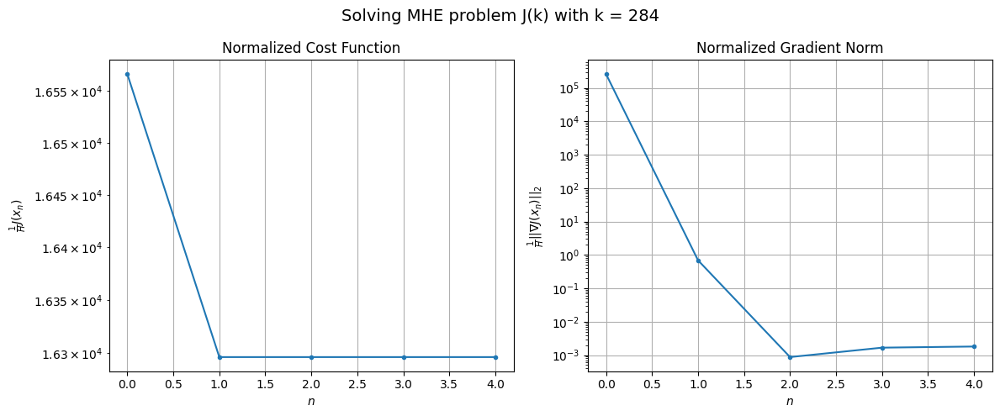

Windows:  68%|██████▊   | 236/346 [40:19<18:23, 10.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 788244.9535692492
Gradient norm: 14081348.85315434
Global estimation error: 81.29038231680114
Initial conditions estimation errors: 38.76742385149924 m, 41.544978520832466 m, 39.07938040846368 m, 43.035006498504934 m
Position estimation errors: 35.61851574660708 m, 33.16058878110267 m, 35.77327919631822 m, 32.28413715469907 m

[Gauss-Newton] Iteration 1
Cost function: 775080.6589949237 (-1.67%)
Gradient norm: 32.759261137490284 (-100.00%)
Global estimation error: 86.69719709212471 (6.65%)
Initial conditions estimation errors: 41.8333554687929 m, 43.97829150646893 m, 42.034027463155596 m, 45.44674319231372 m
Position estimation errors: 31.90728125113124 m, 30.097278307642608 m, 32.14371880703971 m, 29.11149584746386 m

[Gauss-Newton] Iteration 2
Cost function: 775080.6590113492 (0.00%)
Gradient norm: 0.14448900819946023 (-99.56%)
Global estimation error: 86.70262386806147 (0.01%)
Initial conditions estimation errors: 41.8333554

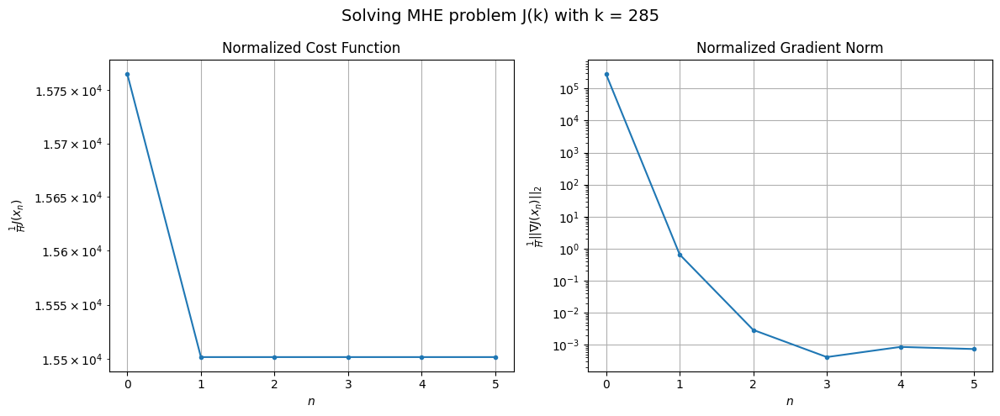

Windows:  68%|██████▊   | 237/346 [40:26<16:56,  9.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 747042.0666521894
Gradient norm: 14929095.007690994
Global estimation error: 78.53810743032376
Initial conditions estimation errors: 37.816043593152955 m, 39.88114032442895 m, 37.815653386782444 m, 41.44433266051121 m
Position estimation errors: 34.45654036797336 m, 32.80309855749234 m, 34.82821448813248 m, 31.82085545162952 m

[Gauss-Newton] Iteration 1
Cost function: 734179.2592261403 (-1.72%)
Gradient norm: 96.37859260245854 (-100.00%)
Global estimation error: 85.59026173715945 (8.98%)
Initial conditions estimation errors: 40.84910113574823 m, 43.11011712850732 m, 43.03299298041694 m, 44.121468221586966 m
Position estimation errors: 30.705825726816897 m, 28.876782604428247 m, 29.346484354592892 m, 27.60812859019467 m

[Gauss-Newton] Iteration 2
Cost function: 734179.2592258867 (-0.00%)
Gradient norm: 0.25702520770120907 (-99.73%)
Global estimation error: 85.59993995565259 (0.01%)
Initial conditions estimation errors: 40.849

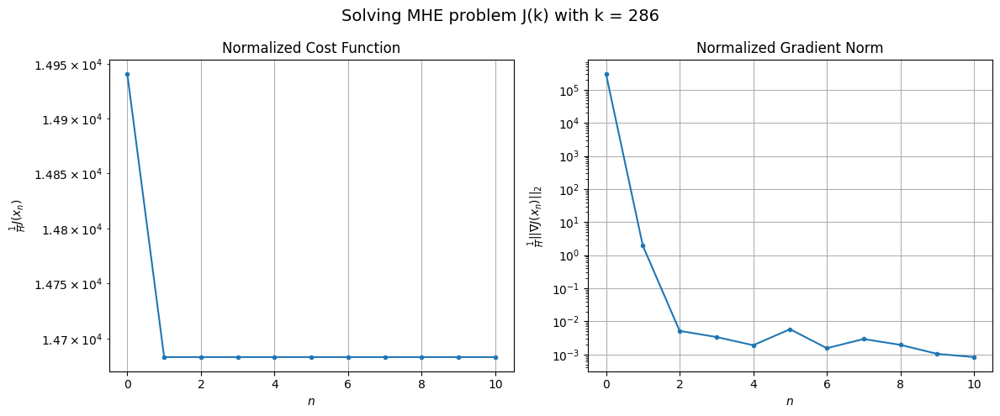

Windows:  69%|██████▉   | 238/346 [40:39<18:48, 10.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 705771.524465964
Gradient norm: 16106757.943243112
Global estimation error: 77.18696679998081
Initial conditions estimation errors: 36.65878057757085 m, 38.88479786203749 m, 38.57219473327122 m, 40.17585520750541 m
Position estimation errors: 33.227943822545534 m, 31.572711082438957 m, 32.244507783995545 m, 30.0224063442486 m

[Gauss-Newton] Iteration 1
Cost function: 693274.1688865959 (-1.77%)
Gradient norm: 104.1086277621293 (-100.00%)
Global estimation error: 83.54350110991516 (8.24%)
Initial conditions estimation errors: 39.63950575020163 m, 42.36674171369358 m, 39.2681388496568 m, 45.5112928606468 m
Position estimation errors: 29.430126188743227 m, 26.925134951426834 m, 30.113864637304935 m, 24.215894848090652 m

[Gauss-Newton] Iteration 2
Cost function: 693274.1688597669 (-0.00%)
Gradient norm: 0.0708506303630988 (-99.93%)
Global estimation error: 83.51674148710376 (-0.03%)
Initial conditions estimation errors: 39.639505

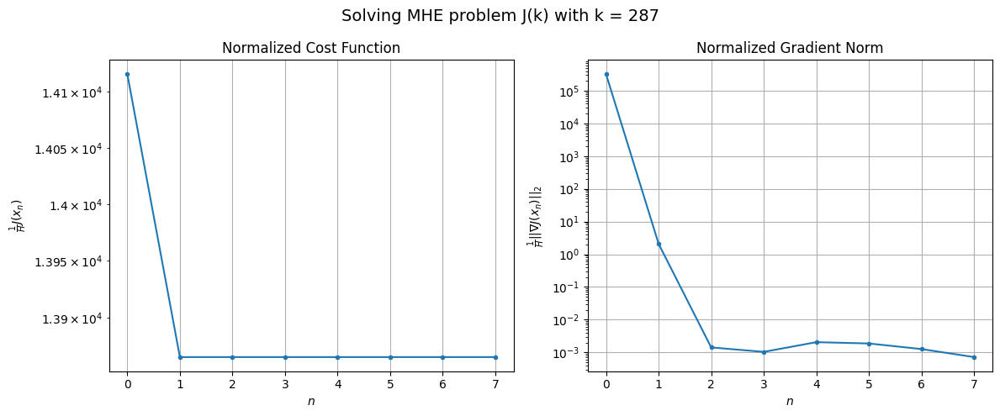

Windows:  69%|██████▉   | 239/346 [40:49<18:19, 10.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 666194.7308042182
Gradient norm: 17245485.122874357
Global estimation error: 74.82321147087691
Initial conditions estimation errors: 35.28511587722342 m, 37.94751631216524 m, 34.68811689288766 m, 41.35422863369431 m
Position estimation errors: 31.987948060007497 m, 29.6094046137646 m, 32.72824097600523 m, 26.97768810685725 m

[Gauss-Newton] Iteration 1
Cost function: 654179.7825452324 (-1.80%)
Gradient norm: 635.1881158651421 (-100.00%)
Global estimation error: 86.57999029637224 (15.71%)
Initial conditions estimation errors: 38.1912375558091 m, 44.707615053687924 m, 35.22602388087531 m, 52.8947807596152 m
Position estimation errors: 28.15354123179474 m, 22.58336272718314 m, 30.880279674851113 m, 18.58973582770643 m

[Gauss-Newton] Iteration 2
Cost function: 654179.7823856819 (-0.00%)
Gradient norm: 0.3398347616708719 (-99.95%)
Global estimation error: 86.53520977668114 (-0.05%)
Initial conditions estimation errors: 38.19123750

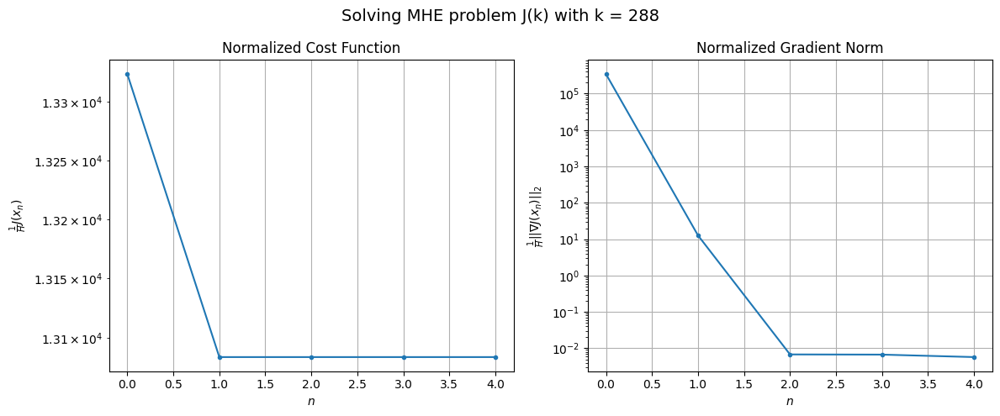

Windows:  69%|██████▉   | 240/346 [40:56<16:05,  9.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 628535.3973221643
Gradient norm: 18371056.68361253
Global estimation error: 77.69591270301986
Initial conditions estimation errors: 33.72870417830288 m, 40.099749511440784 m, 30.584510459495476 m, 48.534566091831906 m
Position estimation errors: 30.759806765792142 m, 25.636189373782848 m, 33.14046577031548 m, 22.502643873866088 m

[Gauss-Newton] Iteration 1
Cost function: 617149.6039411902 (-1.81%)
Gradient norm: 37.49118549336204 (-100.00%)
Global estimation error: 85.73504540271323 (10.35%)
Initial conditions estimation errors: 36.52832106062692 m, 43.799398605550415 m, 34.667953056449065 m, 53.81358628074006 m
Position estimation errors: 26.904271586715492 m, 21.185309796647484 m, 28.27769404525154 m, 18.457329362644543 m

[Gauss-Newton] Iteration 2
Cost function: 617149.6039258472 (-0.00%)
Gradient norm: 0.4155957694684242 (-98.89%)
Global estimation error: 85.75163175164465 (0.02%)
Initial conditions estimation errors: 36

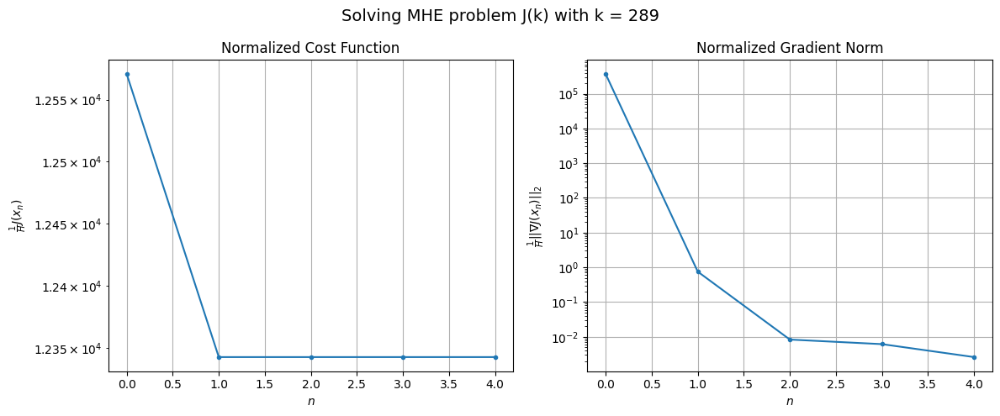

Windows:  70%|██████▉   | 241/346 [41:02<14:37,  8.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 593324.3861737577
Gradient norm: 19298400.475958332
Global estimation error: 76.90417758849412
Initial conditions estimation errors: 32.03077740072944 m, 39.186523174963284 m, 30.02828306345037 m, 49.507346330786845 m
Position estimation errors: 29.58719063256191 m, 24.468734960251595 m, 30.769631966471383 m, 22.720010934126652 m

[Gauss-Newton] Iteration 1
Cost function: 582616.1852744173 (-1.80%)
Gradient norm: 20.803474819523935 (-100.00%)
Global estimation error: 82.4658318511108 (7.23%)
Initial conditions estimation errors: 34.714505270418414 m, 43.0275584656581 m, 32.94890091257553 m, 51.56056345644188 m
Position estimation errors: 25.730355639117487 m, 20.17233540450409 m, 26.985296756679148 m, 18.932742118687138 m

[Gauss-Newton] Iteration 2
Cost function: 582616.1852474739 (-0.00%)
Gradient norm: 0.17888768070436087 (-99.14%)
Global estimation error: 82.44318254249829 (-0.03%)
Initial conditions estimation errors: 34.

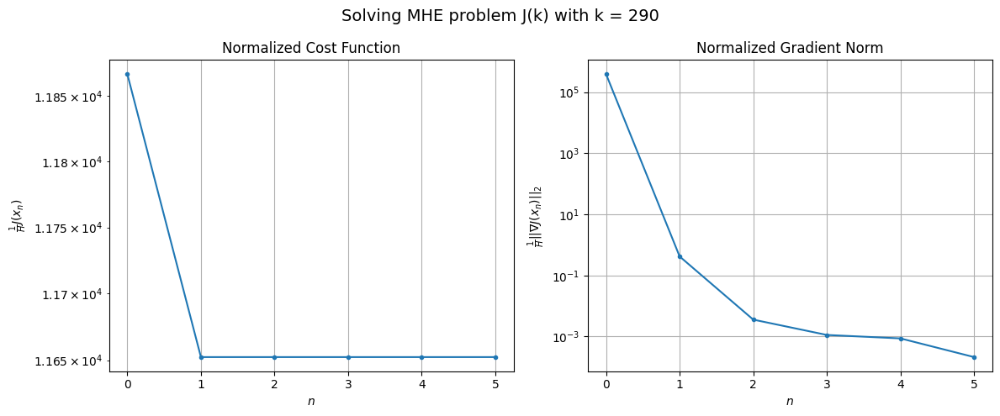

Windows:  70%|██████▉   | 242/346 [41:10<13:56,  8.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 562438.2589575128
Gradient norm: 20617138.937169675
Global estimation error: 73.60172988817887
Initial conditions estimation errors: 30.252548725083958 m, 38.40202652217177 m, 28.33398142669434 m, 47.16402048271143 m
Position estimation errors: 28.543137245638853 m, 23.809583635069128 m, 29.609679044375756 m, 23.277849983363133 m

[Gauss-Newton] Iteration 1
Cost function: 552339.5970909846 (-1.80%)
Gradient norm: 679.3444452717256 (-100.00%)
Global estimation error: 71.53090228450162 (-2.81%)
Initial conditions estimation errors: 32.8065190663557 m, 36.71460570862003 m, 33.54603967864837 m, 39.586350353070685 m
Position estimation errors: 24.66727981582453 m, 22.083346732896548 m, 24.329214291584133 m, 20.97058773101505 m

[Gauss-Newton] Iteration 2
Cost function: 552339.5968412339 (-0.00%)
Gradient norm: 0.21053953438565687 (-99.97%)
Global estimation error: 71.52893366816068 (-0.00%)
Initial conditions estimation errors: 32.

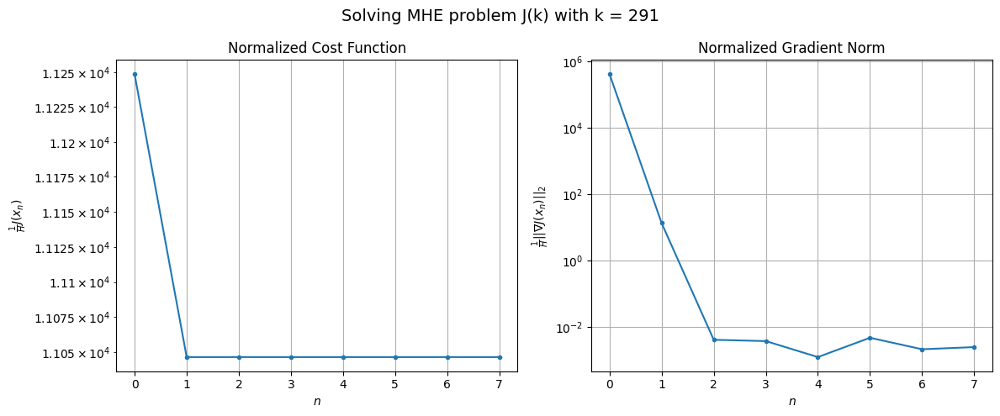

Windows:  70%|███████   | 243/346 [41:20<14:47,  8.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 536545.5904520755
Gradient norm: 21464598.51024705
Global estimation error: 62.588914369776326
Initial conditions estimation errors: 28.448741795979753 m, 32.150789807966184 m, 29.08423470384118 m, 35.04929388438724 m
Position estimation errors: 27.62218459854907 m, 25.43538734179431 m, 27.528905095105145 m, 24.642919425746626 m

[Gauss-Newton] Iteration 1
Cost function: 527114.5684219874 (-1.76%)
Gradient norm: 12.518467318924891 (-100.00%)
Global estimation error: 67.2521759661851 (7.45%)
Initial conditions estimation errors: 30.864260402998426 m, 34.64042529623368 m, 31.232164743442997 m, 37.34732389747183 m
Position estimation errors: 23.766642441130415 m, 21.79350748877531 m, 23.702251241281825 m, 20.761882677015493 m

[Gauss-Newton] Iteration 2
Cost function: 527114.5684370301 (0.00%)
Gradient norm: 0.04591809019855064 (-99.63%)
Global estimation error: 67.24573270933753 (-0.01%)
Initial conditions estimation errors: 30.

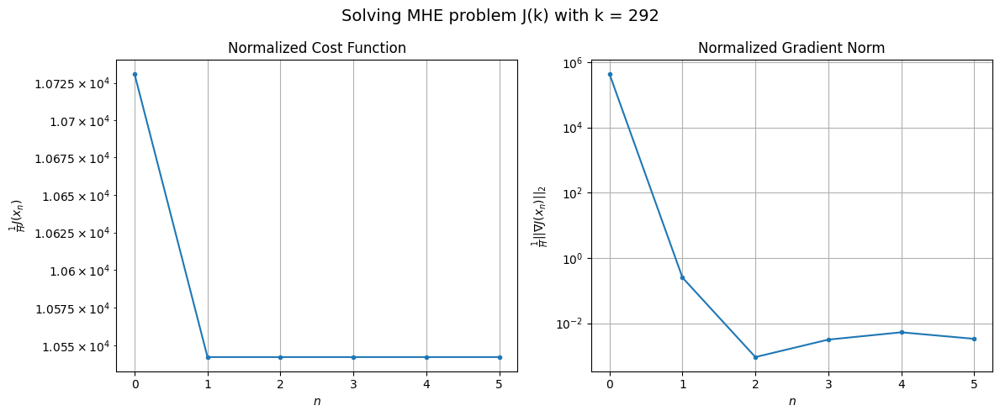

Windows:  71%|███████   | 244/346 [41:27<14:00,  8.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 515309.24534822366
Gradient norm: 22645038.487487506
Global estimation error: 58.70015618717171
Initial conditions estimation errors: 26.672723607953998 m, 30.24500443711294 m, 27.020853789673325 m, 33.0055556215319 m
Position estimation errors: 26.84818246316379 m, 25.353667762594817 m, 26.986061295394357 m, 24.5533723997178 m

[Gauss-Newton] Iteration 1
Cost function: 506456.59890232596 (-1.72%)
Gradient norm: 104.22270045100667 (-100.00%)
Global estimation error: 60.56639209781267 (3.18%)
Initial conditions estimation errors: 28.936622401643827 m, 30.31672546812483 m, 30.57722725802111 m, 31.254876121413787 m
Position estimation errors: 23.003067448665465 m, 22.63186328097421 m, 22.544359200535627 m, 22.174823613880598 m

[Gauss-Newton] Iteration 2
Cost function: 506456.5989033083 (0.00%)
Gradient norm: 0.28886806554516753 (-99.72%)
Global estimation error: 60.566005600375455 (-0.00%)
Initial conditions estimation errors: 2

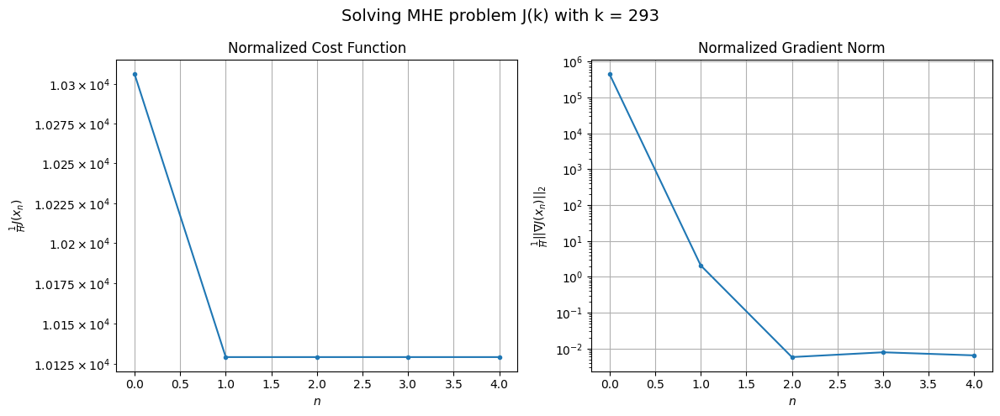

Windows:  71%|███████   | 245/346 [41:34<13:09,  7.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 499078.92608631036
Gradient norm: 23428279.771183882
Global estimation error: 52.32242366157096
Initial conditions estimation errors: 24.955597025739596 m, 26.062838491617185 m, 26.692076261587726 m, 26.89044869833722 m
Position estimation errors: 26.250381796014164 m, 26.160648210037586 m, 26.196045893744284 m, 25.683349448314914 m

[Gauss-Newton] Iteration 1
Cost function: 491026.6734751702 (-1.61%)
Gradient norm: 32.0941556200096 (-100.00%)
Global estimation error: 55.72481218590914 (6.50%)
Initial conditions estimation errors: 27.02616305172012 m, 28.40421729364747 m, 28.459265981282574 m, 27.533465639256683 m
Position estimation errors: 22.49895870415926 m, 22.028392493922684 m, 22.338878225458767 m, 22.252058772603128 m

[Gauss-Newton] Iteration 2
Cost function: 491026.6734751426 (-0.00%)
Gradient norm: 0.06288071562043633 (-99.80%)
Global estimation error: 55.705241720298595 (-0.04%)
Initial conditions estimation errors

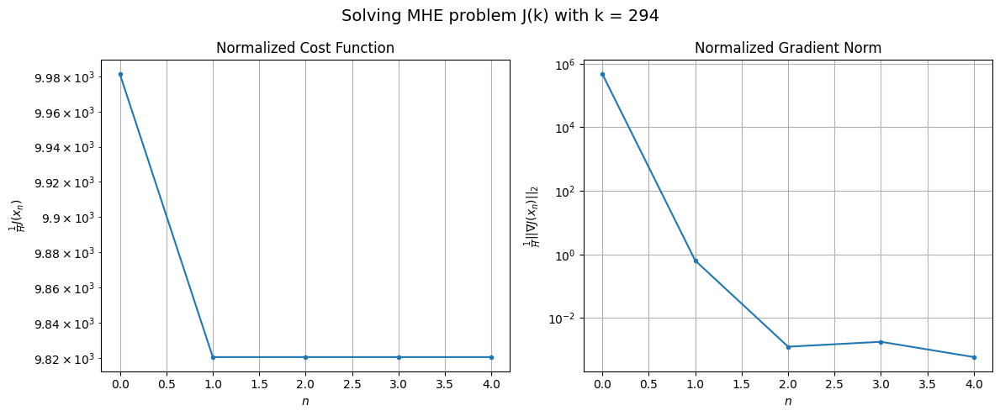

Windows:  71%|███████   | 246/346 [41:40<12:17,  7.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 488174.7375635392
Gradient norm: 24431328.28645861
Global estimation error: 47.98833533529128
Initial conditions estimation errors: 23.276357674959034 m, 24.370162259893775 m, 24.96148623379523 m, 23.32579764864714 m
Position estimation errors: 26.013892212620934 m, 25.772370053577127 m, 26.273294203990652 m, 25.752973692393983 m

[Gauss-Newton] Iteration 1
Cost function: 480660.60591299535 (-1.54%)
Gradient norm: 678.0506384391609 (-100.00%)
Global estimation error: 57.99613644415603 (20.85%)
Initial conditions estimation errors: 25.165675085272703 m, 29.623760199762625 m, 24.718526418810324 m, 35.23704270490125 m
Position estimation errors: 22.3233555571325 m, 20.960836921180842 m, 22.694058537863583 m, 21.28681760258406 m

[Gauss-Newton] Iteration 2
Cost function: 480660.605664509 (-0.00%)
Gradient norm: 0.051467018009705136 (-99.99%)
Global estimation error: 58.04019830571164 (0.08%)
Initial conditions estimation errors: 2

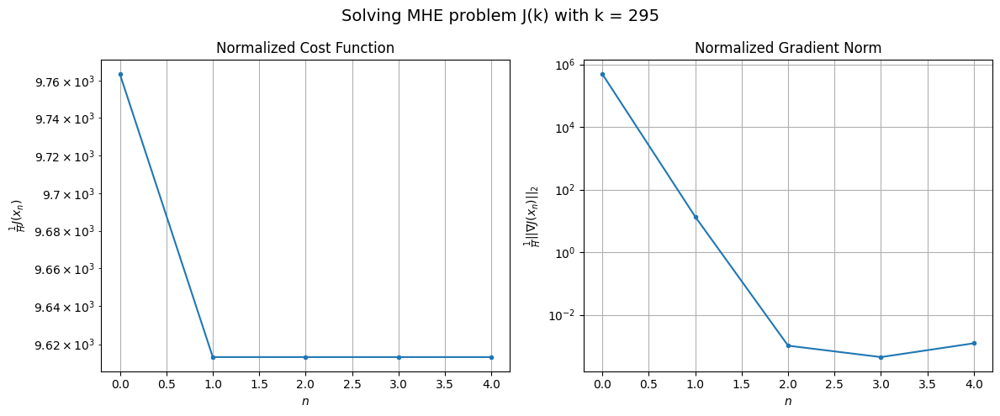

Windows:  71%|███████▏  | 247/346 [41:46<11:33,  7.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 483427.926436679
Gradient norm: 25756884.305112652
Global estimation error: 51.06049515402303
Initial conditions estimation errors: 21.65818738056216 m, 26.012304762452622 m, 21.047006456066832 m, 31.91337479230919 m
Position estimation errors: 26.157222543463845 m, 25.20603555977426 m, 26.633340347710845 m, 25.919436180148796 m

[Gauss-Newton] Iteration 1
Cost function: 476370.5087234128 (-1.46%)
Gradient norm: 55.933025655444865 (-100.00%)
Global estimation error: 52.04063452572401 (1.92%)
Initial conditions estimation errors: 23.337387692140457 m, 26.629735425819998 m, 22.760248351392256 m, 30.600719379923444 m
Position estimation errors: 22.513094101374165 m, 21.985633496741045 m, 22.85054382377916 m, 21.878831587790025 m

[Gauss-Newton] Iteration 2
Cost function: 476370.50871295074 (-0.00%)
Gradient norm: 0.19692434508937506 (-99.65%)
Global estimation error: 52.0324918981081 (-0.02%)
Initial conditions estimation errors:

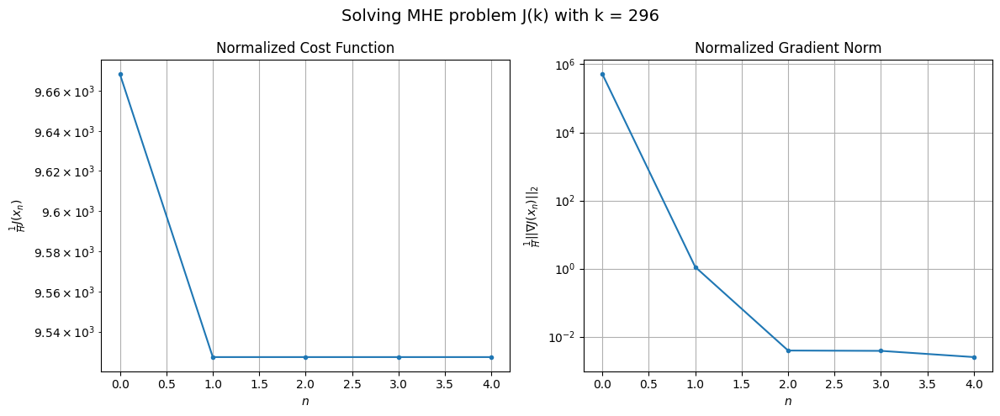

Windows:  72%|███████▏  | 248/346 [41:52<11:02,  6.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 484756.377015163
Gradient norm: 26906286.595735807
Global estimation error: 45.40048444747074
Initial conditions estimation errors: 20.09495633184589 m, 23.208314014957466 m, 19.29559615773325 m, 27.320946539734166 m
Position estimation errors: 26.62265259550764 m, 26.387675395106893 m, 26.987189416231278 m, 26.51314257817304 m

[Gauss-Newton] Iteration 1
Cost function: 478130.510990859 (-1.37%)
Gradient norm: 1118.2011442593387 (-100.00%)
Global estimation error: 58.065809137365996 (27.90%)
Initial conditions estimation errors: 21.530784277381194 m, 28.68797956872845 m, 17.54175595251494 m, 42.15842297158074 m
Position estimation errors: 23.02851758651035 m, 22.37438486301338 m, 23.838416841518416 m, 30.067464292216265 m

[Gauss-Newton] Iteration 2
Cost function: 478130.51028125314 (-0.00%)
Gradient norm: 0.026902088600556116 (-100.00%)
Global estimation error: 58.110476843208545 (0.08%)
Initial conditions estimation errors: 

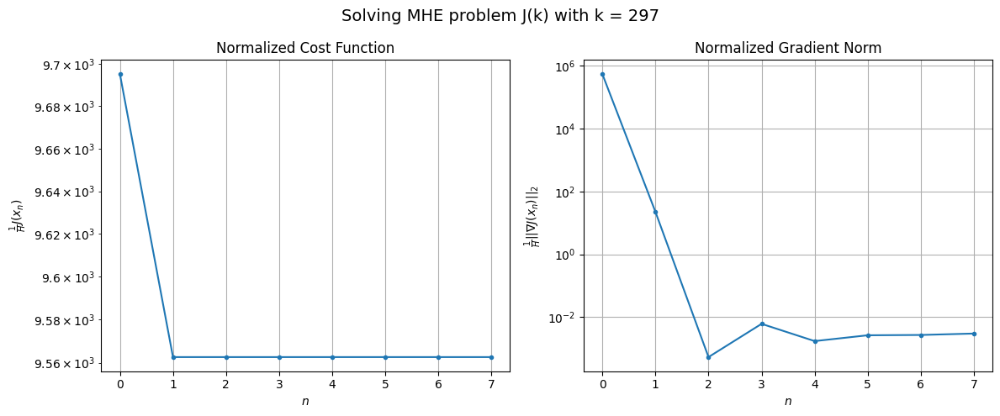

Windows:  72%|███████▏  | 249/346 [42:02<12:21,  7.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 492539.7450599525
Gradient norm: 28139335.692705005
Global estimation error: 52.81129152911359
Initial conditions estimation errors: 18.596750561644726 m, 25.77303860382416 m, 13.593464613668788 m, 39.926752084506546 m
Position estimation errors: 27.351394287228217 m, 26.983370998900842 m, 27.577100017782968 m, 34.974171452121304 m

[Gauss-Newton] Iteration 1
Cost function: 486229.4414389574 (-1.28%)
Gradient norm: 346.3715642275295 (-100.00%)
Global estimation error: 48.9655665822081 (-7.28%)
Initial conditions estimation errors: 19.775758121553636 m, 23.815874153481126 m, 17.96698072531547 m, 33.41437933354747 m
Position estimation errors: 23.786430779763904 m, 23.689651227734796 m, 23.753365439708336 m, 27.481524572613235 m

[Gauss-Newton] Iteration 2
Cost function: 486229.4413042785 (-0.00%)
Gradient norm: 0.4163795330465472 (-99.88%)
Global estimation error: 48.97619715661274 (0.02%)
Initial conditions estimation errors: 

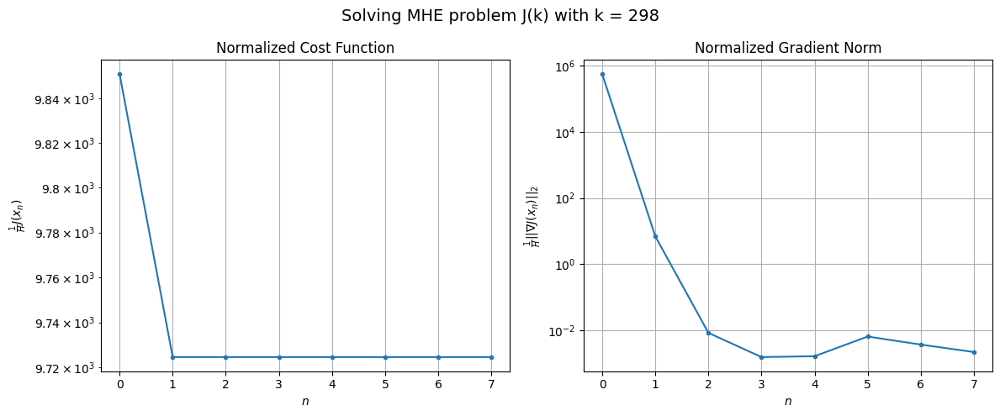

Windows:  72%|███████▏  | 250/346 [42:12<13:06,  8.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 507154.59452302183
Gradient norm: 29490005.34209734
Global estimation error: 43.682974013806856
Initial conditions estimation errors: 17.216189996315332 m, 21.040239671050365 m, 14.932259018292138 m, 30.759155359073848 m
Position estimation errors: 28.313229768930242 m, 28.382920898367917 m, 28.08950502645085 m, 32.37997201871981 m

[Gauss-Newton] Iteration 1
Cost function: 500998.0088064854 (-1.21%)
Gradient norm: 61.54161380184295 (-100.00%)
Global estimation error: 45.84556179134507 (4.95%)
Initial conditions estimation errors: 18.142411591606155 m, 20.588355547084007 m, 15.6620153963827 m, 33.218575799066016 m
Position estimation errors: 24.747921812601753 m, 24.574122635494742 m, 24.653162830668588 m, 30.506214984405005 m

[Gauss-Newton] Iteration 2
Cost function: 500998.00878232904 (-0.00%)
Gradient norm: 0.06067987338296573 (-99.90%)
Global estimation error: 45.861143628418446 (0.03%)
Initial conditions estimation error

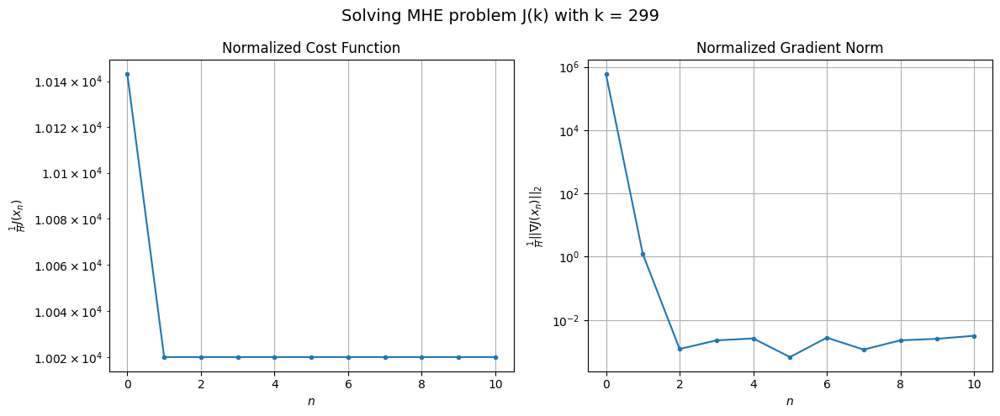

Windows:  73%|███████▎  | 251/346 [42:25<15:30,  9.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 527862.6823575575
Gradient norm: 30530492.265683986
Global estimation error: 41.567547905322336
Initial conditions estimation errors: 16.02988697843777 m, 18.33681876675012 m, 13.082756483390897 m, 31.040181382746034 m
Position estimation errors: 29.511565886636028 m, 29.3939826467746 m, 29.200901052652693 m, 35.604271604071954 m

[Gauss-Newton] Iteration 1
Cost function: 521842.57384813996 (-1.14%)
Gradient norm: 115.33827758475783 (-100.00%)
Global estimation error: 42.85102537306307 (3.09%)
Initial conditions estimation errors: 16.727119023544894 m, 20.844915078905977 m, 14.421680369847117 m, 30.230852769722727 m
Position estimation errors: 25.95899752944048 m, 26.42806074006919 m, 25.522317724126193 m, 31.439103425714936 m

[Gauss-Newton] Iteration 2
Cost function: 521842.5738339819 (-0.00%)
Gradient norm: 0.02903571778864476 (-99.97%)
Global estimation error: 42.840207684412476 (-0.03%)
Initial conditions estimation error

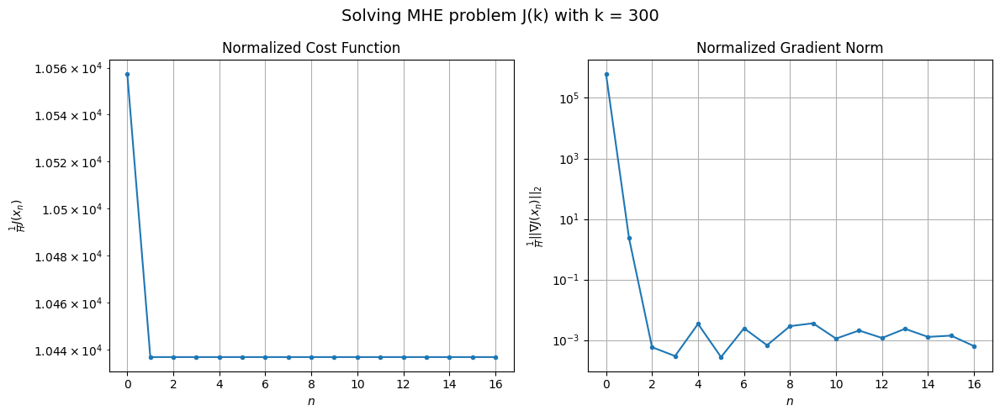

Windows:  73%|███████▎  | 252/346 [42:46<20:22, 13.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 555405.5388554214
Gradient norm: 31977557.08842044
Global estimation error: 39.27178677928998
Initial conditions estimation errors: 15.108938670377514 m, 18.991889839820782 m, 12.178553519156592 m, 28.3720358315139 m
Position estimation errors: 31.009157951528564 m, 31.539585233756277 m, 30.320149996785013 m, 36.73798540263191 m

[Gauss-Newton] Iteration 1
Cost function: 549273.1263783501 (-1.10%)
Gradient norm: 123.51540455039628 (-100.00%)
Global estimation error: 36.905845293940985 (-6.02%)
Initial conditions estimation errors: 15.638605379879825 m, 18.114613685469816 m, 13.104175411206358 m, 24.851649479208756 m
Position estimation errors: 27.405788740782036 m, 27.772350400432114 m, 26.796892489870377 m, 31.026527449511853 m

[Gauss-Newton] Iteration 2
Cost function: 549273.1263263364 (-0.00%)
Gradient norm: 0.4977402455213086 (-99.60%)
Global estimation error: 36.89693235122595 (-0.02%)
Initial conditions estimation error

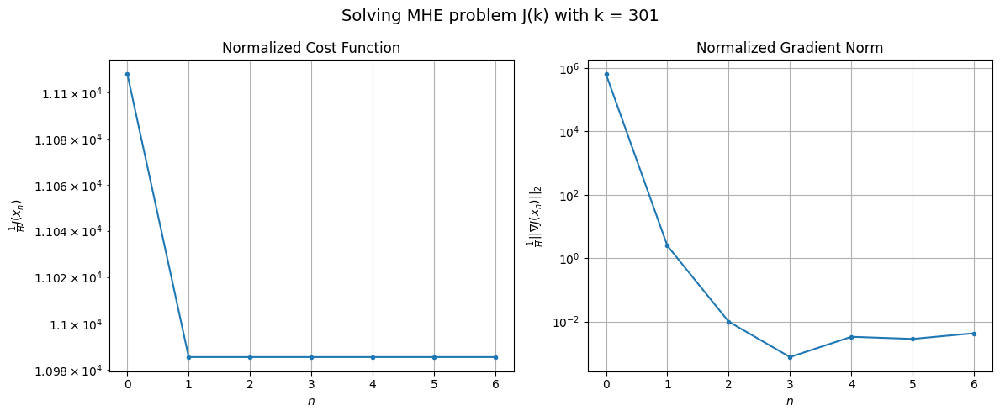

Windows:  73%|███████▎  | 253/346 [42:54<18:03, 11.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 590989.7512971603
Gradient norm: 33579061.69803517
Global estimation error: 33.79034683763495
Initial conditions estimation errors: 14.489911406376965 m, 16.47374978310337 m, 11.869812277676626 m, 22.793485837094703 m
Position estimation errors: 32.78848479851832 m, 33.10550894300436 m, 31.982635286741367 m, 36.407287072846394 m

[Gauss-Newton] Iteration 1
Cost function: 584482.3245329413 (-1.10%)
Gradient norm: 759.6079087470863 (-100.00%)
Global estimation error: 27.73539923297423 (-17.92%)
Initial conditions estimation errors: 14.9581578872114 m, 13.27133036379436 m, 15.447189708841103 m, 11.43464186800351 m
Position estimation errors: 29.071126443079557 m, 28.89918078923243 m, 29.617215057491524 m, 28.15500986114306 m

[Gauss-Newton] Iteration 2
Cost function: 584482.3238308418 (-0.00%)
Gradient norm: 0.35456959045569164 (-99.95%)
Global estimation error: 27.733386741708074 (-0.01%)
Initial conditions estimation errors: 14

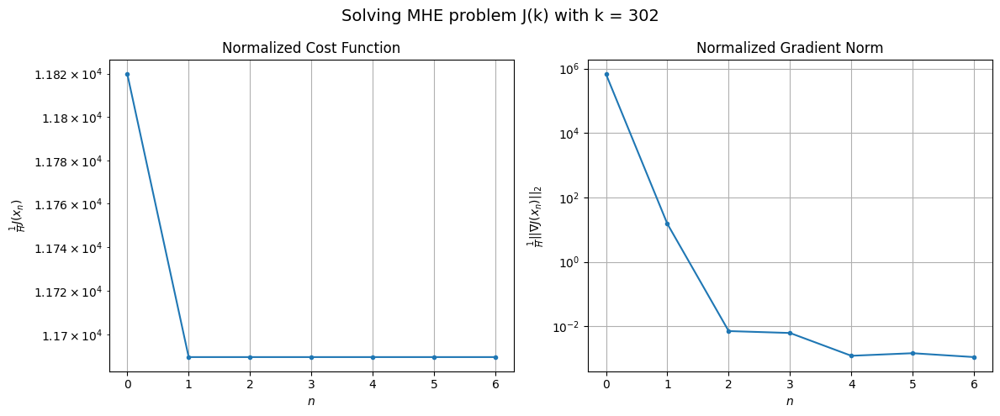

Windows:  73%|███████▎  | 254/346 [43:03<16:29, 10.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 634104.059062185
Gradient norm: 35420699.72440067
Global estimation error: 25.772397335461513
Initial conditions estimation errors: 14.190529264389921 m, 12.083216014191828 m, 15.01455322245677 m, 9.56008476913446 m
Position estimation errors: 34.80597933317062 m, 34.46973838564311 m, 35.56496435242905 m, 33.346950964882154 m

[Gauss-Newton] Iteration 1
Cost function: 626858.4723995015 (-1.14%)
Gradient norm: 43.3238362312324 (-100.00%)
Global estimation error: 26.120419076685025 (1.35%)
Initial conditions estimation errors: 14.768466283929168 m, 12.38809706830766 m, 15.005422911230632 m, 9.248374393513238 m
Position estimation errors: 30.90512307935358 m, 30.58076297563447 m, 31.543246700141317 m, 29.248435996374702 m

[Gauss-Newton] Iteration 2
Cost function: 626858.4724137601 (0.00%)
Gradient norm: 0.3909605295207083 (-99.10%)
Global estimation error: 26.11742913127323 (-0.01%)
Initial conditions estimation errors: 14.76846

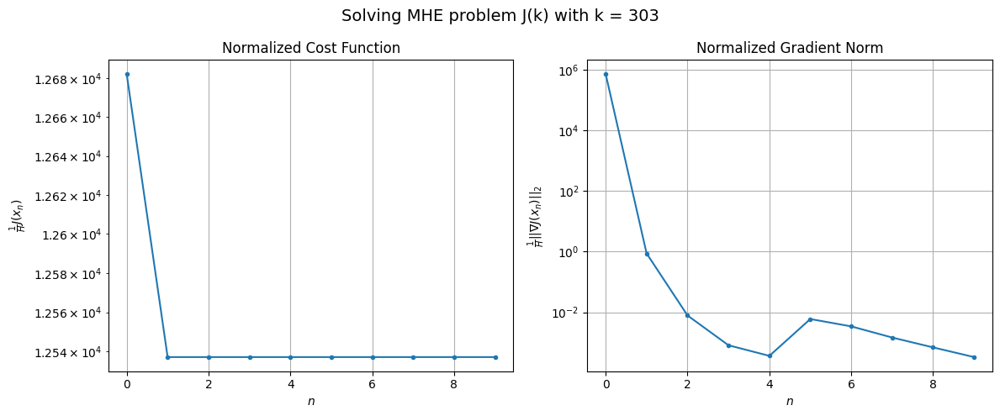

Windows:  74%|███████▎  | 255/346 [43:15<16:50, 11.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 684338.6314723371
Gradient norm: 37117714.87084144
Global estimation error: 25.37821239449629
Initial conditions estimation errors: 14.25932522475497 m, 11.84368586598146 m, 14.756238953793195 m, 9.093866157020654 m
Position estimation errors: 36.95554472362109 m, 36.49820910136792 m, 37.835033340933805 m, 34.68886273247509 m

[Gauss-Newton] Iteration 1
Cost function: 676149.4990414003 (-1.20%)
Gradient norm: 39.23878009266823 (-100.00%)
Global estimation error: 28.0950248135013 (10.71%)
Initial conditions estimation errors: 15.089715343418376 m, 13.48758826076343 m, 15.566141178366246 m, 11.721955430539985 m
Position estimation errors: 32.84024302685621 m, 32.37333390621895 m, 33.736001299626935 m, 31.316152597215776 m

[Gauss-Newton] Iteration 2
Cost function: 676149.4990479827 (0.00%)
Gradient norm: 0.1642600586227275 (-99.58%)
Global estimation error: 28.095626304407414 (0.00%)
Initial conditions estimation errors: 15.0897

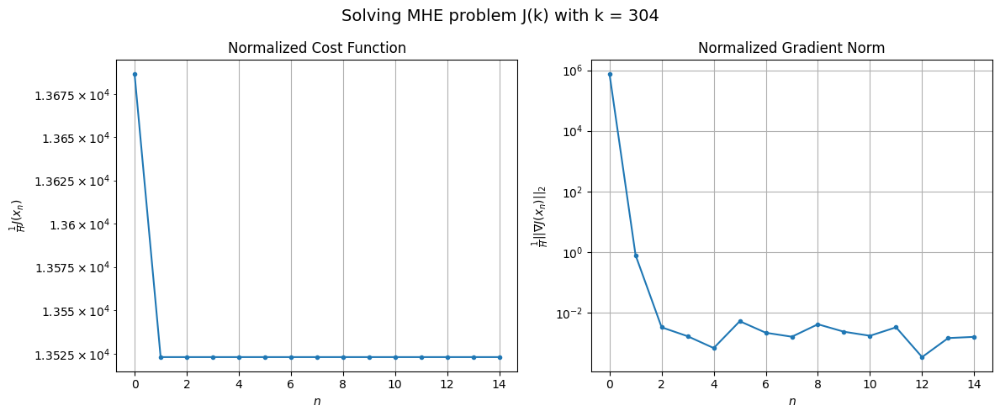

Windows:  74%|███████▍  | 256/346 [43:32<19:37, 13.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 741610.5010120163
Gradient norm: 38868340.05496471
Global estimation error: 27.58322662591906
Initial conditions estimation errors: 14.703640049917572 m, 13.162720842915109 m, 15.367135009336934 m, 11.62862362941483 m
Position estimation errors: 39.12268871296949 m, 38.570748567026605 m, 40.33559136638408 m, 37.17306254057382 m

[Gauss-Newton] Iteration 1
Cost function: 732153.2995885075 (-1.28%)
Gradient norm: 175.1989416279063 (-100.00%)
Global estimation error: 30.01802143927857 (8.83%)
Initial conditions estimation errors: 15.925422464635274 m, 13.42481160102886 m, 17.30315449972115 m, 12.954978830234245 m
Position estimation errors: 34.74146374568471 m, 33.31143429950812 m, 37.165232537670725 m, 31.253162759958556 m

[Gauss-Newton] Iteration 2
Cost function: 732153.2995830041 (-0.00%)
Gradient norm: 0.177555379575906 (-99.90%)
Global estimation error: 30.017674704838598 (-0.00%)
Initial conditions estimation errors: 15.92

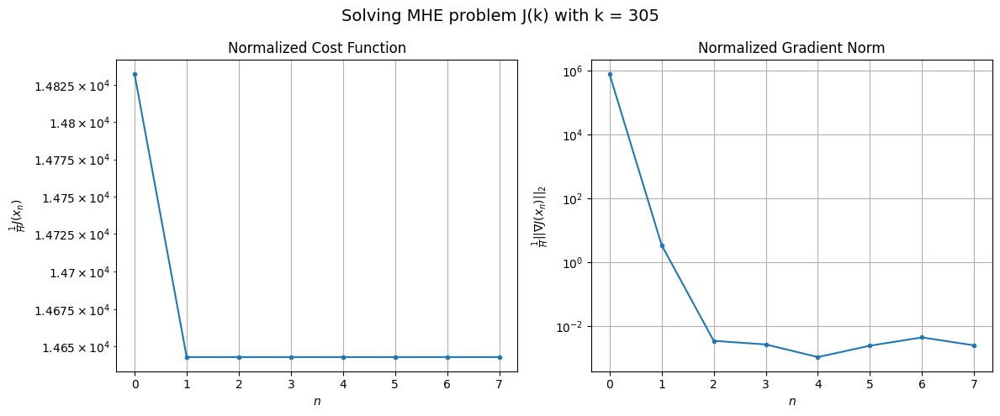

Windows:  74%|███████▍  | 257/346 [43:42<17:53, 12.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 804420.3921352506
Gradient norm: 40488786.01840702
Global estimation error: 30.246600063338043
Initial conditions estimation errors: 15.512231435775275 m, 13.557612020256734 m, 16.852421276771544 m, 14.366903771292359 m
Position estimation errors: 41.16171282077102 m, 39.60562766152127 m, 44.02140424353349 m, 36.96917889529086 m

[Gauss-Newton] Iteration 1
Cost function: 793480.4081372748 (-1.36%)
Gradient norm: 243.41034105814214 (-100.00%)
Global estimation error: 33.627309401195674 (11.18%)
Initial conditions estimation errors: 17.202983433665384 m, 15.575190592861373 m, 18.780506658281425 m, 15.477473339996525 m
Position estimation errors: 36.496360159802244 m, 34.49123936298489 m, 39.10125824995763 m, 32.030739188874655 m

[Gauss-Newton] Iteration 2
Cost function: 793480.4081202897 (-0.00%)
Gradient norm: 0.0757158313391388 (-99.97%)
Global estimation error: 33.626696764394346 (-0.00%)
Initial conditions estimation errors

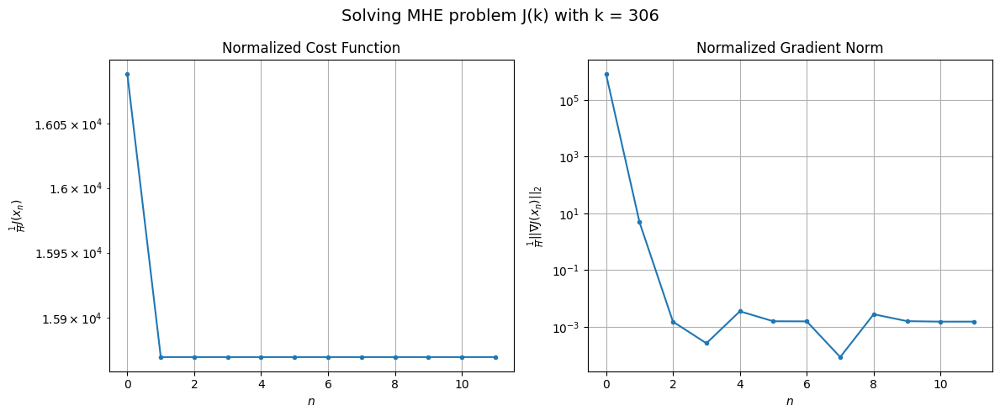

Windows:  75%|███████▍  | 258/346 [43:56<18:41, 12.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 871443.423943809
Gradient norm: 41853248.58118293
Global estimation error: 33.55824802156517
Initial conditions estimation errors: 16.604794674620436 m, 15.500755897147338 m, 18.162677337116012 m, 16.741327769841828 m
Position estimation errors: 42.97759449803222 m, 40.82645599352307 m, 46.253182065467364 m, 37.7803727093181 m

[Gauss-Newton] Iteration 1
Cost function: 858846.2639586898 (-1.45%)
Gradient norm: 139.3669605472758 (-100.00%)
Global estimation error: 37.82149718615715 (12.70%)
Initial conditions estimation errors: 18.78894431749801 m, 18.01550595689337 m, 20.253902329048547 m, 18.510899620305796 m
Position estimation errors: 38.01856417863968 m, 35.24644725482341 m, 40.381100461805325 m, 32.66988760801191 m

[Gauss-Newton] Iteration 2
Cost function: 858846.2639114116 (-0.00%)
Gradient norm: 0.15844797466524652 (-99.89%)
Global estimation error: 37.82079848540631 (-0.00%)
Initial conditions estimation errors: 18.78

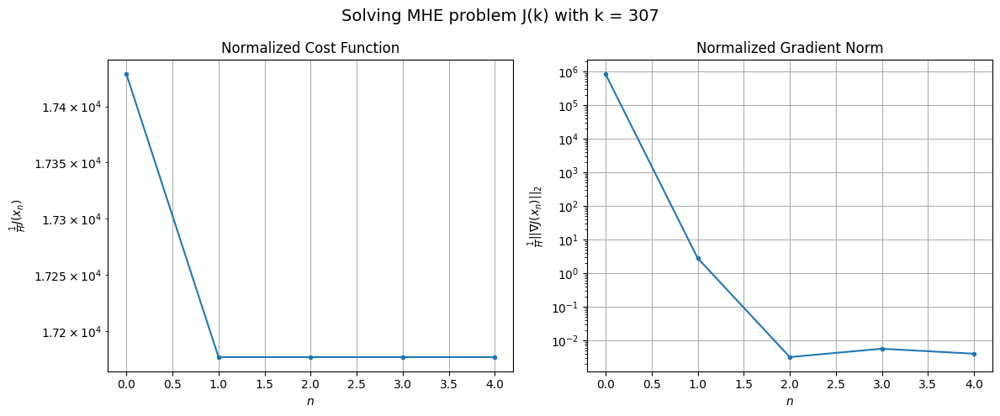

Windows:  75%|███████▍  | 259/346 [44:03<15:42, 10.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 940227.6783347924
Gradient norm: 42783199.728788406
Global estimation error: 37.18546671371253
Initial conditions estimation errors: 17.873364607209368 m, 17.724351731444816 m, 19.225369185130493 m, 19.481351911690794 m
Position estimation errors: 44.5018868172033 m, 41.61266389315158 m, 47.68891851668662 m, 38.474531262508265 m

[Gauss-Newton] Iteration 1
Cost function: 926113.9821139702 (-1.50%)
Gradient norm: 316.9719919019659 (-100.00%)
Global estimation error: 42.04896849323934 (13.08%)
Initial conditions estimation errors: 20.495656428436686 m, 20.70325188591858 m, 21.284468736612663 m, 21.595830540381726 m
Position estimation errors: 39.29055708752541 m, 37.03297513698959 m, 42.03543030075056 m, 35.16515965871844 m

[Gauss-Newton] Iteration 2
Cost function: 926113.9819725598 (-0.00%)
Gradient norm: 0.36386836608278456 (-99.89%)
Global estimation error: 42.052907298346156 (0.01%)
Initial conditions estimation errors: 20.

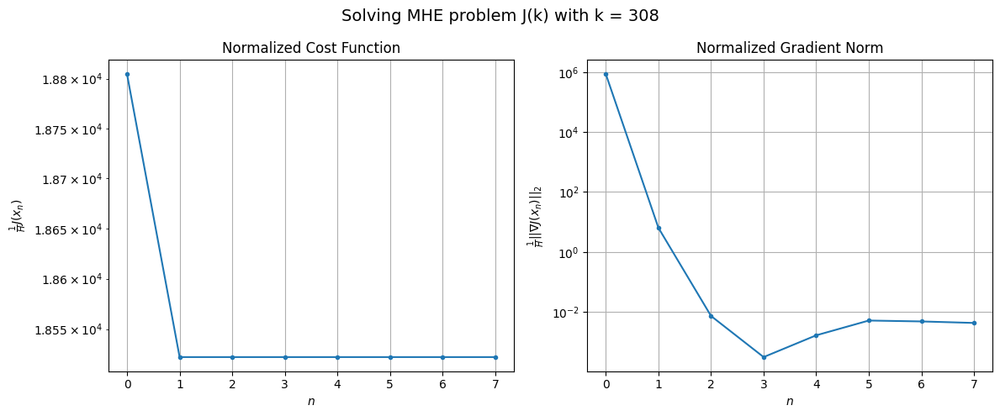

Windows:  75%|███████▌  | 260/346 [44:12<14:54, 10.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1009360.7984035517
Gradient norm: 43565232.19642627
Global estimation error: 40.090529788632686
Initial conditions estimation errors: 19.17940122983595 m, 19.85660260817724 m, 19.762456244426343 m, 21.32013104854791 m
Position estimation errors: 45.72117648938127 m, 43.5752659472331 m, 49.128186604474 m, 41.45764113568393 m

[Gauss-Newton] Iteration 1
Cost function: 993565.2225987631 (-1.56%)
Gradient norm: 68.6090359062063 (-100.00%)
Global estimation error: 45.97194323693532 (14.67%)
Initial conditions estimation errors: 22.202752243071387 m, 23.042916298085714 m, 22.175673799536952 m, 24.448030367875614 m
Position estimation errors: 40.23538506949525 m, 37.13854734898229 m, 43.47260418803188 m, 35.19318490299488 m

[Gauss-Newton] Iteration 2
Cost function: 993565.2226013916 (0.00%)
Gradient norm: 0.03256705479179746 (-99.95%)
Global estimation error: 45.97157072694903 (-0.00%)
Initial conditions estimation errors: 22.202751

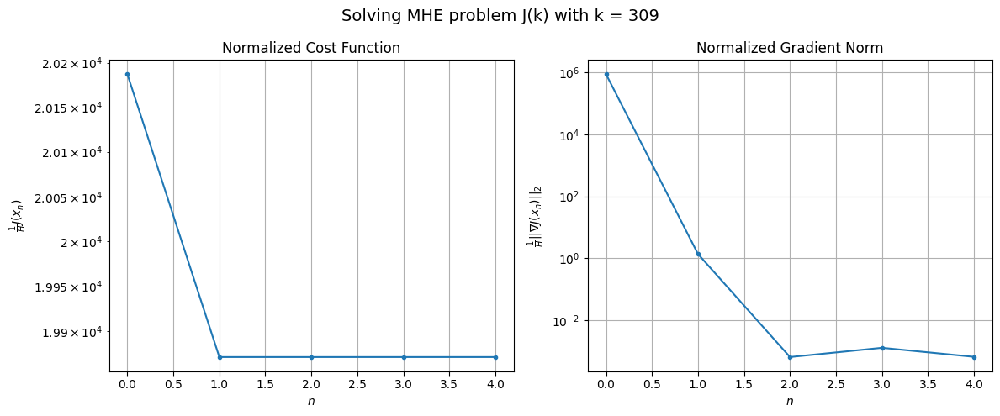

Windows:  75%|███████▌  | 261/346 [44:18<12:51,  9.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1077213.211214065
Gradient norm: 43945932.11514214
Global estimation error: 43.35941911168985
Initial conditions estimation errors: 20.467953001948118 m, 21.94864098376767 m, 20.20050311895812 m, 23.90149721076631 m
Position estimation errors: 46.551226603971 m, 43.600299906598735 m, 50.23948060578912 m, 41.441641772228955 m

[Gauss-Newton] Iteration 1
Cost function: 1060093.075863716 (-1.59%)
Gradient norm: 109.62536629861629 (-100.00%)
Global estimation error: 49.144167482591406 (13.34%)
Initial conditions estimation errors: 23.76305726761578 m, 24.74183496100126 m, 23.297959102654445 m, 26.3722316143504 m
Position estimation errors: 40.83691652359678 m, 38.797386912979775 m, 43.048378192738674 m, 36.53712954723362 m

[Gauss-Newton] Iteration 2
Cost function: 1060093.0758408161 (-0.00%)
Gradient norm: 0.04067355013377607 (-99.96%)
Global estimation error: 49.14477161788741 (0.00%)
Initial conditions estimation errors: 23.763

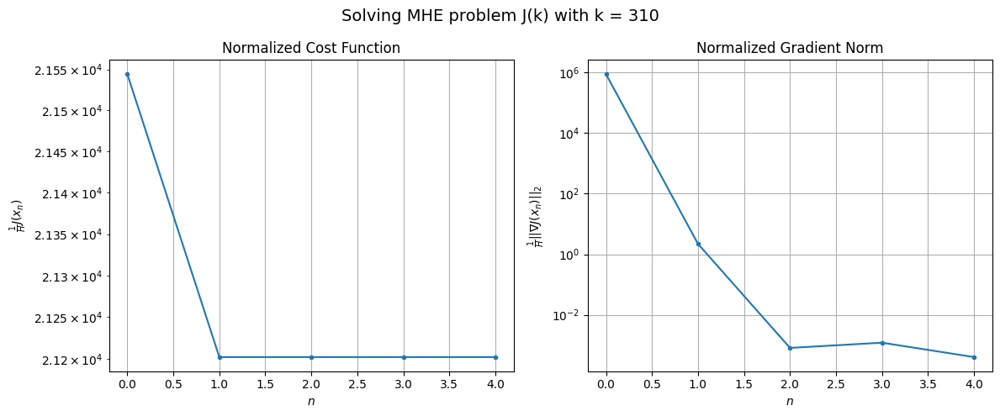

Windows:  76%|███████▌  | 262/346 [44:24<11:28,  8.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1143066.9538473624
Gradient norm: 44096171.58395118
Global estimation error: 45.44689286831782
Initial conditions estimation errors: 21.661754687502118 m, 22.998507594074 m, 21.017239518707004 m, 25.010257829368832 m
Position estimation errors: 46.99605490241758 m, 45.16237025444124 m, 49.43771740776884 m, 42.868081300065036 m

[Gauss-Newton] Iteration 1
Cost function: 1124782.5555510717 (-1.60%)
Gradient norm: 195.38154180370137 (-100.00%)
Global estimation error: 51.958809621117545 (14.33%)
Initial conditions estimation errors: 25.1387732375912 m, 26.521414534050198 m, 24.135733629518658 m, 27.961047687016812 m
Position estimation errors: 41.062290749978594 m, 38.84744215245479 m, 43.10773225086836 m, 38.302554851222254 m

[Gauss-Newton] Iteration 2
Cost function: 1124782.555538199 (-0.00%)
Gradient norm: 0.31562780533152346 (-99.84%)
Global estimation error: 51.96351714804798 (0.01%)
Initial conditions estimation errors: 25

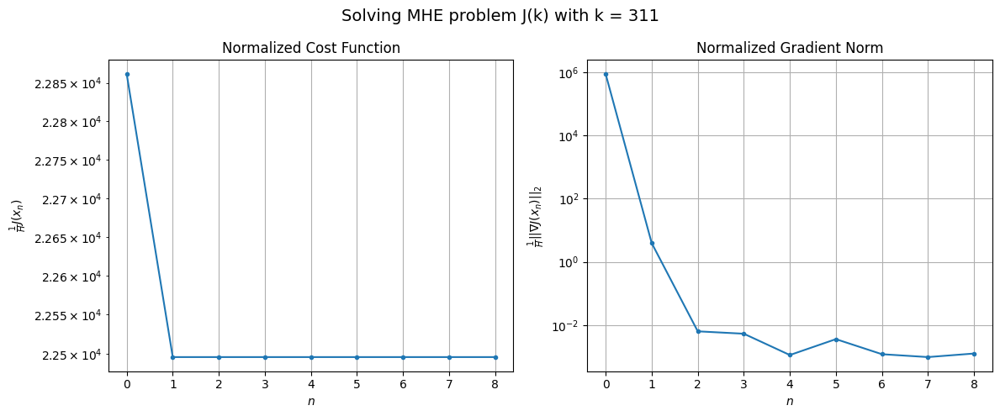

Windows:  76%|███████▌  | 263/346 [44:35<12:25,  8.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1203543.8188960901
Gradient norm: 43771235.73582916
Global estimation error: 47.4003949681324
Initial conditions estimation errors: 22.77036090084813 m, 24.41329544493414 m, 21.627180681249293 m, 25.778745489579354 m
Position estimation errors: 47.06286735805494 m, 45.136153138831936 m, 49.17973256357572 m, 44.81614938851076 m

[Gauss-Newton] Iteration 1
Cost function: 1184643.5365011261 (-1.57%)
Gradient norm: 355.09894688078 (-100.00%)
Global estimation error: 53.96851675177113 (13.86%)
Initial conditions estimation errors: 26.333566409210906 m, 27.949545929219184 m, 24.57814319719418 m, 28.876630287201863 m
Position estimation errors: 40.9914968372951 m, 39.90426963002268 m, 42.38841043130203 m, 40.44929211871397 m

[Gauss-Newton] Iteration 2
Cost function: 1184643.5363853779 (-0.00%)
Gradient norm: 0.043750547875902525 (-99.99%)
Global estimation error: 53.97034692897893 (0.00%)
Initial conditions estimation errors: 26.333

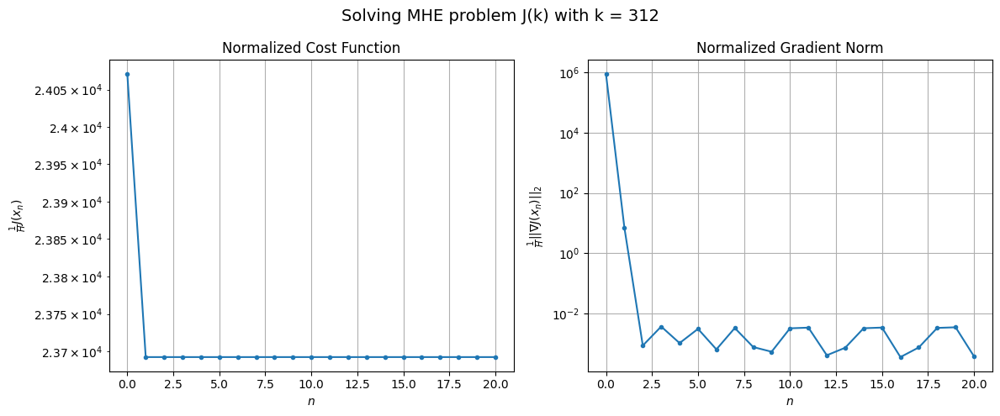

Windows:  76%|███████▋  | 264/346 [45:01<19:04, 13.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1260091.9512919977
Gradient norm: 43847518.72820179
Global estimation error: 48.74853547578365
Initial conditions estimation errors: 23.797881063218686 m, 25.418393443282664 m, 22.08736871541503 m, 26.00217872088033 m
Position estimation errors: 46.87648568100642 m, 46.20191776977848 m, 47.98193422739199 m, 47.15009511632872 m

[Gauss-Newton] Iteration 1
Cost function: 1240379.8521160595 (-1.56%)
Gradient norm: 2157.728558814088 (-100.00%)
Global estimation error: 55.64511785876224 (14.15%)
Initial conditions estimation errors: 27.43938901829452 m, 28.25568946152976 m, 28.393444218394315 m, 27.182067999340504 m
Position estimation errors: 40.635577330005084 m, 39.4132985526475 m, 41.141384793864155 m, 39.5771791511873 m

[Gauss-Newton] Iteration 2
Cost function: 1240379.850121487 (-0.00%)
Gradient norm: 0.07868328332798555 (-100.00%)
Global estimation error: 55.64912371039911 (0.01%)
Initial conditions estimation errors: 27.43

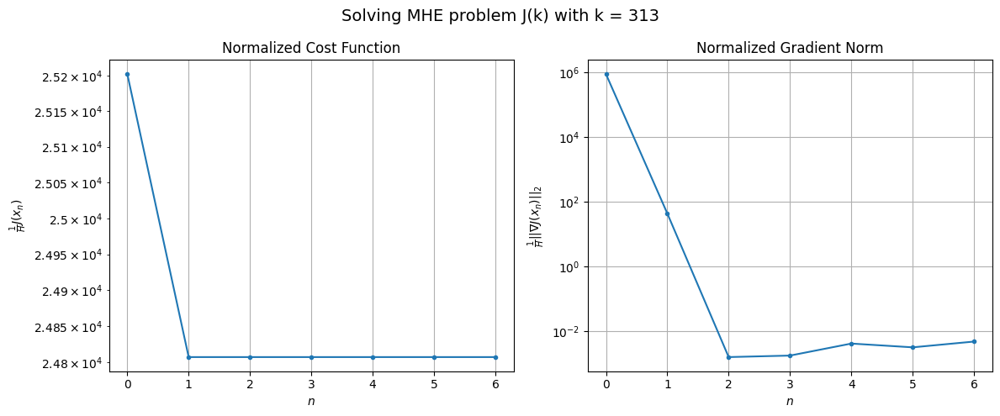

Windows:  77%|███████▋  | 265/346 [45:09<16:44, 12.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1310146.9960446747
Gradient norm: 43512504.177899495
Global estimation error: 50.48768934833815
Initial conditions estimation errors: 24.803249511998704 m, 25.81327029865197 m, 25.52980319202152 m, 24.81308651734333 m
Position estimation errors: 46.46508581226683 m, 45.35942229510528 m, 47.36727459169784 m, 45.27075375769595 m

[Gauss-Newton] Iteration 1
Cost function: 1290208.003765971 (-1.52%)
Gradient norm: 158.67631611428388 (-100.00%)
Global estimation error: 58.110001956120286 (15.10%)
Initial conditions estimation errors: 28.452465079969606 m, 29.633227567874773 m, 28.60911686816013 m, 29.505894996642336 m
Position estimation errors: 40.14648204495488 m, 38.97774961135239 m, 39.85115761106998 m, 38.25819815176383 m

[Gauss-Newton] Iteration 2
Cost function: 1290208.0037623907 (-0.00%)
Gradient norm: 0.1923863879433958 (-99.88%)
Global estimation error: 58.10918851585709 (-0.00%)
Initial conditions estimation errors: 28.

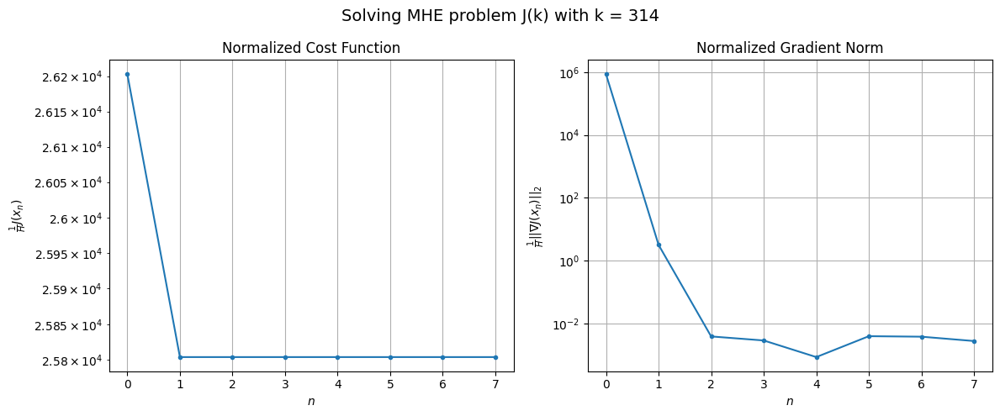

Windows:  77%|███████▋  | 266/346 [45:19<15:30, 11.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1356029.069175924
Gradient norm: 43430122.90444956
Global estimation error: 52.949560928550106
Initial conditions estimation errors: 25.76470268541115 m, 27.110526167252974 m, 25.898628681374856 m, 27.094222191935373 m
Position estimation errors: 45.97263618758359 m, 44.97421678894699 m, 45.80352850856458 m, 44.15996544034818 m

[Gauss-Newton] Iteration 1
Cost function: 1335863.0818388734 (-1.49%)
Gradient norm: 536.5455982460901 (-100.00%)
Global estimation error: 60.824596524969806 (14.87%)
Initial conditions estimation errors: 29.378960439669264 m, 30.8742472809877 m, 28.5079221171907 m, 32.71951087094704 m
Position estimation errors: 39.554554042737415 m, 38.50082858162954 m, 39.641873997918786 m, 37.98787405486559 m

[Gauss-Newton] Iteration 2
Cost function: 1335863.081750951 (-0.00%)
Gradient norm: 0.15271770260094625 (-99.97%)
Global estimation error: 60.828920655483714 (0.01%)
Initial conditions estimation errors: 29.3

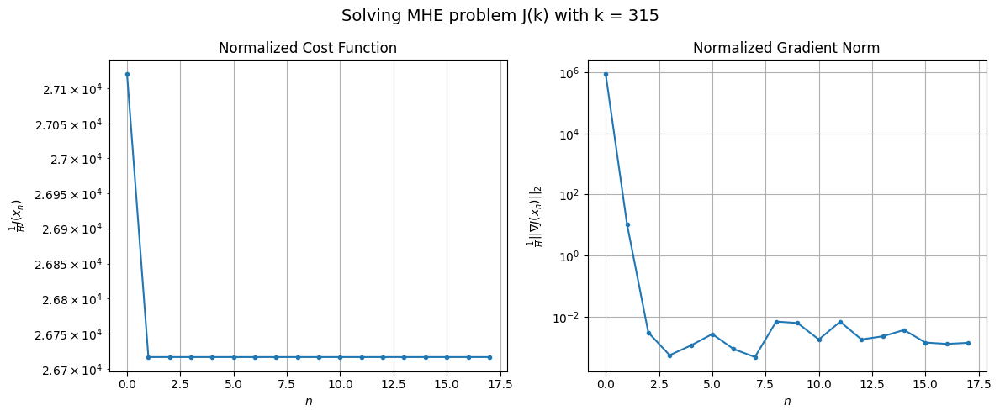

Windows:  77%|███████▋  | 267/346 [45:41<19:15, 14.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1395839.7304612745
Gradient norm: 43157254.92837641
Global estimation error: 55.51334722233273
Initial conditions estimation errors: 26.683831439016107 m, 28.238559897799504 m, 25.911827899786967 m, 30.01411378467013 m
Position estimation errors: 45.38792503017809 m, 44.57891152125815 m, 45.31349730639663 m, 44.288922310449564 m

[Gauss-Newton] Iteration 1
Cost function: 1375574.153635417 (-1.45%)
Gradient norm: 466.33524769771054 (-100.00%)
Global estimation error: 63.413947737378656 (14.23%)
Initial conditions estimation errors: 30.289619392932707 m, 31.751521515204534 m, 30.61817735423723 m, 34.03256547279647 m
Position estimation errors: 38.92612856787239 m, 37.91667731169883 m, 39.78661499520316 m, 36.5002856185205 m

[Gauss-Newton] Iteration 2
Cost function: 1375574.1535060194 (-0.00%)
Gradient norm: 0.23172490040668725 (-99.95%)
Global estimation error: 63.416481684751744 (0.00%)
Initial conditions estimation errors: 30

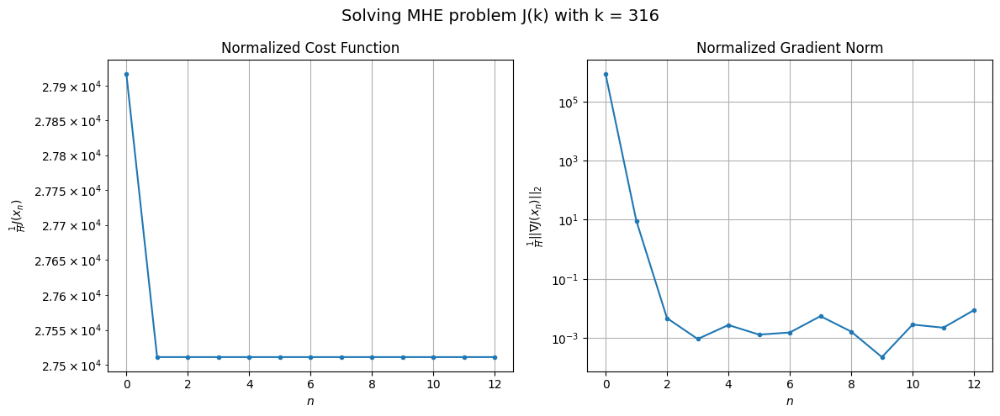

Windows:  77%|███████▋  | 268/346 [45:57<19:31, 15.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1429986.3099813932
Gradient norm: 42794950.043231495
Global estimation error: 58.18559758904411
Initial conditions estimation errors: 27.590544887266482 m, 29.233942733597814 m, 27.722619250886023 m, 31.640798650195194 m
Position estimation errors: 44.72962016748154 m, 43.91660836745097 m, 45.808836048177724 m, 42.559184236434014 m

[Gauss-Newton] Iteration 1
Cost function: 1409853.2047224308 (-1.41%)
Gradient norm: 529.7875825860887 (-100.00%)
Global estimation error: 64.98556245280815 (11.69%)
Initial conditions estimation errors: 31.15760943595937 m, 32.50170321606093 m, 33.36783952695979 m, 32.90187144097691 m
Position estimation errors: 38.2594292968748 m, 37.275049868921975 m, 39.665824783038936 m, 35.81890146046712 m

[Gauss-Newton] Iteration 2
Cost function: 1409853.2046035503 (-0.00%)
Gradient norm: 0.0674662360017436 (-99.99%)
Global estimation error: 64.98565336189264 (0.00%)
Initial conditions estimation errors: 31

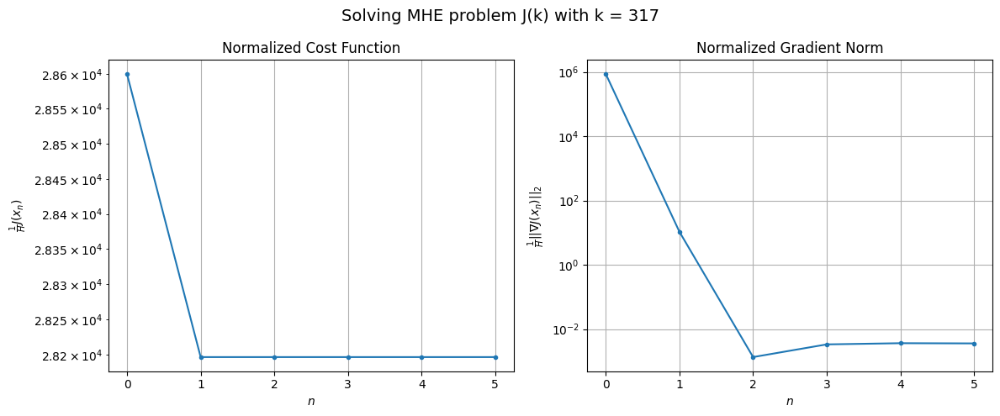

Windows:  78%|███████▊  | 269/346 [46:05<16:25, 12.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1457246.9320722534
Gradient norm: 42260855.581760645
Global estimation error: 59.66697288503151
Initial conditions estimation errors: 28.412028420575094 m, 30.03588494954228 m, 30.18057702422381 m, 30.65719772185698 m
Position estimation errors: 43.94805157327789 m, 43.08832930747731 m, 45.8634659112369 m, 41.45311510051456 m

[Gauss-Newton] Iteration 1
Cost function: 1437329.5887880886 (-1.37%)
Gradient norm: 640.0945707538341 (-100.00%)
Global estimation error: 68.65906488294813 (15.07%)
Initial conditions estimation errors: 31.96001872962256 m, 34.323118455465085 m, 32.39928518958229 m, 38.27289062426529 m
Position estimation errors: 37.51241513691536 m, 36.28806683875078 m, 37.85806291956679 m, 34.771333679925775 m

[Gauss-Newton] Iteration 2
Cost function: 1437329.588700133 (-0.00%)
Gradient norm: 0.13025765080950655 (-99.98%)
Global estimation error: 68.65458527274751 (-0.01%)
Initial conditions estimation errors: 31.960

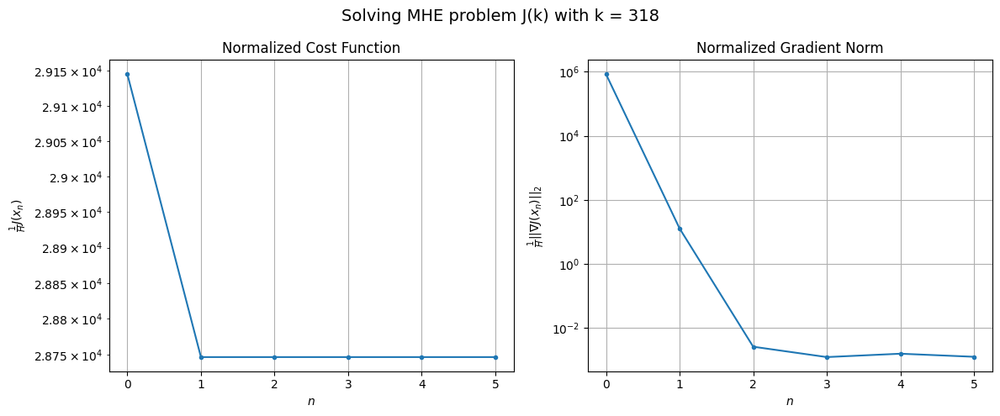

Windows:  78%|███████▊  | 270/346 [46:12<14:21, 11.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1478236.0148549413
Gradient norm: 41766795.27122891
Global estimation error: 63.24874323011332
Initial conditions estimation errors: 29.10425029445565 m, 31.692960741470735 m, 29.4447189958652 m, 35.80351590247295 m
Position estimation errors: 42.97995297962586 m, 41.915273993307515 m, 43.438518948562894 m, 40.449477449443215 m

[Gauss-Newton] Iteration 1
Cost function: 1458642.6375344975 (-1.33%)
Gradient norm: 159.33498337653515 (-100.00%)
Global estimation error: 67.37679859175988 (6.53%)
Initial conditions estimation errors: 32.629045974542095 m, 33.3348407982904 m, 32.373137741121774 m, 36.27293667029735 m
Position estimation errors: 36.605048425207904 m, 36.67498580502601 m, 37.82551800311443 m, 35.82262962720051 m

[Gauss-Newton] Iteration 2
Cost function: 1458642.6374916686 (-0.00%)
Gradient norm: 0.0974694252359378 (-99.94%)
Global estimation error: 67.38296107357738 (0.01%)
Initial conditions estimation errors: 32.62

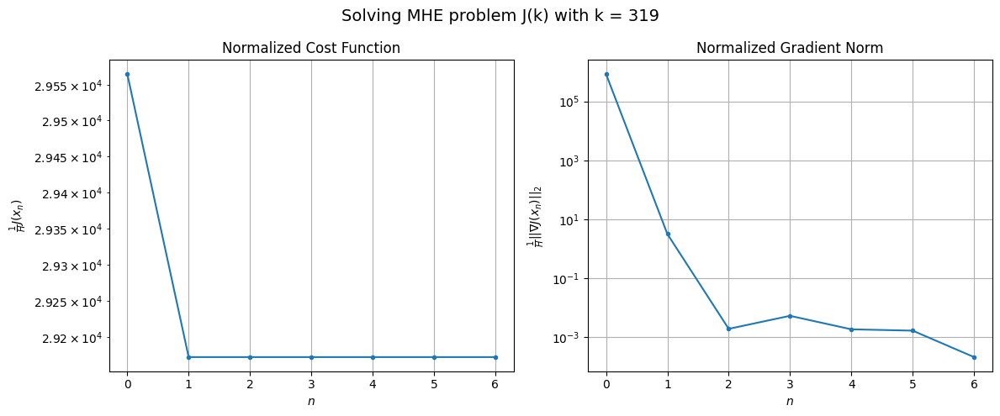

Windows:  78%|███████▊  | 271/346 [46:21<13:04, 10.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1493083.0455861555
Gradient norm: 40895236.25987092
Global estimation error: 61.20329449199029
Initial conditions estimation errors: 29.643837916037924 m, 30.237580248482352 m, 29.236562517561367 m, 33.135761539454606 m
Position estimation errors: 41.746846321696914 m, 41.951648690499944 m, 43.043166793400225 m, 41.27381822747174 m

[Gauss-Newton] Iteration 1
Cost function: 1474055.0236534672 (-1.27%)
Gradient norm: 141.05094158845358 (-100.00%)
Global estimation error: 69.75353988239257 (13.97%)
Initial conditions estimation errors: 33.12954327809005 m, 35.407900191798475 m, 32.13925665609429 m, 38.487885447022386 m
Position estimation errors: 35.48118441129632 m, 35.42032706445888 m, 36.694432384496515 m, 35.346068566588485 m

[Gauss-Newton] Iteration 2
Cost function: 1474055.023606617 (-0.00%)
Gradient norm: 0.13476225606462183 (-99.90%)
Global estimation error: 69.75197295513337 (-0.00%)
Initial conditions estimation error

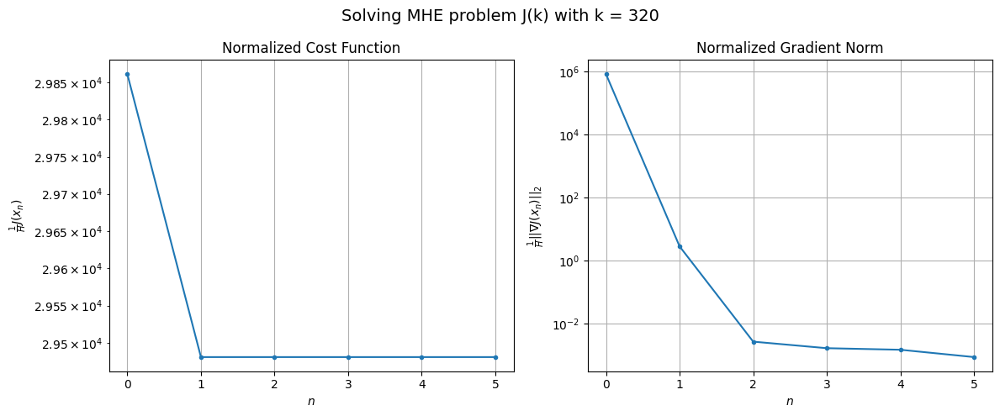

Windows:  79%|███████▊  | 272/346 [46:28<11:43,  9.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1500130.7923699918
Gradient norm: 39408985.232878655
Global estimation error: 63.37413313887354
Initial conditions estimation errors: 30.045544965058788 m, 32.20852737362442 m, 29.004300684615664 m, 35.14096801445047 m
Position estimation errors: 40.19587342551485 m, 40.320079910579224 m, 41.37637232200695 m, 40.39291238164415 m

[Gauss-Newton] Iteration 1
Cost function: 1482052.8842707274 (-1.21%)
Gradient norm: 802.908842308373 (-100.00%)
Global estimation error: 72.63953326464451 (14.62%)
Initial conditions estimation errors: 33.49861955852576 m, 36.196638852305746 m, 30.88809138130787 m, 43.474725625413605 m
Position estimation errors: 34.14559407126296 m, 34.13331310290907 m, 35.025149501168 m, 36.24113136939288 m

[Gauss-Newton] Iteration 2
Cost function: 1482052.884094088 (-0.00%)
Gradient norm: 0.03241767422030885 (-100.00%)
Global estimation error: 72.63356843943265 (-0.01%)
Initial conditions estimation errors: 33.49

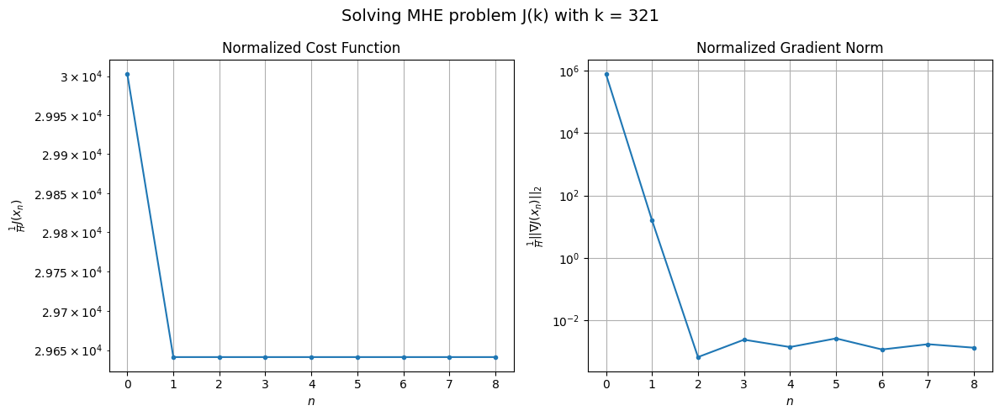

Windows:  79%|███████▉  | 273/346 [46:39<12:00,  9.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1498811.4454589062
Gradient norm: 37879068.366906114
Global estimation error: 65.92193264176667
Initial conditions estimation errors: 30.35112022910872 m, 32.79480620737 m, 27.918167622496142 m, 39.617760782635855 m
Position estimation errors: 38.35686917300474 m, 38.49847946838324 m, 38.87775849770329 m, 40.69737872691457 m

[Gauss-Newton] Iteration 1
Cost function: 1481650.7583631773 (-1.14%)
Gradient norm: 123.35680132595076 (-100.00%)
Global estimation error: 73.92860500096177 (12.15%)
Initial conditions estimation errors: 33.79441233361546 m, 35.8160977497726 m, 31.858752935268022 m, 45.00646139688194 m
Position estimation errors: 32.54353486108989 m, 32.54751334647342 m, 33.080161776514906 m, 35.684291348539276 m

[Gauss-Newton] Iteration 2
Cost function: 1481650.7583338253 (-0.00%)
Gradient norm: 0.14083067045211736 (-99.89%)
Global estimation error: 73.92959603654457 (0.00%)
Initial conditions estimation errors: 33.794

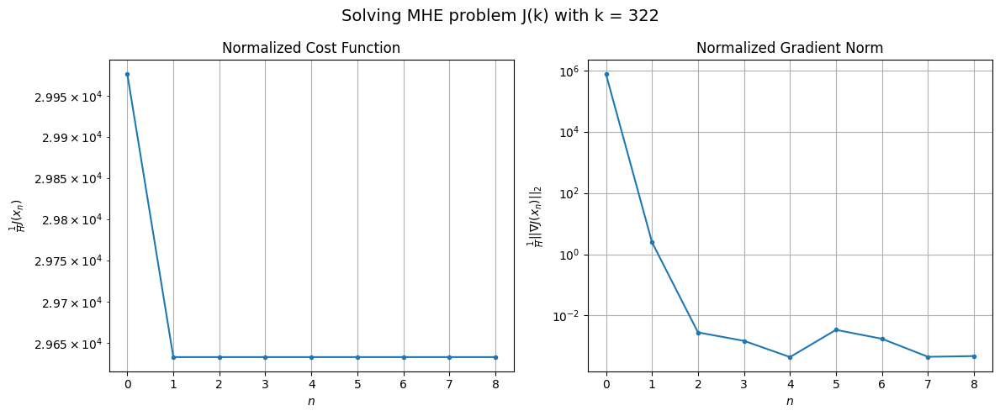

Windows:  79%|███████▉  | 274/346 [46:50<12:11, 10.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1489899.3244141436
Gradient norm: 36265596.117396444
Global estimation error: 67.10890795313777
Initial conditions estimation errors: 30.59021993706788 m, 32.37474283515928 m, 28.808994507675838 m, 41.10645973365748 m
Position estimation errors: 36.24073585740565 m, 36.338313568935675 m, 36.51705947307886 m, 39.469396569102884 m

[Gauss-Newton] Iteration 1
Cost function: 1473809.7565408093 (-1.08%)
Gradient norm: 164.00136323489562 (-100.00%)
Global estimation error: 74.44616119054565 (10.93%)
Initial conditions estimation errors: 34.02388000503681 m, 37.0803563369221 m, 31.12548401964118 m, 45.17560929820507 m
Position estimation errors: 30.72015108887938 m, 30.691251294953886 m, 30.853756500757644 m, 34.75133269799911 m

[Gauss-Newton] Iteration 2
Cost function: 1473809.756558545 (0.00%)
Gradient norm: 0.16175633075725745 (-99.90%)
Global estimation error: 74.4584010217518 (0.02%)
Initial conditions estimation errors: 34.023

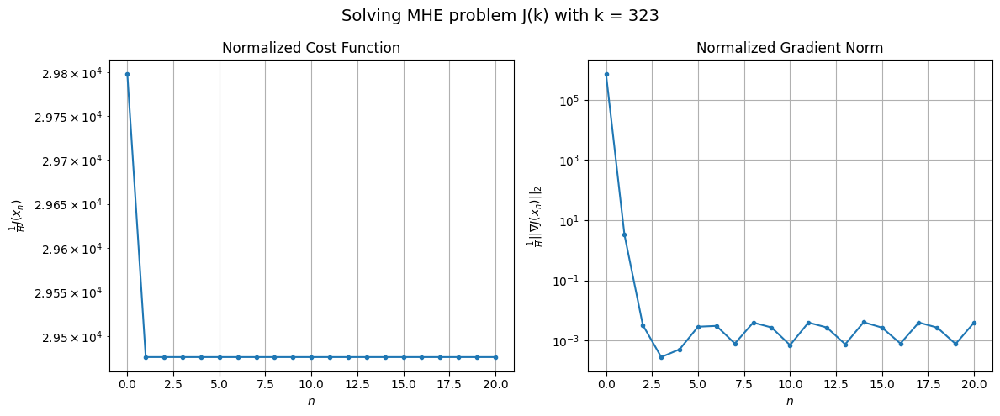

Windows:  79%|███████▉  | 275/346 [47:14<17:05, 14.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1473748.0556070565
Gradient norm: 34387452.83767558
Global estimation error: 67.46646790048807
Initial conditions estimation errors: 30.743234396614707 m, 33.5407862160032 m, 28.10382578867706 m, 41.13084914191879 m
Position estimation errors: 33.99090318704686 m, 34.00251057958216 m, 33.70686418294061 m, 37.96736890475293 m

[Gauss-Newton] Iteration 1
Cost function: 1458886.5725549331 (-1.01%)
Gradient norm: 936.3152605342914 (-100.00%)
Global estimation error: 70.18068644096819 (4.02%)
Initial conditions estimation errors: 34.177451769511805 m, 34.67176238019856 m, 33.6193234479287 m, 37.74675727976893 m
Position estimation errors: 28.84423113857912 m, 28.86092383459156 m, 28.618078877719356 m, 30.293330272167378 m

[Gauss-Newton] Iteration 2
Cost function: 1458886.5723752014 (-0.00%)
Gradient norm: 0.029251500683614193 (-100.00%)
Global estimation error: 70.16262712540556 (-0.03%)
Initial conditions estimation errors: 34.17

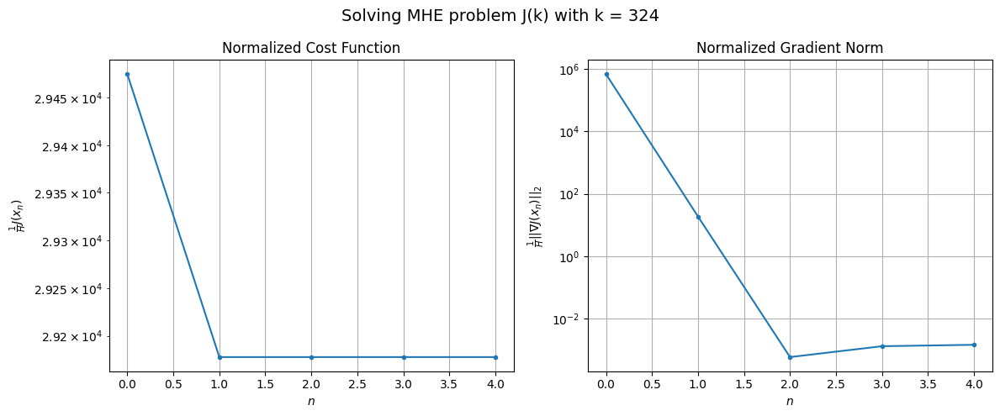

Windows:  80%|███████▉  | 276/346 [47:20<13:57, 11.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1451799.7766575504
Gradient norm: 32593438.789768588
Global estimation error: 63.0071296471951
Initial conditions estimation errors: 30.781277926431486 m, 31.02863573617941 m, 30.298597443418014 m, 33.78768317431002 m
Position estimation errors: 31.830724950400366 m, 31.85423412695666 m, 31.51223762999623 m, 33.383625773059876 m

[Gauss-Newton] Iteration 1
Cost function: 1438008.9707534264 (-0.95%)
Gradient norm: 254.53704398995004 (-100.00%)
Global estimation error: 68.16070117363977 (8.18%)
Initial conditions estimation errors: 34.23062163352621 m, 34.07823094788388 m, 35.048653618376605 m, 32.93004668026379 m
Position estimation errors: 27.056932073176796 m, 26.558378259904302 m, 25.82132806085832 m, 27.579781313098376 m

[Gauss-Newton] Iteration 2
Cost function: 1438008.9707448469 (-0.00%)
Gradient norm: 0.21889389360129288 (-99.91%)
Global estimation error: 68.15994512260738 (-0.00%)
Initial conditions estimation errors: 

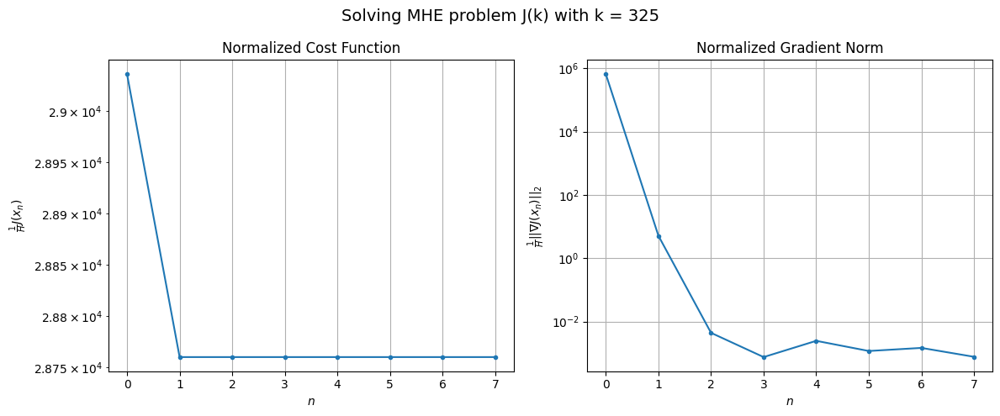

Windows:  80%|████████  | 277/346 [47:30<12:55, 11.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1423994.3610343703
Gradient norm: 30898218.508536372
Global estimation error: 60.92159929512445
Initial conditions estimation errors: 30.680647124446647 m, 30.33507382129913 m, 31.65146683028516 m, 29.121876319400275 m
Position estimation errors: 29.878755928900368 m, 29.316205855902496 m, 28.584384397602086 m, 30.422483643262034 m

[Gauss-Newton] Iteration 1
Cost function: 1411165.0817647676 (-0.90%)
Gradient norm: 1943.0599245955368 (-99.99%)
Global estimation error: 66.52246316577526 (9.19%)
Initial conditions estimation errors: 34.177300101370236 m, 31.41049443266088 m, 37.69443610234618 m, 29.14851229808783 m
Position estimation errors: 25.511451945355013 m, 25.84046080541599 m, 26.05851863077848 m, 29.252416896558355 m

[Gauss-Newton] Iteration 2
Cost function: 1411165.0810137845 (-0.00%)
Gradient norm: 0.37414484123467145 (-99.98%)
Global estimation error: 66.53071170855236 (0.01%)
Initial conditions estimation errors: 

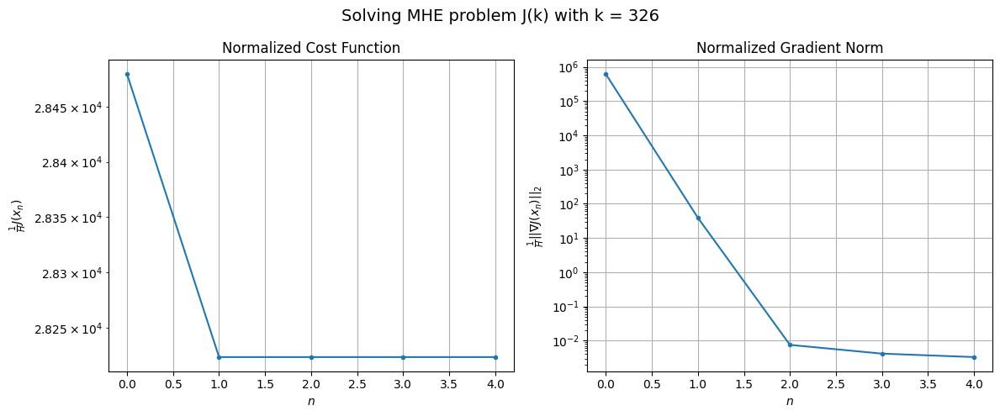

Windows:  80%|████████  | 278/346 [47:36<11:07,  9.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1392900.952493011
Gradient norm: 29394163.13319082
Global estimation error: 59.50762119248889
Initial conditions estimation errors: 30.467009914838986 m, 27.776186310741355 m, 33.81740305223131 m, 26.415171390022845 m
Position estimation errors: 28.257683300794024 m, 28.3498593606944 m, 28.78096559950505 m, 31.330929416731927 m

[Gauss-Newton] Iteration 1
Cost function: 1380843.5084788615 (-0.87%)
Gradient norm: 134.32715610342234 (-100.00%)
Global estimation error: 65.99252306874678 (10.90%)
Initial conditions estimation errors: 34.02726413370544 m, 30.751981852389484 m, 36.98453284360973 m, 29.725281780175596 m
Position estimation errors: 24.280264629903957 m, 24.634364308615037 m, 25.473352358626876 m, 26.7272892122793 m

[Gauss-Newton] Iteration 2
Cost function: 1380843.5084772264 (-0.00%)
Gradient norm: 0.3180655428160622 (-99.76%)
Global estimation error: 65.99412150942693 (0.00%)
Initial conditions estimation errors: 34

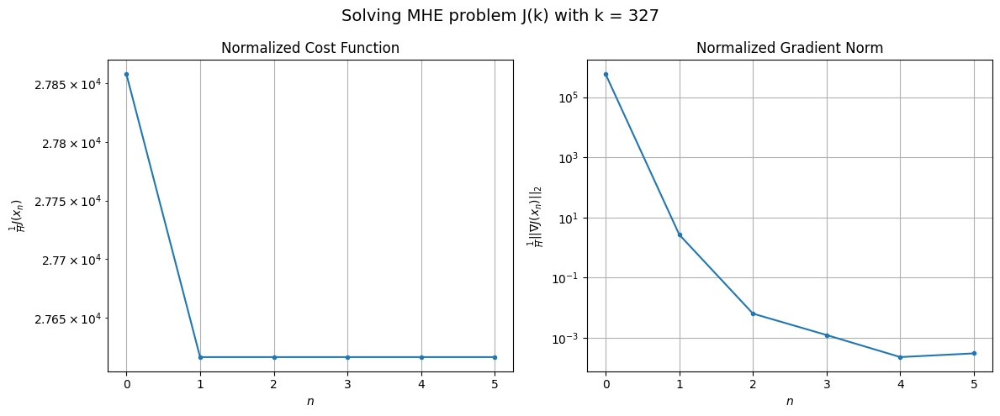

Windows:  81%|████████  | 279/346 [47:43<10:02,  9.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1359812.8982790054
Gradient norm: 28196481.387934938
Global estimation error: 58.77052382941944
Initial conditions estimation errors: 30.1949832146061 m, 27.263869606623533 m, 32.84624333320934 m, 26.833171208893862 m
Position estimation errors: 27.03027409965956 m, 27.03012054865425 m, 28.1185449599746 m, 28.80947097073244 m

[Gauss-Newton] Iteration 1
Cost function: 1348310.6704243587 (-0.85%)
Gradient norm: 235.47432609981445 (-100.00%)
Global estimation error: 65.22051157566287 (10.97%)
Initial conditions estimation errors: 33.85305764282512 m, 31.064339772021548 m, 35.00884290003697 m, 30.28277650673504 m
Position estimation errors: 23.42556038370828 m, 23.240762383040973 m, 24.086278002620556 m, 24.95357880342869 m

[Gauss-Newton] Iteration 2
Cost function: 1348310.6704419206 (0.00%)
Gradient norm: 0.19489968179120962 (-99.92%)
Global estimation error: 65.22089974294705 (0.00%)
Initial conditions estimation errors: 33.85

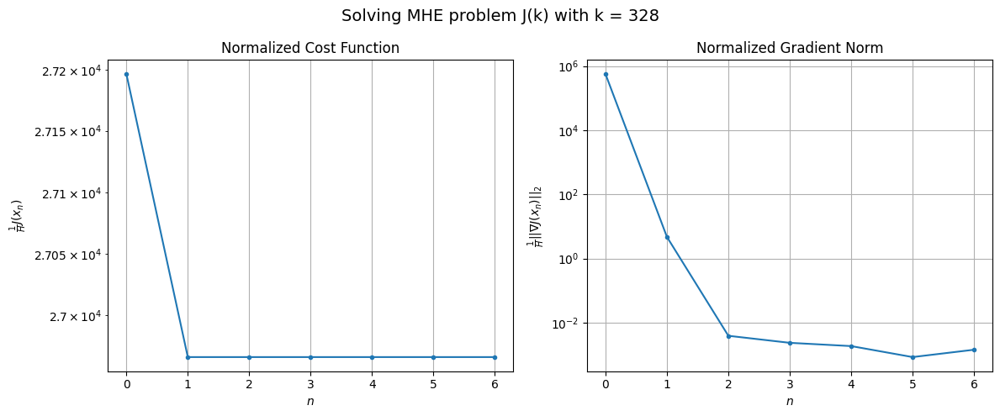

Windows:  81%|████████  | 280/346 [47:52<09:41,  8.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1325201.469298782
Gradient norm: 26753230.89731822
Global estimation error: 57.84828773260144
Initial conditions estimation errors: 29.947444669039974 m, 27.4890449228137 m, 30.890059378726935 m, 27.197556258388182 m
Position estimation errors: 26.246243041373752 m, 25.827765299543533 m, 26.838517130891994 m, 27.365949956103993 m

[Gauss-Newton] Iteration 1
Cost function: 1314093.8697925196 (-0.84%)
Gradient norm: 288.43079646829074 (-100.00%)
Global estimation error: 65.22602851692577 (12.75%)
Initial conditions estimation errors: 33.75298392648664 m, 31.459581934449478 m, 34.178042688102146 m, 30.940256075833148 m
Position estimation errors: 23.02287468678231 m, 22.273654759215205 m, 23.288010192981503 m, 23.54910986964161 m

[Gauss-Newton] Iteration 2
Cost function: 1314093.8697148457 (-0.00%)
Gradient norm: 0.17267768678030335 (-99.94%)
Global estimation error: 65.22643564029178 (0.00%)
Initial conditions estimation errors

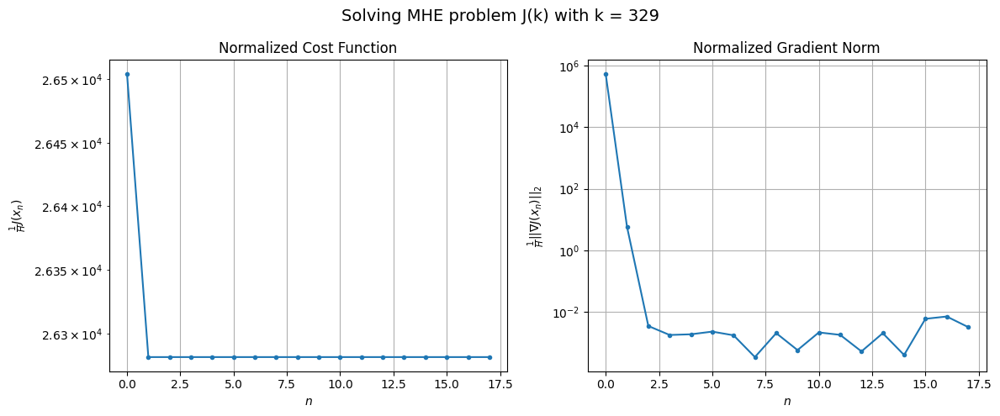

Windows:  81%|████████  | 281/346 [48:13<13:29, 12.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1291060.512295696
Gradient norm: 25586900.709771264
Global estimation error: 57.68306258319642
Initial conditions estimation errors: 29.78953688572557 m, 27.793107346956038 m, 30.130344469644246 m, 27.560832104931464 m
Position estimation errors: 25.95213238620741 m, 25.049140201712326 m, 26.16699463042062 m, 26.3212253904545 m

[Gauss-Newton] Iteration 1
Cost function: 1280151.1838572528 (-0.84%)
Gradient norm: 103.18437689641034 (-100.00%)
Global estimation error: 66.8359642102096 (15.87%)
Initial conditions estimation errors: 33.76764212039358 m, 32.65612918912341 m, 34.807994250981075 m, 32.38433010967183 m
Position estimation errors: 23.052778330107515 m, 22.076195464160016 m, 23.78213241776217 m, 22.74555319339846 m

[Gauss-Newton] Iteration 2
Cost function: 1280151.1838306908 (-0.00%)
Gradient norm: 0.02177650934310883 (-99.98%)
Global estimation error: 66.83937136386821 (0.01%)
Initial conditions estimation errors: 33.

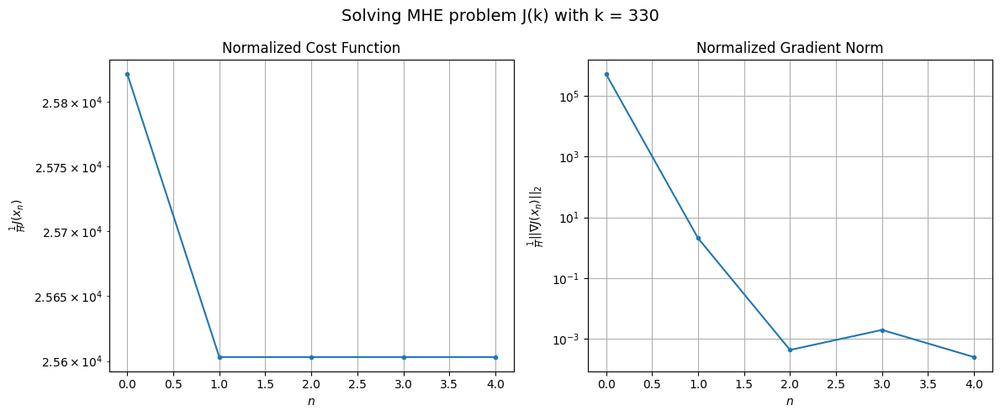

Windows:  82%|████████▏ | 282/346 [48:19<11:21, 10.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1257008.5835159111
Gradient norm: 24487946.454535194
Global estimation error: 58.95843927314504
Initial conditions estimation errors: 29.74843918094784 m, 28.840660176364224 m, 30.613328332134785 m, 28.673024523069373 m
Position estimation errors: 26.104598683613393 m, 25.016297382500646 m, 26.758139026049424 m, 25.68869611544627 m

[Gauss-Newton] Iteration 1
Cost function: 1246044.0907214915 (-0.87%)
Gradient norm: 809.2118167443637 (-100.00%)
Global estimation error: 69.76512933308705 (18.33%)
Initial conditions estimation errors: 33.94123023326127 m, 33.62310082946866 m, 37.355890053621344 m, 34.484220247599175 m
Position estimation errors: 23.45538855727821 m, 22.843389991141077 m, 26.098991915779337 m, 25.59340364034574 m

[Gauss-Newton] Iteration 2
Cost function: 1246044.0905911317 (-0.00%)
Gradient norm: 0.15309155412811387 (-99.98%)
Global estimation error: 69.77497141922338 (0.01%)
Initial conditions estimation errors

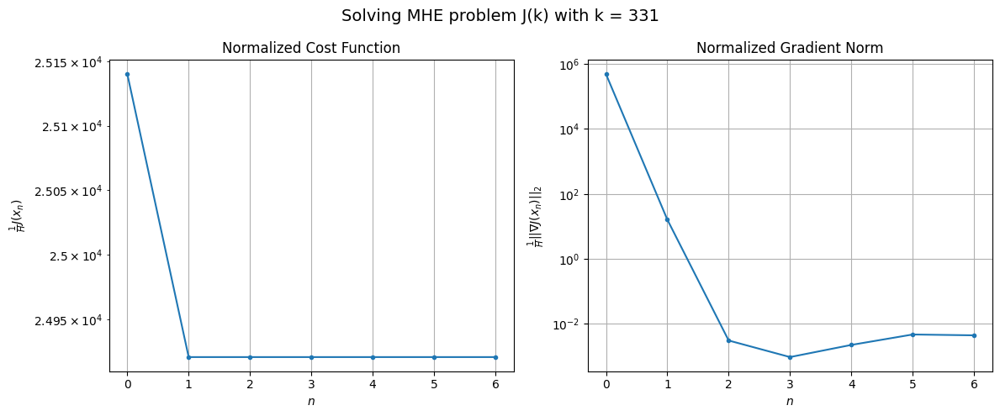

Windows:  82%|████████▏ | 283/346 [48:28<10:34, 10.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1223814.3550900822
Gradient norm: 23576286.33094302
Global estimation error: 62.39327156857175
Initial conditions estimation errors: 29.878145673922102 m, 30.029120869821902 m, 32.88050417562935 m, 31.895361639001884 m
Position estimation errors: 26.62435845195638 m, 25.758392766084047 m, 29.123275374320286 m, 27.99360767281134 m

[Gauss-Newton] Iteration 1
Cost function: 1212452.6551750463 (-0.93%)
Gradient norm: 1763.9566981528571 (-99.99%)
Global estimation error: 78.35106797477377 (25.58%)
Initial conditions estimation errors: 34.33967018507305 m, 36.34222313112149 m, 40.64019793961462 m, 44.57873745479021 m
Position estimation errors: 24.141425123145147 m, 24.867109376493033 m, 30.26526709565124 m, 36.38671894715858 m

[Gauss-Newton] Iteration 2
Cost function: 1212452.6541148466 (-0.00%)
Gradient norm: 0.22327979810481124 (-99.99%)
Global estimation error: 78.43477703441089 (0.11%)
Initial conditions estimation errors: 34

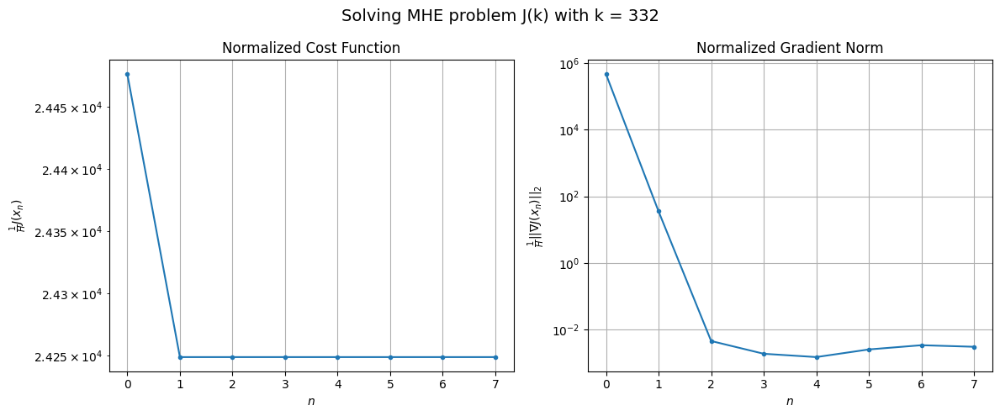

Windows:  82%|████████▏ | 284/346 [48:37<10:12,  9.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1191650.9119309566
Gradient norm: 23049590.710740097
Global estimation error: 72.2353213769583
Initial conditions estimation errors: 30.196044851258147 m, 33.425583588949884 m, 35.92580969405831 m, 43.56809106827969 m
Position estimation errors: 27.410218952639617 m, 27.302166916517123 m, 33.232858016883185 m, 37.53760208375349 m

[Gauss-Newton] Iteration 1
Cost function: 1179700.51088551 (-1.00%)
Gradient norm: 178.2725662329687 (-100.00%)
Global estimation error: 78.20630502415055 (8.27%)
Initial conditions estimation errors: 34.93800397806338 m, 37.27847589050255 m, 40.3231094578734 m, 43.357710422995005 m
Position estimation errors: 25.020748908307507 m, 24.751166657557693 m, 31.221384635309903 m, 32.26671279832852 m

[Gauss-Newton] Iteration 2
Cost function: 1179700.5108321193 (-0.00%)
Gradient norm: 0.03209811223571679 (-99.98%)
Global estimation error: 78.1746879138424 (-0.04%)
Initial conditions estimation errors: 34.9

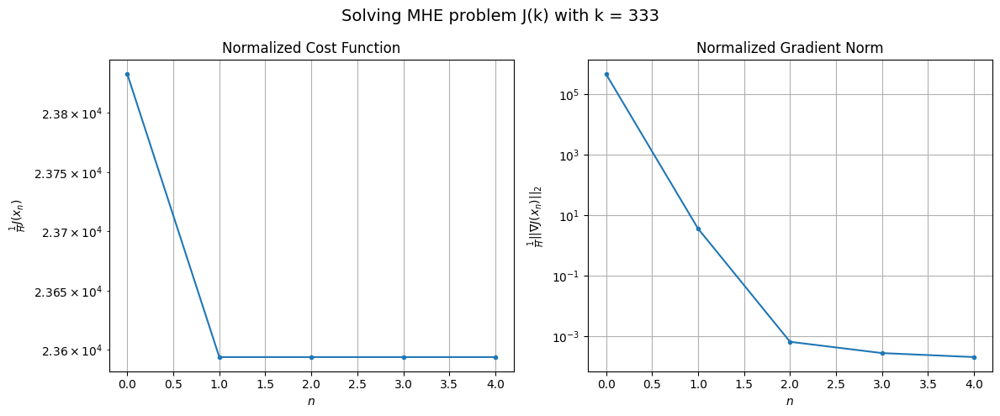

Windows:  82%|████████▏ | 285/346 [48:43<08:49,  8.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1158836.2641701784
Gradient norm: 22452046.95122385
Global estimation error: 71.24771939703965
Initial conditions estimation errors: 30.598761523101597 m, 34.11038091784638 m, 35.3832415653323 m, 41.526251147971614 m
Position estimation errors: 28.39627968276286 m, 27.28357732019942 m, 34.34549109399006 m, 33.63498186113666 m

[Gauss-Newton] Iteration 1
Cost function: 1145843.111215059 (-1.12%)
Gradient norm: 403.54487301755614 (-100.00%)
Global estimation error: 76.45248637165189 (7.31%)
Initial conditions estimation errors: 35.69723866965743 m, 37.50235272175024 m, 38.94122432584324 m, 40.593195942952015 m
Position estimation errors: 26.036340263712177 m, 24.123187826413943 m, 30.700088796101063 m, 26.792964416628465 m

[Gauss-Newton] Iteration 2
Cost function: 1145843.111148736 (-0.00%)
Gradient norm: 0.16655478687462918 (-99.96%)
Global estimation error: 76.42162104590736 (-0.04%)
Initial conditions estimation errors: 35.6

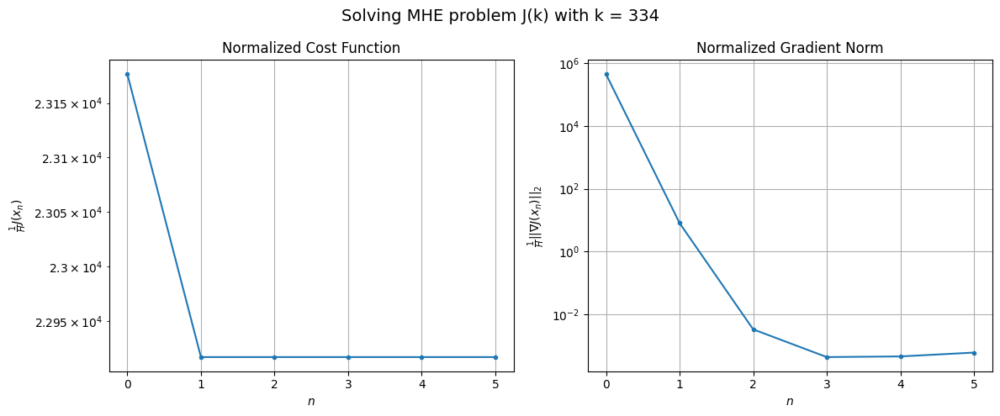

Windows:  83%|████████▎ | 286/346 [48:50<08:11,  8.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1126005.7494965822
Gradient norm: 21902987.7584636
Global estimation error: 68.21286310854894
Initial conditions estimation errors: 31.045091324014574 m, 33.754497611503915 m, 33.782777491901506 m, 37.530249671967105 m
Position estimation errors: 29.558468649777147 m, 27.033412305249367 m, 34.07092169819572 m, 28.99725855197077 m

[Gauss-Newton] Iteration 1
Cost function: 1112043.1840993962 (-1.24%)
Gradient norm: 431.218116223978 (-100.00%)
Global estimation error: 76.04742382574845 (11.49%)
Initial conditions estimation errors: 36.45285255195762 m, 37.909909510323274 m, 38.26022815370335 m, 39.4125969629031 m
Position estimation errors: 27.19170366886166 m, 24.580207197078852 m, 30.368863853858038 m, 24.847653719342173 m

[Gauss-Newton] Iteration 2
Cost function: 1112043.1840392535 (-0.00%)
Gradient norm: 0.04824790867659292 (-99.99%)
Global estimation error: 76.03649930941614 (-0.01%)
Initial conditions estimation errors: 3

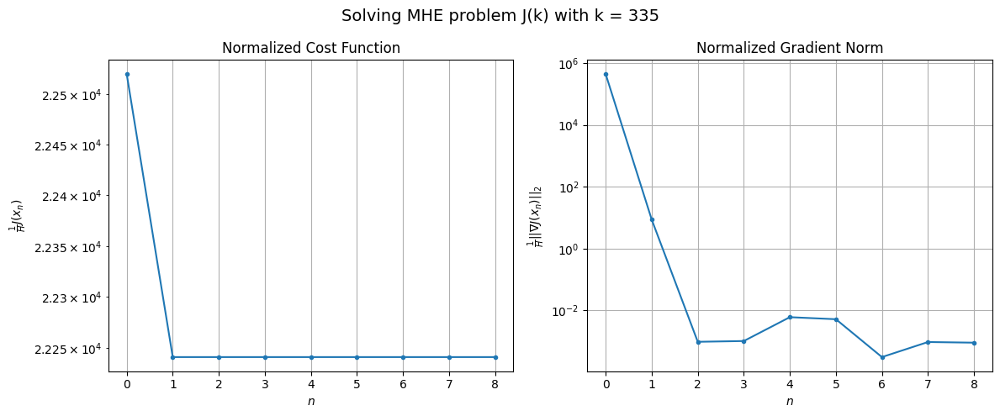

Windows:  83%|████████▎ | 287/346 [49:01<08:40,  8.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1092826.3806242992
Gradient norm: 21958874.729817953
Global estimation error: 66.54431286123331
Initial conditions estimation errors: 31.479061263997565 m, 33.453120573034816 m, 32.88469447833341 m, 35.16620210385356 m
Position estimation errors: 30.85027079593311 m, 27.948285045792357 m, 33.98912994082174 m, 27.98966845578736 m

[Gauss-Newton] Iteration 1
Cost function: 1077839.4491201218 (-1.37%)
Gradient norm: 353.0853306663178 (-100.00%)
Global estimation error: 80.76334482997464 (21.37%)
Initial conditions estimation errors: 37.17364568955705 m, 40.47361716569821 m, 39.37695894139004 m, 44.18297077662643 m
Position estimation errors: 28.42419914114802 m, 25.369860659334428 m, 33.09471882537073 m, 27.93787382315044 m

[Gauss-Newton] Iteration 2
Cost function: 1077839.4488740184 (-0.00%)
Gradient norm: 0.34587944760779143 (-99.90%)
Global estimation error: 80.7911058334458 (0.03%)
Initial conditions estimation errors: 37.17

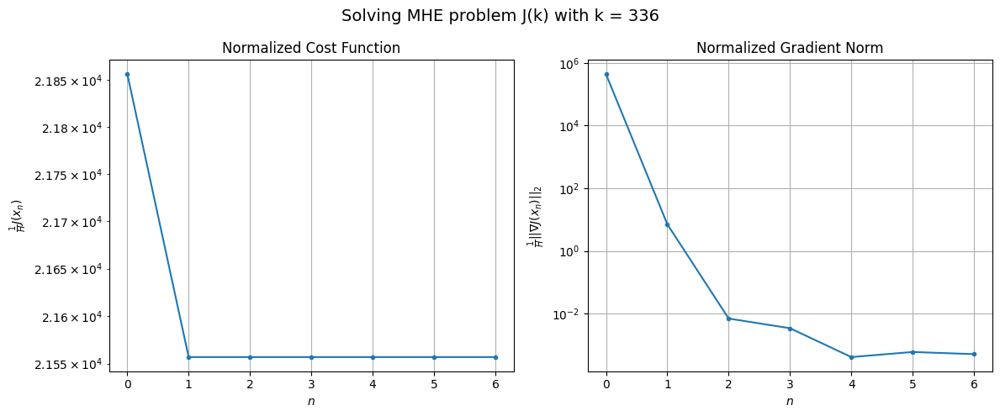

Windows:  83%|████████▎ | 288/346 [49:09<08:18,  8.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1060067.9925060624
Gradient norm: 21895625.995434213
Global estimation error: 71.63564717116759
Initial conditions estimation errors: 31.94268302055866 m, 36.0008761124432 m, 33.66797556881652 m, 41.00847133298339 m
Position estimation errors: 32.08100428283137 m, 28.54476541207847 m, 36.804940788472265 m, 30.259844149501912 m

[Gauss-Newton] Iteration 1
Cost function: 1044149.472792668 (-1.50%)
Gradient norm: 81.03249777283148 (-100.00%)
Global estimation error: 82.18667198031024 (14.73%)
Initial conditions estimation errors: 37.88618683276774 m, 41.17292304590913 m, 39.518964994492926 m, 45.412340847781664 m
Position estimation errors: 29.585462486051433 m, 26.044502108821074 m, 34.88552240199097 m, 28.024284653593117 m

[Gauss-Newton] Iteration 2
Cost function: 1044149.4727924741 (-0.00%)
Gradient norm: 0.05829031860573955 (-99.93%)
Global estimation error: 82.17574598716304 (-0.01%)
Initial conditions estimation errors: 37

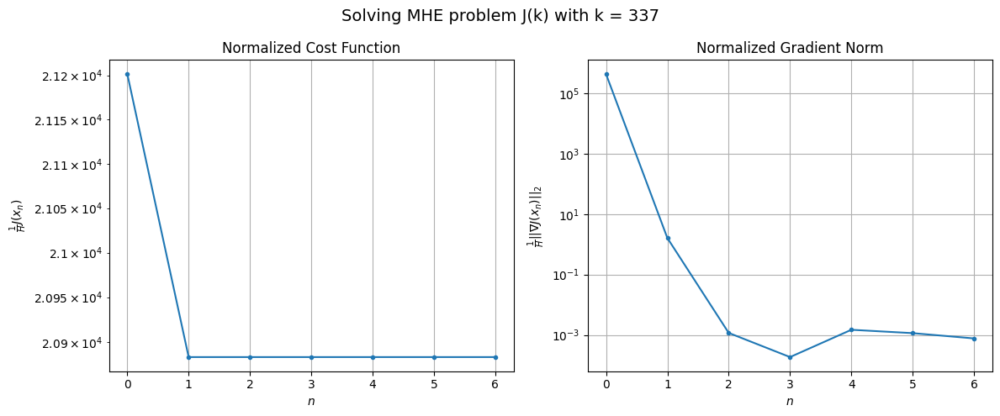

Windows:  84%|████████▎ | 289/346 [49:17<07:59,  8.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1027538.8026977902
Gradient norm: 22446132.15112704
Global estimation error: 72.6552391069476
Initial conditions estimation errors: 32.42267299821778 m, 36.552865306678584 m, 33.582830072430085 m, 41.99514744119489 m
Position estimation errors: 33.044844495014075 m, 28.993776235732557 m, 38.50742338264356 m, 30.09272455634313 m

[Gauss-Newton] Iteration 1
Cost function: 1010565.0248959287 (-1.65%)
Gradient norm: 898.6768297438093 (-100.00%)
Global estimation error: 79.4041634752129 (9.29%)
Initial conditions estimation errors: 38.60141602307482 m, 39.830982545930404 m, 38.612723383478354 m, 41.68275484258311 m
Position estimation errors: 30.441279279491283 m, 27.880297826863256 m, 32.97218875143988 m, 27.01062243722091 m

[Gauss-Newton] Iteration 2
Cost function: 1010565.0243327859 (-0.00%)
Gradient norm: 0.18551561192998084 (-99.98%)
Global estimation error: 79.41237552122053 (0.01%)
Initial conditions estimation errors: 38.6

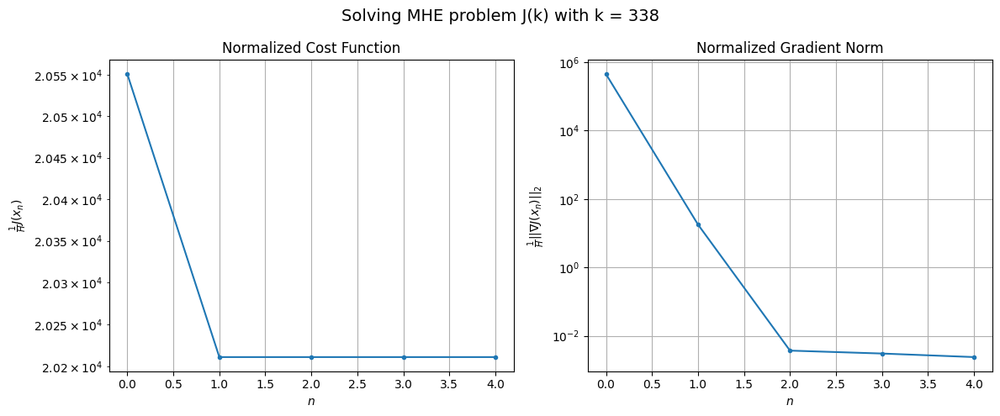

Windows:  84%|████████▍ | 290/346 [49:23<07:12,  7.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 992429.7408916045
Gradient norm: 22726623.666464817
Global estimation error: 68.321407933082
Initial conditions estimation errors: 32.894308176002006 m, 34.46257132641057 m, 32.64038027252029 m, 36.50574866266943 m
Position estimation errors: 33.56922000036572 m, 30.892777825210267 m, 36.246643175715185 m, 29.875841785170188 m

[Gauss-Newton] Iteration 1
Cost function: 974693.8664371815 (-1.79%)
Gradient norm: 644.0574661809009 (-100.00%)
Global estimation error: 79.0991575873164 (15.78%)
Initial conditions estimation errors: 39.245895335244875 m, 39.35132119966699 m, 38.97158235696616 m, 40.608762880601134 m
Position estimation errors: 30.897486571219837 m, 30.88619426779816 m, 31.27050692856237 m, 32.262227507983376 m

[Gauss-Newton] Iteration 2
Cost function: 974693.8661552053 (-0.00%)
Gradient norm: 0.1523845188521063 (-99.98%)
Global estimation error: 79.10119406752496 (0.00%)
Initial conditions estimation errors: 39.2458

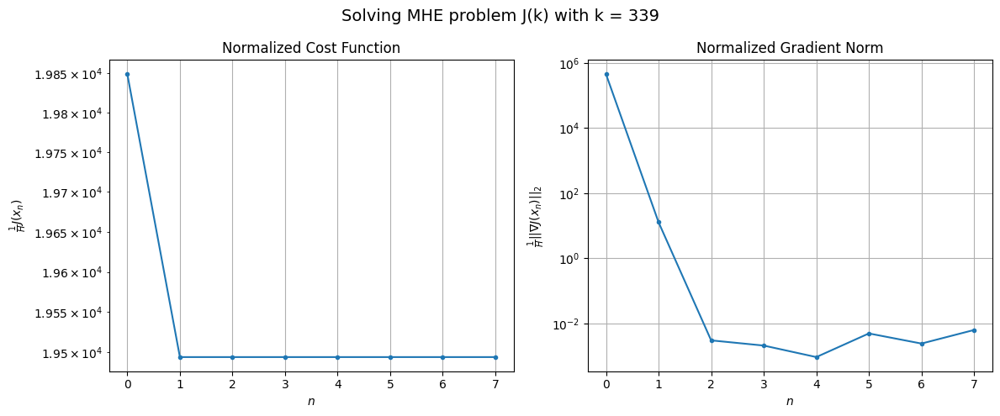

Windows:  84%|████████▍ | 291/346 [49:32<07:28,  8.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 954343.5195081915
Gradient norm: 22622605.491906233
Global estimation error: 67.04484077153037
Initial conditions estimation errors: 33.316952767076096 m, 33.389159573410076 m, 33.07099509921272 m, 34.298906415101236 m
Position estimation errors: 33.66554647102778 m, 33.76812239388159 m, 34.03976185633919 m, 35.50730589062576 m

[Gauss-Newton] Iteration 1
Cost function: 936001.9790279069 (-1.92%)
Gradient norm: 88.12637714527439 (-100.00%)
Global estimation error: 80.3903696905549 (19.91%)
Initial conditions estimation errors: 39.796146771641105 m, 40.18248892794499 m, 39.523293200909535 m, 41.25648517475161 m
Position estimation errors: 30.942422173187023 m, 30.86797803946217 m, 30.274599431704445 m, 32.842217230670066 m

[Gauss-Newton] Iteration 2
Cost function: 936001.9790065334 (-0.00%)
Gradient norm: 0.3369524858547411 (-99.62%)
Global estimation error: 80.39261486671325 (0.00%)
Initial conditions estimation errors: 39.79

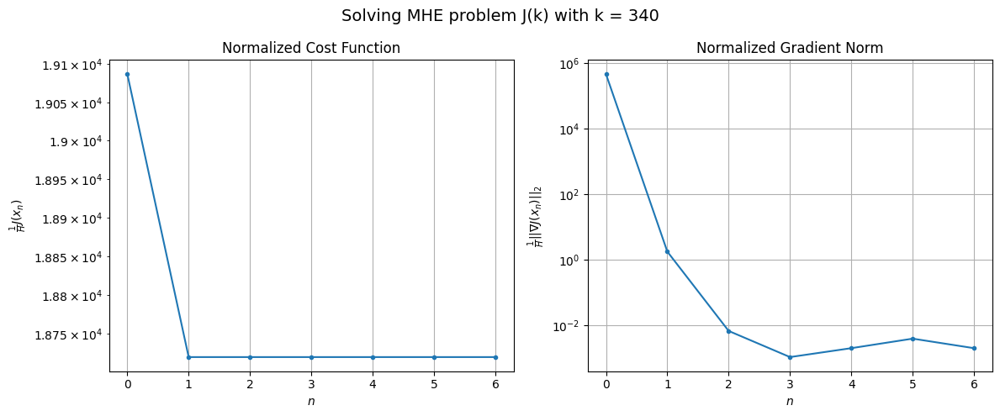

Windows:  84%|████████▍ | 292/346 [49:40<07:21,  8.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 912915.055135827
Gradient norm: 22666798.673324376
Global estimation error: 68.00099101294649
Initial conditions estimation errors: 33.68546120562367 m, 33.999701657876734 m, 33.67382381248659 m, 34.63329535455834 m
Position estimation errors: 33.37244548582722 m, 33.48924361610151 m, 32.53578624861491 m, 35.972888757329386 m

[Gauss-Newton] Iteration 1
Cost function: 894421.8229374384 (-2.03%)
Gradient norm: 88.74114069528181 (-100.00%)
Global estimation error: 80.47200177592691 (18.34%)
Initial conditions estimation errors: 40.17705230331188 m, 39.88571322692109 m, 40.206974872954675 m, 40.669588472408634 m
Position estimation errors: 30.618869195422484 m, 31.337185572812594 m, 29.998146800830142 m, 34.25798815832852 m

[Gauss-Newton] Iteration 2
Cost function: 894421.8229581893 (0.00%)
Gradient norm: 0.15299545744697415 (-99.83%)
Global estimation error: 80.4701475082817 (-0.00%)
Initial conditions estimation errors: 40.177

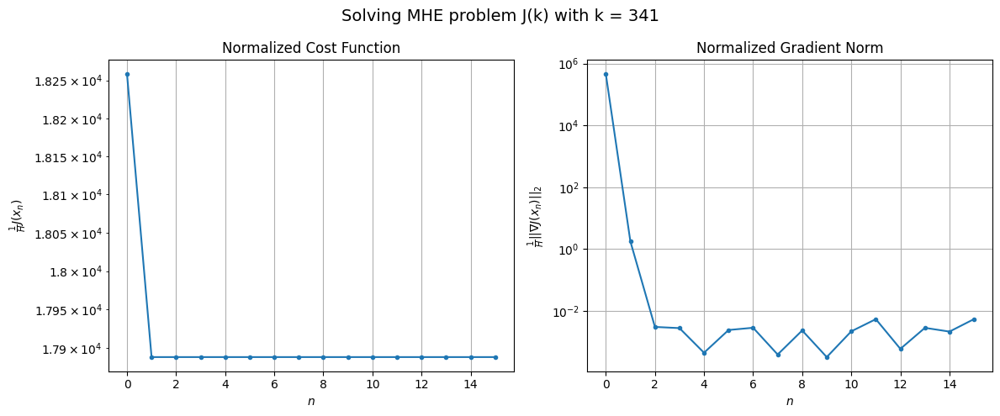

Windows:  85%|████████▍ | 293/346 [49:59<09:55, 11.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 866602.6365281986
Gradient norm: 22429708.527241483
Global estimation error: 67.64676298934327
Initial conditions estimation errors: 33.87795303768054 m, 33.49893066599546 m, 34.086319984439825 m, 33.82684937619571 m
Position estimation errors: 32.72874732092878 m, 33.58046250556173 m, 31.972275239895705 m, 37.04714524839475 m

[Gauss-Newton] Iteration 1
Cost function: 847863.0053028638 (-2.16%)
Gradient norm: 83.40281435355834 (-100.00%)
Global estimation error: 80.9316441255446 (19.64%)
Initial conditions estimation errors: 40.39040196145986 m, 40.32385514853577 m, 40.40642729398172 m, 40.740492303683716 m
Position estimation errors: 29.961699195919433 m, 31.207264628423346 m, 29.295775730048085 m, 33.04324546458638 m

[Gauss-Newton] Iteration 2
Cost function: 847863.0052841567 (-0.00%)
Gradient norm: 0.1712602240035713 (-99.79%)
Global estimation error: 80.93451719516558 (0.00%)
Initial conditions estimation errors: 40.3904

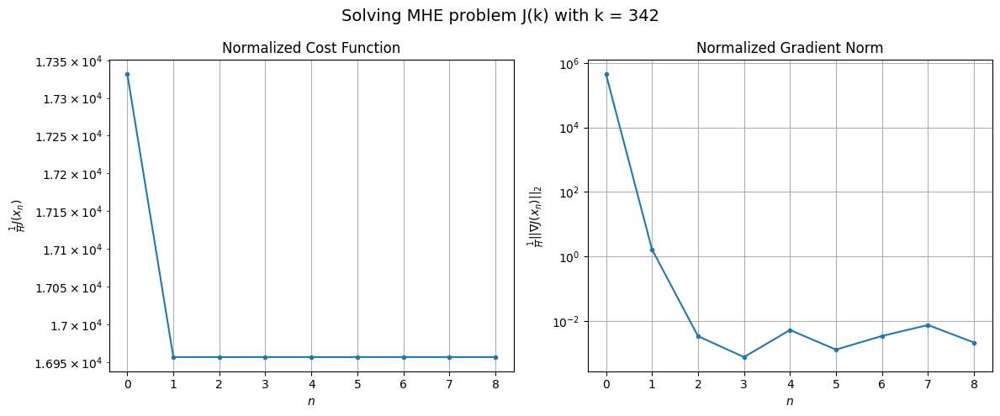

Windows:  85%|████████▍ | 294/346 [50:09<09:31, 10.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 816773.905860367
Gradient norm: 21435938.289046574
Global estimation error: 67.63696791235509
Initial conditions estimation errors: 33.86471214606093 m, 33.62438839298356 m, 34.08953346779874 m, 33.69247371911195 m
Position estimation errors: 31.779797810648418 m, 33.227977627679984 m, 30.946182852261213 m, 35.50002838290764 m

[Gauss-Newton] Iteration 1
Cost function: 798476.3033201414 (-2.24%)
Gradient norm: 89.68419240644717 (-100.00%)
Global estimation error: 80.4392340572732 (18.93%)
Initial conditions estimation errors: 40.25792911922712 m, 40.172624154798136 m, 40.007816145322224 m, 40.4380284410082 m
Position estimation errors: 29.051672086792756 m, 29.786509570458897 m, 29.001990655063207 m, 30.4325097141618 m

[Gauss-Newton] Iteration 2
Cost function: 798476.3032926577 (-0.00%)
Gradient norm: 0.3062311117592244 (-99.66%)
Global estimation error: 80.44000361224302 (0.00%)
Initial conditions estimation errors: 40.25793

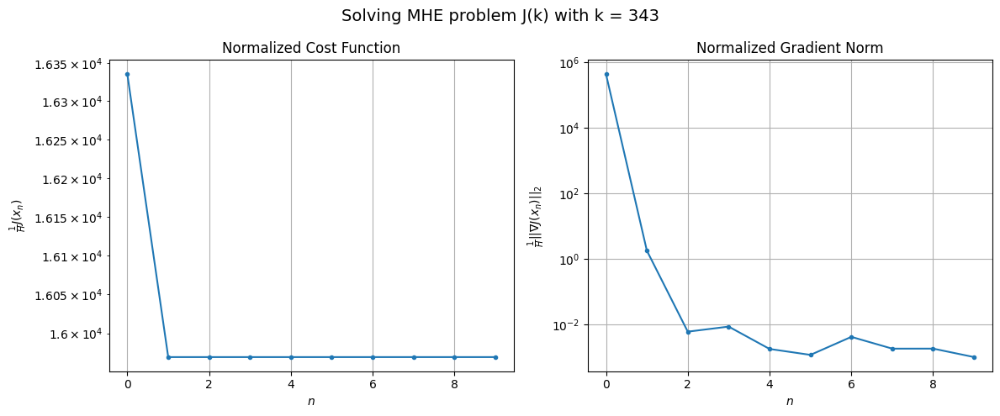

Windows:  85%|████████▌ | 295/346 [50:20<09:21, 11.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 764714.666011411
Gradient norm: 20411317.23109073
Global estimation error: 66.88241391026891
Initial conditions estimation errors: 33.552813056035625 m, 33.3736015791686 m, 33.41176721398424 m, 33.42541259432781 m
Position estimation errors: 30.627140950991535 m, 31.48608780878477 m, 30.45933393522837 m, 32.40812251737046 m

[Gauss-Newton] Iteration 1
Cost function: 747121.4878488064 (-2.30%)
Gradient norm: 589.5592724280282 (-100.00%)
Global estimation error: 79.0280472889572 (18.16%)
Initial conditions estimation errors: 39.76680171399184 m, 40.31746391569633 m, 38.47521971644096 m, 39.4730450621252 m
Position estimation errors: 27.970000690942907 m, 26.68579343427563 m, 31.71482902929037 m, 25.53779751755386 m

[Gauss-Newton] Iteration 2
Cost function: 747121.4873700461 (-0.00%)
Gradient norm: 0.0492136581626288 (-99.99%)
Global estimation error: 79.01839644940894 (-0.01%)
Initial conditions estimation errors: 39.7668033906

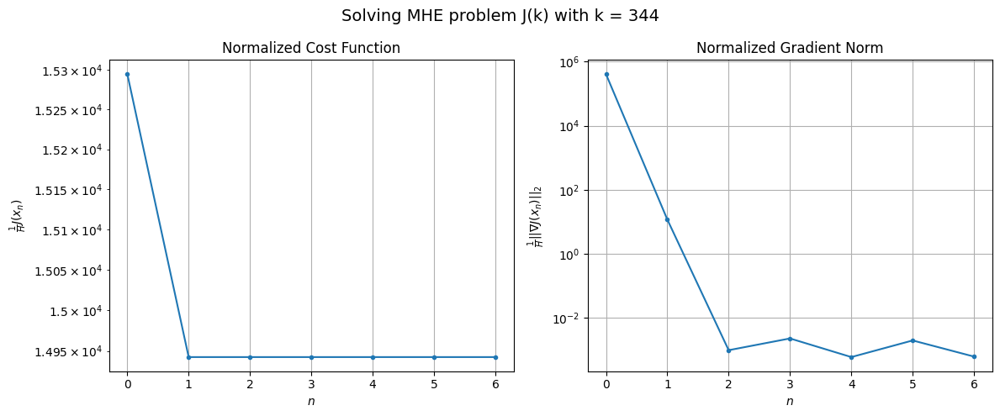

Windows:  86%|████████▌ | 296/346 [50:28<08:27, 10.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 710934.0315289589
Gradient norm: 19351264.749913502
Global estimation error: 65.87015134616752
Initial conditions estimation errors: 33.01865774030868 m, 33.786708742484606 m, 31.341249218185656 m, 33.53752467910576 m
Position estimation errors: 29.367452260380958 m, 27.969313653851994 m, 33.28818211317692 m, 26.324506506402113 m

[Gauss-Newton] Iteration 1
Cost function: 694175.7658303506 (-2.36%)
Gradient norm: 88.51366927918207 (-100.00%)
Global estimation error: 77.36391596421876 (17.45%)
Initial conditions estimation errors: 39.00522191117207 m, 39.63233969447528 m, 37.58892938449093 m, 38.47137061496699 m
Position estimation errors: 26.78306140348044 m, 25.444872608764285 m, 30.57869402202884 m, 24.86851455612578 m

[Gauss-Newton] Iteration 2
Cost function: 694175.765852562 (0.00%)
Gradient norm: 0.4589992577632569 (-99.48%)
Global estimation error: 77.3614033330134 (-0.00%)
Initial conditions estimation errors: 39.00522

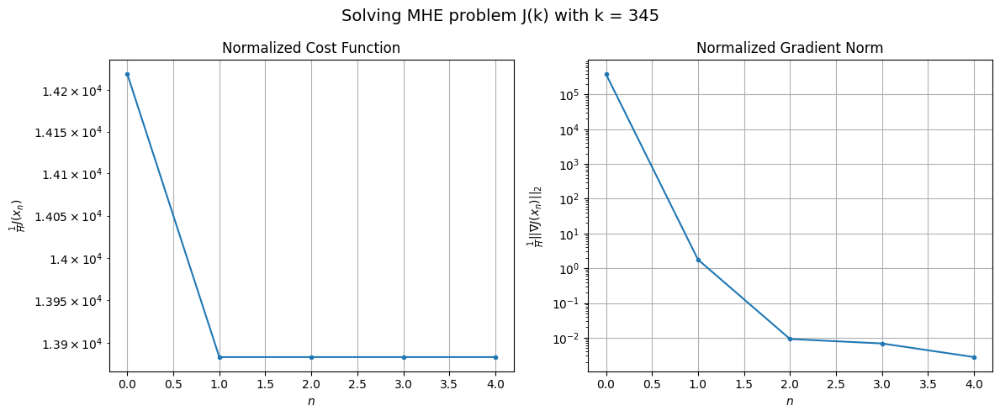

Windows:  86%|████████▌ | 297/346 [50:35<07:24,  9.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 657793.0290361509
Gradient norm: 17707074.23938679
Global estimation error: 64.37893426594502
Initial conditions estimation errors: 32.34683952866629 m, 33.2114571987586 m, 30.532849393504897 m, 32.60383790559898 m
Position estimation errors: 28.078045434266375 m, 26.60572508116082 m, 32.05065739664867 m, 25.493172005893445 m

[Gauss-Newton] Iteration 1
Cost function: 642424.8544110198 (-2.34%)
Gradient norm: 542.6402864837072 (-100.00%)
Global estimation error: 77.69422229056741 (20.68%)
Initial conditions estimation errors: 37.987865379915554 m, 40.19179408280451 m, 35.829991023348065 m, 41.1591416062278 m
Position estimation errors: 25.618027064870173 m, 22.288853982161662 m, 33.09866215643452 m, 16.662916628186842 m

[Gauss-Newton] Iteration 2
Cost function: 642424.853930499 (-0.00%)
Gradient norm: 0.014342605721219811 (-100.00%)
Global estimation error: 77.69013512728274 (-0.01%)
Initial conditions estimation errors: 37.9

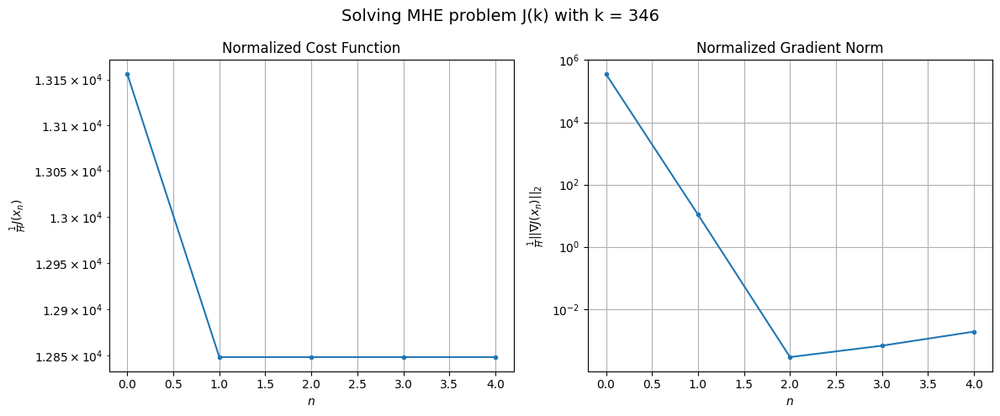

Windows:  86%|████████▌ | 298/346 [50:40<06:26,  8.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 606418.278597976
Gradient norm: 15748982.349606046
Global estimation error: 66.08843333121764
Initial conditions estimation errors: 31.484995011464623 m, 34.23156611834986 m, 28.49866600051266 m, 37.314066952020895 m
Position estimation errors: 26.905390910017754 m, 23.274514524288524 m, 34.793711691992684 m, 16.21253383642643 m

[Gauss-Newton] Iteration 1
Cost function: 592474.9649230734 (-2.30%)
Gradient norm: 86.02527389637748 (-100.00%)
Global estimation error: 78.38879969123657 (18.61%)
Initial conditions estimation errors: 36.76242530039264 m, 39.892667590527125 m, 34.03937654908612 m, 45.201273696536184 m
Position estimation errors: 24.60173174728831 m, 19.402514762084316 m, 31.504876363806645 m, 11.044995396198034 m

[Gauss-Newton] Iteration 2
Cost function: 592474.9649136461 (-0.00%)
Gradient norm: 0.05842263627594707 (-99.93%)
Global estimation error: 78.40632484374781 (0.02%)
Initial conditions estimation errors: 36

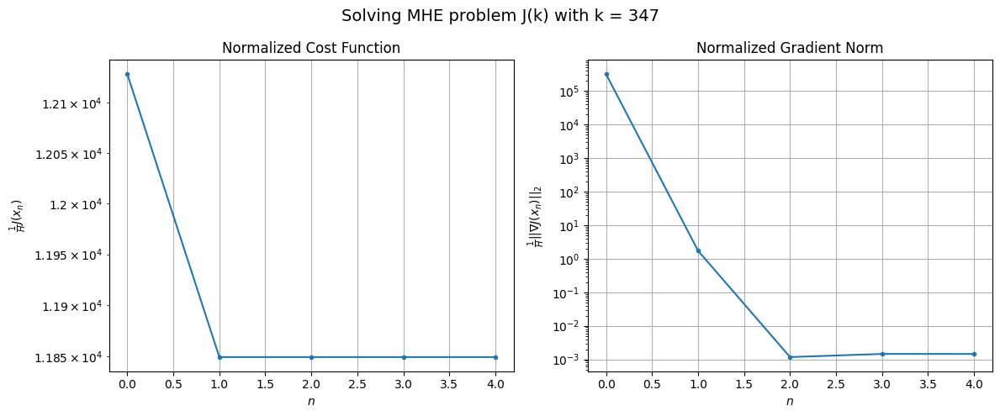

Windows:  86%|████████▋ | 299/346 [50:47<05:54,  7.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 558784.7524857357
Gradient norm: 13817244.056508675
Global estimation error: 67.73174015669296
Initial conditions estimation errors: 30.428616144023486 m, 34.366208529044165 m, 26.9111726929235 m, 41.909182698247406 m
Position estimation errors: 25.981484711946013 m, 20.40324310326034 m, 33.23966864856701 m, 10.450709819272896 m

[Gauss-Newton] Iteration 1
Cost function: 546270.4794934947 (-2.24%)
Gradient norm: 157.23420839266086 (-100.00%)
Global estimation error: 73.95170490462772 (9.18%)
Initial conditions estimation errors: 35.314425812617614 m, 37.707204338253746 m, 33.009305903824284 m, 41.35495123040415 m
Position estimation errors: 23.830907307869133 m, 19.415870485581166 m, 28.165508509670968 m, 11.678575620876153 m

[Gauss-Newton] Iteration 2
Cost function: 546270.4794871083 (-0.00%)
Gradient norm: 0.16006809767427183 (-99.90%)
Global estimation error: 73.94485096513841 (-0.01%)
Initial conditions estimation errors:

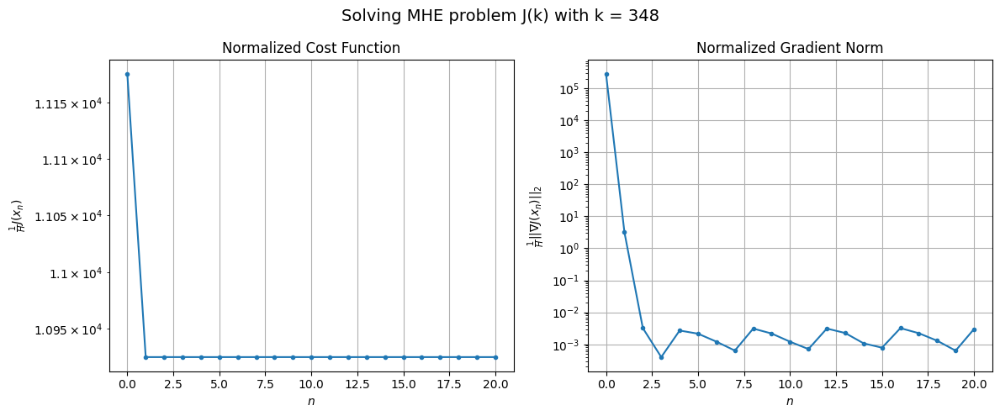

Windows:  87%|████████▋ | 300/346 [51:10<09:25, 12.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 516576.18392809643
Gradient norm: 11846569.283084072
Global estimation error: 63.32546089826239
Initial conditions estimation errors: 29.171138418258348 m, 32.21155733991936 m, 26.358355322877788 m, 37.772384201065556 m
Position estimation errors: 25.365683710229025 m, 20.664480346423705 m, 29.885278383339074 m, 11.548451184428481 m

[Gauss-Newton] Iteration 1
Cost function: 505540.4100730822 (-2.14%)
Gradient norm: 78.72573952452096 (-100.00%)
Global estimation error: 71.75437396709458 (13.31%)
Initial conditions estimation errors: 33.61803755094789 m, 36.08641261681784 m, 30.747626573201973 m, 42.08097682651567 m
Position estimation errors: 23.34373665927517 m, 18.2187155975035 m, 28.12352013253522 m, 9.07075764634673 m

[Gauss-Newton] Iteration 2
Cost function: 505540.4100833542 (0.00%)
Gradient norm: 0.10287402836960124 (-99.87%)
Global estimation error: 71.7548249285268 (0.00%)
Initial conditions estimation errors: 33.618

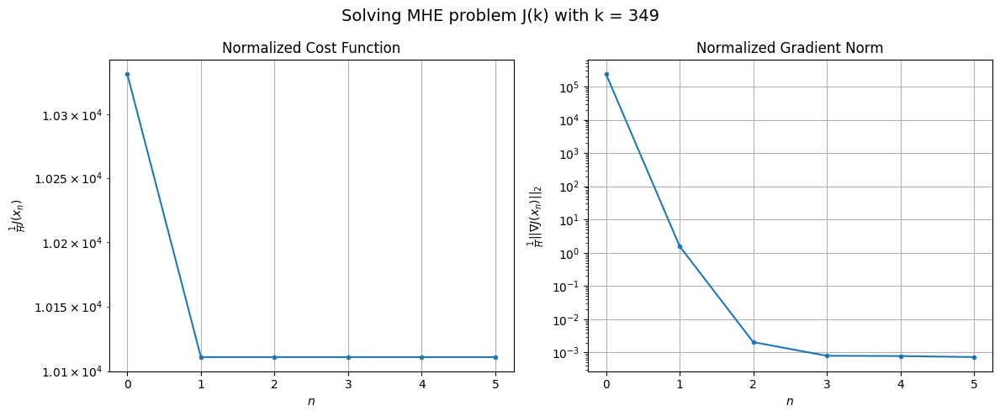

Windows:  87%|████████▋ | 301/346 [51:17<08:05, 10.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 480076.81413885066
Gradient norm: 9857351.292343445
Global estimation error: 61.80000218068088
Initial conditions estimation errors: 27.714966317936504 m, 30.99101651478788 m, 24.29598225456048 m, 38.73407109184461 m
Position estimation errors: 25.030995001437482 m, 19.56819231753679 m, 29.9848914297495 m, 9.23127887927657 m

[Gauss-Newton] Iteration 1
Cost function: 470274.31531286624 (-2.04%)
Gradient norm: 169.16207066489218 (-100.00%)
Global estimation error: 66.84354096249855 (8.16%)
Initial conditions estimation errors: 31.758909875496908 m, 35.33347651191817 m, 29.27275872597519 m, 36.79704329627893 m
Position estimation errors: 23.119545960297103 m, 17.40619275875926 m, 26.238490954783153 m, 13.65804145424493 m

[Gauss-Newton] Iteration 2
Cost function: 470274.3152948432 (-0.00%)
Gradient norm: 0.049891064256063426 (-99.97%)
Global estimation error: 66.83851393364002 (-0.01%)
Initial conditions estimation errors: 31.75

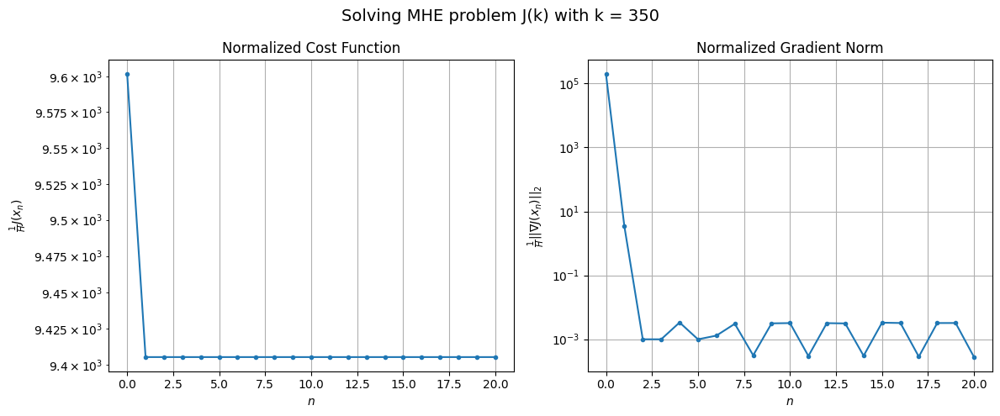

Windows:  87%|████████▋ | 302/346 [51:40<10:35, 14.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 450886.20847172436
Gradient norm: 7861474.424391759
Global estimation error: 56.908728336164835
Initial conditions estimation errors: 26.154341237187403 m, 30.371323417432787 m, 23.42085250036958 m, 32.91732326564178 m
Position estimation errors: 24.912249372423148 m, 19.106602172076734 m, 28.055528136274162 m, 14.51433235813507 m

[Gauss-Newton] Iteration 1
Cost function: 442415.3465828788 (-1.88%)
Gradient norm: 561.5348616863308 (-99.99%)
Global estimation error: 60.20045416219456 (5.78%)
Initial conditions estimation errors: 29.75185670199871 m, 31.990626823998323 m, 26.72164654221008 m, 31.64522742030309 m
Position estimation errors: 23.098409612247227 m, 19.86358448604836 m, 25.621662932145046 m, 21.380987957922095 m

[Gauss-Newton] Iteration 2
Cost function: 442415.3461205195 (-0.00%)
Gradient norm: 0.07009974145972968 (-99.99%)
Global estimation error: 60.21009713414049 (0.02%)
Initial conditions estimation errors: 29.

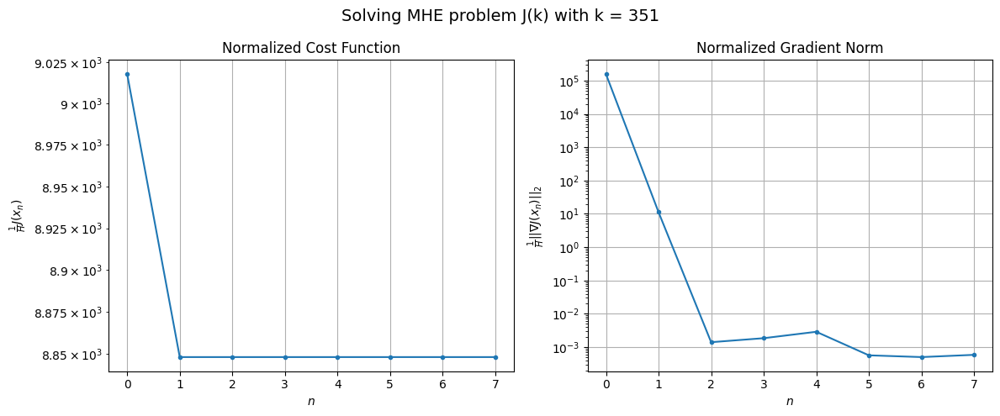

Windows:  88%|████████▊ | 303/346 [51:50<09:17, 12.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 429622.7031253164
Gradient norm: 5599953.735919099
Global estimation error: 49.92777018073583
Initial conditions estimation errors: 24.52223373216017 m, 26.920514488771147 m, 21.692836114827188 m, 26.383790262354555 m
Position estimation errors: 24.942973284042235 m, 21.934314491198307 m, 27.16009221762223 m, 23.342912678066604 m

[Gauss-Newton] Iteration 1
Cost function: 422389.09404590976 (-1.68%)
Gradient norm: 255.3393239191799 (-100.00%)
Global estimation error: 56.075057758201034 (12.31%)
Initial conditions estimation errors: 27.6867814609933 m, 29.30681490932801 m, 23.755004594209517 m, 30.89686430170543 m
Position estimation errors: 23.21009325581562 m, 21.472117258611295 m, 26.50553533569545 m, 21.557190418864778 m

[Gauss-Newton] Iteration 2
Cost function: 422389.09401893377 (-0.00%)
Gradient norm: 0.10629952968679258 (-99.96%)
Global estimation error: 56.084961428857135 (0.02%)
Initial conditions estimation errors: 

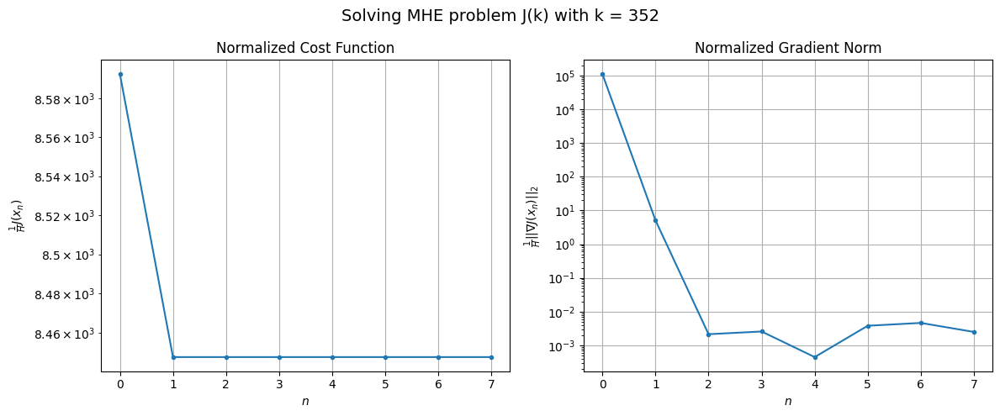

Windows:  88%|████████▊ | 304/346 [52:00<08:23, 11.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 416199.90060867404
Gradient norm: 3873549.990878715
Global estimation error: 46.29808229542776
Initial conditions estimation errors: 22.91559893000988 m, 24.458549524012575 m, 19.28496352021774 m, 25.460152441145212 m
Position estimation errors: 25.081546617611835 m, 23.625053105504982 m, 27.970956345825478 m, 24.12695080557846 m

[Gauss-Newton] Iteration 1
Cost function: 409947.8178821157 (-1.50%)
Gradient norm: 45.51483021474465 (-100.00%)
Global estimation error: 54.43319964665231 (17.57%)
Initial conditions estimation errors: 25.70053118588939 m, 28.305191301235364 m, 22.572459347903933 m, 31.491525176601787 m
Position estimation errors: 23.391767964801055 m, 21.23854307519695 m, 25.764049291106897 m, 19.002826175105916 m

[Gauss-Newton] Iteration 2
Cost function: 409947.8178741607 (-0.00%)
Gradient norm: 0.08838227824337205 (-99.81%)
Global estimation error: 54.43097324487203 (-0.00%)
Initial conditions estimation errors:

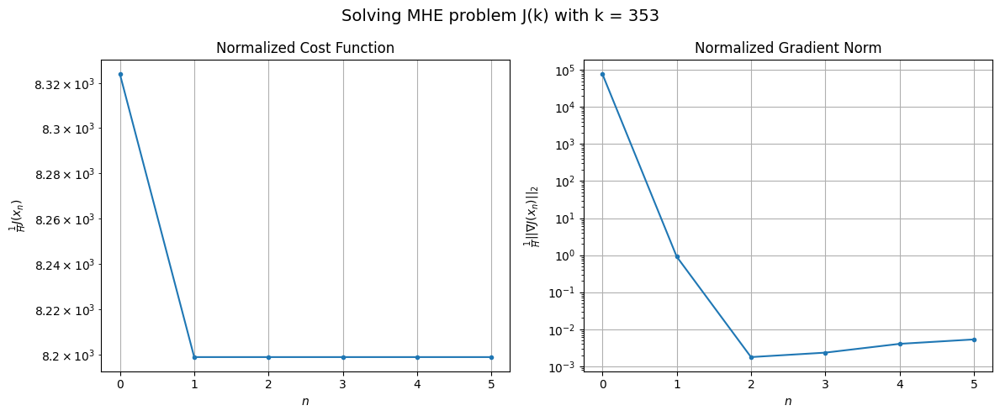

Windows:  88%|████████▊ | 305/346 [52:07<07:15, 10.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 408624.96499884664
Gradient norm: 2139170.710241134
Global estimation error: 45.71821224982986
Initial conditions estimation errors: 21.444814665501948 m, 23.802275381762716 m, 18.70609858586751 m, 26.7166303868286 m
Position estimation errors: 25.312706062298837 m, 23.516206178708817 m, 27.28602124961817 m, 21.464179680681696 m

[Gauss-Newton] Iteration 1
Cost function: 403130.64121568366 (-1.34%)
Gradient norm: 509.1653910155139 (-99.98%)
Global estimation error: 48.85077427908732 (6.85%)
Initial conditions estimation errors: 23.921999590961054 m, 25.003224320541236 m, 22.39604943073632 m, 26.217509590710986 m
Position estimation errors: 23.648941092226572 m, 23.788776978686933 m, 23.723743819930824 m, 26.23185282027021 m

[Gauss-Newton] Iteration 2
Cost function: 403130.6408437069 (-0.00%)
Gradient norm: 0.03642054403068413 (-99.99%)
Global estimation error: 48.87046466233541 (0.04%)
Initial conditions estimation errors: 23

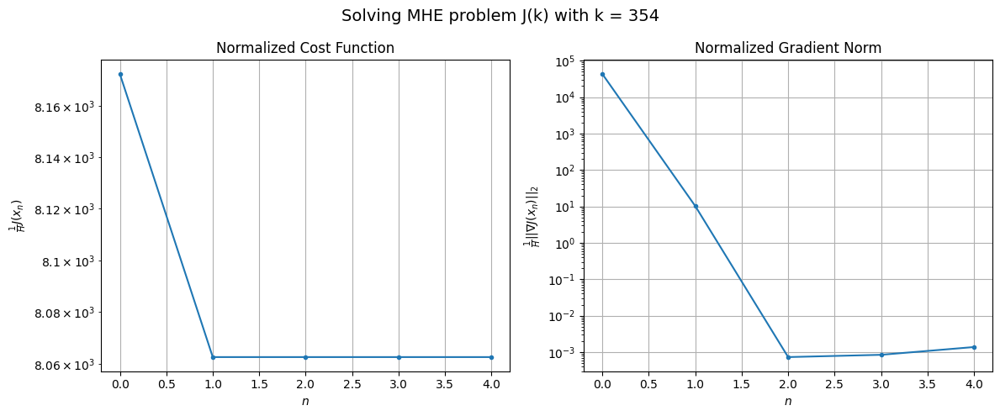

Windows:  88%|████████▊ | 306/346 [52:14<06:16,  9.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 407545.3373460831
Gradient norm: 1325041.5431248036
Global estimation error: 40.391323029706825
Initial conditions estimation errors: 20.190664923810225 m, 20.562446056869884 m, 19.491040393100604 m, 20.519643450101288 m
Position estimation errors: 25.691713171554202 m, 26.545612406832657 m, 25.15232938408413 m, 29.78287135324765 m

[Gauss-Newton] Iteration 1
Cost function: 402594.17380610405 (-1.21%)
Gradient norm: 34.90206239909943 (-100.00%)
Global estimation error: 42.95994128849598 (6.36%)
Initial conditions estimation errors: 22.42136776366863 m, 21.206943025019672 m, 22.279893080325106 m, 19.91694123653163 m
Position estimation errors: 24.012678302495722 m, 26.613505959366385 m, 22.760211148984506 m, 31.194977565325978 m

[Gauss-Newton] Iteration 2
Cost function: 402594.1738097001 (0.00%)
Gradient norm: 0.03189172639976951 (-99.91%)
Global estimation error: 42.95884757885873 (-0.00%)
Initial conditions estimation errors

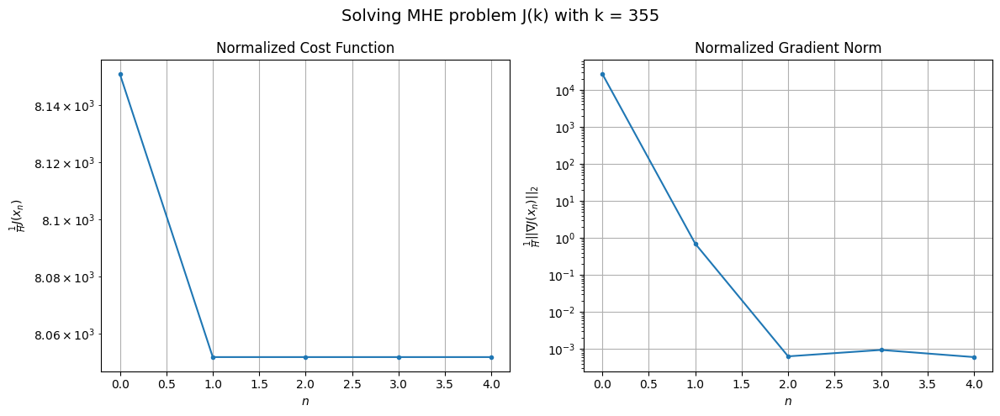

Windows:  89%|████████▊ | 307/346 [52:20<05:29,  8.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 412287.0809349828
Gradient norm: 931799.0787634972
Global estimation error: 35.66910040677765
Initial conditions estimation errors: 19.19184280010252 m, 17.136412780180528 m, 19.932998637378702 m, 14.593065751784732 m
Position estimation errors: 26.289877124086892 m, 29.671156055854954 m, 24.41220009381791 m, 35.123465513226456 m

[Gauss-Newton] Iteration 1
Cost function: 407631.4907351458 (-1.13%)
Gradient norm: 770.614255141931 (-99.92%)
Global estimation error: 38.89496860231092 (9.04%)
Initial conditions estimation errors: 21.263817576279855 m, 20.237489118740317 m, 20.310584131734803 m, 15.445895094757152 m
Position estimation errors: 24.57970057055928 m, 26.748957423339725 m, 24.829018195645613 m, 31.83021459298372 m

[Gauss-Newton] Iteration 2
Cost function: 407631.4902985022 (-0.00%)
Gradient norm: 0.4564042382364809 (-99.94%)
Global estimation error: 38.89535244019189 (0.00%)
Initial conditions estimation errors: 21.2

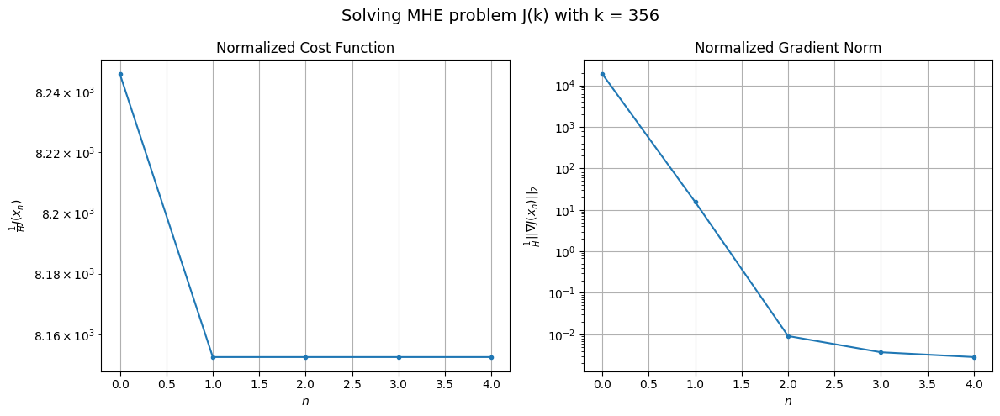

Windows:  89%|████████▉ | 308/346 [52:26<04:56,  7.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 422089.8548248556
Gradient norm: 864725.8282868904
Global estimation error: 33.09530667257687
Initial conditions estimation errors: 18.497593207978657 m, 16.84313228342779 m, 18.090968543463344 m, 11.922763352055412 m
Position estimation errors: 27.19287799916635 m, 29.85940882959901 m, 26.97919158309499 m, 34.90746425549984 m

[Gauss-Newton] Iteration 1
Cost function: 417549.32202853955 (-1.08%)
Gradient norm: 83.45380584956135 (-99.99%)
Global estimation error: 36.28080312626482 (9.63%)
Initial conditions estimation errors: 20.47708884809189 m, 17.200161451158053 m, 22.271972640526787 m, 10.251187631050012 m
Position estimation errors: 25.43813926460662 m, 29.690385749730762 m, 22.955768931613164 m, 37.38469064801334 m

[Gauss-Newton] Iteration 2
Cost function: 417549.3220164294 (-0.00%)
Gradient norm: 0.1652987703198999 (-99.80%)
Global estimation error: 36.28132769961475 (0.00%)
Initial conditions estimation errors: 20.477

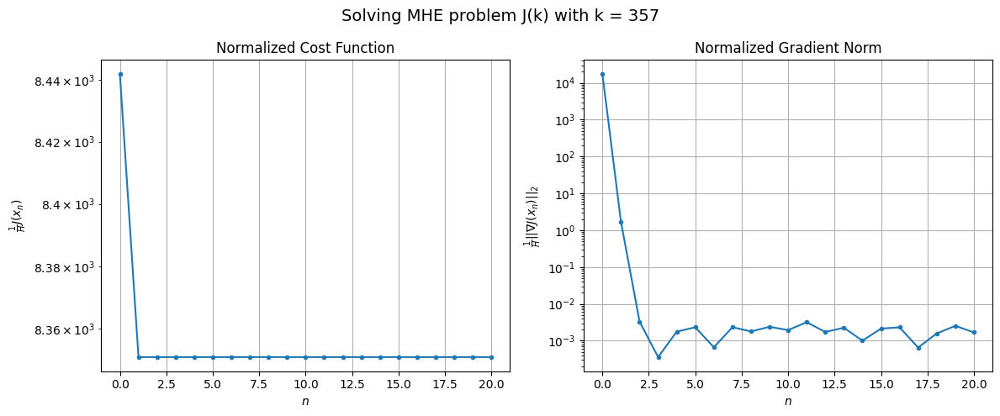

Windows:  89%|████████▉ | 309/346 [52:50<07:43, 12.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 437480.40026084357
Gradient norm: 1128239.5683779325
Global estimation error: 31.6645896595967
Initial conditions estimation errors: 18.13914514220228 m, 14.248595059770983 m, 20.517819711026156 m, 7.0431498213567645 m
Position estimation errors: 28.43205733297885 m, 33.21094968111794 m, 25.48121333616986 m, 41.02804254550117 m

[Gauss-Newton] Iteration 1
Cost function: 432874.70072259323 (-1.05%)
Gradient norm: 205.21204066330824 (-99.98%)
Global estimation error: 39.201164295680975 (23.80%)
Initial conditions estimation errors: 20.08833364740021 m, 17.581870925236746 m, 23.69915048717764 m, 16.199056897113522 m
Position estimation errors: 26.61922719683674 m, 29.848140140554268 m, 22.7204860182399 m, 32.19314945842961 m

[Gauss-Newton] Iteration 2
Cost function: 432874.7007044283 (-0.00%)
Gradient norm: 0.023698681444658823 (-99.99%)
Global estimation error: 39.19193807507364 (-0.02%)
Initial conditions estimation errors: 20

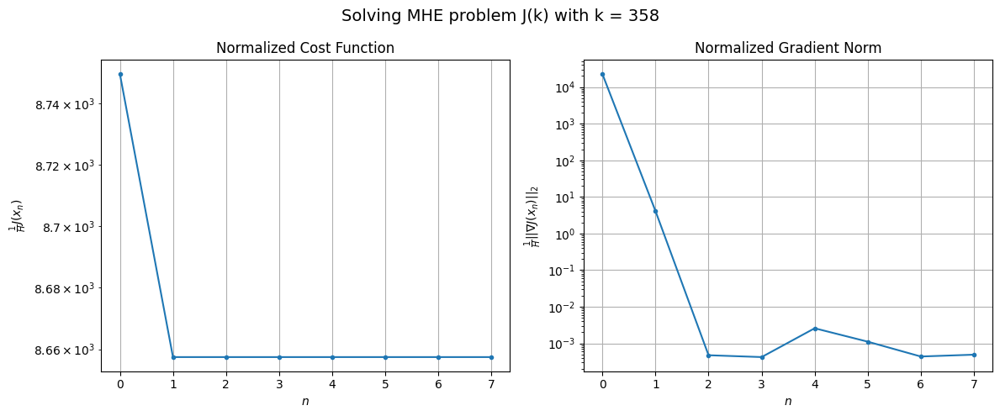

Windows:  90%|████████▉ | 310/346 [52:59<06:58, 11.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 457148.28457504255
Gradient norm: 1779580.861489652
Global estimation error: 35.0471455172216
Initial conditions estimation errors: 18.14593899190687 m, 15.165592148405091 m, 22.15945294255808 m, 13.341098185306851 m
Position estimation errors: 29.97217021170563 m, 33.60194708700591 m, 25.703266964769863 m, 36.25706540461594 m

[Gauss-Newton] Iteration 1
Cost function: 452320.2323354285 (-1.06%)
Gradient norm: 100.21930651395702 (-99.99%)
Global estimation error: 37.799614182990716 (7.85%)
Initial conditions estimation errors: 20.110456413150136 m, 15.349479307038758 m, 24.700350790393212 m, 13.366376010431576 m
Position estimation errors: 28.083855788431567 m, 33.423423162003495 m, 23.140783946859013 m, 37.085749700340706 m

[Gauss-Newton] Iteration 2
Cost function: 452320.2323320817 (-0.00%)
Gradient norm: 0.06350880592172417 (-99.94%)
Global estimation error: 37.80595497645538 (0.02%)
Initial conditions estimation errors: 2

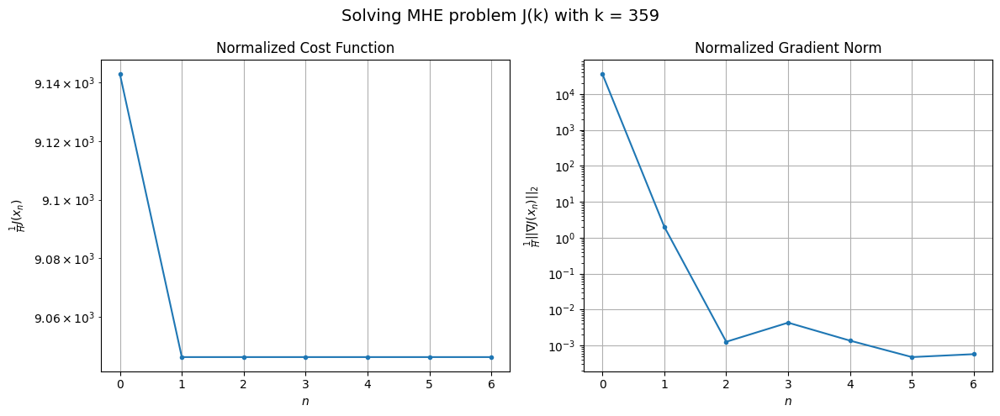

Windows:  90%|████████▉ | 311/346 [53:08<06:15, 10.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 482073.8164941309
Gradient norm: 2724315.4115889906
Global estimation error: 34.45774384117752
Initial conditions estimation errors: 18.522446726144647 m, 13.370008550592209 m, 23.56411786916064 m, 10.498843569942895 m
Position estimation errors: 31.72699458260959 m, 37.416518802266076 m, 26.373617906741885 m, 41.86018640961308 m

[Gauss-Newton] Iteration 1
Cost function: 476909.52109855047 (-1.07%)
Gradient norm: 179.3760761152576 (-99.99%)
Global estimation error: 38.67194258690647 (12.23%)
Initial conditions estimation errors: 20.533690722488913 m, 16.488297967636107 m, 26.13776535582045 m, 10.901186174143977 m
Position estimation errors: 29.753700906992147 m, 34.4157934688516 m, 23.959652364572175 m, 40.51149546039118 m

[Gauss-Newton] Iteration 2
Cost function: 476909.5210768193 (-0.00%)
Gradient norm: 0.24084081662800894 (-99.87%)
Global estimation error: 38.67261030154042 (0.00%)
Initial conditions estimation errors: 20

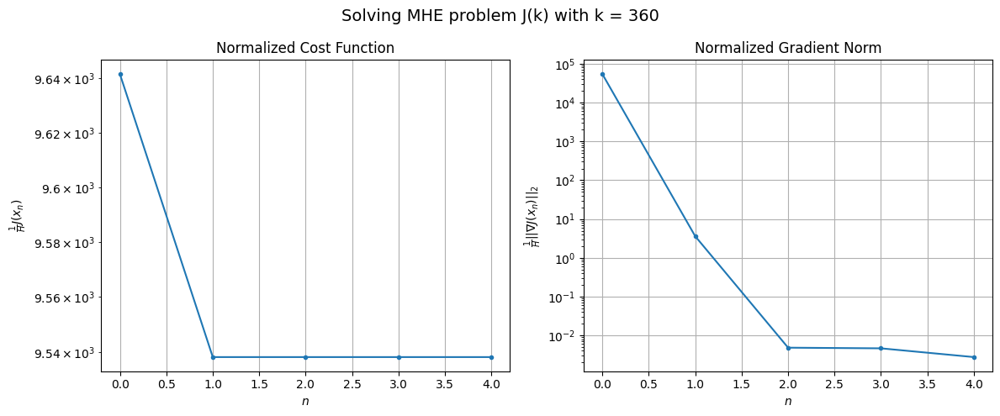

Windows:  90%|█████████ | 312/346 [53:14<05:19,  9.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 512368.01459372387
Gradient norm: 3759598.296522434
Global estimation error: 36.083639776956545
Initial conditions estimation errors: 19.233026786586912 m, 14.789403822477798 m, 25.177820438845174 m, 8.914461949638476 m
Position estimation errors: 33.59272108976058 m, 38.593616236262875 m, 27.481242781860328 m, 44.9744135089745 m

[Gauss-Newton] Iteration 1
Cost function: 506783.18879918667 (-1.09%)
Gradient norm: 126.44883586398592 (-100.00%)
Global estimation error: 40.0923026095437 (11.11%)
Initial conditions estimation errors: 21.309119265438547 m, 16.544344172628826 m, 26.53203895499916 m, 13.253197424713639 m
Position estimation errors: 31.525689809083524 m, 36.65351009839253 m, 26.154160976946486 m, 39.68593189926868 m

[Gauss-Newton] Iteration 2
Cost function: 506783.18878300325 (-0.00%)
Gradient norm: 0.026939087409406953 (-99.98%)
Global estimation error: 40.09065556079206 (-0.00%)
Initial conditions estimation error

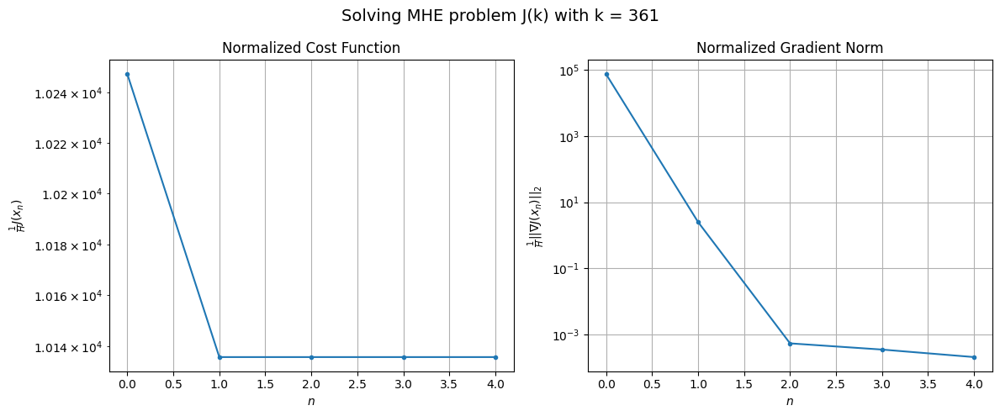

Windows:  90%|█████████ | 313/346 [53:20<04:36,  8.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 546883.6295354892
Gradient norm: 4728447.330581272
Global estimation error: 38.0029087185502
Initial conditions estimation errors: 20.196745369000823 m, 15.149724796283715 m, 25.71120225483444 m, 12.071885912982523 m
Position estimation errors: 35.46636198213415 m, 40.84475090952525 m, 29.81799464448959 m, 43.66323638742215 m

[Gauss-Newton] Iteration 1
Cost function: 540651.6737449986 (-1.14%)
Gradient norm: 1876.5516717956077 (-99.96%)
Global estimation error: 51.057766812211575 (34.35%)
Initial conditions estimation errors: 22.37860446763177 m, 23.113148053452914 m, 25.777374908523793 m, 30.123078197303222 m
Position estimation errors: 33.2723974508681 m, 33.01726765636491 m, 29.45831440520441 m, 27.233774134981815 m

[Gauss-Newton] Iteration 2
Cost function: 540651.673024669 (-0.00%)
Gradient norm: 0.09481417163066308 (-99.99%)
Global estimation error: 51.02631830165448 (-0.06%)
Initial conditions estimation errors: 22.378

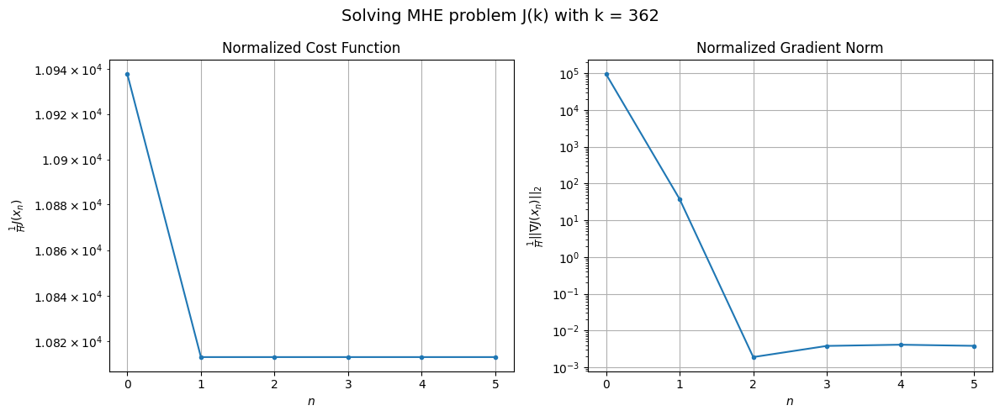

Windows:  91%|█████████ | 314/346 [53:27<04:17,  8.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 584833.5979826727
Gradient norm: 5621487.120513099
Global estimation error: 48.379949542100874
Initial conditions estimation errors: 21.339747542360186 m, 21.612159781801378 m, 25.245956079937503 m, 27.942584074291137 m
Position estimation errors: 37.249713025177186 m, 37.455799052656296 m, 32.920023994854084 m, 32.33004531563041 m

[Gauss-Newton] Iteration 1
Cost function: 578003.548330863 (-1.17%)
Gradient norm: 488.5660573762106 (-99.99%)
Global estimation error: 50.858589812251225 (5.12%)
Initial conditions estimation errors: 23.611791323302175 m, 23.263519152363344 m, 27.879394272449016 m, 26.657559882852627 m
Position estimation errors: 34.94122160927736 m, 35.32489870685679 m, 30.528660844053608 m, 32.07251829195399 m

[Gauss-Newton] Iteration 2
Cost function: 578003.548227217 (-0.00%)
Gradient norm: 0.3084447217135002 (-99.94%)
Global estimation error: 50.88154972344093 (0.05%)
Initial conditions estimation errors: 23.

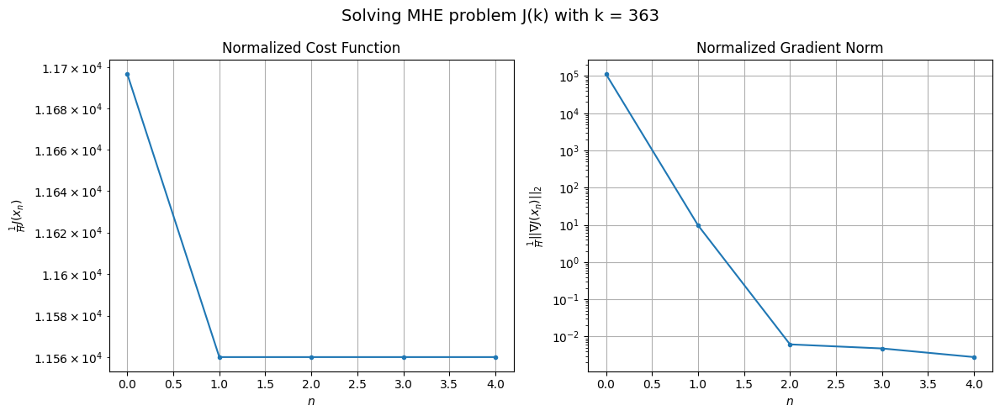

Windows:  91%|█████████ | 315/346 [53:34<03:53,  7.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 626230.9983966222
Gradient norm: 6542680.211892216
Global estimation error: 48.71548732125997
Initial conditions estimation errors: 22.54700415652031 m, 22.07225558353862 m, 27.068672142811085 m, 25.395507968468433 m
Position estimation errors: 38.92791085332956 m, 39.42897438392273 m, 34.26099970530282 m, 36.27160679585818 m

[Gauss-Newton] Iteration 1
Cost function: 618647.7570841564 (-1.21%)
Gradient norm: 790.8418545954783 (-99.99%)
Global estimation error: 56.87500466987032 (16.75%)
Initial conditions estimation errors: 24.93234821800457 m, 27.142155447207017 m, 25.104126246356245 m, 35.30194891079384 m
Position estimation errors: 36.488547529523494 m, 34.40842997830571 m, 36.1101193891381 m, 27.764297458569807 m

[Gauss-Newton] Iteration 2
Cost function: 618647.7569193095 (-0.00%)
Gradient norm: 0.08555622452875186 (-99.99%)
Global estimation error: 56.861239728171256 (-0.02%)
Initial conditions estimation errors: 24.932

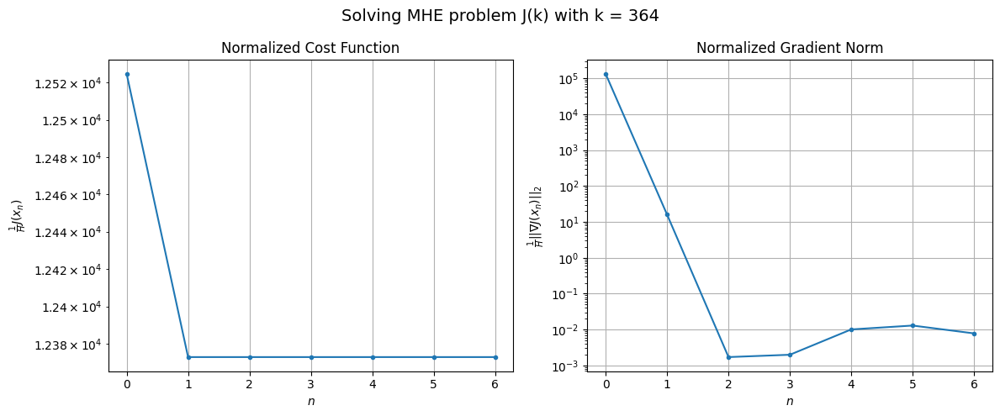

Windows:  91%|█████████▏| 316/346 [53:42<03:53,  7.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 669618.7906527203
Gradient norm: 6928239.224666545
Global estimation error: 53.97127861367904
Initial conditions estimation errors: 23.774702019410373 m, 25.754086778648322 m, 24.287767940194854 m, 33.0830901404129 m
Position estimation errors: 40.46683204584754 m, 38.633746779666176 m, 39.737513624659385 m, 32.89280889329839 m

[Gauss-Newton] Iteration 1
Cost function: 661389.9012547132 (-1.23%)
Gradient norm: 146.79388027274535 (-100.00%)
Global estimation error: 62.83683200126403 (16.43%)
Initial conditions estimation errors: 26.257483697856305 m, 29.652786718919945 m, 25.602355763823308 m, 41.52398338638866 m
Position estimation errors: 37.9227125134755 m, 34.55218574521013 m, 38.37467195944408 m, 23.61656368622178 m

[Gauss-Newton] Iteration 2
Cost function: 661389.901230701 (-0.00%)
Gradient norm: 0.1728117622370378 (-99.88%)
Global estimation error: 62.86318862392506 (0.04%)
Initial conditions estimation errors: 26.2574

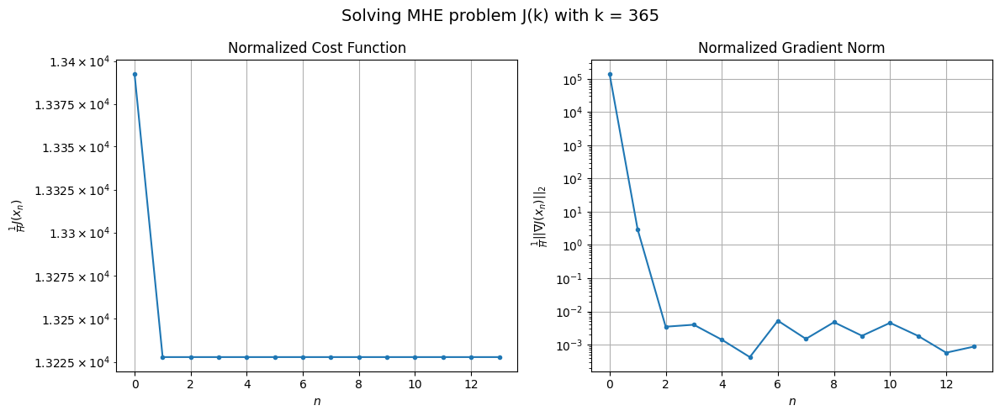

Windows:  92%|█████████▏| 317/346 [53:58<04:57, 10.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 715060.5996481038
Gradient norm: 7754792.656189704
Global estimation error: 60.00161866161793
Initial conditions estimation errors: 24.974536266253995 m, 28.2206334013318 m, 24.62011323031044 m, 39.67253441593614 m
Position estimation errors: 41.856102819749964 m, 38.65441743569702 m, 41.972967073676855 m, 28.277916576870595 m

[Gauss-Newton] Iteration 1
Cost function: 706099.9860315346 (-1.25%)
Gradient norm: 623.1782163577766 (-99.99%)
Global estimation error: 62.988090926777524 (4.98%)
Initial conditions estimation errors: 27.5625613210425 m, 30.101079920155293 m, 28.32847987512015 m, 38.71982872112011 m
Position estimation errors: 39.196759739213626 m, 36.65244907658938 m, 38.398569011225355 m, 27.4569362606172 m

[Gauss-Newton] Iteration 2
Cost function: 706099.9858654394 (-0.00%)
Gradient norm: 0.2028958972690542 (-99.97%)
Global estimation error: 63.02585847016597 (0.06%)
Initial conditions estimation errors: 27.5625600

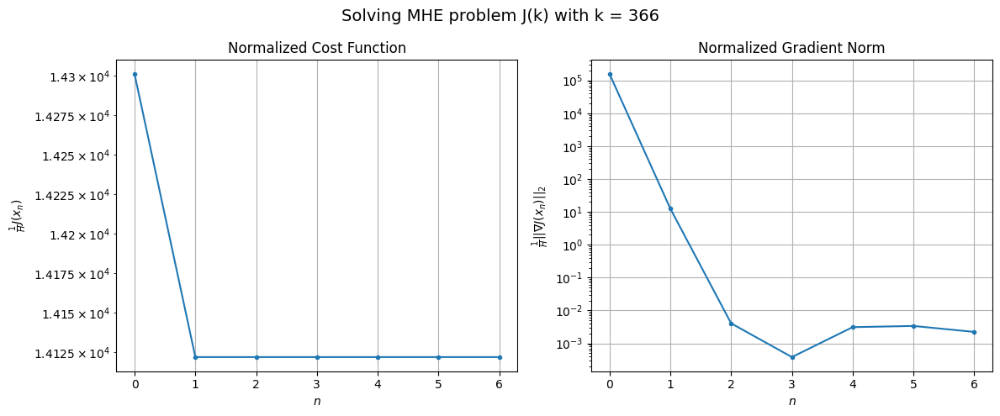

Windows:  92%|█████████▏| 318/346 [54:07<04:31,  9.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 761876.2529924158
Gradient norm: 8139431.447834437
Global estimation error: 60.46468259182661
Initial conditions estimation errors: 26.151523037528843 m, 28.634068809684507 m, 27.082755160252827 m, 37.66547485839914 m
Position estimation errors: 43.026052444719625 m, 40.57483383243584 m, 42.04381812424408 m, 31.044883714209735 m

[Gauss-Newton] Iteration 1
Cost function: 752281.2861152436 (-1.26%)
Gradient norm: 4547.003841088463 (-99.94%)
Global estimation error: 55.52322039263275 (-8.17%)
Initial conditions estimation errors: 28.83390249047354 m, 22.20893403177595 m, 38.041726836081345 m, 17.63583052032309 m
Position estimation errors: 40.2721640939573 m, 46.322083466845434 m, 31.855618229063595 m, 49.238419623764685 m

[Gauss-Newton] Iteration 2
Cost function: 752281.2820419224 (-0.00%)
Gradient norm: 0.0635043680390033 (-100.00%)
Global estimation error: 55.521470829481736 (-0.00%)
Initial conditions estimation errors: 28.

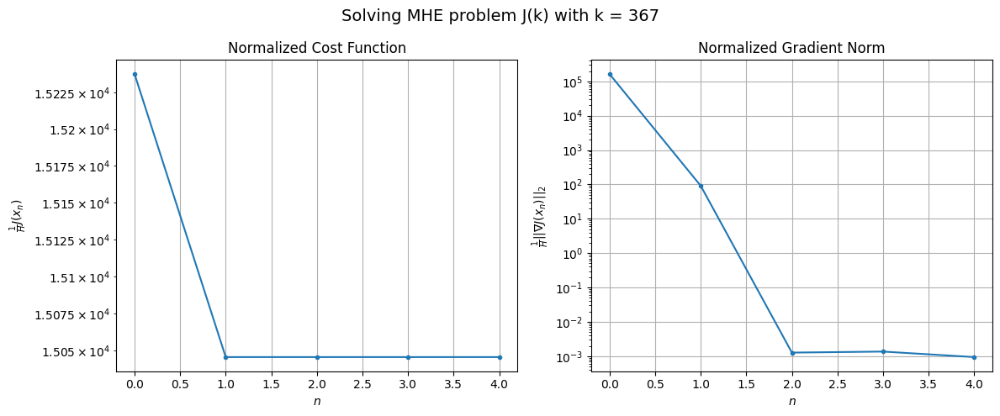

Windows:  92%|█████████▏| 319/346 [54:13<03:55,  8.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 807483.8892821944
Gradient norm: 8545746.409123698
Global estimation error: 53.08749509947816
Initial conditions estimation errors: 27.31346139802615 m, 21.036611935730846 m, 36.30579528553889 m, 17.652339321445517 m
Position estimation errors: 43.94351341493126 m, 49.589579971291734 m, 35.83581803544728 m, 51.181506317352586 m

[Gauss-Newton] Iteration 1
Cost function: 797181.6673747393 (-1.28%)
Gradient norm: 257.4082823628409 (-100.00%)
Global estimation error: 55.60616624641374 (4.74%)
Initial conditions estimation errors: 30.100769421166955 m, 23.690780479537434 m, 35.749796182246236 m, 18.61951404916707 m
Position estimation errors: 41.08903122081629 m, 46.9953841748671 m, 35.821355533138856 m, 51.02397086655012 m

[Gauss-Newton] Iteration 2
Cost function: 797181.6673502253 (-0.00%)
Gradient norm: 0.06849499799434224 (-99.97%)
Global estimation error: 55.59904576848603 (-0.01%)
Initial conditions estimation errors: 30.10

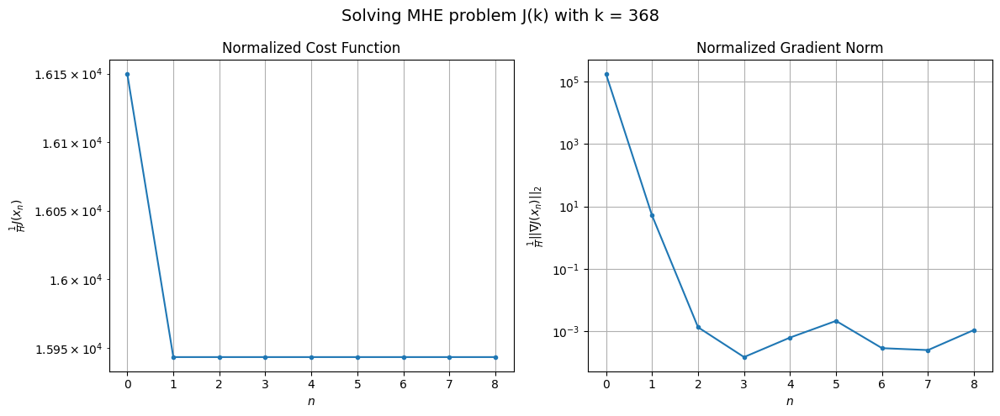

Windows:  92%|█████████▏| 320/346 [54:23<03:56,  9.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 851532.384708542
Gradient norm: 9088696.197892603
Global estimation error: 52.85173756133081
Initial conditions estimation errors: 28.500381250193964 m, 22.32104707936672 m, 34.06106623176546 m, 17.962367817247845 m
Position estimation errors: 44.570903081289394 m, 50.18519073482788 m, 39.41364331160816 m, 53.39739203450985 m

[Gauss-Newton] Iteration 1
Cost function: 840696.2737180592 (-1.27%)
Gradient norm: 163.4492895231352 (-100.00%)
Global estimation error: 62.42934621226403 (18.12%)
Initial conditions estimation errors: 31.37015749357198 m, 25.828663821107643 m, 42.612798395547614 m, 20.745210543699255 m
Position estimation errors: 41.6435712933305 m, 46.78831675066022 m, 31.125406090442404 m, 50.31842246491065 m

[Gauss-Newton] Iteration 2
Cost function: 840696.2736893852 (-0.00%)
Gradient norm: 0.33923556108577485 (-99.79%)
Global estimation error: 62.450300493159766 (0.03%)
Initial conditions estimation errors: 31.370

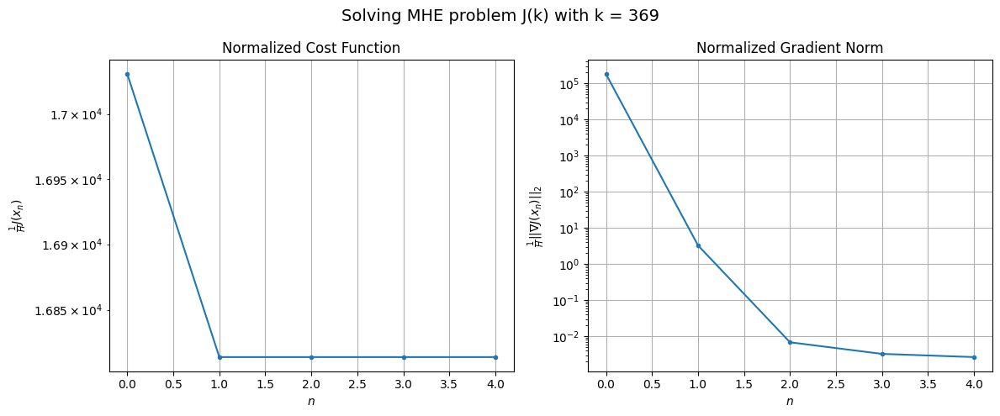

Windows:  93%|█████████▎| 321/346 [54:29<03:25,  8.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 891388.5489602512
Gradient norm: 9109193.58947214
Global estimation error: 59.705156311862716
Initial conditions estimation errors: 29.714573644572166 m, 24.492803346222516 m, 40.808211416103724 m, 20.40930311248207 m
Position estimation errors: 44.92976329567352 m, 49.73405208504277 m, 34.63538653636012 m, 52.1605674015197 m

[Gauss-Newton] Iteration 1
Cost function: 880106.0149481408 (-1.27%)
Gradient norm: 1907.2983841763075 (-99.98%)
Global estimation error: 63.977765159515535 (7.16%)
Initial conditions estimation errors: 32.667797203731475 m, 19.930471899200967 m, 50.63717139816788 m, 8.038649708951926 m
Position estimation errors: 41.95063843471533 m, 54.37519925443846 m, 25.725512673349996 m, 64.91287883928236 m

[Gauss-Newton] Iteration 2
Cost function: 880106.0141532685 (-0.00%)
Gradient norm: 0.06929469743206665 (-100.00%)
Global estimation error: 63.97410138438104 (-0.01%)
Initial conditions estimation errors: 32.66

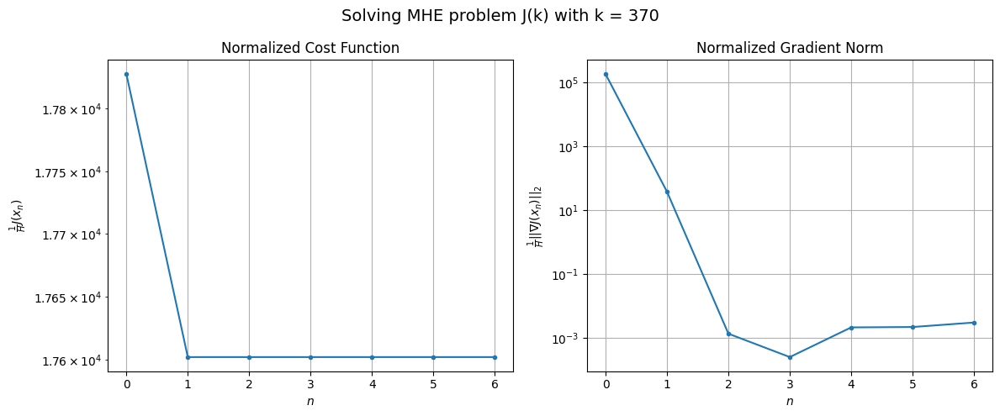

Windows:  93%|█████████▎| 322/346 [54:37<03:15,  8.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 928166.1387622502
Gradient norm: 9302492.19217344
Global estimation error: 61.051934352186976
Initial conditions estimation errors: 30.95923453831229 m, 18.79881655925718 m, 48.44692440488201 m, 8.268088023520177 m
Position estimation errors: 45.06020081660095 m, 56.905055760520874 m, 29.467116450631902 m, 65.916814409044 m

[Gauss-Newton] Iteration 1
Cost function: 916346.1084428978 (-1.27%)
Gradient norm: 376.85119718848694 (-100.00%)
Global estimation error: 67.88689015092145 (11.20%)
Initial conditions estimation errors: 34.01806862769855 m, 24.640256562736603 m, 50.72416443233802 m, 16.471630533741994 m
Position estimation errors: 42.02541302431928 m, 51.13887413970879 m, 26.935322380607374 m, 57.79442800919784 m

[Gauss-Newton] Iteration 2
Cost function: 916346.1084112324 (-0.00%)
Gradient norm: 0.2210325196279368 (-99.94%)
Global estimation error: 67.89569909427287 (0.01%)
Initial conditions estimation errors: 34.018066

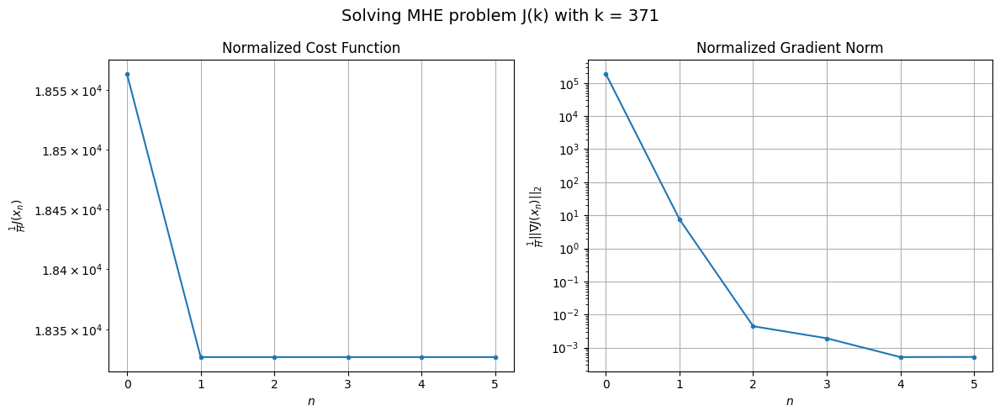

Windows:  93%|█████████▎| 323/346 [54:45<03:03,  7.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 959238.3478149642
Gradient norm: 9721544.570244582
Global estimation error: 64.8118711006587
Initial conditions estimation errors: 32.224372141028034 m, 23.362116645714902 m, 48.48159412523162 m, 16.306780788714388 m
Position estimation errors: 44.9970248015868 m, 53.56610969058838 m, 30.468898103252624 m, 59.082528378868986 m

[Gauss-Newton] Iteration 1
Cost function: 946855.6638157137 (-1.29%)
Gradient norm: 131.14171340981468 (-100.00%)
Global estimation error: 71.81752506017439 (10.81%)
Initial conditions estimation errors: 35.3930866578623 m, 25.560705916163347 m, 54.76063702270733 m, 15.90614007648235 m
Position estimation errors: 41.907812309765625 m, 51.95513402899275 m, 24.4109121394566 m, 59.647441557185736 m

[Gauss-Newton] Iteration 2
Cost function: 946855.6638222277 (0.00%)
Gradient norm: 0.08165875994163885 (-99.94%)
Global estimation error: 71.82176950035728 (0.01%)
Initial conditions estimation errors: 35.39308

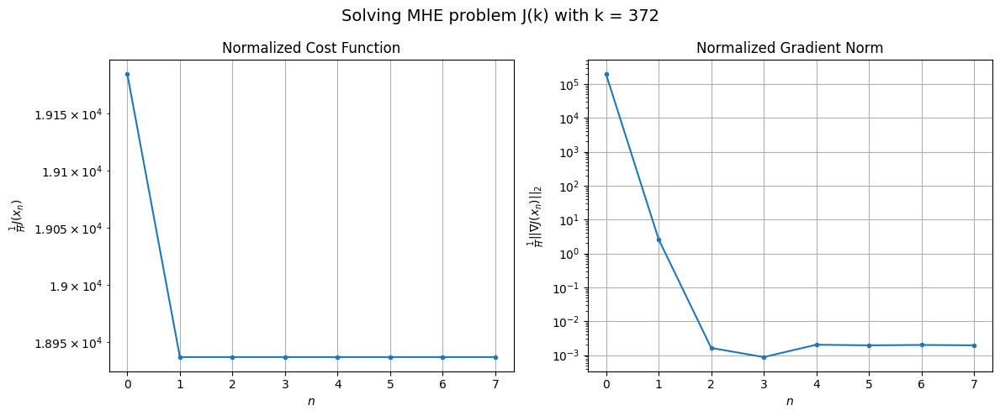

Windows:  94%|█████████▎| 324/346 [54:54<03:06,  8.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 985513.2551786518
Gradient norm: 9414646.513735889
Global estimation error: 68.47254652064824
Initial conditions estimation errors: 33.450484076141464 m, 24.08034073907643 m, 52.33434822524404 m, 15.836755433791835 m
Position estimation errors: 44.789453260283636 m, 54.32213135546418 m, 27.90022571872768 m, 60.57921289102273 m

[Gauss-Newton] Iteration 1
Cost function: 972770.2774523527 (-1.29%)
Gradient norm: 753.0974743210224 (-99.99%)
Global estimation error: 76.1481650438139 (11.21%)
Initial conditions estimation errors: 36.70826821962777 m, 30.673001363982568 m, 52.119426696545695 m, 28.17397850404565 m
Position estimation errors: 41.67802849424708 m, 47.8135124498523 m, 27.469566523563145 m, 48.465288476697076 m

[Gauss-Newton] Iteration 2
Cost function: 972770.2773307039 (-0.00%)
Gradient norm: 0.14189088753331022 (-99.98%)
Global estimation error: 76.15790389183773 (0.01%)
Initial conditions estimation errors: 36.70826

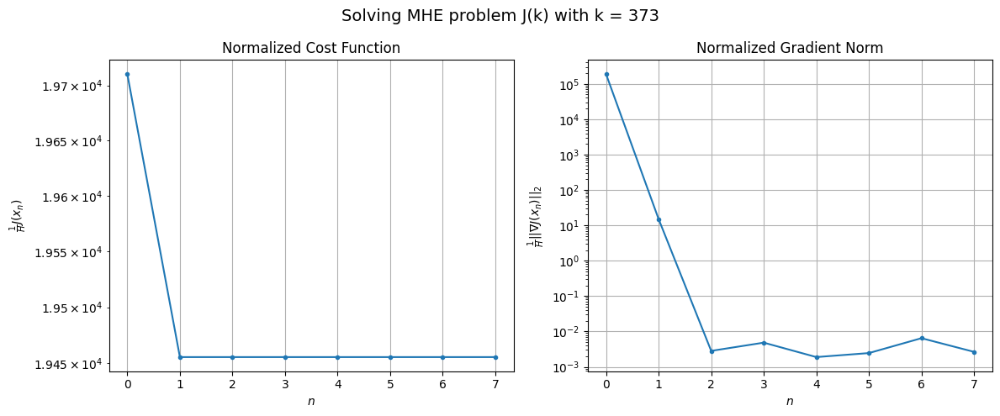

Windows:  94%|█████████▍| 325/346 [55:04<03:04,  8.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1006466.9081505359
Gradient norm: 9574463.108207697
Global estimation error: 72.33275409518077
Initial conditions estimation errors: 34.542183404934875 m, 28.77942130390796 m, 49.60477924011778 m, 27.385558171438426 m
Position estimation errors: 44.514476972876366 m, 50.32070591789745 m, 30.738590832641872 m, 49.82396933008016 m

[Gauss-Newton] Iteration 1
Cost function: 993274.0750251126 (-1.31%)
Gradient norm: 517.8465527809468 (-99.99%)
Global estimation error: 81.65346924766433 (12.89%)
Initial conditions estimation errors: 37.89517905209162 m, 36.204407671170415 m, 51.16193964633765 m, 36.096171859101815 m
Position estimation errors: 41.37162481121089 m, 43.015252245924515 m, 28.84888252852932 m, 42.18350758938699 m

[Gauss-Newton] Iteration 2
Cost function: 993274.0749507425 (-0.00%)
Gradient norm: 0.293176952483678 (-99.94%)
Global estimation error: 81.67175135659886 (0.02%)
Initial conditions estimation errors: 37.8951

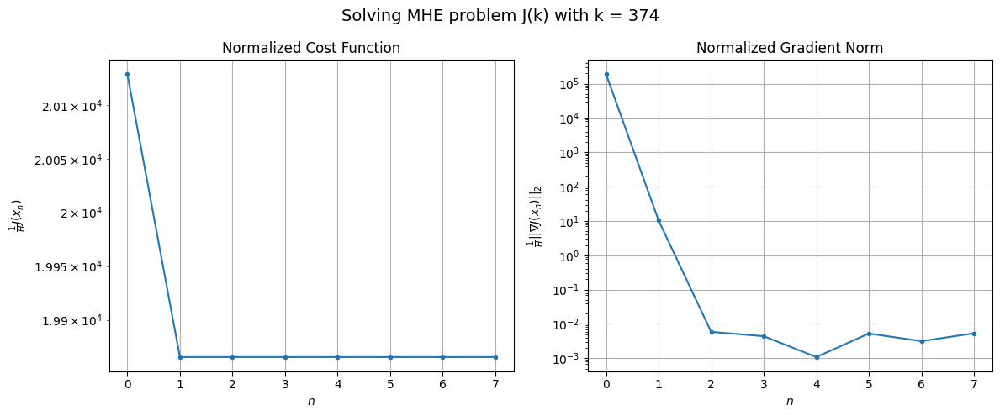

Windows:  94%|█████████▍| 326/346 [55:14<03:00,  9.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1018925.1450969129
Gradient norm: 9297543.393838119
Global estimation error: 77.07154674332092
Initial conditions estimation errors: 35.44674958275429 m, 33.92771292063709 m, 48.48166831598374 m, 34.379934462799135 m
Position estimation errors: 44.192654992791475 m, 45.61657731400952 m, 31.965377688528815 m, 44.23114822928756 m

[Gauss-Newton] Iteration 1
Cost function: 1005277.4288626341 (-1.34%)
Gradient norm: 1503.1075836066698 (-99.98%)
Global estimation error: 86.90741896012754 (12.76%)
Initial conditions estimation errors: 38.89351868844203 m, 43.359668752192505 m, 40.44951091011896 m, 50.23902384815654 m
Position estimation errors: 41.0216128458217 m, 36.14285328170268 m, 39.618397390305255 m, 29.010126343076188 m

[Gauss-Newton] Iteration 2
Cost function: 1005277.4278019222 (-0.00%)
Gradient norm: 0.039842654755634 (-100.00%)
Global estimation error: 86.8923741484179 (-0.02%)
Initial conditions estimation errors: 38.89

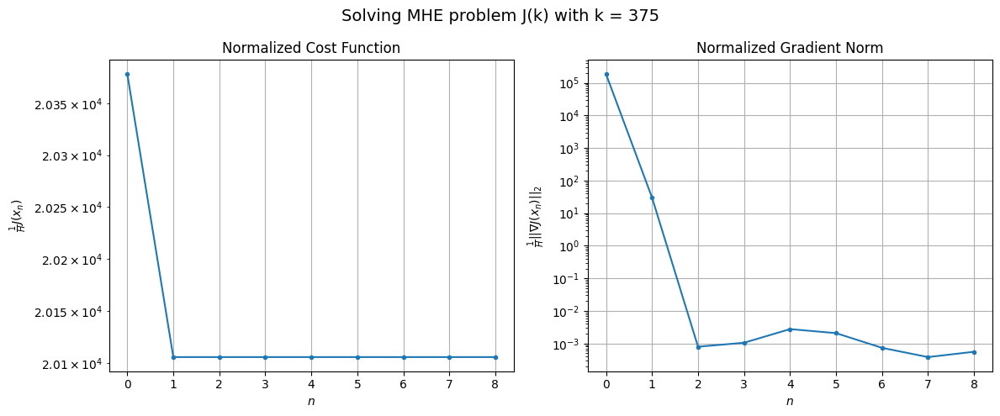

Windows:  95%|█████████▍| 327/346 [55:24<03:01,  9.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1025764.6922099354
Gradient norm: 9327927.843910266
Global estimation error: 81.58696769289362
Initial conditions estimation errors: 36.14124380827361 m, 40.707289580193425 m, 37.573672426856895 m, 47.76365855772849 m
Position estimation errors: 43.84966461890658 m, 38.91689519287784 m, 42.6149912379297 m, 31.666163170383857 m

[Gauss-Newton] Iteration 1
Cost function: 1011868.1488495015 (-1.35%)
Gradient norm: 221.48076952473954 (-100.00%)
Global estimation error: 91.06456698552236 (11.62%)
Initial conditions estimation errors: 39.64387618660299 m, 47.03881110293218 m, 39.967641783715315 m, 53.9540776784655 m
Position estimation errors: 40.66900402232178 m, 33.16564191209728 m, 40.22356992763565 m, 26.417794535101518 m

[Gauss-Newton] Iteration 2
Cost function: 1011868.1488381191 (-0.00%)
Gradient norm: 0.10795027146221893 (-99.95%)
Global estimation error: 91.06680300766797 (0.00%)
Initial conditions estimation errors: 39.64

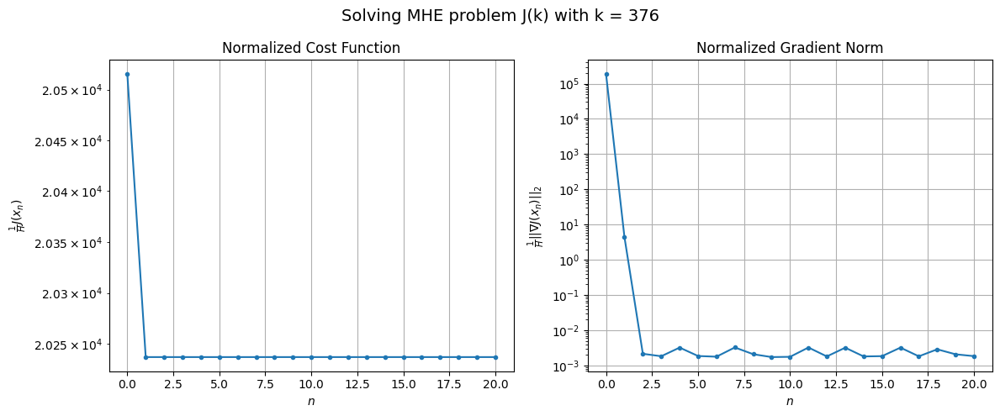

Windows:  95%|█████████▍| 328/346 [55:48<04:08, 13.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1026919.9158587799
Gradient norm: 9388193.819137529
Global estimation error: 84.932982463894
Initial conditions estimation errors: 36.61316243994508 m, 43.96658060804048 m, 36.90797748445497 m, 50.772168301013174 m
Position estimation errors: 43.52591497692541 m, 36.15315137658046 m, 43.14316992023893 m, 29.620068810585572 m

[Gauss-Newton] Iteration 1
Cost function: 1012818.6702117517 (-1.37%)
Gradient norm: 1081.1168218551259 (-99.99%)
Global estimation error: 83.57971838252318 (-1.59%)
Initial conditions estimation errors: 40.15671085129097 m, 40.378609109057805 m, 46.5380901752449 m, 39.708504708662566 m
Position estimation errors: 40.33668378007476 m, 40.12782962150033 m, 34.23643094846715 m, 40.917690482618795 m

[Gauss-Newton] Iteration 2
Cost function: 1012818.669790505 (-0.00%)
Gradient norm: 0.398969339543847 (-99.96%)
Global estimation error: 83.62696678542964 (0.06%)
Initial conditions estimation errors: 40.1567075

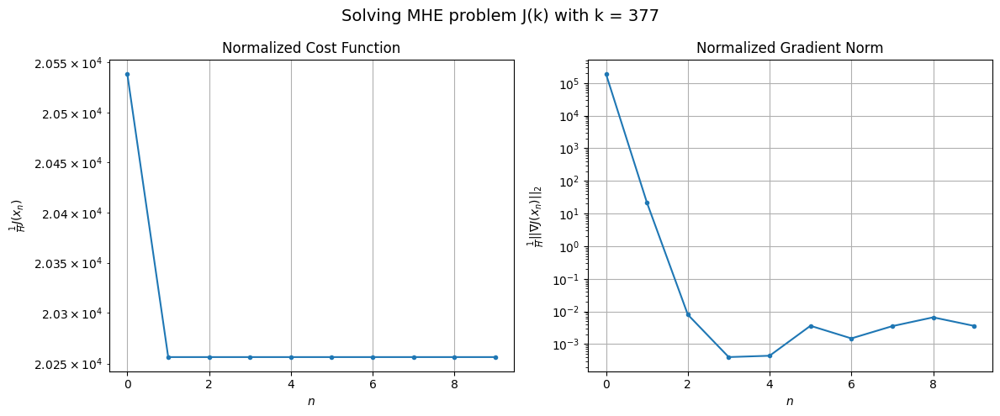

Windows:  95%|█████████▌| 329/346 [55:59<03:42, 13.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1026103.7000776426
Gradient norm: 9611866.109086584
Global estimation error: 76.95481158926066
Initial conditions estimation errors: 36.9070058526765 m, 37.092447755826335 m, 43.161326844444645 m, 36.347601468751215 m
Position estimation errors: 43.24574081305628 m, 43.076796762674086 m, 37.34274513842723 m, 44.00910525736788 m

[Gauss-Newton] Iteration 1
Cost function: 1011889.1689460718 (-1.39%)
Gradient norm: 662.9321127183036 (-99.99%)
Global estimation error: 91.91191463977002 (19.44%)
Initial conditions estimation errors: 40.461614343190504 m, 46.23244988541916 m, 46.353158413581035 m, 50.245230832477965 m
Position estimation errors: 40.04213278913215 m, 34.463155394066945 m, 34.19911551805253 m, 31.11213237626479 m

[Gauss-Newton] Iteration 2
Cost function: 1011889.1688218429 (-0.00%)
Gradient norm: 0.11217307618281892 (-99.98%)
Global estimation error: 91.86909540349737 (-0.05%)
Initial conditions estimation errors: 40

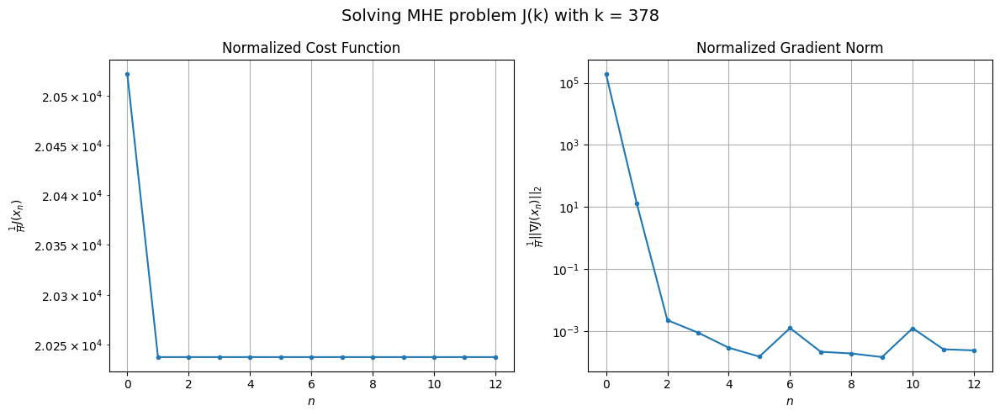

Windows:  95%|█████████▌| 330/346 [56:13<03:30, 13.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1022834.7242851208
Gradient norm: 9873120.72273445
Global estimation error: 84.68096402964295
Initial conditions estimation errors: 37.0643136927419 m, 42.602308205345686 m, 42.94467013498614 m, 46.23721589875121 m
Position estimation errors: 43.020412367486536 m, 37.77627409269459 m, 37.2566464443531 m, 34.91590525417638 m

[Gauss-Newton] Iteration 1
Cost function: 1008558.2251472138 (-1.40%)
Gradient norm: 401.47757298527205 (-100.00%)
Global estimation error: 96.05852095558618 (13.44%)
Initial conditions estimation errors: 40.616441017559296 m, 49.84100512551798 m, 40.944194764869216 m, 58.45485705215646 m
Position estimation errors: 39.804514953239 m, 30.676916450559926 m, 39.811806916443864 m, 22.64959743095767 m

[Gauss-Newton] Iteration 2
Cost function: 1008558.2249063118 (-0.00%)
Gradient norm: 0.3165252020119306 (-99.92%)
Global estimation error: 96.03987025096392 (-0.02%)
Initial conditions estimation errors: 40.6164

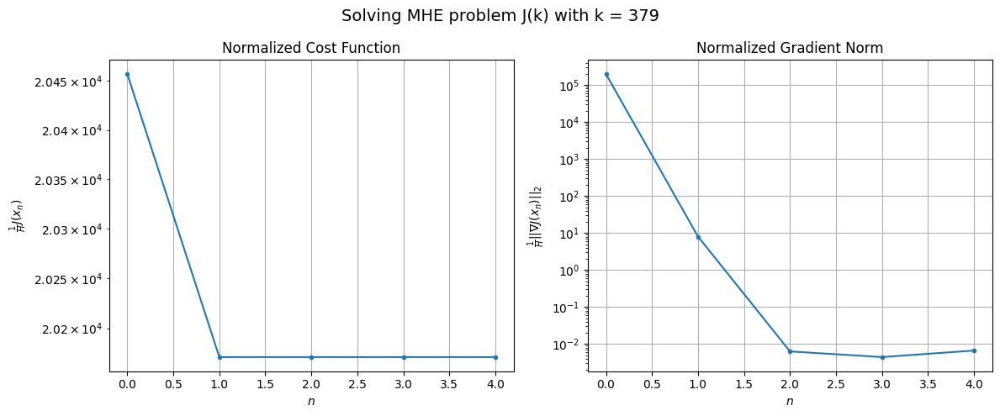

Windows:  96%|█████████▌| 331/346 [56:19<02:46, 11.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1017913.843546187
Gradient norm: 10146568.07441449
Global estimation error: 89.01765389414201
Initial conditions estimation errors: 37.13494140655899 m, 46.34374167481767 m, 37.23121669001028 m, 54.87450676017721 m
Position estimation errors: 42.86136489464582 m, 33.96310470228051 m, 43.14737205787248 m, 26.175142943185406 m

[Gauss-Newton] Iteration 1
Cost function: 1003775.8225260535 (-1.39%)
Gradient norm: 128.62002150856142 (-100.00%)
Global estimation error: 94.10576894793743 (5.72%)
Initial conditions estimation errors: 40.6440934920186 m, 48.38971090875142 m, 40.50442186974664 m, 56.76054225625615 m
Position estimation errors: 39.641055293058145 m, 31.78300215009981 m, 40.47104456953279 m, 23.8163060431956 m

[Gauss-Newton] Iteration 2
Cost function: 1003775.822549812 (0.00%)
Gradient norm: 0.027072077708065197 (-99.98%)
Global estimation error: 94.10258057685739 (-0.00%)
Initial conditions estimation errors: 40.6440902

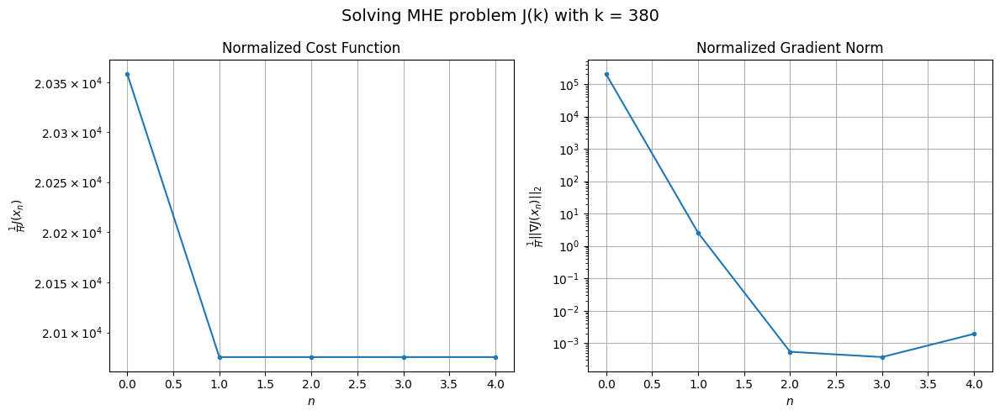

Windows:  96%|█████████▌| 332/346 [56:25<02:14,  9.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1013540.5749132814
Gradient norm: 10900457.9639555
Global estimation error: 87.18985627850414
Initial conditions estimation errors: 37.14052799923439 m, 44.9999739907962 m, 36.64378145850546 m, 53.43094565922653 m
Position estimation errors: 42.789157340797296 m, 35.03530026830373 m, 44.05369585211074 m, 27.158962040059354 m

[Gauss-Newton] Iteration 1
Cost function: 999235.3317262343 (-1.41%)
Gradient norm: 434.1998356084569 (-100.00%)
Global estimation error: 91.5231743001697 (4.97%)
Initial conditions estimation errors: 40.63343730128617 m, 45.622349529546725 m, 46.67769269816229 m, 49.65064065223103 m
Position estimation errors: 39.52327950472661 m, 34.472868691431444 m, 34.48733851274811 m, 30.93361831058591 m

[Gauss-Newton] Iteration 2
Cost function: 999235.3316065497 (-0.00%)
Gradient norm: 0.07397721638954544 (-99.98%)
Global estimation error: 91.4858641023194 (-0.04%)
Initial conditions estimation errors: 40.63343408

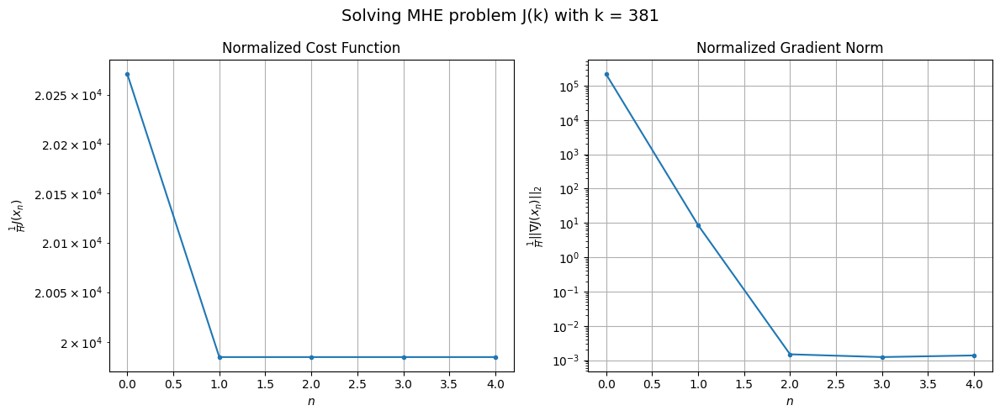

Windows:  96%|█████████▌| 333/346 [56:31<01:52,  8.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1007734.252718036
Gradient norm: 11434421.804252712
Global estimation error: 84.36061034296849
Initial conditions estimation errors: 37.16591276680752 m, 42.16541476563129 m, 42.834487703306834 m, 46.07243305701599 m
Position estimation errors: 42.789844607594816 m, 37.83366106724679 m, 38.33582024055705 m, 34.51193914003632 m

[Gauss-Newton] Iteration 1
Cost function: 993539.4666525831 (-1.41%)
Gradient norm: 902.0976019074291 (-99.99%)
Global estimation error: 84.30761728188776 (-0.06%)
Initial conditions estimation errors: 40.60050996558455 m, 39.20659402125982 m, 52.11243810663771 m, 34.73449770938453 m
Position estimation errors: 39.50107039249743 m, 41.05087981164316 m, 29.221505766704237 m, 46.26053738669676 m

[Gauss-Newton] Iteration 2
Cost function: 993539.4660697022 (-0.00%)
Gradient norm: 0.09153019556679688 (-99.99%)
Global estimation error: 84.3376280057972 (0.04%)
Initial conditions estimation errors: 40.6005068

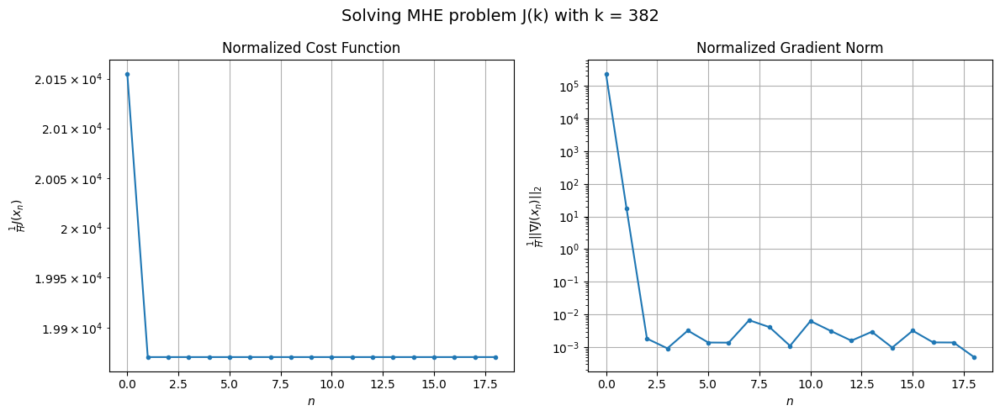

Windows:  97%|█████████▋| 334/346 [56:53<02:29, 12.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1004211.6292596764
Gradient norm: 12460342.26183954
Global estimation error: 77.19697342325206
Initial conditions estimation errors: 37.21963623645664 m, 35.674292725444104 m, 48.43337137966598 m, 30.91279649287358 m
Position estimation errors: 42.92411365834889 m, 44.60749276578469 m, 33.347901392326506 m, 50.0841142734087 m

[Gauss-Newton] Iteration 1
Cost function: 989987.0876310637 (-1.42%)
Gradient norm: 79.5133734017196 (-100.00%)
Global estimation error: 83.39728145873347 (8.03%)
Initial conditions estimation errors: 40.59697195163875 m, 38.35488820545768 m, 51.70421254396231 m, 34.0961122114227 m
Position estimation errors: 39.580478803434005 m, 42.02969487587711 m, 29.927739125547763 m, 46.96185526274131 m

[Gauss-Newton] Iteration 2
Cost function: 989987.0876116125 (-0.00%)
Gradient norm: 0.015656652713100395 (-99.98%)
Global estimation error: 83.39773997454822 (0.00%)
Initial conditions estimation errors: 40.5969689

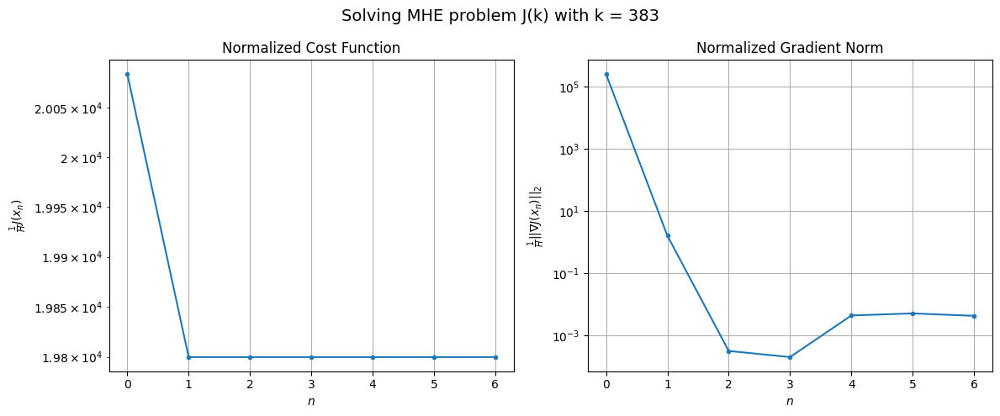

Windows:  97%|█████████▋| 335/346 [57:01<02:02, 11.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1000915.1293348111
Gradient norm: 12902919.641266419
Global estimation error: 76.53123094740583
Initial conditions estimation errors: 37.337049514051564 m, 34.9305146800892 m, 48.153802287472175 m, 30.397709727553238 m
Position estimation errors: 43.17851836754177 m, 45.76267034230619 m, 34.23550039433087 m, 50.8958680911745 m

[Gauss-Newton] Iteration 1
Cost function: 986749.1839939014 (-1.42%)
Gradient norm: 70.21587538686693 (-100.00%)
Global estimation error: 82.66789926213356 (8.02%)
Initial conditions estimation errors: 40.64893350118039 m, 37.43217048857756 m, 51.757683584021756 m, 33.190305952709664 m
Position estimation errors: 39.79134638689881 m, 42.889832643938895 m, 30.404730624647808 m, 47.91368860186216 m

[Gauss-Newton] Iteration 2
Cost function: 986749.1840030793 (0.00%)
Gradient norm: 0.08908588833639099 (-99.87%)
Global estimation error: 82.66594492142387 (-0.00%)
Initial conditions estimation errors: 40.648

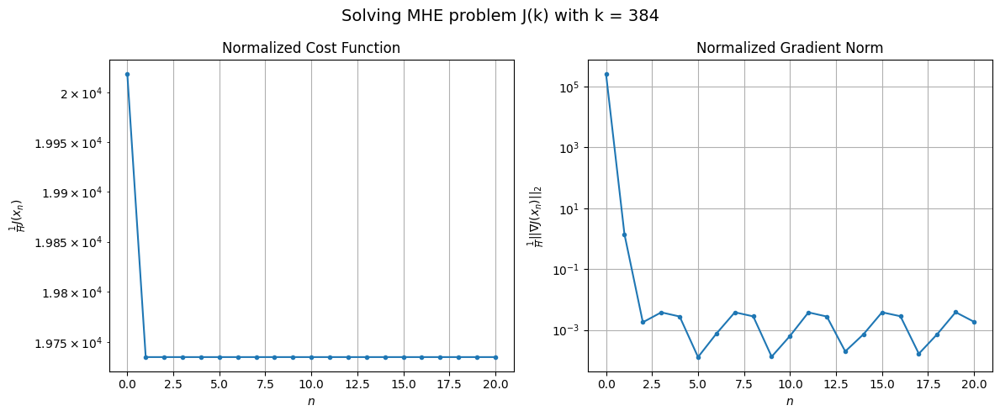

Windows:  97%|█████████▋| 336/346 [57:24<02:28, 14.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 998734.298428384
Gradient norm: 13901435.898372337
Global estimation error: 76.1575094413708
Initial conditions estimation errors: 37.53150522502625 m, 34.24468922035359 m, 48.341994850199555 m, 29.693136798454333 m
Position estimation errors: 43.56047204140756 m, 46.70980953402089 m, 34.93974877567184 m, 51.905599105015575 m

[Gauss-Newton] Iteration 1
Cost function: 984411.508379365 (-1.43%)
Gradient norm: 741.1771813793061 (-99.99%)
Global estimation error: 85.92109192912822 (12.82%)
Initial conditions estimation errors: 40.796082341601256 m, 41.919831282801646 m, 45.12400066298087 m, 43.87075400770113 m
Position estimation errors: 40.09346010454876 m, 38.753201687665936 m, 36.940388194932275 m, 37.47464001298967 m

[Gauss-Newton] Iteration 2
Cost function: 984411.5081467517 (-0.00%)
Gradient norm: 0.16933535657866003 (-99.98%)
Global estimation error: 85.89888784922394 (-0.03%)
Initial conditions estimation errors: 40.7960

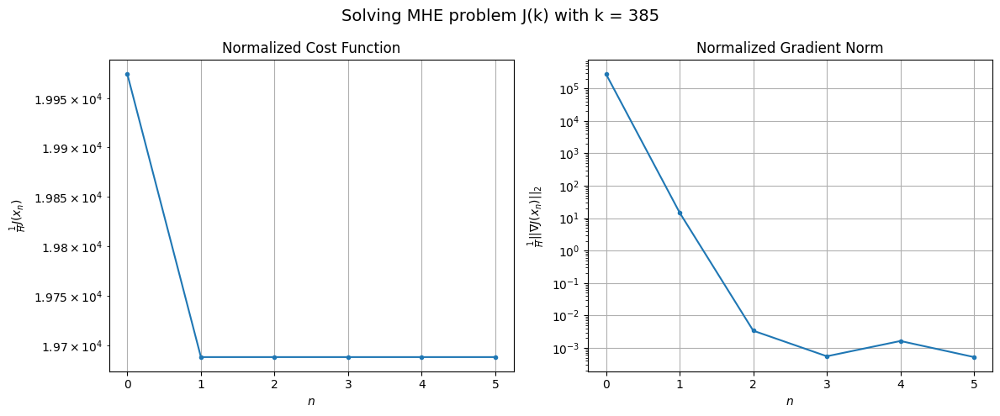

Windows:  97%|█████████▋| 337/346 [57:32<01:53, 12.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 998101.4521233701
Gradient norm: 15097257.89601476
Global estimation error: 79.70749242394241
Initial conditions estimation errors: 37.828945838481495 m, 39.00793865828227 m, 41.750889039163155 m, 40.71214118904135 m
Position estimation errors: 44.016761389846216 m, 42.700329929986616 m, 41.485700577739586 m, 41.68321743948339 m

[Gauss-Newton] Iteration 1
Cost function: 983675.6557125684 (-1.45%)
Gradient norm: 78.24181257972421 (-100.00%)
Global estimation error: 86.72018068936005 (8.80%)
Initial conditions estimation errors: 41.04275950308508 m, 43.219361517597335 m, 44.94926476504763 m, 44.13060502279909 m
Position estimation errors: 40.47626025751497 m, 38.426343134080135 m, 37.66070157325543 m, 38.50738890094178 m

[Gauss-Newton] Iteration 2
Cost function: 983675.6557117389 (-0.00%)
Gradient norm: 0.3007241417019331 (-99.62%)
Global estimation error: 86.71723263979575 (-0.00%)
Initial conditions estimation errors: 41.042

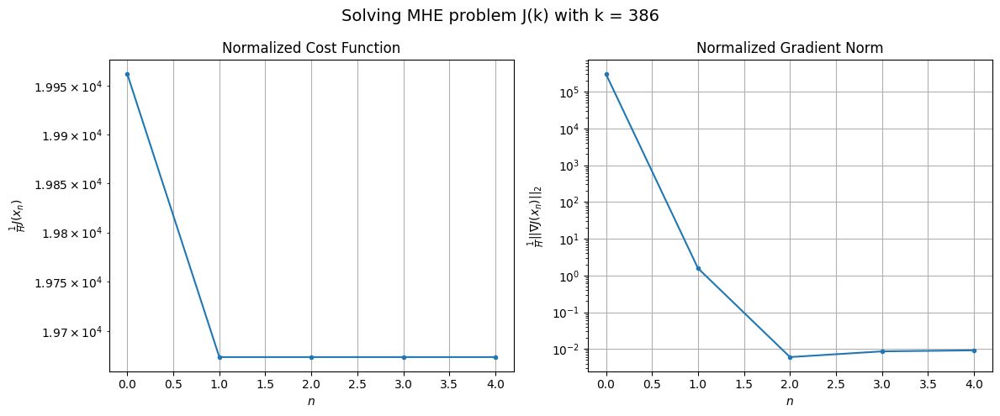

Windows:  98%|█████████▊| 338/346 [57:38<01:25, 10.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 999659.9774264998
Gradient norm: 16114198.435497126
Global estimation error: 80.54078495402194
Initial conditions estimation errors: 38.206420032836675 m, 40.22275389451288 m, 41.84809627715546 m, 40.71775103256607 m
Position estimation errors: 44.550995340524274 m, 42.723226640511136 m, 42.2084500788439 m, 43.25350661551589 m

[Gauss-Newton] Iteration 1
Cost function: 984892.2678815229 (-1.48%)
Gradient norm: 179.59277253486317 (-100.00%)
Global estimation error: 86.88283069056916 (7.87%)
Initial conditions estimation errors: 41.412654857365865 m, 44.45033489415949 m, 41.76718007116278 m, 45.9703091149064 m
Position estimation errors: 40.91636014308114 m, 38.281791869698964 m, 41.146283757911334 m, 37.889443659315134 m

[Gauss-Newton] Iteration 2
Cost function: 984892.2678528135 (-0.00%)
Gradient norm: 0.3752119980792522 (-99.79%)
Global estimation error: 86.87002004513606 (-0.01%)
Initial conditions estimation errors: 41.412

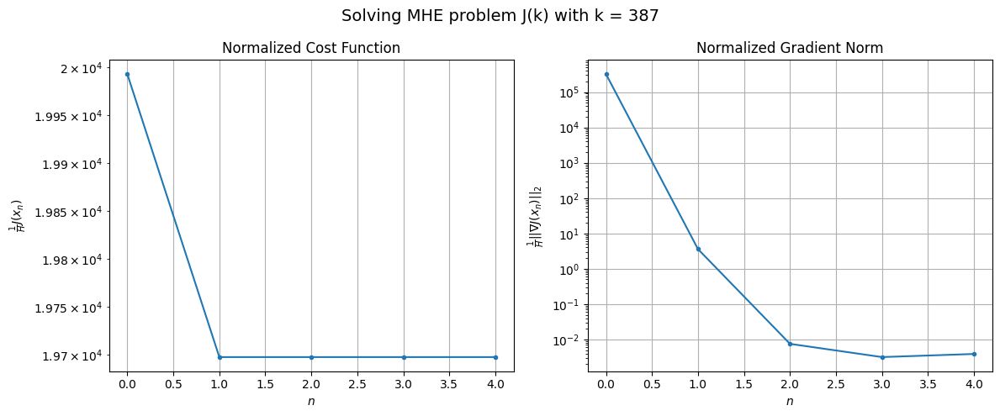

Windows:  98%|█████████▊| 339/346 [57:44<01:05,  9.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1001204.5050986316
Gradient norm: 16886806.567720324
Global estimation error: 80.78817181246741
Initial conditions estimation errors: 38.66132768521009 m, 41.4345416044371 m, 38.842532025825065 m, 42.50234862222427 m
Position estimation errors: 45.15236106752998 m, 42.8378439010707 m, 45.60901891029829 m, 42.94624112275816 m

[Gauss-Newton] Iteration 1
Cost function: 985997.993047522 (-1.52%)
Gradient norm: 116.98066803463269 (-100.00%)
Global estimation error: 82.22530365456481 (1.78%)
Initial conditions estimation errors: 41.88948672971958 m, 42.609073366829826 m, 39.697827863398 m, 40.18462243946428 m
Position estimation errors: 41.42822007347202 m, 40.94563713811644 m, 43.67907316612215 m, 44.24978638139811 m

[Gauss-Newton] Iteration 2
Cost function: 985997.9930550002 (0.00%)
Gradient norm: 0.0706144008520232 (-99.94%)
Global estimation error: 82.23133229463284 (0.01%)
Initial conditions estimation errors: 41.889484995795

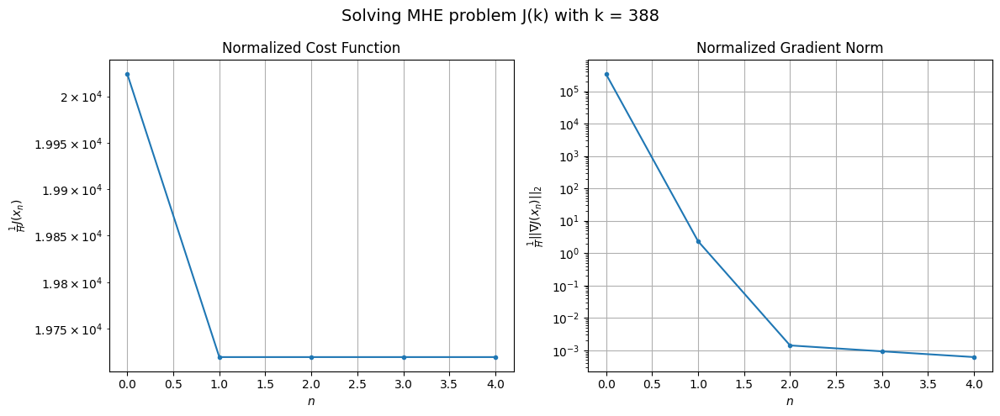

Windows:  98%|█████████▊| 340/346 [57:51<00:51,  8.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1003702.2512164745
Gradient norm: 17726321.179368284
Global estimation error: 76.28930541603474
Initial conditions estimation errors: 39.15923423569895 m, 39.60881575469989 m, 37.02028410925577 m, 36.704729356606165 m
Position estimation errors: 45.834185301769814 m, 45.57227826111815 m, 48.00323301295341 m, 49.25328741161372 m

[Gauss-Newton] Iteration 1
Cost function: 988294.9202737035 (-1.54%)
Gradient norm: 257.53902099957594 (-100.00%)
Global estimation error: 86.0532521695351 (12.80%)
Initial conditions estimation errors: 42.389370506906445 m, 44.39626005254454 m, 37.86125045385998 m, 46.94450082980871 m
Position estimation errors: 42.05880285433188 m, 40.204179820578496 m, 46.664934002616576 m, 38.92084804739723 m

[Gauss-Newton] Iteration 2
Cost function: 988294.9202512508 (-0.00%)
Gradient norm: 0.42925000133241764 (-99.83%)
Global estimation error: 86.05929885039586 (0.01%)
Initial conditions estimation errors: 42.38

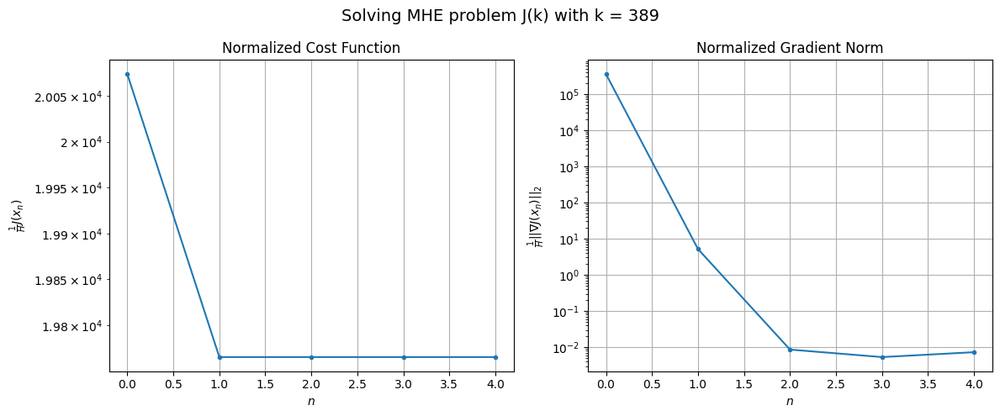

Windows:  99%|█████████▊| 341/346 [57:57<00:39,  7.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1007491.886519637
Gradient norm: 19287817.223147333
Global estimation error: 80.14958335704586
Initial conditions estimation errors: 39.60851655143915 m, 41.44332345756666 m, 35.07427877235812 m, 43.67324485957 m
Position estimation errors: 46.6364170541456 m, 44.92884349001066 m, 51.15941519904158 m, 44.12005451988372 m

[Gauss-Newton] Iteration 1
Cost function: 991359.1817717359 (-1.60%)
Gradient norm: 253.7831975726264 (-100.00%)
Global estimation error: 83.2631066545054 (3.88%)
Initial conditions estimation errors: 42.885221802727685 m, 45.180984462136614 m, 36.06100669823115 m, 41.855345923662625 m
Position estimation errors: 42.740451242853126 m, 41.10384953398884 m, 48.72796665074273 m, 45.154967600313924 m

[Gauss-Newton] Iteration 2
Cost function: 991359.1817500824 (-0.00%)
Gradient norm: 0.3685770100098952 (-99.85%)
Global estimation error: 83.23495573495514 (-0.03%)
Initial conditions estimation errors: 42.885220247

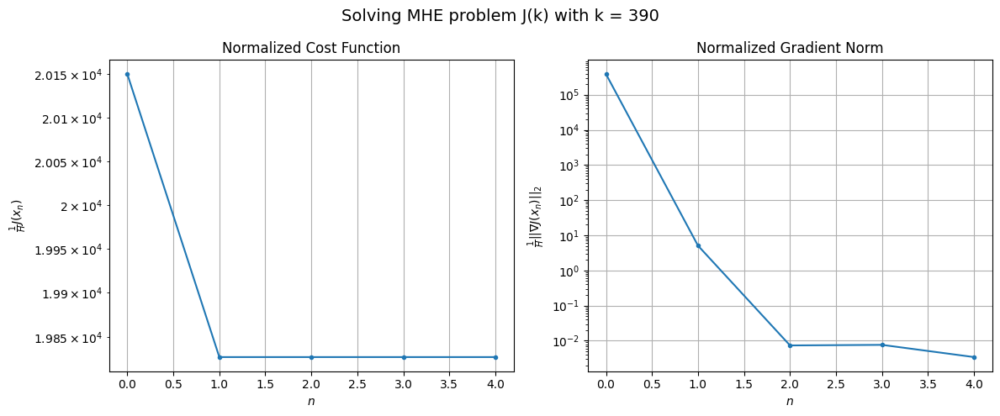

Windows:  99%|█████████▉| 342/346 [58:03<00:29,  7.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1012010.0309614383
Gradient norm: 20743291.270051163
Global estimation error: 77.01330363168415
Initial conditions estimation errors: 39.9813901706094 m, 41.888492241771374 m, 33.64169400847548 m, 38.027785969751065 m
Position estimation errors: 47.49476401936359 m, 46.27173661607614 m, 52.90896114140235 m, 50.69547766658605 m

[Gauss-Newton] Iteration 1
Cost function: 995449.8276878266 (-1.64%)
Gradient norm: 584.9365958057033 (-100.00%)
Global estimation error: 84.24386214561389 (9.39%)
Initial conditions estimation errors: 43.26586531445033 m, 47.294337386141414 m, 26.661299110441632 m, 47.72316052355948 m
Position estimation errors: 43.50641502065848 m, 39.728339624737096 m, 58.35688656176883 m, 39.98269190161494 m

[Gauss-Newton] Iteration 2
Cost function: 995449.8273004666 (-0.00%)
Gradient norm: 0.18447161412011828 (-99.97%)
Global estimation error: 84.2391038320925 (-0.01%)
Initial conditions estimation errors: 43.2658

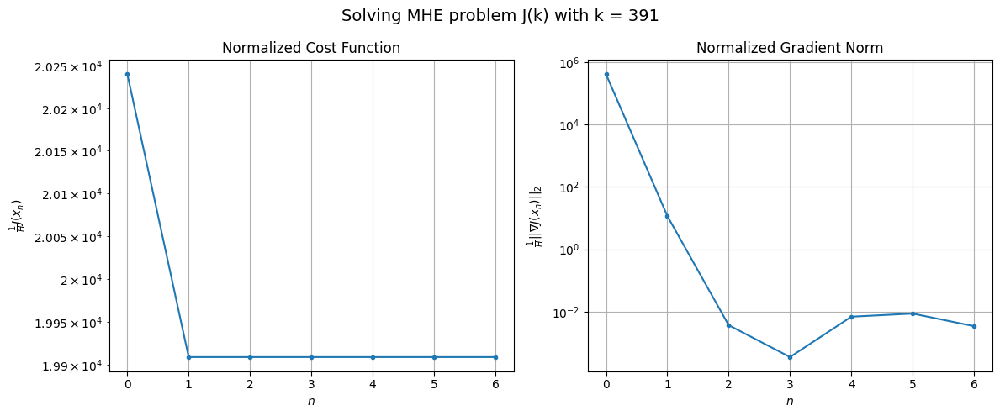

Windows:  99%|█████████▉| 343/346 [58:12<00:22,  7.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1019687.6241578634
Gradient norm: 22791630.007494878
Global estimation error: 78.20467738120321
Initial conditions estimation errors: 40.176541895624275 m, 44.16847482844633 m, 23.831574120627867 m, 44.53093424034257 m
Position estimation errors: 48.467220666041634 m, 44.78622906905963 m, 62.390146504373234 m, 45.2513912477415 m

[Gauss-Newton] Iteration 1
Cost function: 1002561.1074606889 (-1.68%)
Gradient norm: 411.1962354429607 (-100.00%)
Global estimation error: 75.95897967026039 (-2.87%)
Initial conditions estimation errors: 43.46663458700622 m, 42.312001082495385 m, 27.403076616226546 m, 36.5946650506895 m
Position estimation errors: 44.35118182208774 m, 45.57080989142133 m, 57.493946980295306 m, 50.986498724684004 m

[Gauss-Newton] Iteration 2
Cost function: 1002561.1073514968 (-0.00%)
Gradient norm: 0.216401599001848 (-99.95%)
Global estimation error: 75.98110493368824 (0.03%)
Initial conditions estimation errors: 43.4

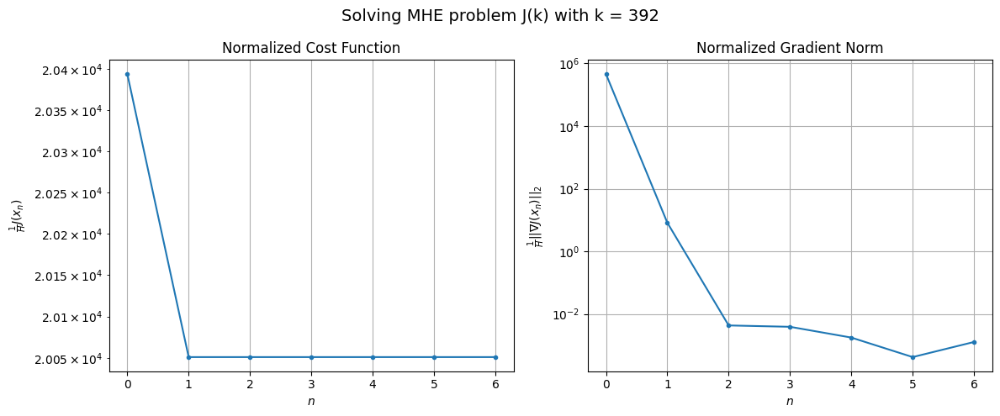

Windows:  99%|█████████▉| 344/346 [58:20<00:15,  7.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1030417.8516482834
Gradient norm: 24766409.457069334
Global estimation error: 69.57624914575872
Initial conditions estimation errors: 40.15134893693669 m, 38.924049445850855 m, 25.039364735133276 m, 32.96447053546391 m
Position estimation errors: 49.566241972664265 m, 50.86671900718248 m, 61.25869943709047 m, 56.18707983061037 m

[Gauss-Newton] Iteration 1
Cost function: 1012516.325194846 (-1.74%)
Gradient norm: 75.27508859892254 (-100.00%)
Global estimation error: 75.35140609706906 (8.30%)
Initial conditions estimation errors: 43.458614527993426 m, 40.164485536536304 m, 31.415273244250987 m, 34.48276906557162 m
Position estimation errors: 45.28347691606295 m, 48.29188973951291 m, 54.34684065838827 m, 53.944455629493355 m

[Gauss-Newton] Iteration 2
Cost function: 1012516.3251705965 (-0.00%)
Gradient norm: 0.06731201815400331 (-99.91%)
Global estimation error: 75.35546143065115 (0.01%)
Initial conditions estimation errors: 43.

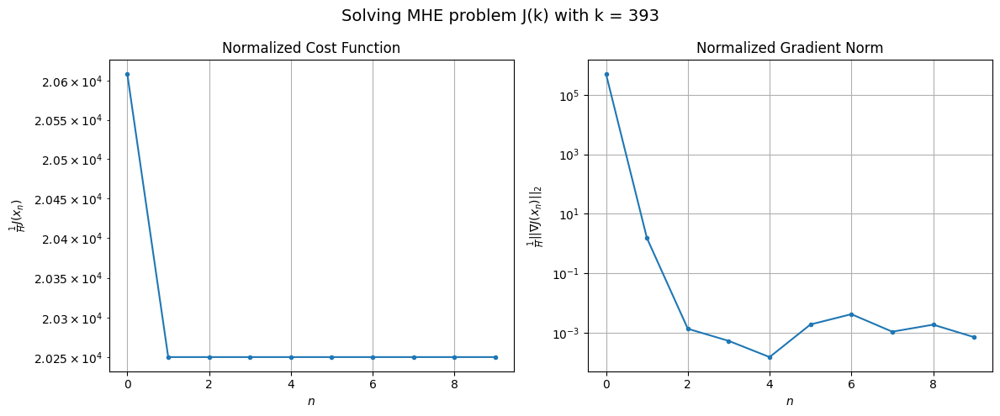

Windows: 100%|█████████▉| 345/346 [58:31<00:08,  8.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1046424.954458344
Gradient norm: 27135034.12404653
Global estimation error: 68.49548052384523
Initial conditions estimation errors: 39.91147505621919 m, 36.48206882100075 m, 29.03455565653725 m, 30.40954388785674 m
Position estimation errors: 50.81058561552227 m, 53.831141448598316 m, 58.4557446676831 m, 59.5060265570512 m

[Gauss-Newton] Iteration 1
Cost function: 1027780.1607143203 (-1.78%)
Gradient norm: 64.10471614834151 (-100.00%)
Global estimation error: 72.59931448516298 (5.99%)
Initial conditions estimation errors: 43.206162501298294 m, 38.75326722353577 m, 31.237239943550062 m, 30.43500847003421 m
Position estimation errors: 46.339462263530116 m, 50.272188431824 m, 55.0329634046869 m, 57.882709955417646 m

[Gauss-Newton] Iteration 2
Cost function: 1027780.1606955838 (-0.00%)
Gradient norm: 0.09595361722027565 (-99.85%)
Global estimation error: 72.5990999241734 (-0.00%)
Initial conditions estimation errors: 43.20615995

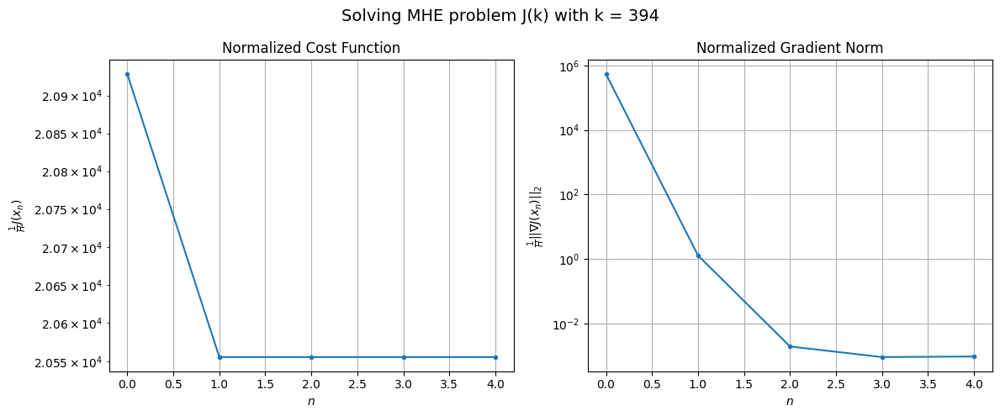

This Monte Carlo run RMSE for 346 timestamps:
RMSE_1 = 47.04742901696021
RMSE_2 = 46.16661189106202
RMSE_3 = 47.10018520518675
RMSE_4 = 46.7067635399944
CentralizedNewton applied to J(H - 1) converged with [] iterations.
CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with nan iterations on average.


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [7]:
first_round_stop_iteration = []
K_minus_H_next_rounds_stop_iteration = []

# Cold-start
x_init = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))

# Apply the algorithm
X_est = np.zeros((n, 1, K))
for k in tqdm(range(H - 1, K), desc="Windows", leave=False):
    centralized_newton.cost_values, centralized_newton.gradient_norm_values = [], []
    x_init, x_est = centralized_newton.solve_MHE_problem(k, dt, Y, x_init, X_true[:, :, k - H + 1],  X_true[:, :, k])
    X_est[:, :, k] = x_est
    
    plots(k, centralized_newton)

    # Warm-start
    x_init = dyn.f(dt, x_init)

# After each Monte Carlo Run compute the RMSE_m for each K - H + 1 timestamps
position_estimation_error_1, position_estimation_error_2, position_estimation_error_3, position_estimation_error_4 = [], [], [], []
for k in range(H - 1, K):
    position_estimation_error_1.append(np.linalg.norm(X_est[:n_p, :, k] - X_true[:n_p, :, k]))
    position_estimation_error_2.append(np.linalg.norm(X_est[n_x:n_x + n_p, :, k] - X_true[n_x:n_x + n_p, :, k]))
    position_estimation_error_3.append(np.linalg.norm(X_est[2*n_x:2*n_x + n_p, :, k] - X_true[2*n_x:2*n_x + n_p, :, k]))
    position_estimation_error_4.append(np.linalg.norm(X_est[3*n_x:3*n_x + n_p, :, k] - X_true[3*n_x:3*n_x + n_p, :, k]))
rmse_1 = np.sqrt(np.mean(np.array(position_estimation_error_1) ** 2))
rmse_2 = np.sqrt(np.mean(np.array(position_estimation_error_2) ** 2))
rmse_3 = np.sqrt(np.mean(np.array(position_estimation_error_3) ** 2))
rmse_4 = np.sqrt(np.mean(np.array(position_estimation_error_4) ** 2))
print(f'This Monte Carlo run RMSE for {K - H + 1} timestamps:')
print(f'RMSE_1 = {np.mean(rmse_1)}\nRMSE_2 = {np.mean(rmse_2)}\nRMSE_3 = {np.mean(rmse_3)}\nRMSE_4 = {np.mean(rmse_4)}')
print(f'CentralizedNewton applied to J(H - 1) converged with {first_round_stop_iteration} iterations.')
print(f'CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with {np.mean(K_minus_H_next_rounds_stop_iteration)} iterations on average.')

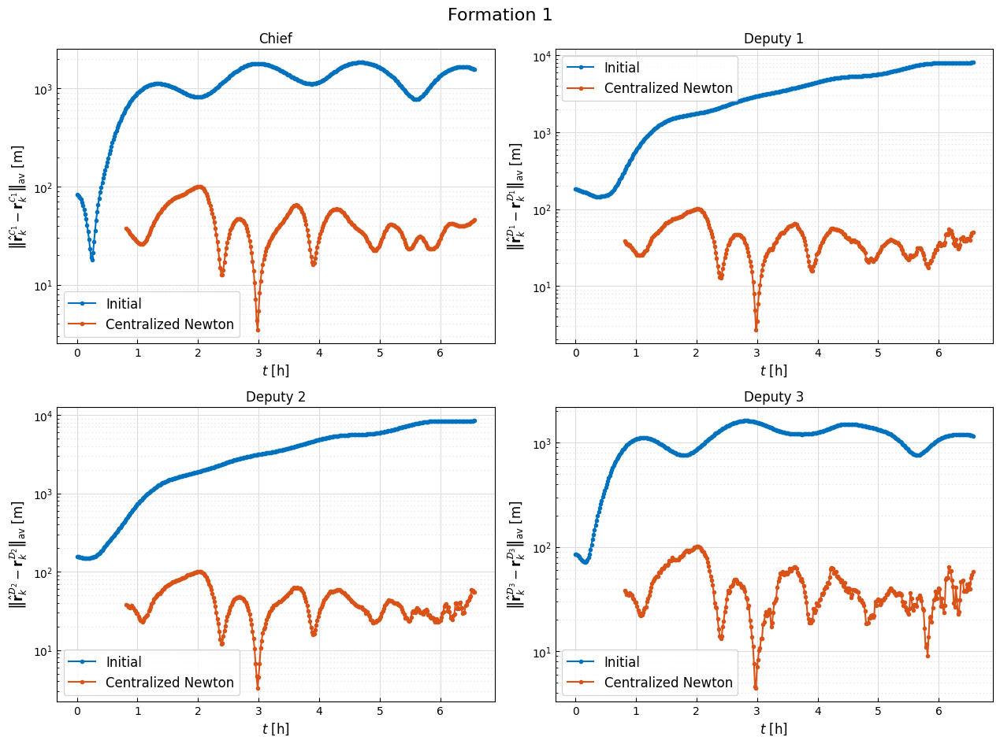

In [8]:
# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, K) / dt
algorithm = "Centralized Newton"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, position_estimation_error_1_initial, ".-", label="Initial")
axs[0, 0].plot(time[H - 1:], position_estimation_error_1, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, position_estimation_error_2_initial, ".-", label="Initial")
axs[0, 1].plot(time[H - 1:], position_estimation_error_2, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, position_estimation_error_3_initial, ".-", label="Initial")
axs[1, 0].plot(time[H - 1:], position_estimation_error_3, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, position_estimation_error_4_initial, ".-", label="Initial")
axs[1, 1].plot(time[H - 1:], position_estimation_error_4, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [9]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["H"] = H
data["true"] = X_true
data[0] = X_est

# Save to pickle file
with open(f'gauss_newton_H{H}_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl', "wb") as file:
    pickle.dump(data, file)